In [1]:
import string
import time
import argparse as ap
import sys
import os

import numpy as np
import obspy.core as oc
from obspy.core import Stream
from obspy.core import Trace
from obspy.signal.trigger import trigger_onset
from obspy.core import read
import obspy.signal
import math

import matplotlib as mpl
import pylab as plt
import pandas as pd
from obspy import UTCDateTime

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import *

import glob
import h5py
import random
import scipy
import pandas as pd
import datetime as datetime
import pyproj
# For interpolating along well path (needed for locating and orienting stations)
from scipy.interpolate import InterpolatedUnivariateSpline
import pickle as pkl

In [2]:
tf.__version__

# need a new environment for tensorflow (2) - keras 

'2.5.0'

In [3]:
# Define function to produce sliding windows of signal (from original GPD GitHub repo: https://github.com/interseismic/generalized-phase-detection/blob/master/gpd_predict.py)

def sliding_window(data, size, stepsize=1, padded=False, axis=-1, copy=True):
    """
    Calculate a sliding window over a signal
    Parameters
    ----------
    data : numpy array
        The array to be slided over.
    size : int
        The sliding window size
    stepsize : int
        The sliding window stepsize. Defaults to 1.
    axis : int
        The axis to slide over. Defaults to the last axis.
    copy : bool
        Return strided array as copy to avoid sideffects when manipulating the
        output array.
    Returns
    -------
    data : numpy array
        A matrix where row in last dimension consists of one instance
        of the sliding window.
    Notes
    -----
    - Be wary of setting `copy` to `False` as undesired sideffects with the
      output values may occurr.
    Examples
    --------
    >>> a = numpy.array([1, 2, 3, 4, 5])
    >>> sliding_window(a, size=3)
    array([[1, 2, 3],
           [2, 3, 4],
           [3, 4, 5]])
    >>> sliding_window(a, size=3, stepsize=2)
    array([[1, 2, 3],
           [3, 4, 5]])
    See Also
    --------
    pieces : Calculate number of pieces available by sliding
    """
    if axis >= data.ndim:
        raise ValueError(
            "Axis value out of range"
        )

    if stepsize < 1:
        raise ValueError(
            "Stepsize may not be zero or negative"
        )

    if size > data.shape[axis]:
        raise ValueError(
            "Sliding window size may not exceed size of selected axis"
        )

    shape = list(data.shape)
    shape[axis] = np.floor(data.shape[axis] / stepsize - size / stepsize + 1).astype(int)
    shape.append(size)

    strides = list(data.strides)
    strides[axis] *= stepsize
    strides.append(data.strides[axis])

    strided = np.lib.stride_tricks.as_strided(
        data, shape=shape, strides=strides
    )

    if copy:
        return strided.copy()
    else:
        return strided
    
    
# Defining file reading function (from Alan Baird, October 2019)
def readPNR(fname,**kwargs):
    """Wrapper function for reading PNR segy data which sets headers for
    stations and channels automatically"""
    st = read(fname,**kwargs)
    # populate trace headers for network, station name, channel, and distance (depth, needed to easily produce section plots)
    for i, trace in enumerate(st):
        trace.stats.network = "PNR"
        trace.stats.station = "{:0>3d}".format(trace.stats.segy.trace_header.geophone_group_number_of_last_trace)
        trace.stats.channel = 'BS'+str(i%3+1)
        trace.stats.distance = trace.stats.segy.trace_header.receiver_group_elevation/1000
    return st

def readPNR_ENZ(fname,**kwargs):
    """Wrapper function for reading PNR segy data and reorienting it into ENZ
    components witgh appropriate headers.

    Note: Requires that the stns dataframe has been read in correctly"""
    st = readPNR(fname,**kwargs)

    # Create a copy of the traces to be rotated
    strot=st.copy()

    # Loop through stations, construct rotation matrices and apply to apply to traces
    for i, row in stns.iterrows():
        azi=np.radians(row['azi'])
        inc=np.radians(row['inc'])
        rot=np.radians(row['rgb_orient'])

        # Create rotation matrices
        R1=np.array([[np.sin(azi), -np.cos(azi), 0],
                     [np.cos(azi),  np.sin(azi), 0],
                     [          0,            0, 1]])
        R2=np.array([[np.cos(inc), 0, -np.sin(inc)],
                     [          0, 1,            0],
                     [np.sin(inc), 0,  np.cos(inc)]])
        R3=np.array([[ np.cos(rot), np.sin(rot), 0],
                     [-np.sin(rot), np.cos(rot), 0],
                     [           0,           0, 1]])

        # Select traces from appropriate station
        stnm = "{:0>3d}".format(int(row['name']))
        sttmp = strot.select(station=stnm)

        # instrument coordinates are left-handed Hx,Hy,Vz, need to flip polarization of Hy to make it right handed
        tmparrays = np.stack((sttmp[0].data,-sttmp[1].data,sttmp[2].data))

        # Apply the rotation
        rotated = R1 @ R2 @ R3 @ tmparrays

        # Set the data of the traces
        sttmp[0].data=rotated[0,:]
        sttmp[1].data=rotated[1,:]
        sttmp[2].data=rotated[2,:]

        # Rename the channels
        sttmp[0].stats.channel = 'BSE'
        sttmp[1].stats.channel = 'BSN'
        sttmp[2].stats.channel = 'BSZ'
    return strot



# For PhaseNet

In [4]:
!git clone https://github.com/wayneweiqiang/PhaseNet.git

Cloning into 'PhaseNet'...
remote: Enumerating objects: 1456, done.
remote: Counting objects: 100% (711/711), done.
remote: Compressing objects: 100% (390/390), done.
remote: Total 1456 (delta 434), reused 567 (delta 302), pack-reused 745
Receiving objects: 100% (1456/1456), 45.09 MiB | 23.31 MiB/s, done.
Resolving deltas: 100% (869/869), done.


In [4]:
# folders and data

P_df = pd.read_csv('./Classification_test_data/P_df_070122.csv',index_col=0)
S_df = pd.read_csv('./Classification_test_data/S_df_070122.csv',index_col=0)
N_df = pd.read_csv('./Classification_test_data/N_df_070122.csv',index_col=0)
 
# Define some paths
drive = './../'

# Read the station orientations for trace rotations
# read in event catalogue as a dataframe (note that these don't have traveltime picks)
df_cat = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-1z_FullCatalogue.dat',
                    delim_whitespace=True)

# create a new datetime column with the origin times of the events
df_cat['datetime']=df_cat['T'].apply(UTCDateTime) + df_cat['QC_LOC_T0']

# well path 1
wp1 = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-1z_Wellpath.dat', delim_whitespace=True)

# well path 2
wp2 = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-2_Wellpath.dat', delim_whitespace=True)

# location of the injection sleeves of pnr1 and 2
pnr1_stgs = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-1z_Stages.dat', delim_whitespace=True)
pnr2_stgs = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-2_Stages.dat', delim_whitespace=True)

# station locations and "orientations"
stns = pd.read_csv(drive + '/Catalog/Event_and_Station/PNR-1z_Stations_orient.dat', delim_whitespace=True)


# Functions to return well inclination and azimuth from measured depth
md2inc=InterpolatedUnivariateSpline(wp2['MD'],wp2['Inc'])
md2az=InterpolatedUnivariateSpline(wp2['MD'],wp2['Az'])


# Find measured depth for each station by root finding
MDs=[]
for stdp in stns['stz']:
    MDs.append(InterpolatedUnivariateSpline(wp2['MD'],wp2['TVD_MSL']-stdp).roots()[0])

# assign station measured depth and compute station azimuth and inclination
stns['MD'] = MDs
stns['azi']=stns['MD'].apply(md2az)
stns['inc']=stns['MD'].apply(md2inc)

#####################################################################################
# converting str to UTCDateTime
for i in np.arange(0,len(P_df)):
    evnt=P_df.iloc[i]
    starttime = evnt['starttime']   
    if (starttime, str):
        P_df['starttime'].iloc[i]= UTCDateTime(starttime)
    else:
        pass

        
# converting str to UTCDateTime
for i in np.arange(0,len(S_df)):
    evnt=S_df.iloc[i]
    starttime = evnt['starttime']   
    if (starttime, str):
        S_df['starttime'].iloc[i]= UTCDateTime(starttime)
    else:
        pass
        
# converting str to UTCDateTime
for i in np.arange(0,len(N_df)):
    evnt=N_df.iloc[i]
    starttime = evnt['starttime']   
    if (starttime, str):
        N_df['starttime'].iloc[i]= UTCDateTime(starttime)
    else:
        print('None')
        pass
#####################################################################################

# converting station int to str
for i in np.arange(0,len(P_df)):
    evnt=P_df.iloc[i]
    sta = evnt['sta_str']   
    if sta < 10:
        P_df['sta_str'].iloc[i]= '00' + str(sta)
    elif sta >= 10:
        P_df['sta_str'].iloc[i]= '0' + str(sta)
    else:
        pass

        
# converting station int to str
for i in np.arange(0,len(S_df)):
    evnt=S_df.iloc[i]
    sta = evnt['sta_str']   
    if sta < 10:
        S_df['sta_str'].iloc[i]= '00' + str(sta)
    elif sta >= 10:
        S_df['sta_str'].iloc[i]= '0' + str(sta)
    else:
        pass
        
# converting station int to str
for i in np.arange(0,len(N_df)):
    evnt= N_df.iloc[i]
    sta = evnt['sta_str']   
    if sta < 10:
        N_df['sta_str'].iloc[i]= '00' + str(sta)
    elif sta >= 10:
        N_df['sta_str'].iloc[i]= '0' + str(sta)
    else:
        pass
#####################################################################################

/Users/cl16908/miniconda3/envs/eqt/lib/python3.7/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [5]:
# Hyperparameters

filter_data = 1
freq_max = 50.0

# make a list of data directories, datalist directories, result directories

input_model = 'PhaseNet/model/190703-214543'
data_dir = []
data_list = []
result_dir = []


data_dir1 = 'mseeds_P/CF2021/'
data_list1 = 'fnames_P/fnames_CF2021_'
result_dir1 = './output_P/CF2021/'

In [7]:
# making a folder for each event
for i in np.arange(0,len(P_df)):
    if (i+1) < 10:
        data_dir.append(data_dir1  + '00' + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
        data_list.append(data_list1 + '00' + str(i+1) + '_' + 'PR' + P_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '00' + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
        
    elif ((i+1) < 100) and ((i+1) > 9):
        data_dir.append(data_dir1  +  '0' + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
        data_list.append(data_list1 +  '0' + str(i+1) + '_' + 'PR' + P_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '0' + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
        
    else:
        
        data_dir.append(data_dir1  + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
        data_list.append(data_list1 + str(i+1) + '_' + 'PR' + P_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 + str(i+1) + '/' + 'PR' + P_df['sta_str'].iloc[i])
    

In [9]:
try:
    os.mkdir('./mseeds_P/')
except:
    pass

try:
    os.mkdir('./output_P/')
except:
    pass

try:
    os.mkdir('./fnames_P/')
except:
    pass

os.mkdir('./mseeds_P/CF2021/')
os.mkdir('./output_P/CF2021/')

for i in np.arange(0, 250):
    if (i+1) < 10:
        os.mkdir('./mseeds_P/CF2021/00' + str(i+1))
        os.mkdir('./output_P/CF2021/00' + str(i+1))        
    elif (i+1) > 99:
        os.mkdir('./mseeds_P/CF2021/' + str(i+1))
        os.mkdir('./output_P/CF2021/' + str(i+1))        
    else:
        os.mkdir('./mseeds_P/CF2021/0' + str(i+1))
        os.mkdir('./output_P/CF2021/0' + str(i+1))
    

In [10]:
for i in np.arange(0,len(data_dir)):
    os.mkdir('./' + data_dir[i])
    os.mkdir('./' + data_list[i])
    os.mkdir(result_dir[i])

In [11]:
folders = glob.glob('./mseeds_P/CF2021/*')
folders.sort()

col1 = []
col2 = []
col3 = []
col4 = []
for i in np.arange(0,len(folders)):
    print(i)
    names = glob.glob(folders[i] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

fnames = pd.DataFrame(index=np.arange(0,24),columns=['fname','E','N','Z'])

for i in np.arange(0,24):
    fnames['fname'].iloc[i] = col1[i]
    fnames['E'].iloc[i] = col2[i]
    fnames['N'].iloc[i] = col3[i]
    fnames['Z'].iloc[i] = col4[i]

0
['./mseeds_P/CF2021/001/PR010']
1
['./mseeds_P/CF2021/002/PR006']
2
['./mseeds_P/CF2021/003/PR019']
3
['./mseeds_P/CF2021/004/PR010']
4
['./mseeds_P/CF2021/005/PR016']
5
['./mseeds_P/CF2021/006/PR002']
6
['./mseeds_P/CF2021/007/PR024']
7
['./mseeds_P/CF2021/008/PR023']
8
['./mseeds_P/CF2021/009/PR010']
9
['./mseeds_P/CF2021/010/PR009']
10
['./mseeds_P/CF2021/011/PR001']
11
['./mseeds_P/CF2021/012/PR013']
12
['./mseeds_P/CF2021/013/PR003']
13
['./mseeds_P/CF2021/014/PR010']
14
['./mseeds_P/CF2021/015/PR014']
15
['./mseeds_P/CF2021/016/PR011']
16
['./mseeds_P/CF2021/017/PR009']
17
['./mseeds_P/CF2021/018/PR009']
18
['./mseeds_P/CF2021/019/PR009']
19
['./mseeds_P/CF2021/020/PR009']
20
['./mseeds_P/CF2021/021/PR010']
21
['./mseeds_P/CF2021/022/PR007']
22
['./mseeds_P/CF2021/023/PR017']
23
['./mseeds_P/CF2021/024/PR021']
24
['./mseeds_P/CF2021/025/PR003']
25
['./mseeds_P/CF2021/026/PR009']
26
['./mseeds_P/CF2021/027/PR021']
27
['./mseeds_P/CF2021/028/PR004']
28
['./mseeds_P/CF2021/029/PR0

In [12]:
for indx in np.arange(0, len(P_df)):
    # Dataframe to store picks from trigger
    df = pd.DataFrame(columns=['time', 'sta', 'pha', 'prob'])

    # saving 3s (6000 sample) window of phases
    evnt= P_df.iloc[indx]

    print('idx:', indx)
    print('Origin time:', evnt['starttime'])
    print('Station:', evnt['sta'])

    # select event origin time to mark start of event cut
    starttime = evnt['starttime']

    # Folders of events are labelled by their date, use this to find correct path to folder
#     rootpath = root + 'pre-multijob/data/'
    rootpath = '../../../../../Volumes/CindyPNR/'
    dayfolder = starttime.strftime('%y%m%d')
    daypath = os.path.join(rootpath,dayfolder)

    # Get a list of file names from the folder
    f = []
    for (_, _, filenames) in os.walk(daypath):
        f.extend(filenames)

    # File names are labelled by the starttime of the file
    # get a list of all filenames with a starttime before the event
    f_before = filter(lambda s: UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S") < starttime, f)


    # Find the file name and path of the last file starting before the event (should contain event)
    file = min(f_before, key=lambda s: abs(starttime - UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S")))
    filepath=os.path.join(daypath,file)

    ##################################################
    
# cut the data to 6000 samples (3 seconds)

    # cutting 6000 sample trace
    st_ENZ = readPNR_ENZ(filepath, unpack_trace_headers=True)
    stcut_ENZ =st_ENZ.slice(starttime=evnt['starttime']-1.5,endtime=evnt['starttime']+1.5)
#     stcut_ENZ = st_ENZ.slice(starttime=evnt['starttime']-8,endtime=evnt['starttime']+8)
    # detrend
    stcut_ENZ.detrend(type='linear')
    # filtered
    stcut_ENZ.filter("highpass",freq=50.0)
    stcut_ENZ.select(station=P_df['sta_str'].iloc[indx])
#     stcut_ENZ.trim(starttime=evnt['starttime']-8,endtime=evnt['starttime']+52, pad=True, fill_value=0)
    
    ##################################################     

    stseed = Stream()
    for i in np.arange(1,4):
        firststarttime = stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.endtime
        lastendtime = stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.endtime
        
        stseed += stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i]
        stats = {'network': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.network, 'station': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.station, 'starttime': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.starttime, 'endtime': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.endtime,
             'location': '', 'channel': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.channel, 'npts': len(stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].data), 'sampling_rate': 2000, 'delta': 1/2000,
         'mseed': {'dataquality': 'D'},
         'distance': stcut_ENZ[(int(P_df['sta'].iloc[indx])*3)-i].stats.distance, 'segy': stcut_ENZ[i].stats.segy}
        
    stseed.write(data_dir[indx] + "/" + "PR.PR"+ P_df['sta_str'].iloc[indx] + "__" + str(firststarttime)[0:13] + str(firststarttime)[14:16] + str(firststarttime)[17:19] + "Z" +"__" + str(lastendtime)[0:13] + str(lastendtime)[14:16] + str(lastendtime)[17:19] + "Z" +  ".mseed", format='MSEED')

# print("All done with P.")



idx: 0
Origin time: 2018-10-16T10:54:18.348596Z
Station: 10.0
idx: 1
Origin time: 2018-10-17T10:44:06.572483Z
Station: 6.0
idx: 2
Origin time: 2018-10-17T10:44:19.299796Z
Station: 19.0
idx: 3
Origin time: 2018-10-17T10:46:22.151227Z
Station: 10.0
idx: 4
Origin time: 2018-10-17T10:47:01.083957Z
Station: 16.0
idx: 5
Origin time: 2018-10-17T10:48:49.666153Z
Station: 2.0
idx: 6
Origin time: 2018-10-17T10:54:21.868852Z
Station: 24.0
idx: 7
Origin time: 2018-10-23T14:22:12.817697Z
Station: 23.0
idx: 8
Origin time: 2018-10-23T14:27:16.127296Z
Station: 10.0
idx: 9
Origin time: 2018-10-23T14:30:57.305669Z
Station: 9.0
idx: 10
Origin time: 2018-10-23T14:35:43.946102Z
Station: 1.0
idx: 11
Origin time: 2018-10-23T14:36:15.795023Z
Station: 13.0
idx: 12
Origin time: 2018-10-23T14:36:50.665293Z
Station: 3.0
idx: 13
Origin time: 2018-10-23T14:37:29.276876Z
Station: 10.0
idx: 14
Origin time: 2018-10-23T14:38:07.056302Z
Station: 14.0
idx: 15
Origin time: 2018-10-23T14:39:14.087327Z
Station: 11.0
idx: 16

idx: 131
Origin time: 2018-10-20T03:44:01.674986Z
Station: 14.0
idx: 132
Origin time: 2018-10-29T11:44:42.301886Z
Station: 14.0
idx: 133
Origin time: 2018-10-19T13:20:48.941106Z
Station: 6.0
idx: 134
Origin time: 2018-10-25T14:56:28.583150Z
Station: 5.0
idx: 135
Origin time: 2018-10-26T02:13:02.095291Z
Station: 19.0
idx: 136
Origin time: 2018-12-10T10:30:58.274963Z
Station: 18.0
idx: 137
Origin time: 2018-12-11T10:20:27.958469Z
Station: 19.0
idx: 138
Origin time: 2018-10-27T11:07:17.101670Z
Station: 15.0
idx: 139
Origin time: 2018-12-14T13:06:37.273000Z
Station: 1.0
idx: 140
Origin time: 2018-10-26T14:14:04.164392Z
Station: 3.0
idx: 141
Origin time: 2018-10-26T11:17:03.233776Z
Station: 9.0
idx: 142
Origin time: 2018-12-14T13:18:30.691496Z
Station: 13.0
idx: 143
Origin time: 2018-12-11T09:34:03.715759Z
Station: 17.0
idx: 144
Origin time: 2018-10-25T17:04:13.757001Z
Station: 14.0
idx: 145
Origin time: 2018-10-24T13:19:00.979000Z
Station: 24.0
idx: 146
Origin time: 2018-10-29T11:43:29.819

In [14]:
folders = glob.glob('./mseeds_P/CF2021/*')
folders.sort()

for i in np.arange(0,len(folders)):
    
    fnames = pd.DataFrame()

    col1 = []
    col2 = []
    col3 = []
    col4 = []
    print(i)
    names = []
    names = glob.glob(folders[i] + '/*')
    names = glob.glob(names[0] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

    fnames = pd.DataFrame(index=np.arange(0,len(names)),columns=['fname','E','N','Z'])

    for j in np.arange(0,len(names)):
        fnames['fname'].iloc[j] = col1[j]
        fnames['E'].iloc[j] = col2[j]
        fnames['N'].iloc[j] = col3[j]
        fnames['Z'].iloc[j] = col4[j]
    
    if (i+1) < 10:
        fnames.to_csv('./fnames_P/00'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    elif (i+1) > 99:
        fnames.to_csv('./fnames_P/'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    else:
        fnames.to_csv('./fnames_P/0'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')

0
['./mseeds_P/CF2021/001/PR010/PR.PR010__2018-10-16T105419Z__2018-10-16T105419Z.mseed']
1
['./mseeds_P/CF2021/002/PR006/PR.PR006__2018-10-17T104408Z__2018-10-17T104408Z.mseed']
2
['./mseeds_P/CF2021/003/PR019/PR.PR019__2018-10-17T104420Z__2018-10-17T104420Z.mseed']
3
['./mseeds_P/CF2021/004/PR010/PR.PR010__2018-10-17T104623Z__2018-10-17T104623Z.mseed']
4
['./mseeds_P/CF2021/005/PR016/PR.PR016__2018-10-17T104702Z__2018-10-17T104702Z.mseed']
5
['./mseeds_P/CF2021/006/PR002/PR.PR002__2018-10-17T104850Z__2018-10-17T104850Z.mseed']
6
['./mseeds_P/CF2021/007/PR024/PR.PR024__2018-10-17T105423Z__2018-10-17T105423Z.mseed']
7
['./mseeds_P/CF2021/008/PR023/PR.PR023__2018-10-23T142214Z__2018-10-23T142214Z.mseed']
8
['./mseeds_P/CF2021/009/PR010/PR.PR010__2018-10-23T142717Z__2018-10-23T142717Z.mseed']
9
['./mseeds_P/CF2021/010/PR009/PR.PR009__2018-10-23T143058Z__2018-10-23T143058Z.mseed']
10
['./mseeds_P/CF2021/011/PR001/PR.PR001__2018-10-23T143545Z__2018-10-23T143545Z.mseed']
11
['./mseeds_P/CF20

120
['./mseeds_P/CF2021/121/PR007/PR.PR007__2018-12-13T132518Z__2018-12-13T132518Z.mseed']
121
['./mseeds_P/CF2021/122/PR024/PR.PR024__2018-12-08T122823Z__2018-12-08T122823Z.mseed']
122
['./mseeds_P/CF2021/123/PR014/PR.PR014__2018-10-25T150606Z__2018-10-25T150606Z.mseed']
123
['./mseeds_P/CF2021/124/PR004/PR.PR004__2018-10-24T235614Z__2018-10-24T235614Z.mseed']
124
['./mseeds_P/CF2021/125/PR012/PR.PR012__2018-10-25T124058Z__2018-10-25T124058Z.mseed']
125
['./mseeds_P/CF2021/126/PR018/PR.PR018__2018-10-18T154855Z__2018-10-18T154855Z.mseed']
126
['./mseeds_P/CF2021/127/PR016/PR.PR016__2018-12-11T103437Z__2018-12-11T103437Z.mseed']
127
['./mseeds_P/CF2021/128/PR024/PR.PR024__2018-10-29T211400Z__2018-10-29T211400Z.mseed']
128
['./mseeds_P/CF2021/129/PR016/PR.PR016__2018-10-30T013738Z__2018-10-30T013738Z.mseed']
129
['./mseeds_P/CF2021/130/PR021/PR.PR021__2018-10-27T114433Z__2018-10-27T114433Z.mseed']
130
['./mseeds_P/CF2021/131/PR005/PR.PR005__2018-12-11T101848Z__2018-12-11T101848Z.mseed']

In [16]:
data_list = glob.glob('./fnames_P/*')
data_list.sort()

In [17]:
result_dir = glob.glob('./output_P/CF2021/*')
result_dir.sort()

In [301]:
# changing sampling_rate in data_reader.py to 2000 Hz (from 100 Hz)
string = 'sed "s/sampling\_rate \= 100/sampling\_rate \= 2000/g"  ./PhaseNet/phasenet/data_reader.py > ./PhaseNet/phasenet/data_reader2.py'
os.system(string)
!rm PhaseNet/phasenet/data_reader.py
!cp PhaseNet/phasenet/data_reader2.py PhaseNet/phasenet/data_reader.py 

In [18]:
# actually running PhaseNet
for i in np.arange(0,len(data_dir)):

    string = 'python PhaseNet/phasenet/predict.py --mode=pred --model_dir=PhaseNet/model/190703-214543 --data_dir='+str(data_dir[i])+' --data_list='+str(data_list[i])+' --format=mseed --amplitude --result_dir='+str(result_dir[i])

    os.system(string)
    print('Event '+str(i+1) + ' done.')

Event 1 done.
Event 2 done.
Event 3 done.
Event 4 done.
Event 5 done.
Event 6 done.
Event 7 done.
Event 8 done.
Event 9 done.
Event 10 done.
Event 11 done.
Event 12 done.
Event 13 done.
Event 14 done.
Event 15 done.
Event 16 done.
Event 17 done.
Event 18 done.
Event 19 done.
Event 20 done.
Event 21 done.
Event 22 done.
Event 23 done.
Event 24 done.
Event 25 done.
Event 26 done.
Event 27 done.
Event 28 done.
Event 29 done.
Event 30 done.
Event 31 done.
Event 32 done.
Event 33 done.
Event 34 done.
Event 35 done.
Event 36 done.
Event 37 done.
Event 38 done.
Event 39 done.
Event 40 done.
Event 41 done.
Event 42 done.
Event 43 done.
Event 44 done.
Event 45 done.
Event 46 done.
Event 47 done.
Event 48 done.
Event 49 done.
Event 50 done.
Event 51 done.
Event 52 done.
Event 53 done.
Event 54 done.
Event 55 done.
Event 56 done.
Event 57 done.
Event 58 done.
Event 59 done.
Event 60 done.
Event 61 done.
Event 62 done.
Event 63 done.
Event 64 done.
Event 65 done.
Event 66 done.
Event 67 done.
Even

In [20]:
from ast import literal_eval

In [324]:
df

,time,sta,pha,prob,amp
0,2018-10-16T10:54:18.348500Z,001,p,0.977,0.01868
0,2018-10-16T10:54:18.521500Z,001,s,0.874,0.01745
0,2018-10-17T10:44:06.573000Z,002,p,0.923,0.04574
0,2018-10-17T10:44:06.755500Z,002,s,0.72,0.0314
0,2018-10-17T10:44:19.299000Z,003,p,0.963,0.0144
...,...,...,...,...,...
1,2018-12-17T11:31:07.286500Z,0249,p,0.961,0.02966
0,2018-12-17T11:31:06.795000Z,0249,s,0.811,0.02051
1,2018-12-17T11:31:07.374000Z,0249,s,0.942,0.02966
0,2018-12-17T12:07:50.233000Z,0250,p,0.983,0.0208


for 0:1
2
2018-10-16T10:54:18.348596Z


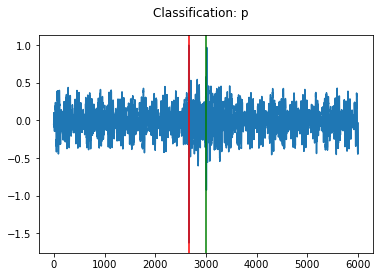

for 1:1
2
2018-10-17T10:44:06.572483Z


<Figure size 432x288 with 0 Axes>

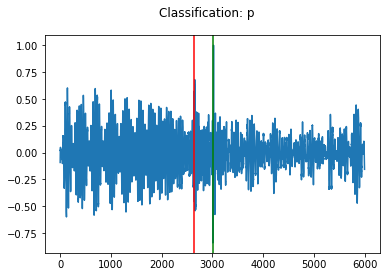

for 2:1
2
2018-10-17T10:44:19.299796Z


<Figure size 432x288 with 0 Axes>

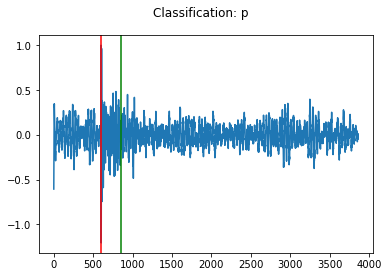

for 3:1
2
2018-10-17T10:46:22.151227Z


<Figure size 432x288 with 0 Axes>

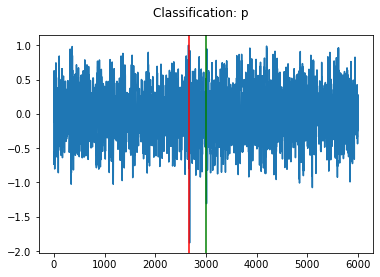

for 4:1
2
2018-10-17T10:47:01.083957Z


<Figure size 432x288 with 0 Axes>

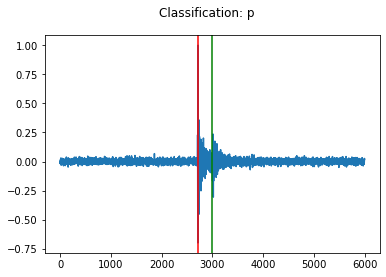

for 5:1
2
2018-10-17T10:48:49.666153Z


<Figure size 432x288 with 0 Axes>

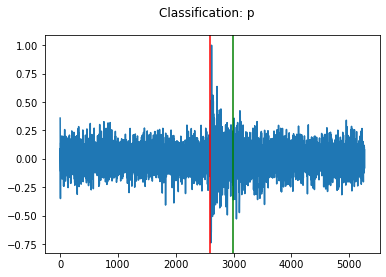

for 6:1
2
2018-10-17T10:54:21.868852Z


<Figure size 432x288 with 0 Axes>

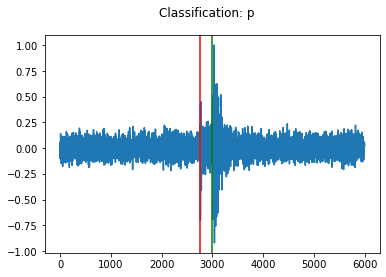

for 7:2
4
2018-10-23T14:22:12.817697Z


<Figure size 432x288 with 0 Axes>

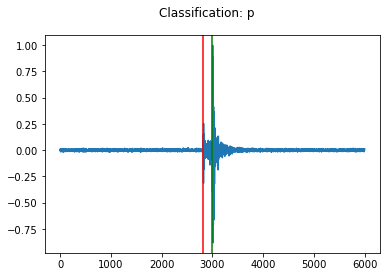

for 8:1
2
2018-10-23T14:27:16.127296Z


<Figure size 432x288 with 0 Axes>

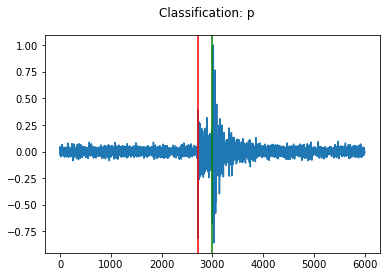

for 9:2
3
2018-10-23T14:30:57.305669Z


<Figure size 432x288 with 0 Axes>

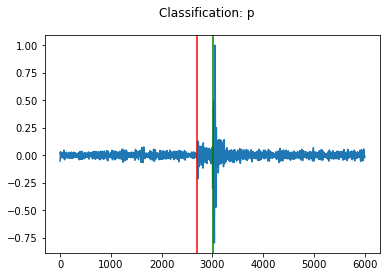

for 10:1
2
2018-10-23T14:35:43.946102Z


<Figure size 432x288 with 0 Axes>

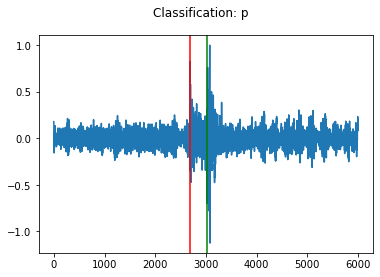

for 11:1
2
2018-10-23T14:36:15.795023Z


<Figure size 432x288 with 0 Axes>

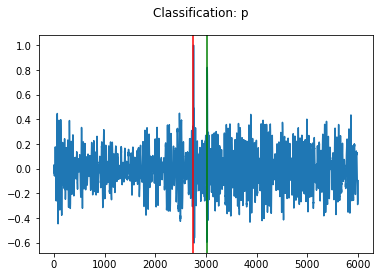

for 12:1
3
2018-10-23T14:36:50.665293Z


<Figure size 432x288 with 0 Axes>

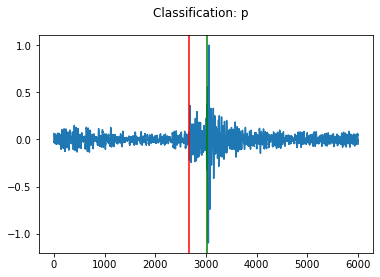

for 13:1
2
2018-10-23T14:37:29.276876Z


<Figure size 432x288 with 0 Axes>

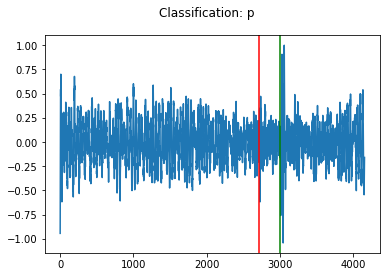

for 14:1
2
2018-10-23T14:38:07.056302Z


<Figure size 432x288 with 0 Axes>

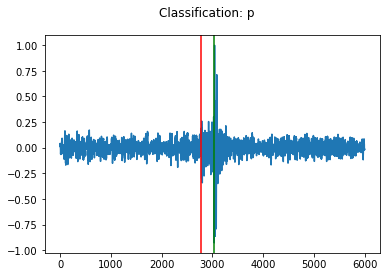

for 15:1
2
2018-10-23T14:39:14.087327Z


<Figure size 432x288 with 0 Axes>

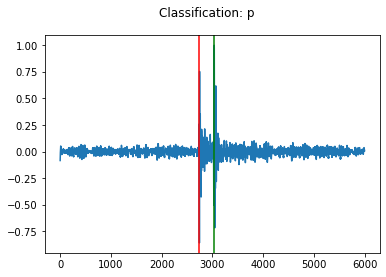

for 16:1
2
2018-10-23T14:39:20.668372Z


<Figure size 432x288 with 0 Axes>

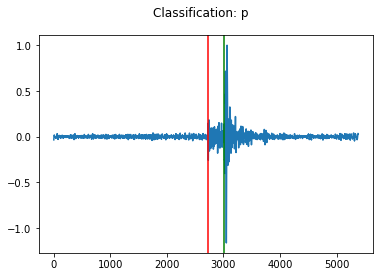

for 17:2
3
2018-10-23T14:40:34.403000Z


<Figure size 432x288 with 0 Axes>

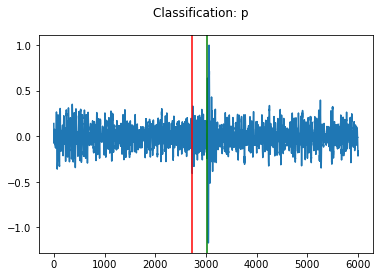

for 18:1
2
2018-10-23T14:41:41.137625Z


<Figure size 432x288 with 0 Axes>

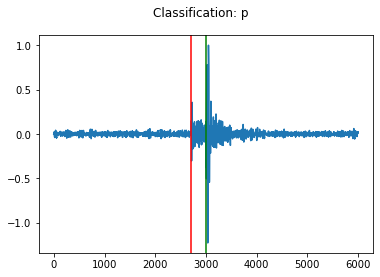

for 19:1
2
2018-10-23T14:41:50.364001Z


<Figure size 432x288 with 0 Axes>

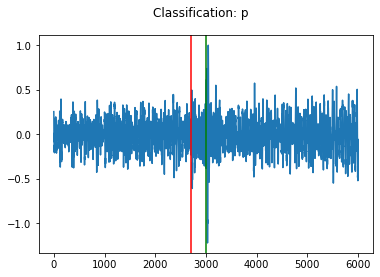

for 20:1
2
2018-10-23T14:41:53.380754Z


<Figure size 432x288 with 0 Axes>

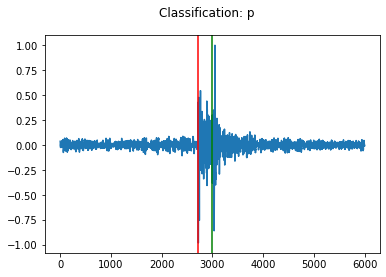

for 21:1
2
2018-10-23T14:44:25.324501Z


<Figure size 432x288 with 0 Axes>

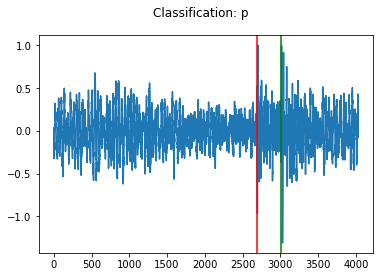

for 22:1
2
2018-10-23T14:44:29.444719Z


<Figure size 432x288 with 0 Axes>

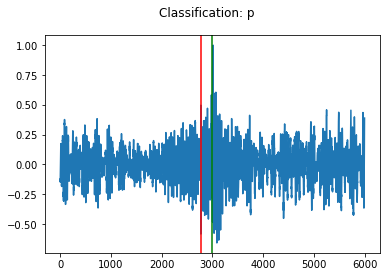

for 23:1
2
2018-10-23T14:44:35.731000Z


<Figure size 432x288 with 0 Axes>

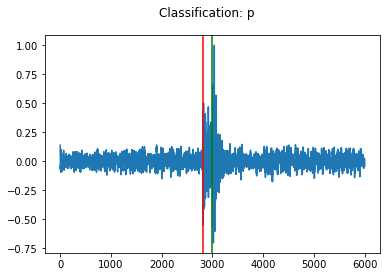

for 24:1
2
2018-10-23T14:44:37.540141Z


<Figure size 432x288 with 0 Axes>

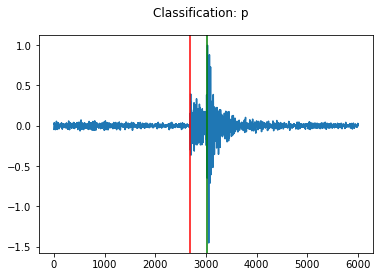

for 25:2
3
2018-10-23T14:44:44.536276Z


<Figure size 432x288 with 0 Axes>

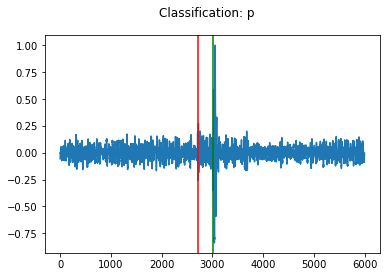

for 26:1
2
2018-10-23T14:34:59.967670Z


<Figure size 432x288 with 0 Axes>

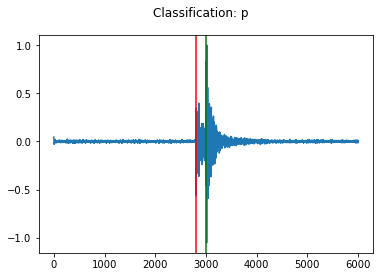

for 27:1
2
2018-10-23T14:45:32.791670Z


<Figure size 432x288 with 0 Axes>

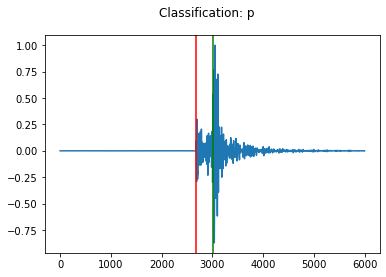

for 28:1
2
2018-10-23T14:45:40.266110Z


<Figure size 432x288 with 0 Axes>

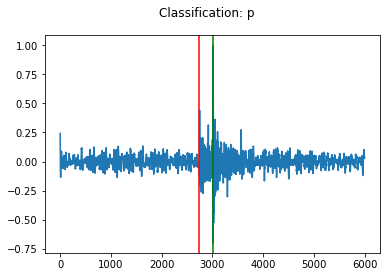

for 29:1
2
2018-10-23T14:45:44.157500Z


<Figure size 432x288 with 0 Axes>

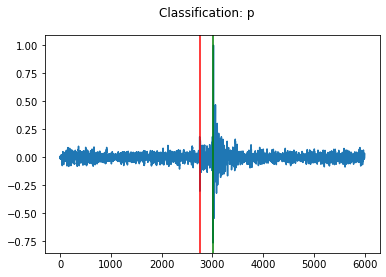

for 30:2
3
2018-10-23T14:42:01.529500Z


<Figure size 432x288 with 0 Axes>

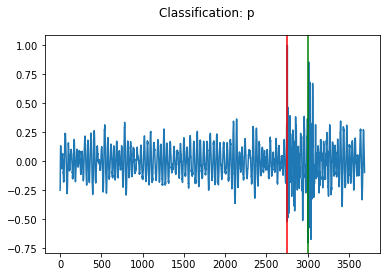

for 31:1
2
2018-10-23T14:48:46.351333Z


<Figure size 432x288 with 0 Axes>

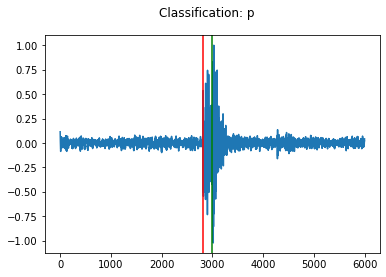

for 32:1
2
2018-10-23T14:49:00.605501Z


<Figure size 432x288 with 0 Axes>

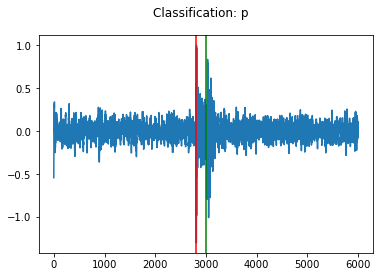

for 33:1
2
2018-10-23T14:49:48.966822Z


<Figure size 432x288 with 0 Axes>

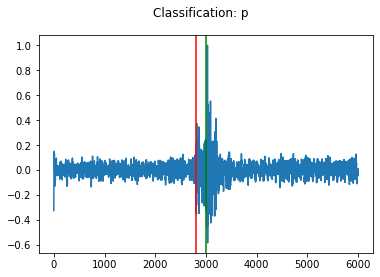

for 34:2
4
2018-10-23T14:51:51.780492Z


<Figure size 432x288 with 0 Axes>

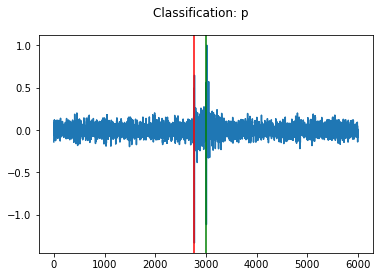

for 35:2
4
2018-10-23T14:52:02.484999Z


<Figure size 432x288 with 0 Axes>

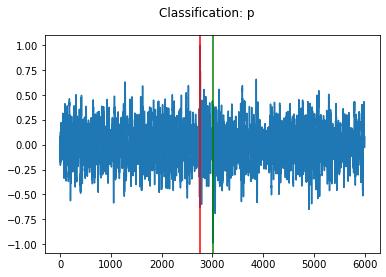

for 36:1
2
2018-10-23T14:52:36.282500Z


<Figure size 432x288 with 0 Axes>

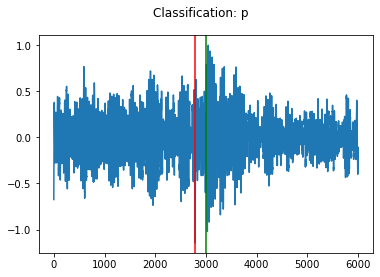

for 37:2
3
2018-10-23T14:53:38.671001Z


<Figure size 432x288 with 0 Axes>

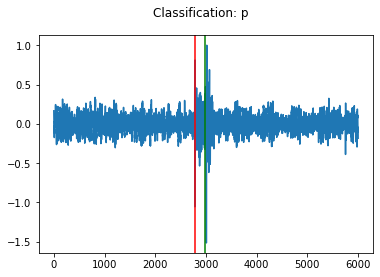

for 38:3
6
2018-10-23T14:53:42.281478Z


<Figure size 432x288 with 0 Axes>

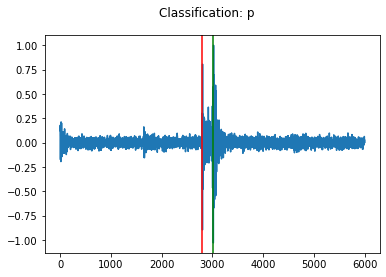

for 39:2
3
2018-10-23T14:54:25.141013Z


<Figure size 432x288 with 0 Axes>

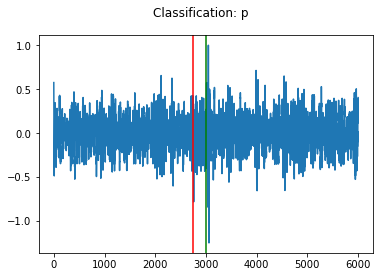

for 40:2
4
2018-10-23T14:55:58.016572Z


<Figure size 432x288 with 0 Axes>

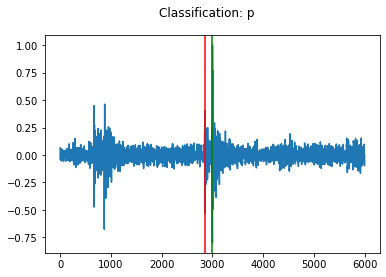

for 41:1
2
2018-10-23T14:56:27.626500Z


<Figure size 432x288 with 0 Axes>

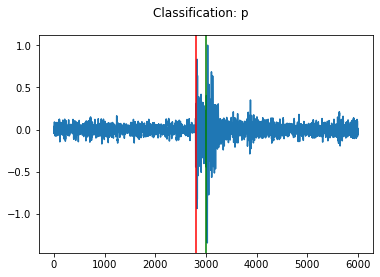

for 42:2
3
2018-10-23T14:57:04.338996Z


<Figure size 432x288 with 0 Axes>

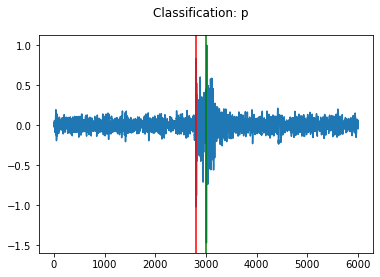

for 43:3
7
2018-10-23T14:57:33.832999Z


<Figure size 432x288 with 0 Axes>

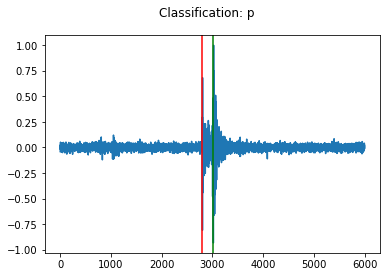

for 44:2
3
2018-10-23T14:57:41.061501Z


<Figure size 432x288 with 0 Axes>

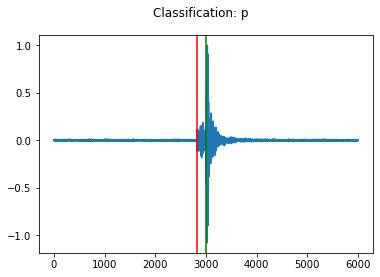

for 45:1
2
2018-10-23T14:57:49.520499Z


<Figure size 432x288 with 0 Axes>

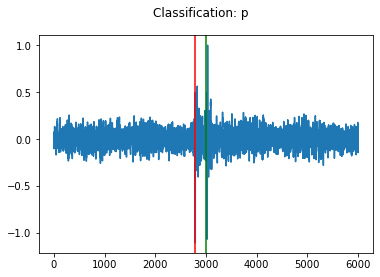

for 46:1
2
2018-10-23T14:58:02.146001Z


<Figure size 432x288 with 0 Axes>

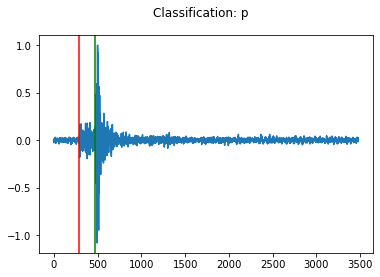

for 47:1
2
2018-10-23T14:58:05.918501Z


<Figure size 432x288 with 0 Axes>

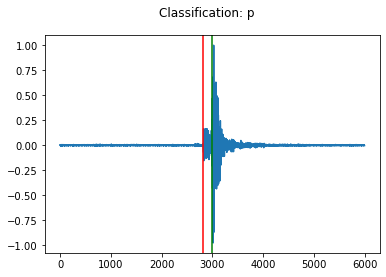

for 48:1
2
2018-10-23T14:58:39.214893Z


<Figure size 432x288 with 0 Axes>

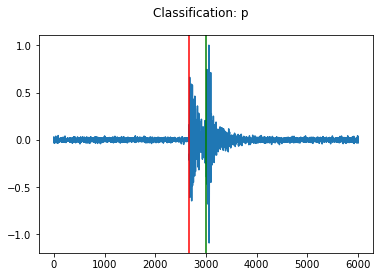

for 49:1
2
2018-10-23T14:58:48.747501Z


<Figure size 432x288 with 0 Axes>

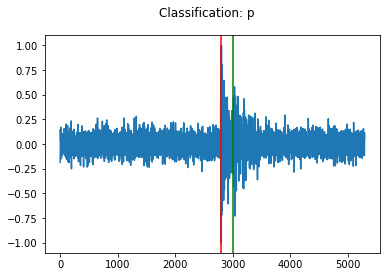

for 50:4
7
2018-10-23T14:59:02.840000Z


<Figure size 432x288 with 0 Axes>

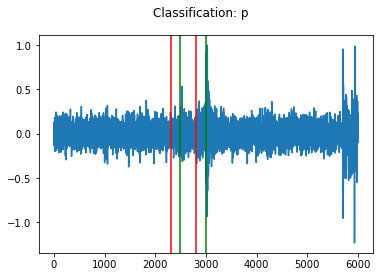

for 51:2
5
2018-10-23T14:59:16.811999Z


<Figure size 432x288 with 0 Axes>

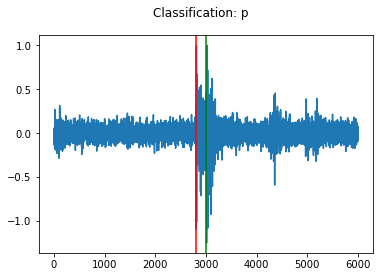

for 52:4
8
2018-10-23T14:59:19.305999Z


<Figure size 432x288 with 0 Axes>

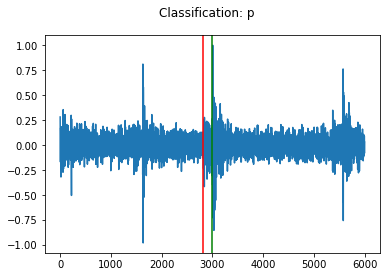

for 53:1
2
2018-10-23T14:59:24.748624Z


<Figure size 432x288 with 0 Axes>

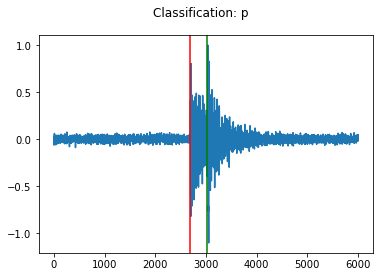

for 54:1
2
2018-10-23T14:59:29.086514Z


<Figure size 432x288 with 0 Axes>

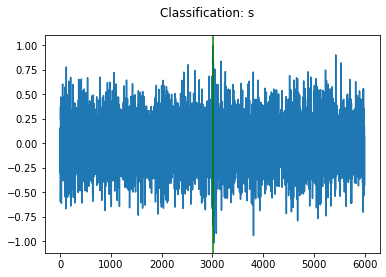

for 55:0
0
2018-10-23T14:59:37.794000Z


<Figure size 432x288 with 0 Axes>

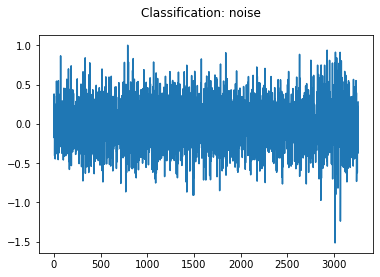

for 56:1
3
2018-10-23T14:59:38.425500Z


<Figure size 432x288 with 0 Axes>

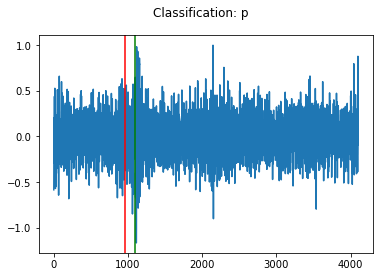

for 57:1
2
2018-10-29T09:07:44.643459Z


<Figure size 432x288 with 0 Axes>

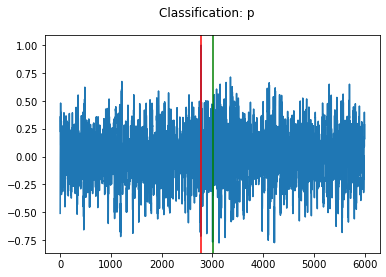

for 58:1
2
2018-10-29T09:11:10.254020Z


<Figure size 432x288 with 0 Axes>

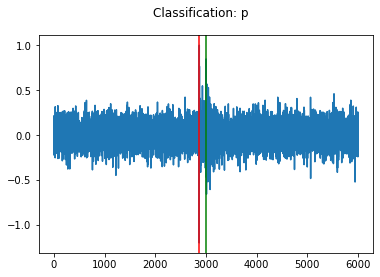

for 59:1
2
2018-10-29T09:11:28.526414Z


<Figure size 432x288 with 0 Axes>

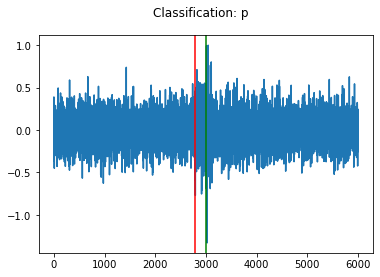

for 60:1
2
2018-10-29T09:13:16.337352Z


<Figure size 432x288 with 0 Axes>

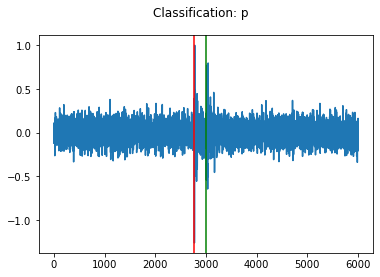

for 61:1
2
2018-10-29T09:13:27.369081Z


<Figure size 432x288 with 0 Axes>

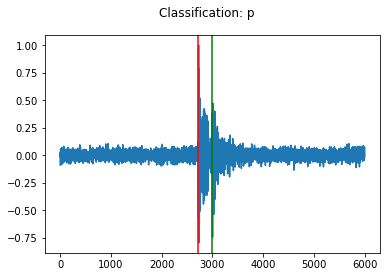

for 62:1
2
2018-10-29T09:17:59.615387Z


<Figure size 432x288 with 0 Axes>

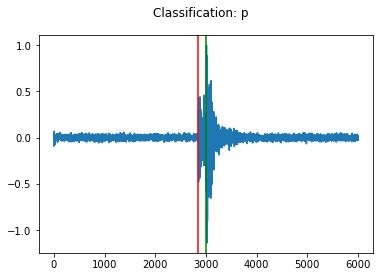

for 63:1
2
2018-10-29T09:24:15.774174Z


<Figure size 432x288 with 0 Axes>

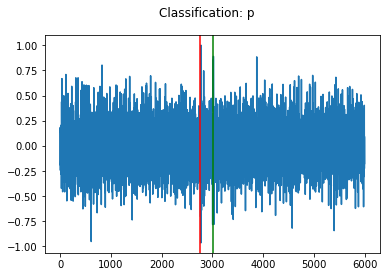

for 64:1
2
2018-10-29T09:26:05.926933Z


<Figure size 432x288 with 0 Axes>

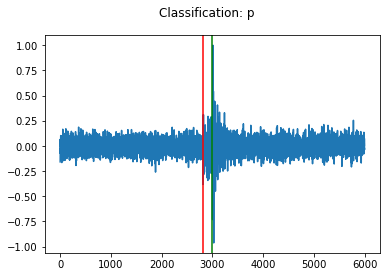

for 65:1
2
2018-10-29T09:29:51.416275Z


<Figure size 432x288 with 0 Axes>

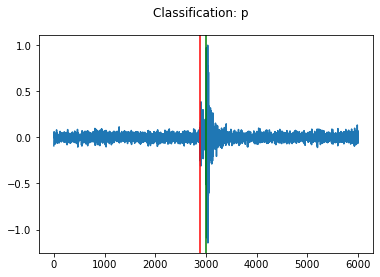

for 66:2
3
2018-10-29T09:30:20.500192Z


<Figure size 432x288 with 0 Axes>

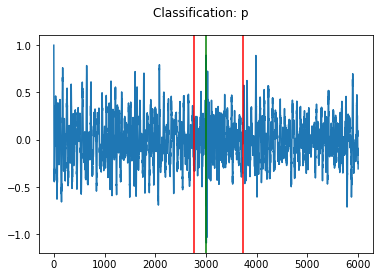

for 67:2
3
2018-10-29T09:31:18.404956Z


<Figure size 432x288 with 0 Axes>

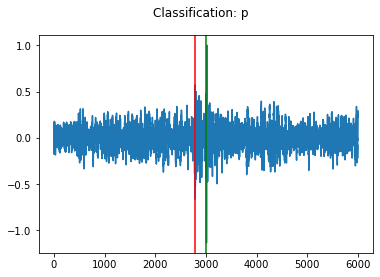

for 68:1
2
2018-10-29T09:31:40.936847Z


<Figure size 432x288 with 0 Axes>

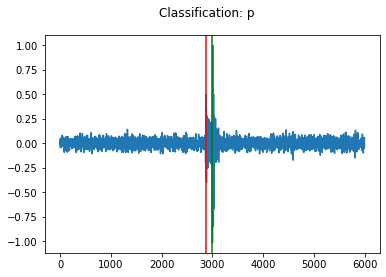

for 69:3
4
2018-10-29T09:31:48.083910Z


<Figure size 432x288 with 0 Axes>

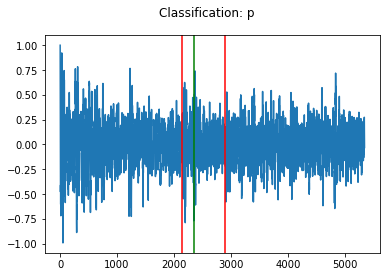

for 70:1
2
2018-10-29T09:31:50.477337Z


<Figure size 432x288 with 0 Axes>

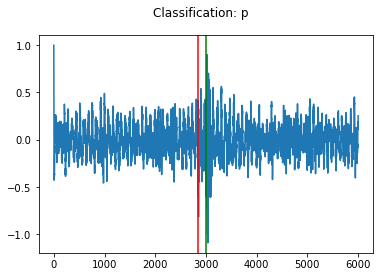

for 71:1
2
2018-10-29T09:31:58.929528Z


<Figure size 432x288 with 0 Axes>

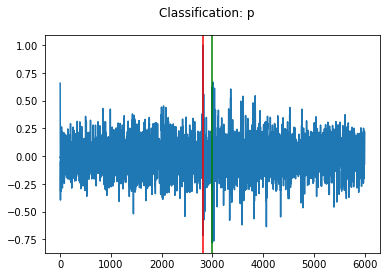

for 72:1
2
2018-10-29T09:32:39.978250Z


<Figure size 432x288 with 0 Axes>

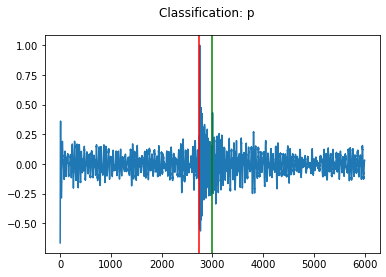

for 73:1
2
2018-10-29T09:50:49.513060Z


<Figure size 432x288 with 0 Axes>

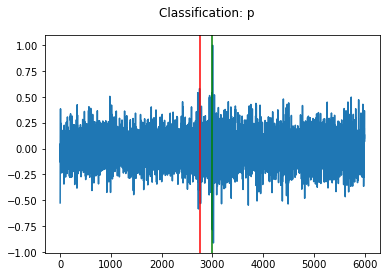

for 74:1
2
2018-10-29T09:53:28.841347Z


<Figure size 432x288 with 0 Axes>

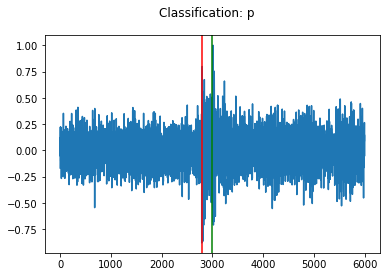

for 75:1
2
2018-10-29T09:57:34.818267Z


<Figure size 432x288 with 0 Axes>

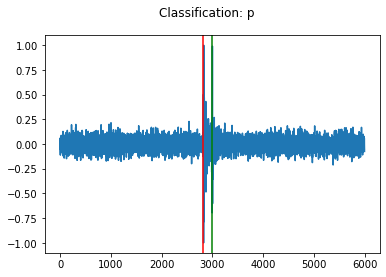

for 76:2
3
2018-10-29T09:58:53.263098Z


<Figure size 432x288 with 0 Axes>

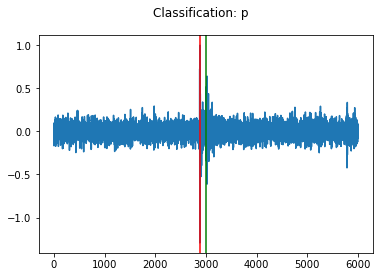

for 77:1
2
2018-10-29T09:59:25.915310Z


<Figure size 432x288 with 0 Axes>

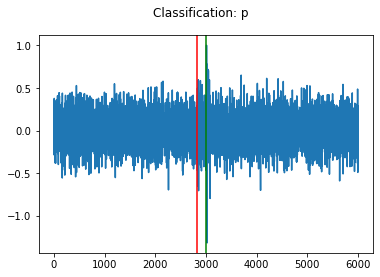

for 78:1
2
2018-10-29T09:59:31.422156Z


<Figure size 432x288 with 0 Axes>

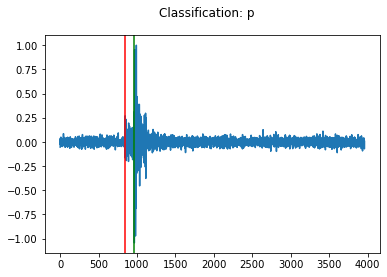

for 79:2
4
2018-12-11T09:19:19.330001Z


<Figure size 432x288 with 0 Axes>

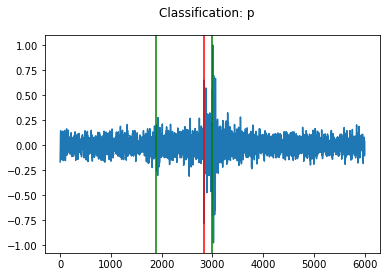

for 80:1
2
2018-12-11T09:22:29.117658Z


<Figure size 432x288 with 0 Axes>

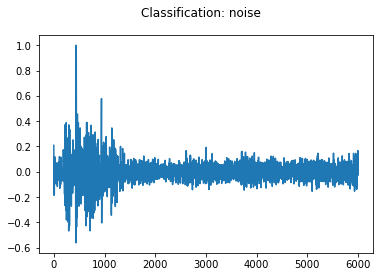

for 81:2
4
2018-12-11T09:25:21.915001Z


<Figure size 432x288 with 0 Axes>

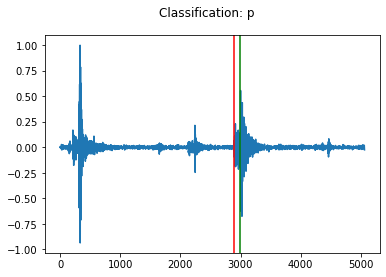

for 82:2
3
2018-12-11T09:25:56.050501Z


<Figure size 432x288 with 0 Axes>

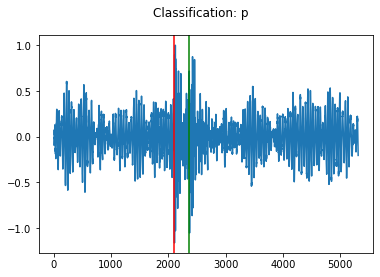

for 83:1
2
2018-12-11T09:27:07.731999Z


<Figure size 432x288 with 0 Axes>

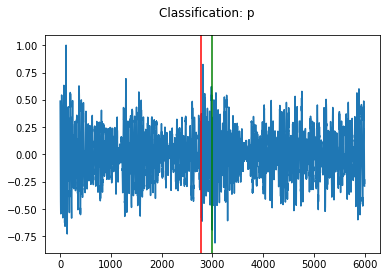

for 84:2
4
2018-12-11T09:27:26.409002Z


<Figure size 432x288 with 0 Axes>

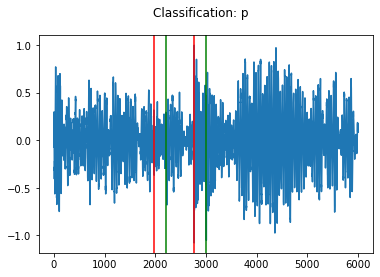

for 85:1
3
2018-12-11T09:28:28.721000Z


<Figure size 432x288 with 0 Axes>

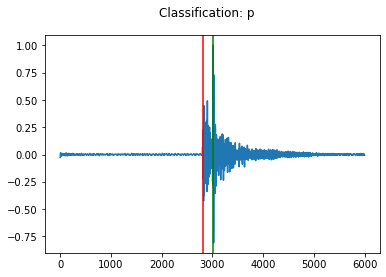

for 86:1
4
2018-12-11T09:33:02.932002Z


<Figure size 432x288 with 0 Axes>

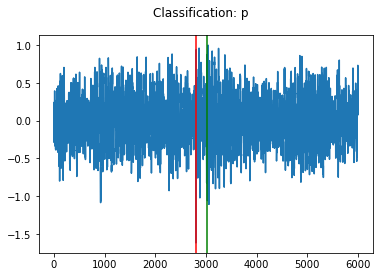

for 87:2
4
2018-12-11T09:33:41.199497Z


<Figure size 432x288 with 0 Axes>

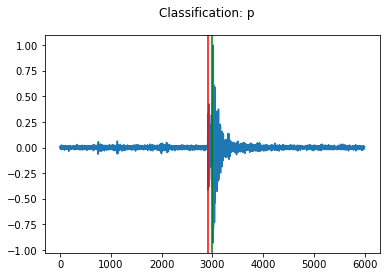

for 88:1
4
2018-12-11T09:37:45.932116Z


<Figure size 432x288 with 0 Axes>

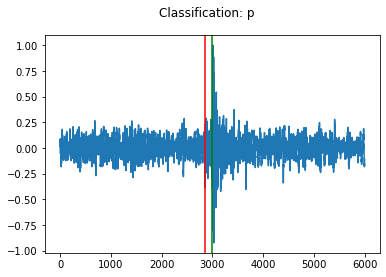

for 89:2
3
2018-12-11T09:41:22.845110Z


<Figure size 432x288 with 0 Axes>

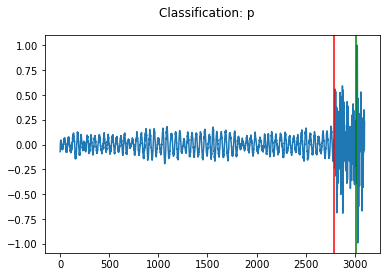

for 90:2
4
2018-12-11T09:42:20.740003Z


<Figure size 432x288 with 0 Axes>

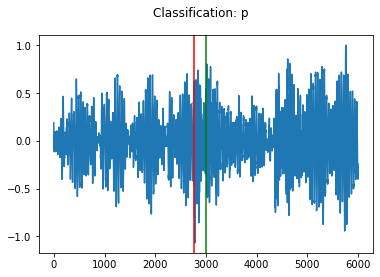

for 91:1
2
2018-12-11T09:43:38.506276Z


<Figure size 432x288 with 0 Axes>

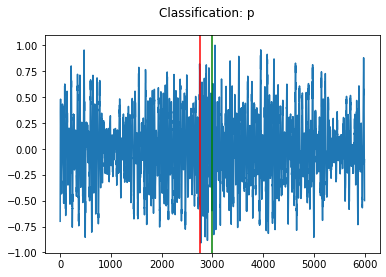

for 92:1
2
2018-12-11T09:50:33.846501Z


<Figure size 432x288 with 0 Axes>

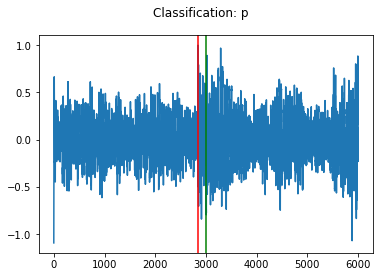

for 93:1
1
2018-12-11T09:50:50.095503Z


<Figure size 432x288 with 0 Axes>

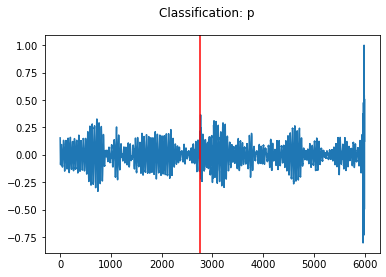

for 94:2
4
2018-12-11T09:52:46.646497Z


<Figure size 432x288 with 0 Axes>

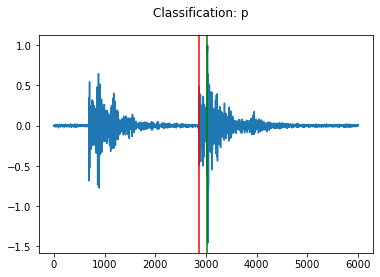

for 95:4
7
2018-12-11T09:54:57.795501Z


<Figure size 432x288 with 0 Axes>

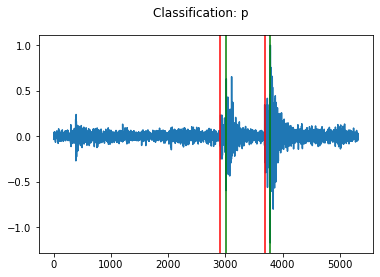

for 96:2
4
2018-12-11T09:55:23.110502Z


<Figure size 432x288 with 0 Axes>

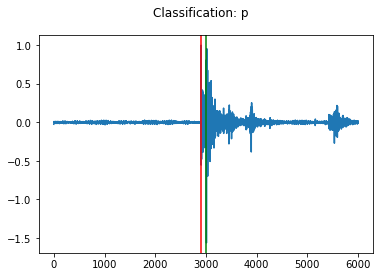

for 97:2
4
2018-12-11T09:55:58.204001Z


<Figure size 432x288 with 0 Axes>

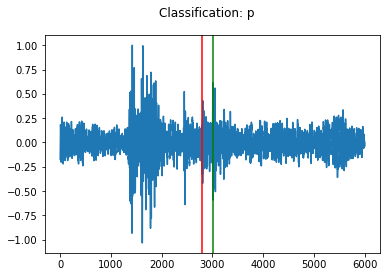

for 98:2
4
2018-12-11T09:57:28.467947Z


<Figure size 432x288 with 0 Axes>

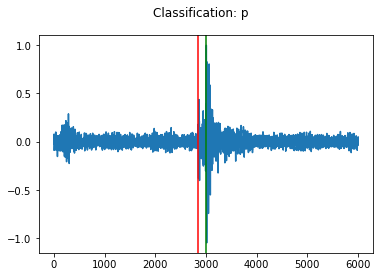

for 99:2
4
2018-12-11T09:59:12.796001Z


<Figure size 432x288 with 0 Axes>

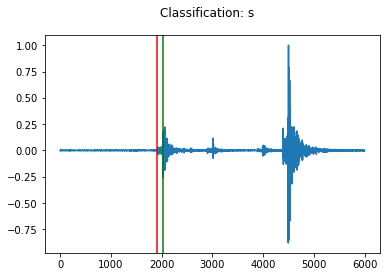

for 100:1
2
2018-12-11T11:21:15.789824Z


<Figure size 432x288 with 0 Axes>

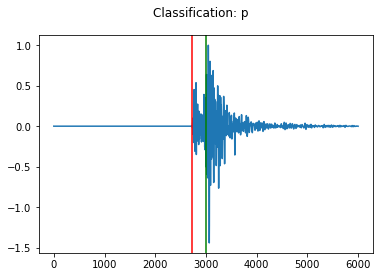

for 101:2
4
2018-10-29T11:30:39.454076Z


<Figure size 432x288 with 0 Axes>

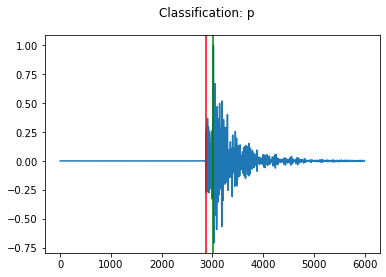

for 102:1
2
2018-10-29T18:01:12.670937Z


<Figure size 432x288 with 0 Axes>

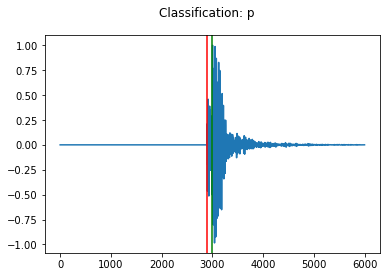

for 103:2
4
2018-10-26T11:36:59.057398Z


<Figure size 432x288 with 0 Axes>

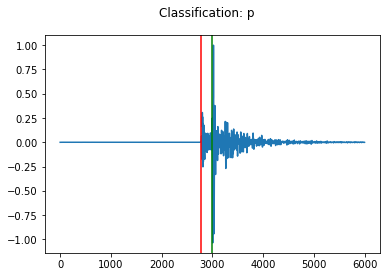

for 104:1
3
2018-10-27T10:55:25.828788Z


<Figure size 432x288 with 0 Axes>

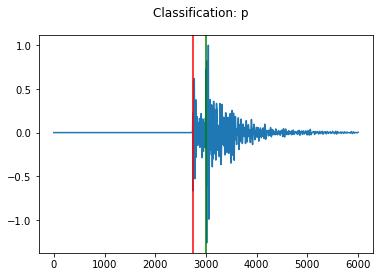

for 105:1
2
2018-11-04T16:24:06.636114Z


<Figure size 432x288 with 0 Axes>

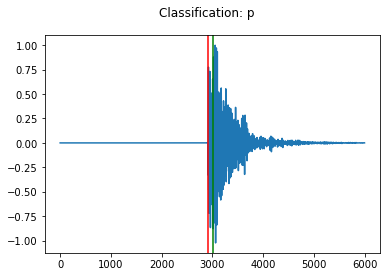

for 106:1
2
2018-10-24T13:02:29.636215Z


<Figure size 432x288 with 0 Axes>

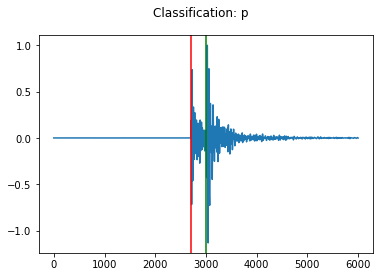

for 107:1
2
2018-10-25T14:59:27.650128Z


<Figure size 432x288 with 0 Axes>

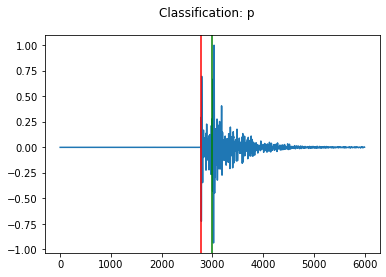

for 108:2
3
2018-10-23T14:45:32.711670Z


<Figure size 432x288 with 0 Axes>

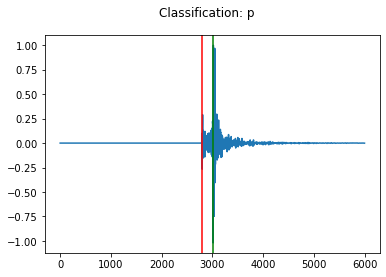

for 109:1
2
2018-12-14T13:41:06.077303Z


<Figure size 432x288 with 0 Axes>

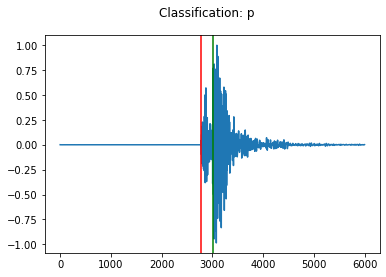

for 110:1
2
2018-10-25T17:00:34.353072Z


<Figure size 432x288 with 0 Axes>

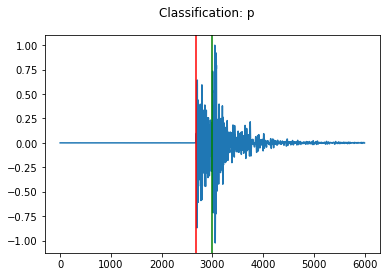

for 111:1
2
2018-10-26T11:26:45.125376Z


<Figure size 432x288 with 0 Axes>

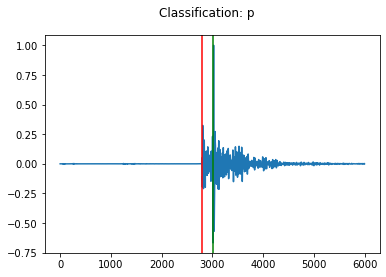

for 112:1
2
2018-12-11T09:53:31.523274Z


<Figure size 432x288 with 0 Axes>

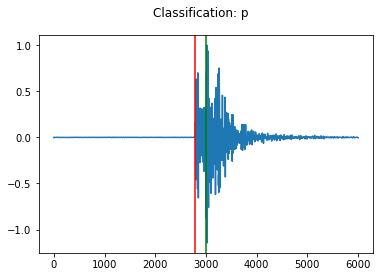

for 113:2
4
2018-10-29T11:58:35.007222Z


<Figure size 432x288 with 0 Axes>

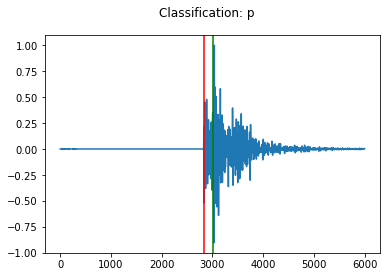

for 114:1
2
2018-12-11T10:06:45.020583Z


<Figure size 432x288 with 0 Axes>

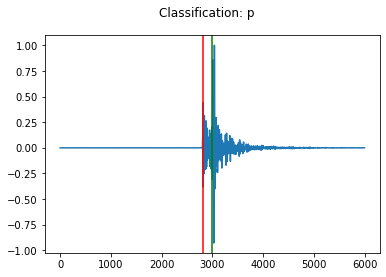

for 115:1
2
2018-12-14T13:09:51.883000Z


<Figure size 432x288 with 0 Axes>

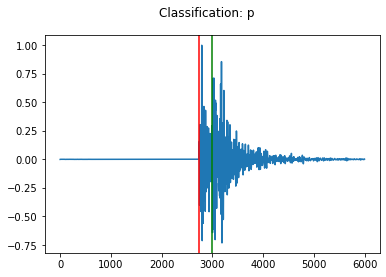

for 116:1
2
2018-12-11T09:35:01.573777Z


<Figure size 432x288 with 0 Axes>

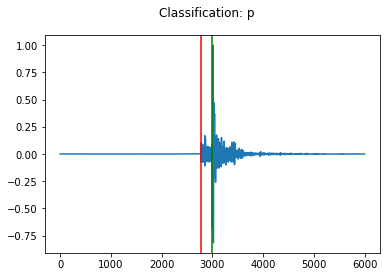

for 117:1
2
2018-10-26T20:39:23.234610Z


<Figure size 432x288 with 0 Axes>

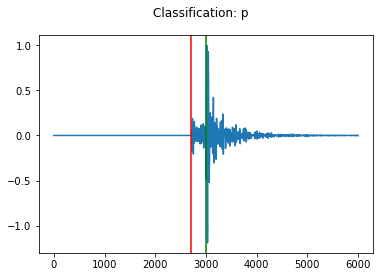

for 118:1
2
2018-10-24T13:26:26.808736Z


<Figure size 432x288 with 0 Axes>

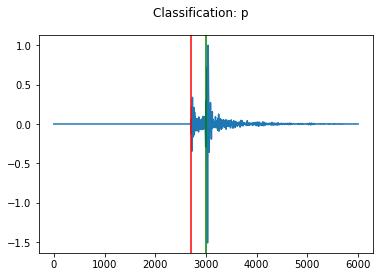

for 119:1
2
2018-12-14T14:51:57.048504Z


<Figure size 432x288 with 0 Axes>

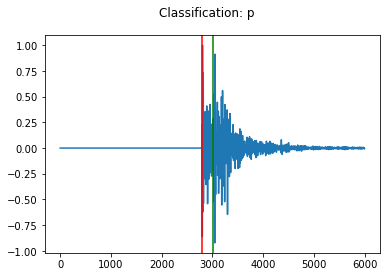

for 120:1
2
2018-12-13T13:25:17.197558Z


<Figure size 432x288 with 0 Axes>

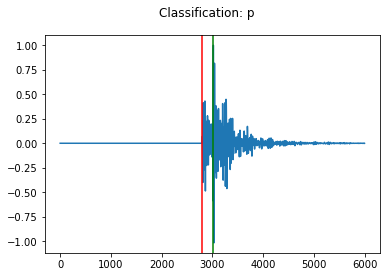

for 121:1
2
2018-12-08T12:28:22.481485Z


<Figure size 432x288 with 0 Axes>

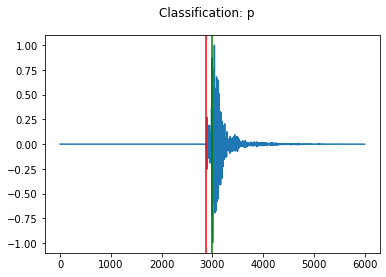

for 122:1
2
2018-10-25T15:06:05.002139Z


<Figure size 432x288 with 0 Axes>

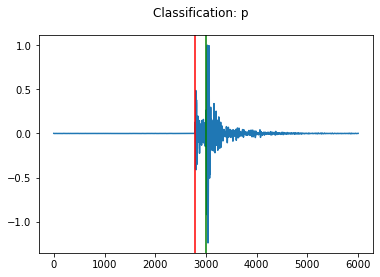

for 123:1
2
2018-10-24T23:56:13.326137Z


<Figure size 432x288 with 0 Axes>

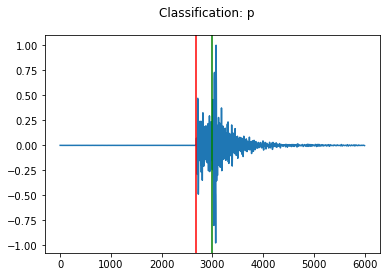

for 124:1
2
2018-10-25T12:40:56.946937Z


<Figure size 432x288 with 0 Axes>

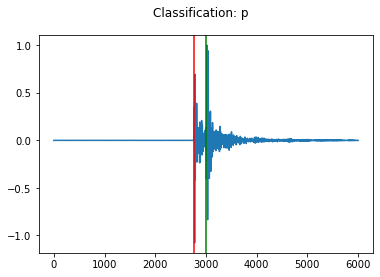

for 125:1
2
2018-10-18T15:48:53.843427Z


<Figure size 432x288 with 0 Axes>

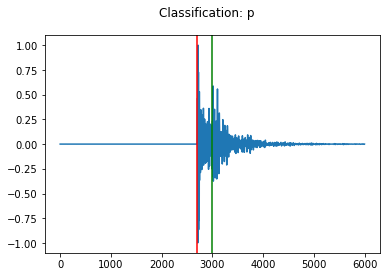

for 126:1
2
2018-12-11T10:34:35.715646Z


<Figure size 432x288 with 0 Axes>

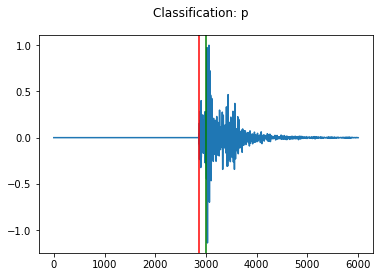

for 127:1
2
2018-10-29T21:13:59.087642Z


<Figure size 432x288 with 0 Axes>

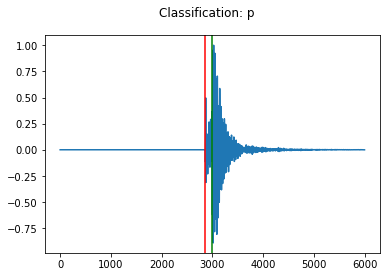

for 128:1
2
2018-10-30T01:37:37.940873Z


<Figure size 432x288 with 0 Axes>

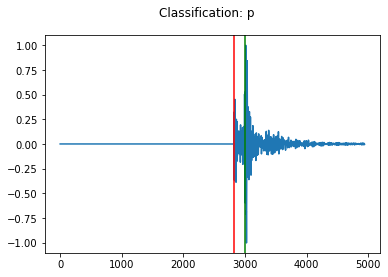

for 129:1
2
2018-10-27T11:44:31.601597Z


<Figure size 432x288 with 0 Axes>

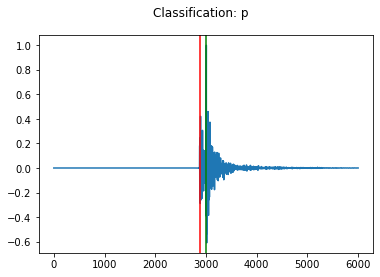

for 130:2
3
2018-12-11T10:18:47.021932Z


<Figure size 432x288 with 0 Axes>

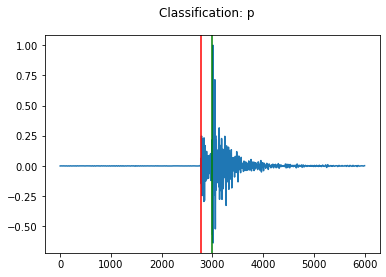

for 131:1
2
2018-10-20T03:44:01.674986Z


<Figure size 432x288 with 0 Axes>

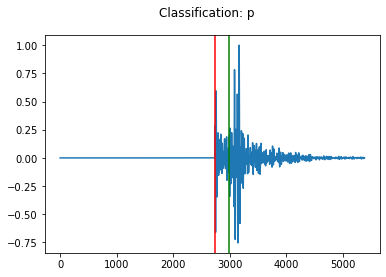

for 132:1
2
2018-10-29T11:44:42.301886Z


<Figure size 432x288 with 0 Axes>

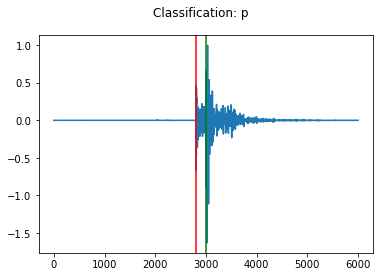

for 133:1
2
2018-10-19T13:20:48.941106Z


<Figure size 432x288 with 0 Axes>

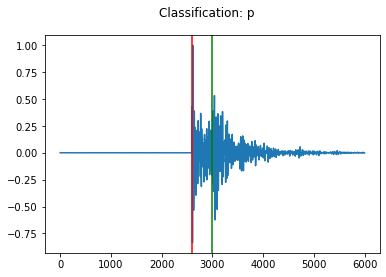

for 134:1
2
2018-10-25T14:56:28.583150Z


<Figure size 432x288 with 0 Axes>

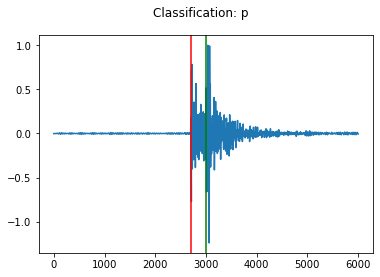

for 135:1
2
2018-10-26T02:13:02.095291Z


<Figure size 432x288 with 0 Axes>

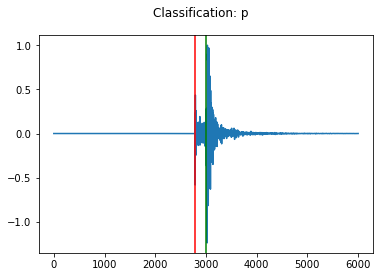

for 136:1
2
2018-12-10T10:30:58.274963Z


<Figure size 432x288 with 0 Axes>

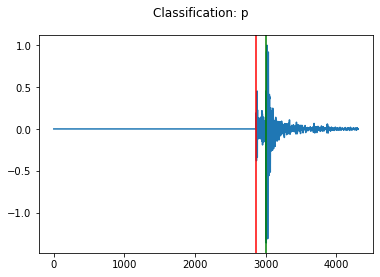

for 137:1
2
2018-12-11T10:20:27.958469Z


<Figure size 432x288 with 0 Axes>

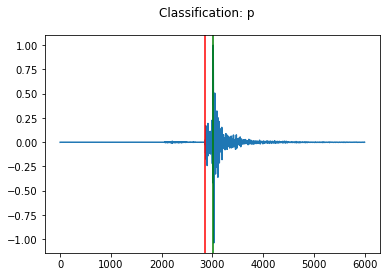

for 138:1
2
2018-10-27T11:07:17.101670Z


<Figure size 432x288 with 0 Axes>

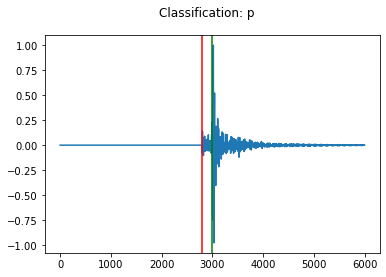

for 139:1
2
2018-12-14T13:06:37.273000Z


<Figure size 432x288 with 0 Axes>

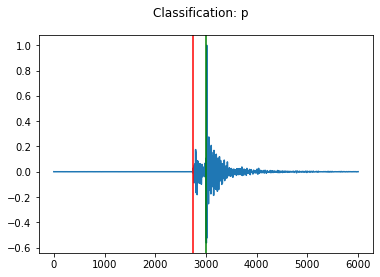

for 140:1
2
2018-10-26T14:14:04.164392Z


<Figure size 432x288 with 0 Axes>

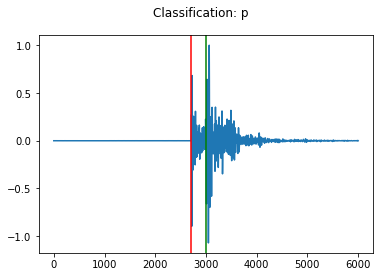

for 141:1
2
2018-10-26T11:17:03.233776Z


<Figure size 432x288 with 0 Axes>

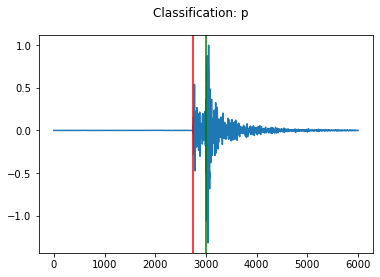

for 142:2
4
2018-12-14T13:18:30.691496Z


<Figure size 432x288 with 0 Axes>

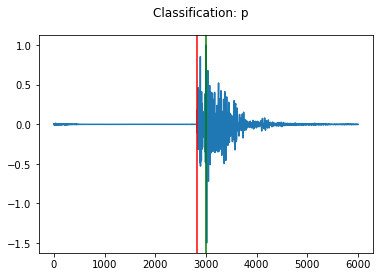

for 143:1
2
2018-12-11T09:34:03.715759Z


<Figure size 432x288 with 0 Axes>

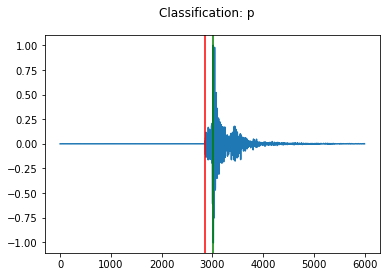

for 144:1
2
2018-10-25T17:04:13.757001Z


<Figure size 432x288 with 0 Axes>

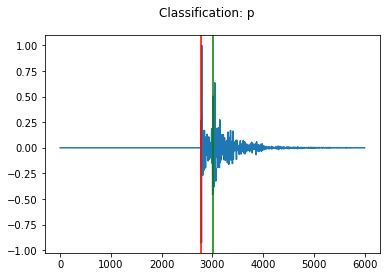

for 145:1
2
2018-10-24T13:19:00.979000Z


<Figure size 432x288 with 0 Axes>

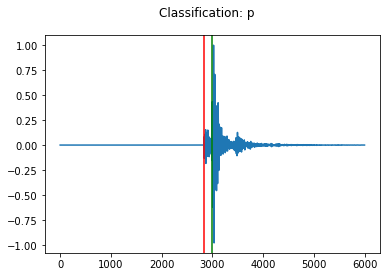

for 146:1
2
2018-10-29T11:43:29.819477Z


<Figure size 432x288 with 0 Axes>

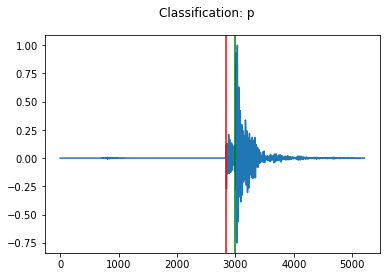

for 147:1
2
2018-10-25T15:24:29.087999Z


<Figure size 432x288 with 0 Axes>

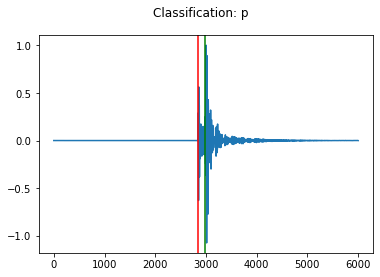

for 148:1
2
2018-10-24T12:57:14.216501Z


<Figure size 432x288 with 0 Axes>

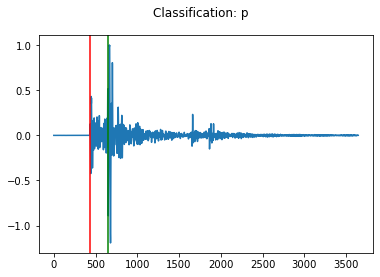

for 149:1
2
2018-10-25T15:22:59.360499Z


<Figure size 432x288 with 0 Axes>

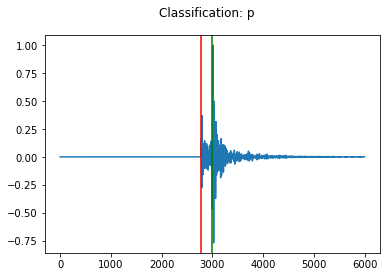

for 150:0
1
2018-12-15T09:40:07.480999Z


<Figure size 432x288 with 0 Axes>

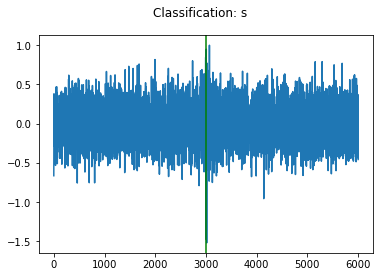

for 151:1
2
2018-12-14T19:22:45.398000Z


<Figure size 432x288 with 0 Axes>

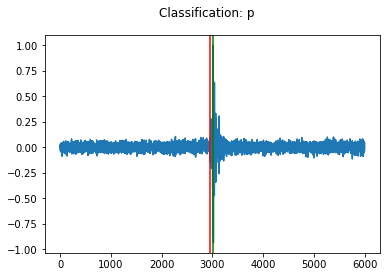

for 152:1
2
2018-12-15T05:14:05.633001Z


<Figure size 432x288 with 0 Axes>

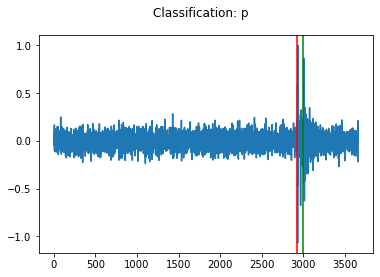

for 153:1
2
2018-12-14T20:17:15.697500Z


<Figure size 432x288 with 0 Axes>

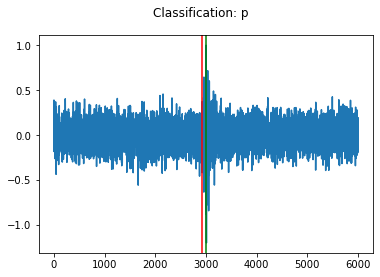

for 154:1
2
2018-12-18T02:37:07.020323Z


<Figure size 432x288 with 0 Axes>

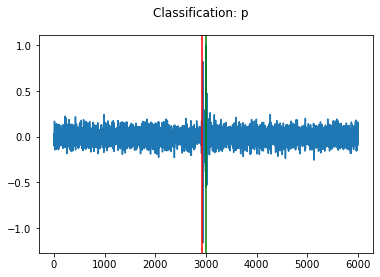

for 155:1
2
2018-12-18T08:08:33.504378Z


<Figure size 432x288 with 0 Axes>

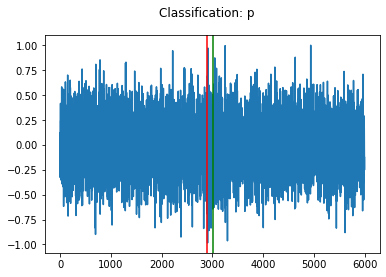

for 156:1
2
2018-12-14T19:05:19.806270Z


<Figure size 432x288 with 0 Axes>

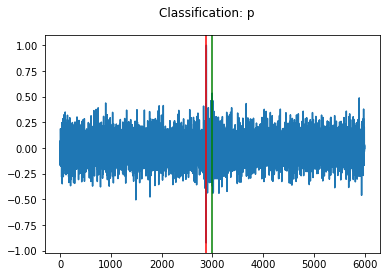

for 157:1
2
2018-12-17T17:53:15.515503Z


<Figure size 432x288 with 0 Axes>

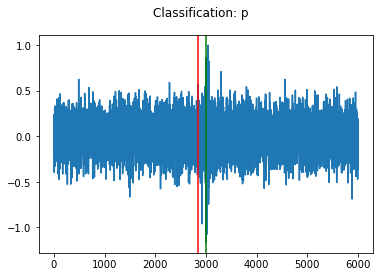

for 158:1
2
2018-12-18T08:09:11.658826Z


<Figure size 432x288 with 0 Axes>

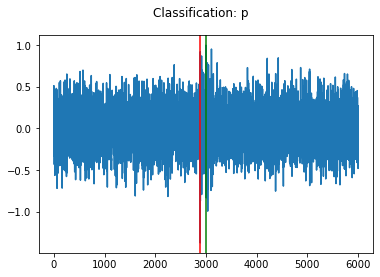

for 159:1
2
2018-12-18T00:16:31.276860Z


<Figure size 432x288 with 0 Axes>

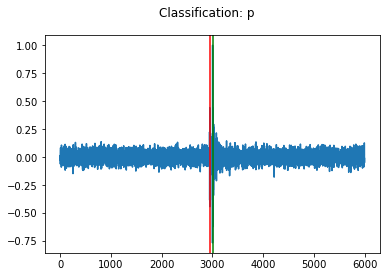

for 160:1
2
2018-12-15T04:24:17.902999Z


<Figure size 432x288 with 0 Axes>

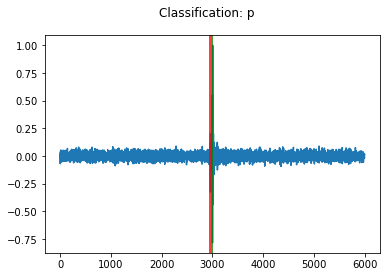

for 161:1
2
2018-12-17T18:23:08.029902Z


<Figure size 432x288 with 0 Axes>

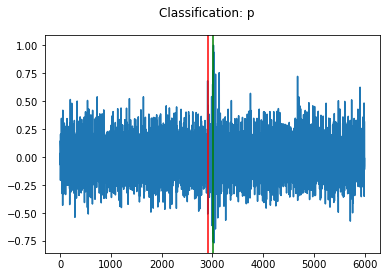

for 162:1
2
2018-12-17T17:35:41.060749Z


<Figure size 432x288 with 0 Axes>

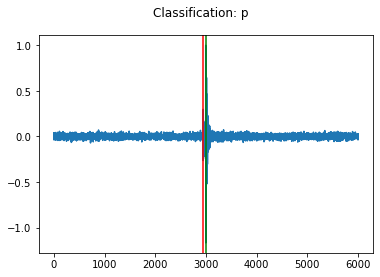

for 163:2
4
2018-12-14T15:45:00.567000Z


<Figure size 432x288 with 0 Axes>

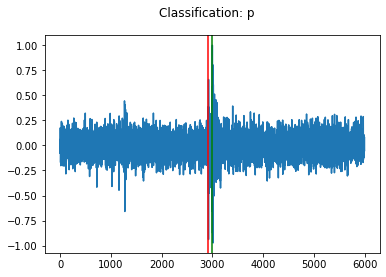

for 164:1
2
2018-12-17T19:39:35.712497Z


<Figure size 432x288 with 0 Axes>

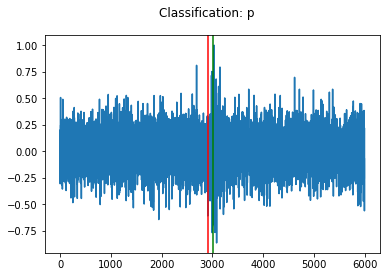

for 165:0
1
2018-12-18T00:20:43.160939Z


<Figure size 432x288 with 0 Axes>

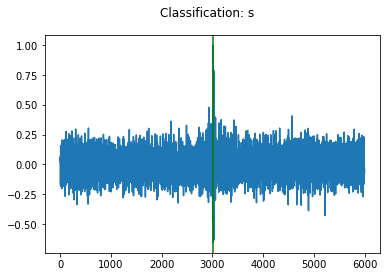

for 166:1
2
2018-12-18T00:39:03.195666Z


<Figure size 432x288 with 0 Axes>

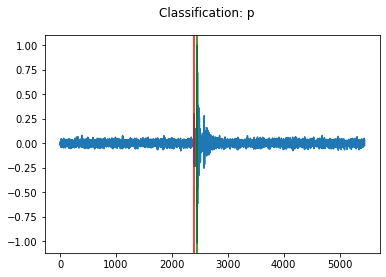

for 167:1
2
2018-12-15T03:05:17.585441Z


<Figure size 432x288 with 0 Axes>

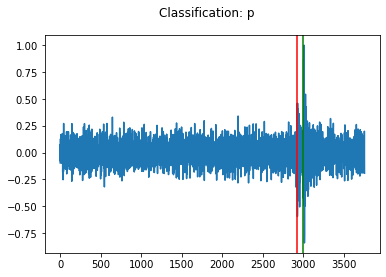

for 168:1
2
2018-12-18T03:38:55.733431Z


<Figure size 432x288 with 0 Axes>

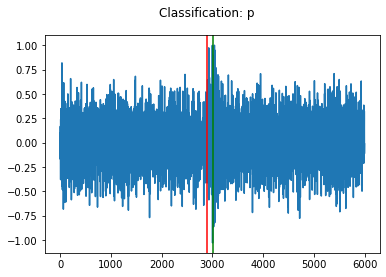

for 169:1
2
2018-12-18T04:16:03.704612Z


<Figure size 432x288 with 0 Axes>

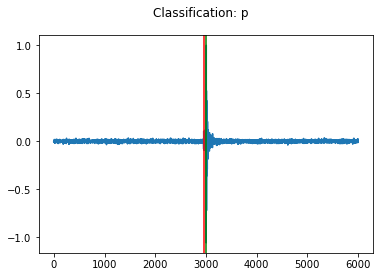

for 170:1
2
2018-12-18T03:49:23.533724Z


<Figure size 432x288 with 0 Axes>

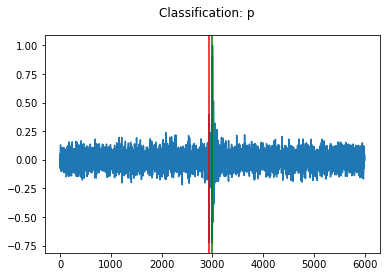

for 171:1
2
2018-12-14T20:53:07.908002Z


<Figure size 432x288 with 0 Axes>

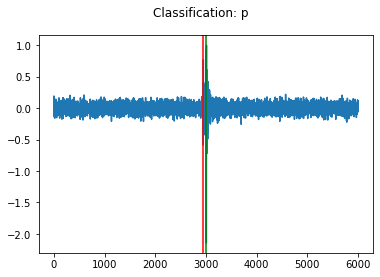

for 172:1
2
2018-12-17T16:25:31.883592Z


<Figure size 432x288 with 0 Axes>

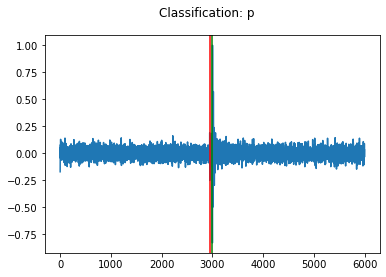

for 173:1
2
2018-12-14T14:59:46.966501Z


<Figure size 432x288 with 0 Axes>

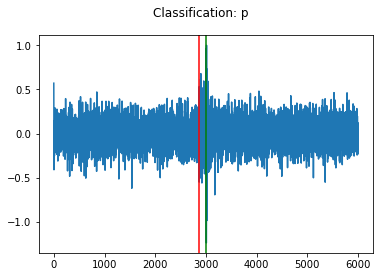

for 174:1
2
2018-12-17T22:22:55.276300Z


<Figure size 432x288 with 0 Axes>

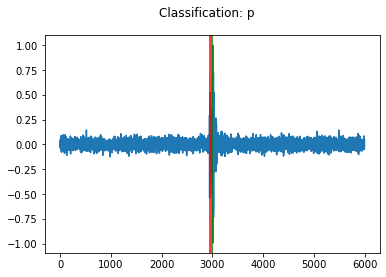

for 175:1
2
2018-12-17T23:33:57.732907Z


<Figure size 432x288 with 0 Axes>

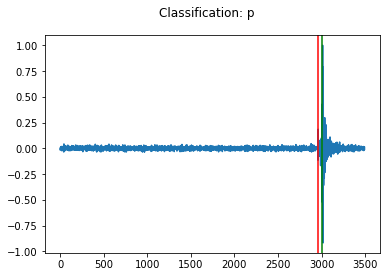

for 176:1
2
2018-12-18T01:05:38.823657Z


<Figure size 432x288 with 0 Axes>

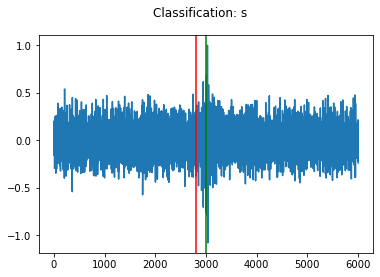

for 177:1
2
2018-12-17T20:33:53.932724Z


<Figure size 432x288 with 0 Axes>

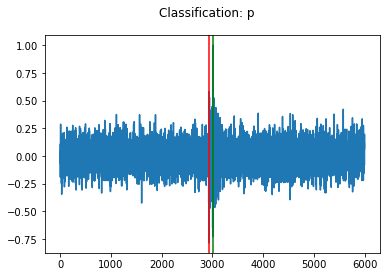

for 178:1
2
2018-12-14T19:41:43.665502Z


<Figure size 432x288 with 0 Axes>

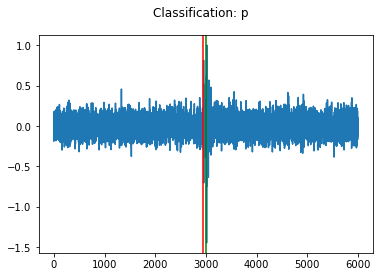

for 179:1
2
2018-12-18T05:43:59.400138Z


<Figure size 432x288 with 0 Axes>

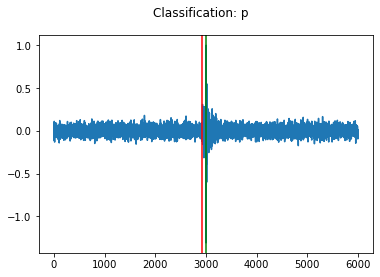

for 180:2
4
2018-12-14T16:34:59.766000Z


<Figure size 432x288 with 0 Axes>

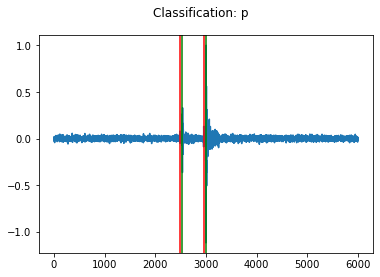

for 181:2
3
2018-12-18T02:14:27.914875Z


<Figure size 432x288 with 0 Axes>

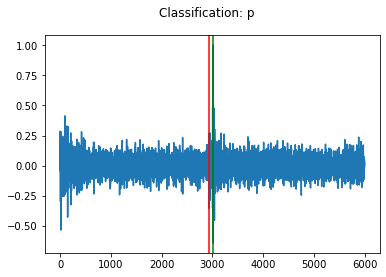

for 182:1
2
2018-12-17T23:51:17.467954Z


<Figure size 432x288 with 0 Axes>

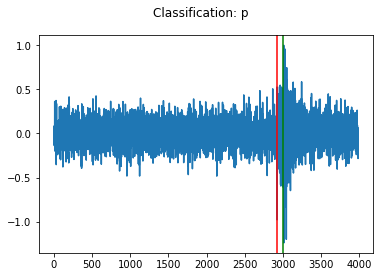

for 183:1
2
2018-12-18T08:22:58.026358Z


<Figure size 432x288 with 0 Axes>

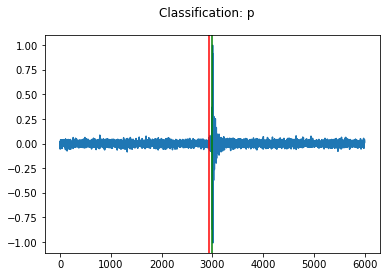

for 184:1
2
2018-12-14T17:22:42.640499Z


<Figure size 432x288 with 0 Axes>

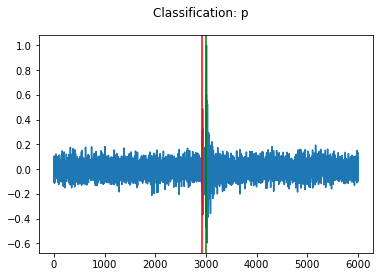

for 185:2
4
2018-12-15T03:03:12.631500Z


<Figure size 432x288 with 0 Axes>

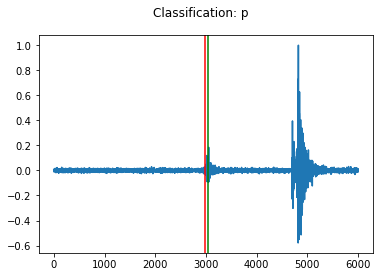

for 186:1
2
2018-12-17T18:35:58.840838Z


<Figure size 432x288 with 0 Axes>

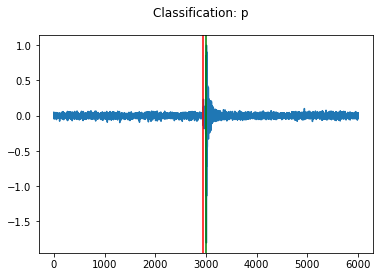

for 187:1
2
2018-12-15T04:53:41.508500Z


<Figure size 432x288 with 0 Axes>

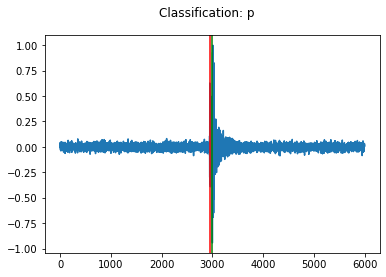

for 188:1
2
2018-12-17T19:46:31.521621Z


<Figure size 432x288 with 0 Axes>

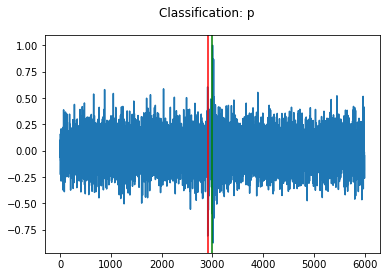

for 189:1
2
2018-12-18T01:06:05.309945Z


<Figure size 432x288 with 0 Axes>

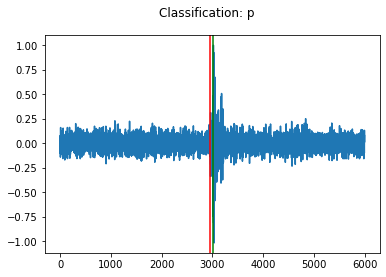

for 190:2
4
2018-12-14T15:03:35.496500Z


<Figure size 432x288 with 0 Axes>

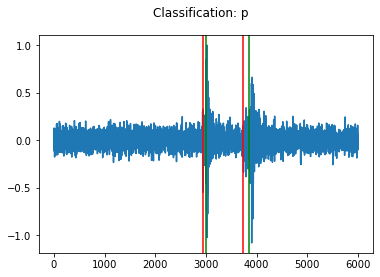

for 191:1
2
2018-12-18T04:02:55.289356Z


<Figure size 432x288 with 0 Axes>

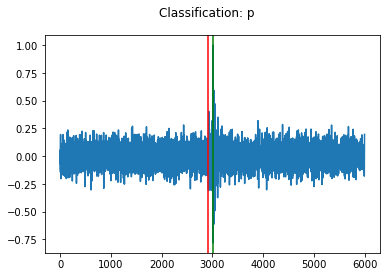

for 192:2
4
2018-12-14T17:35:11.880328Z


<Figure size 432x288 with 0 Axes>

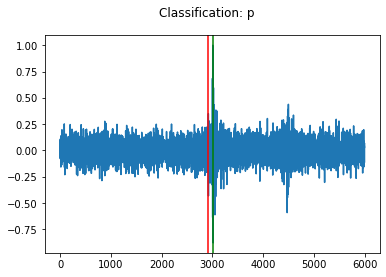

for 193:1
2
2018-12-17T21:07:05.373411Z


<Figure size 432x288 with 0 Axes>

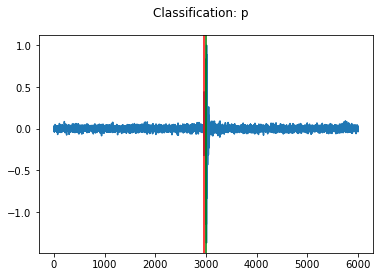

for 194:1
2
2018-12-14T20:25:16.001501Z


<Figure size 432x288 with 0 Axes>

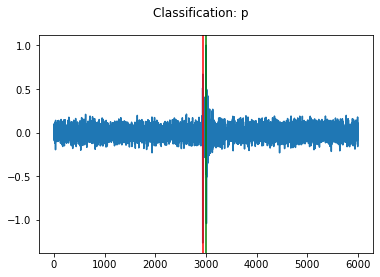

for 195:1
2
2018-12-18T05:28:27.131603Z


<Figure size 432x288 with 0 Axes>

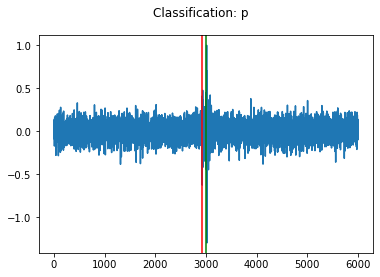

for 196:1
2
2018-12-15T04:40:32.529846Z


<Figure size 432x288 with 0 Axes>

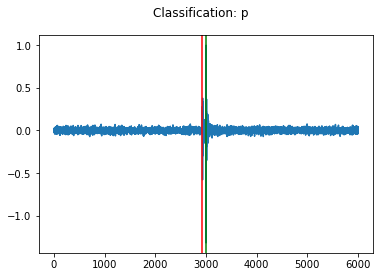

for 197:1
2
2018-12-14T15:59:47.892001Z


<Figure size 432x288 with 0 Axes>

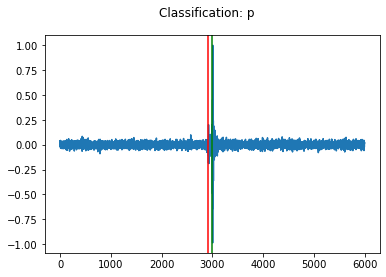

for 198:1
2
2018-12-17T19:05:27.008105Z


<Figure size 432x288 with 0 Axes>

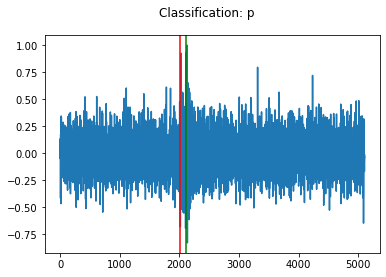

for 199:1
2
2018-12-15T14:18:26.958000Z


<Figure size 432x288 with 0 Axes>

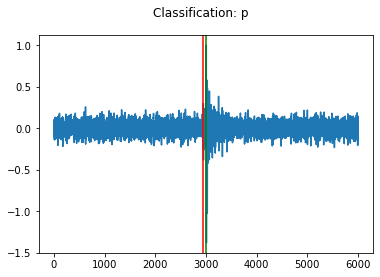

for 200:2
4
2018-10-16T13:50:02.924497Z


<Figure size 432x288 with 0 Axes>

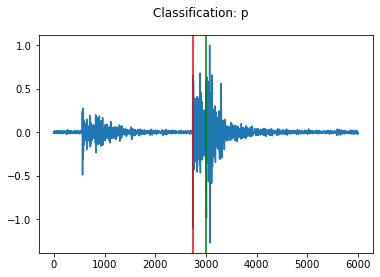

for 201:1
2
2018-10-18T14:36:56.181577Z


<Figure size 432x288 with 0 Axes>

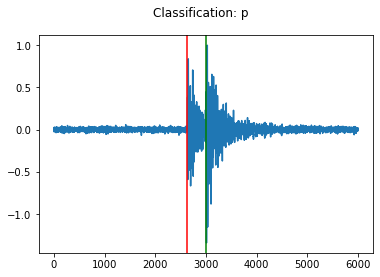

for 202:1
2
2018-10-18T15:28:10.272497Z


<Figure size 432x288 with 0 Axes>

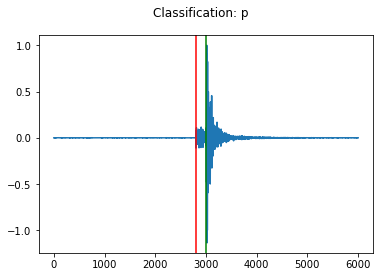

for 203:1
2
2018-10-22T11:50:58.158499Z


<Figure size 432x288 with 0 Axes>

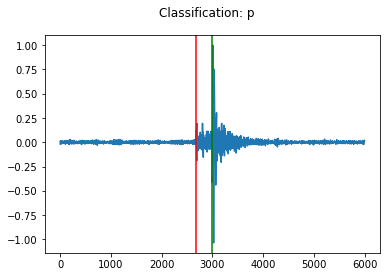

for 204:1
2
2018-10-24T13:39:32.515000Z


<Figure size 432x288 with 0 Axes>

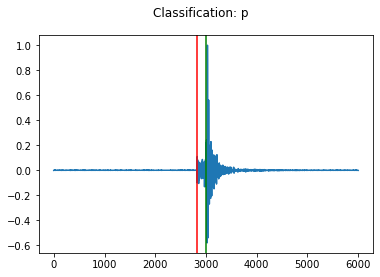

for 205:1
2
2018-10-24T13:50:30.223500Z


<Figure size 432x288 with 0 Axes>

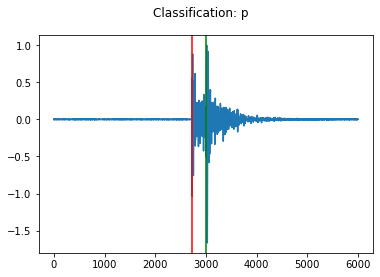

for 206:1
2
2018-10-25T11:35:08.913999Z


<Figure size 432x288 with 0 Axes>

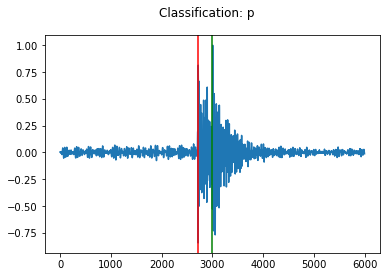

for 207:2
3
2018-10-25T12:06:05.909500Z


<Figure size 432x288 with 0 Axes>

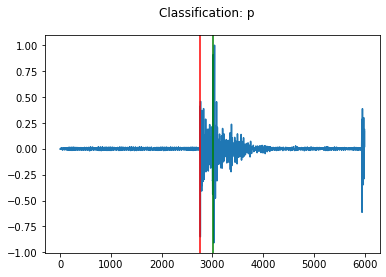

for 208:1
2
2018-10-25T13:06:04.277500Z


<Figure size 432x288 with 0 Axes>

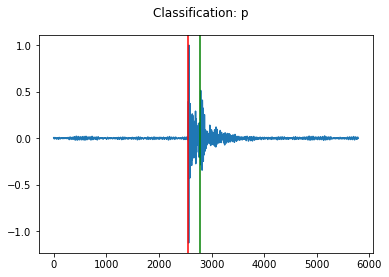

for 209:2
4
2018-10-25T13:24:57.788499Z


<Figure size 432x288 with 0 Axes>

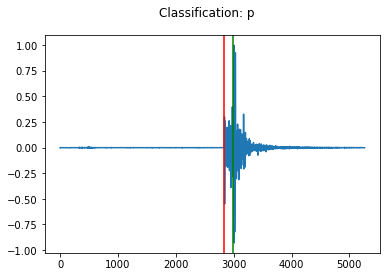

for 210:1
2
2018-10-25T14:51:08.881501Z


<Figure size 432x288 with 0 Axes>

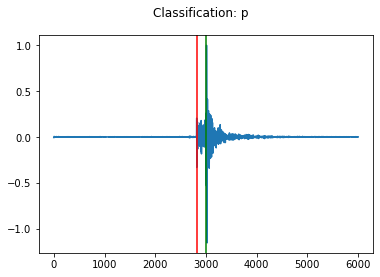

for 211:1
2
2018-10-25T15:21:02.453500Z


<Figure size 432x288 with 0 Axes>

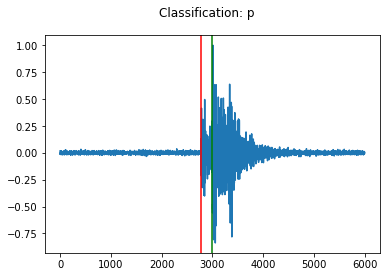

for 212:2
4
2018-10-25T15:29:13.917499Z


<Figure size 432x288 with 0 Axes>

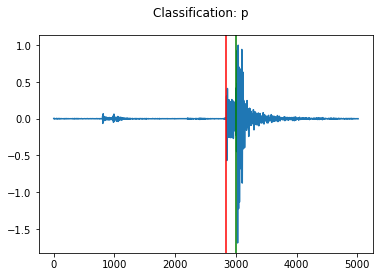

for 213:2
4
2018-10-26T08:41:33.795720Z


<Figure size 432x288 with 0 Axes>

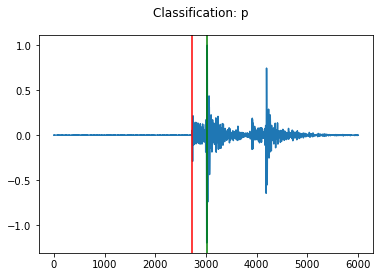

for 214:2
4
2018-10-26T11:10:38.657499Z


<Figure size 432x288 with 0 Axes>

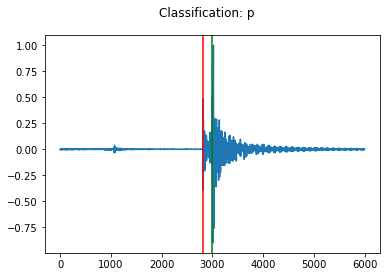

for 215:1
2
2018-10-27T11:03:25.526501Z


<Figure size 432x288 with 0 Axes>

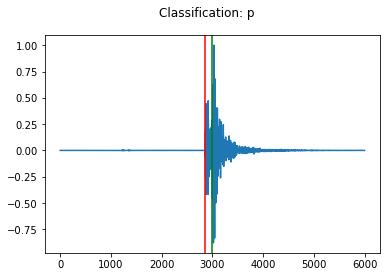

for 216:1
2
2018-10-27T11:07:27.888499Z


<Figure size 432x288 with 0 Axes>

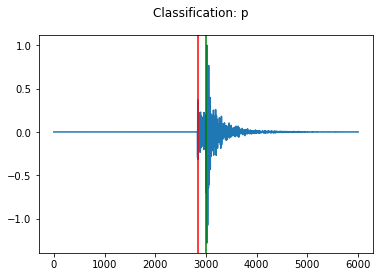

for 217:1
2
2018-10-30T14:44:13.923515Z


<Figure size 432x288 with 0 Axes>

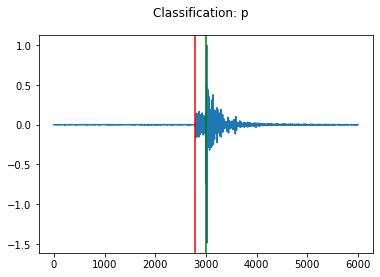

for 218:1
2
2018-10-31T08:22:53.489743Z


<Figure size 432x288 with 0 Axes>

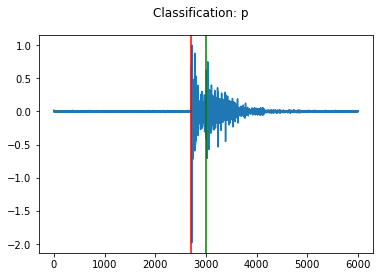

for 219:1
3
2018-10-31T10:41:20.384942Z


<Figure size 432x288 with 0 Axes>

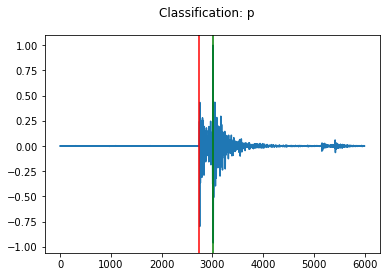

for 220:1
2
2018-12-09T21:15:05.014503Z


<Figure size 432x288 with 0 Axes>

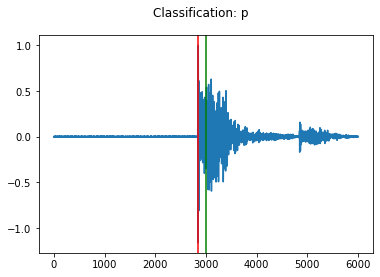

for 221:2
3
2018-12-10T12:38:47.935501Z


<Figure size 432x288 with 0 Axes>

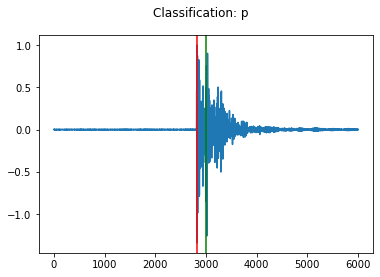

for 222:2
4
2018-12-11T10:02:18.606499Z


<Figure size 432x288 with 0 Axes>

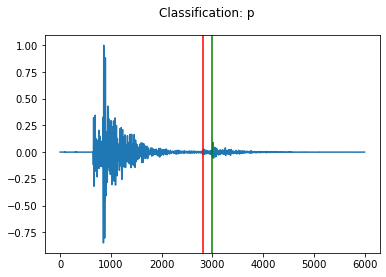

for 223:1
2
2018-12-14T13:08:09.814999Z


<Figure size 432x288 with 0 Axes>

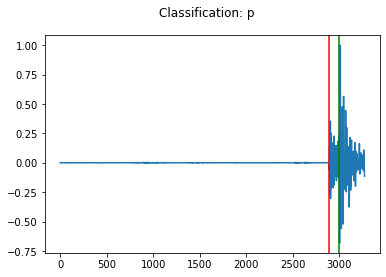

for 224:1
2
2018-12-14T14:29:28.460495Z


<Figure size 432x288 with 0 Axes>

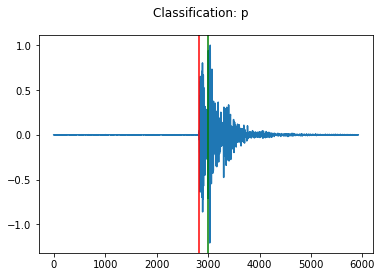

for 225:1
2
2018-10-16T14:19:06.627500Z


<Figure size 432x288 with 0 Axes>

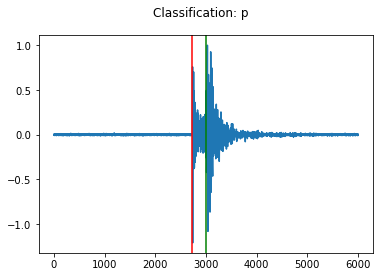

for 226:1
2
2018-10-16T15:09:03.666004Z


<Figure size 432x288 with 0 Axes>

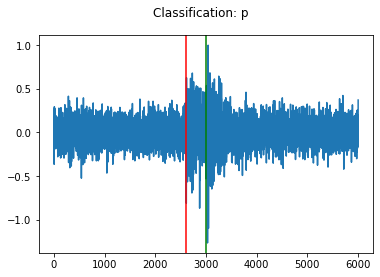

for 227:1
2
2018-10-17T17:42:02.122497Z


<Figure size 432x288 with 0 Axes>

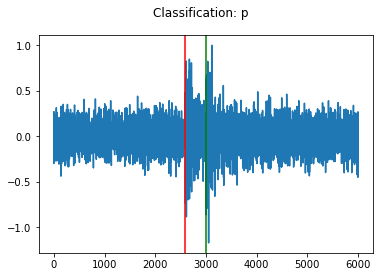

for 228:1
2
2018-10-17T18:08:09.617003Z


<Figure size 432x288 with 0 Axes>

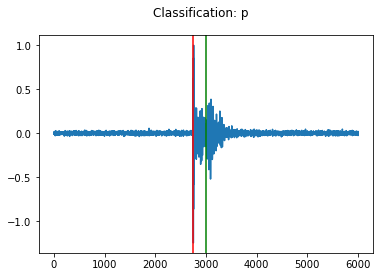

for 229:1
2
2018-10-18T14:33:02.117499Z


<Figure size 432x288 with 0 Axes>

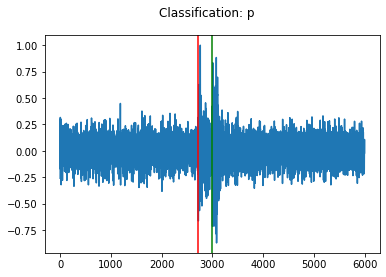

for 230:1
2
2018-10-18T14:51:27.391075Z


<Figure size 432x288 with 0 Axes>

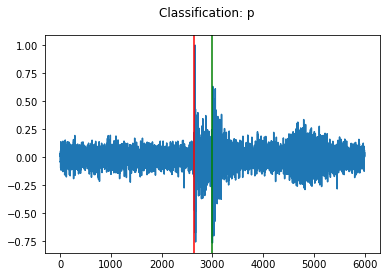

for 231:1
2
2018-10-19T12:51:45.276329Z


<Figure size 432x288 with 0 Axes>

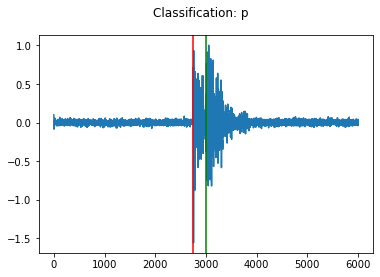

for 232:1
2
2018-10-22T22:16:28.287965Z


<Figure size 432x288 with 0 Axes>

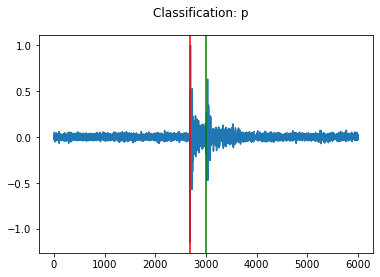

for 233:2
4
2018-10-25T11:39:17.122878Z


<Figure size 432x288 with 0 Axes>

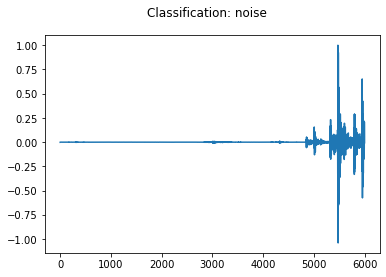

for 234:1
2
2018-10-25T12:17:17.783881Z


<Figure size 432x288 with 0 Axes>

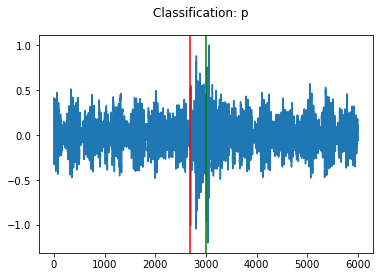

for 235:2
4
2018-10-25T12:41:31.503562Z


<Figure size 432x288 with 0 Axes>

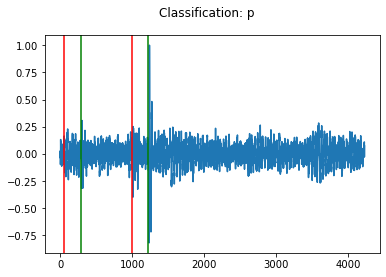

for 236:2
4
2018-10-25T15:07:15.905209Z


<Figure size 432x288 with 0 Axes>

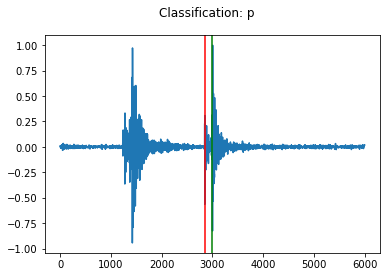

for 237:2
4
2018-10-25T17:08:35.272500Z


<Figure size 432x288 with 0 Axes>

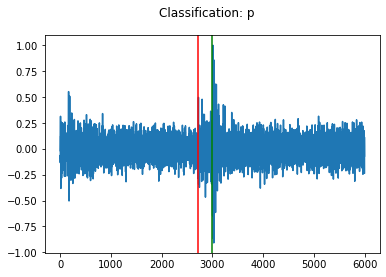

for 238:2
5
2018-10-26T11:33:25.399501Z


<Figure size 432x288 with 0 Axes>

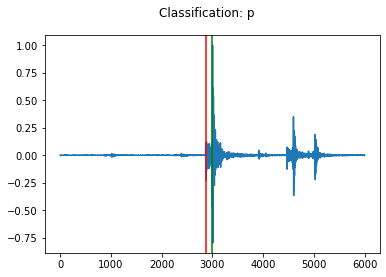

for 239:2
4
2018-10-27T10:38:21.312500Z


<Figure size 432x288 with 0 Axes>

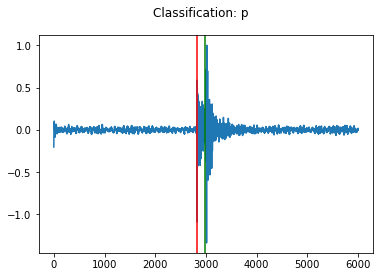

for 240:1
2
2018-10-27T10:59:00.204500Z


<Figure size 432x288 with 0 Axes>

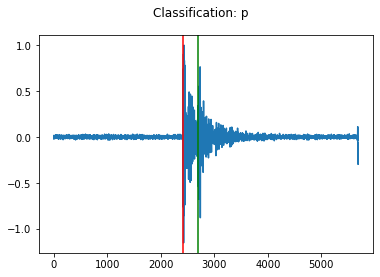

for 241:1
2
2018-10-27T14:33:33.700499Z


<Figure size 432x288 with 0 Axes>

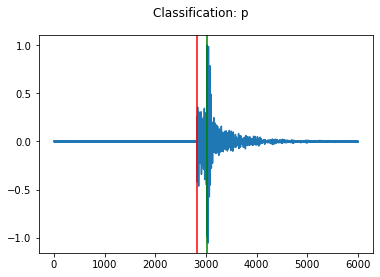

for 242:1
2
2018-11-02T17:46:01.984999Z


<Figure size 432x288 with 0 Axes>

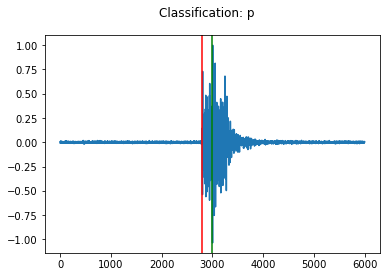

for 243:1
2
2018-12-11T09:21:27.617003Z


<Figure size 432x288 with 0 Axes>

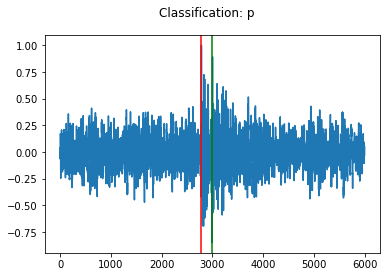

for 244:2
4
2018-12-11T09:32:04.481499Z


<Figure size 432x288 with 0 Axes>

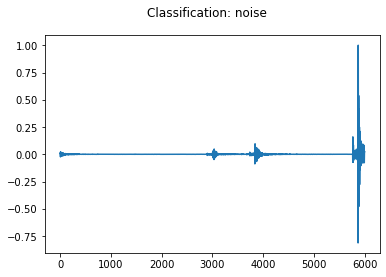

for 245:3
6
2018-12-11T10:29:19.027503Z


<Figure size 432x288 with 0 Axes>

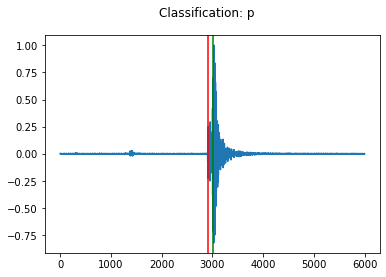

for 246:2
4
2018-12-13T11:19:20.037003Z


<Figure size 432x288 with 0 Axes>

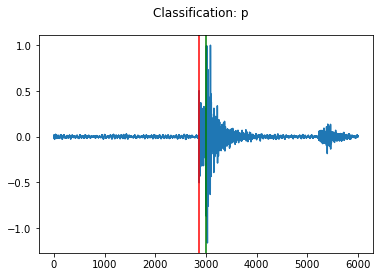

for 247:1
2
2018-12-14T20:12:31.700999Z


<Figure size 432x288 with 0 Axes>

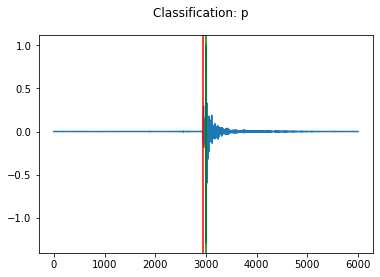

for 248:2
4
2018-12-17T11:31:06.711688Z


<Figure size 432x288 with 0 Axes>

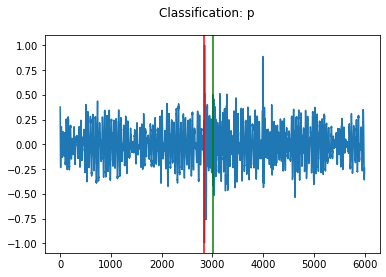

for 249:1
2
2018-12-17T12:07:50.236187Z


<Figure size 432x288 with 0 Axes>

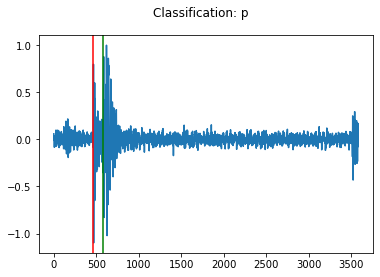

250
All done with P.


<Figure size 432x288 with 0 Axes>

In [29]:
# looking at what the df looks like

folders = glob.glob('./output_P/CF2021/*')
folders.sort()

# make a dataframe for each event, put all picks in one df
# limit the pick starttime to +- 500 samples (+- 0.25s) from the pick time

results_P = pd.DataFrame(index= np.arange(0,len(P_df)),columns=['time', 'sta', 'pha', 'prob'])

for i in np.arange(0,len(folders)):
# for i in np.arange(0,3):
    
    df = pd.DataFrame()
    files = glob.glob(str(folders[i]) + '/*.csv')
    files.sort()
    picks_df = pd.read_csv(files[0],delim_whitespace=True)
    p_idx = literal_eval(picks_df['p_idx'].iloc[0])
    s_idx = literal_eval(picks_df['s_idx'].iloc[0])
    p_prob = literal_eval(picks_df['p_prob'].iloc[0])
    s_prob = literal_eval(picks_df['s_prob'].iloc[0])
    p_amp = literal_eval(picks_df['p_amp'].iloc[0])
    s_amp = literal_eval(picks_df['s_amp'].iloc[0])
    
    p_times = []
    
    for j in np.arange(0,len(p_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (p_idx[j]/2000)
        p_times.append(time1)
        
    s_times = []
    for j in np.arange(0,len(s_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (s_idx[j]/2000)
        s_times.append(time1)
        
    df_P = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(p_times)))
    for j in np.arange(0,len(p_times)):
        df_P['time'].iloc[j] = p_times[j]
        df_P['pha'].iloc[j] = 'p'
        df_P['prob'].iloc[j] = p_prob[j]
        df_P['amp'].iloc[j] = p_amp[j]
        if (i+1)<10:
            df_P['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_P['sta'].iloc[j] = '0'+str(i+1)     
    

    df_S = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(s_times)))
    for j in np.arange(0,len(s_times)):
        df_S['time'].iloc[j] = s_times[j]
        df_S['pha'].iloc[j] = 's'
        df_S['prob'].iloc[j] = s_prob[j]
        df_S['amp'].iloc[j] = s_amp[j]
        if (i+1)<10:
            df_S['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_S['sta'].iloc[j] = '0'+str(i+1)
    print('for ' + str(i) + ':' + str(len(df_P)))        
    df = pd.concat([df,df_P,df_S])
    print(len(df))
    
    ####################################################
    # filtering the picks out and visualising them
    ####################################################
    
    midwindow = P_df['starttime'].iloc[i]
    toplim = midwindow + 0.5
    botlim = midwindow - 0.5
    print(midwindow)


    df_final = df[df['time'] >= botlim]
    df_final = df_final[df_final['time'] <= toplim]
    
    st = read(glob.glob(data_dir[i] + '/*')[0])

    fig, axs = plt.subplots(1)

    # get the one nearest to the middle of the window
    if len(df_final) > 0:
        timediff = []
        for dfii in np.arange(0,len(df_final)):
            timediff1 = abs(midwindow - df_final['time'].iloc[dfii])
            timediff.append(timediff1)

        fig.suptitle('Classification: '+ df_final['pha'].iloc[np.argmin(timediff)])

    else:
        fig.suptitle('Classification: noise')

    axs.plot(st[0].data/max(st[0].data))
    if len(df_final) > 0:
        df_final.to_csv('./Model_results/PhaseNet/P/df_final_'+str(i+1)+'.csv')
        for thepicks in np.arange(0,len(df_final)):
            if df_final['pha'].iloc[thepicks] == 'p':
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='r')
            else:
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='g')

    else:
        pass

    plt.show()

    if (i+1) < 10:
        fig.savefig('./Model_results/PhaseNet/P/P_result_00'+str(i+1)+'.png')
    elif ((i+1) > 9) and ((i+1) < 100):
        fig.savefig('./Model_results/PhaseNet/P/P_result_0'+str(i+1)+'.png')
    else:
        fig.savefig('./Model_results/PhaseNet/P/P_result_'+str(i+1)+'.png')

    plt.close()
    plt.clf()
    #############

    # run through all P picks
    if len(df_final)>0:
        results_P['time'].iloc[i] = df_final['time'].iloc[0]
        results_P['sta'].iloc[i] = df_final['sta'].iloc[0]
        results_P['pha'].iloc[i] = df_final['pha'].iloc[0]
        results_P['prob'].iloc[i] = df_final['prob'].iloc[0]
    else:
        results_P['time'].iloc[i] = np.nan
        results_P['sta'].iloc[i] = P_df['sta_str'].iloc[indx]
        results_P['pha'].iloc[i] = 'n'
        results_P['prob'].iloc[i] = np.nan

    
results_P.to_csv('./Model_results/PhaseNet/P/250results_P.csv')
print(len(results_P))
print("All done with P.")


# df.sort_values(by='time')

In [30]:
results_P[results_P['pha']=='s']

,time,sta,pha,prob
54,2018-10-23T14:59:29.125500Z,055,s,0.749
150,2018-12-15T09:40:07.539000Z,0151,s,0.639
165,2018-12-18T00:20:43.198000Z,0166,s,0.896


In [31]:
len(results_P)

250

___

## S

In [26]:
# make a list of data directories, datalist directories, result directories

input_model = 'PhaseNet/model/190703-214543'
data_dir = []
data_list = []
result_dir = []


data_dir1 = 'mseeds_S/CF2021/'
data_list1 = 'fnames_S/fnames_CF2021_'
result_dir1 = './output_S/CF2021/'

# making a folder for each event
for i in np.arange(0,len(S_df)):
    if (i+1) < 10:
        data_dir.append(data_dir1  + '00' + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])
        data_list.append(data_list1 + '00' + str(i+1) + '_' + 'PR' + S_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '00' + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])
        
    elif ((i+1) < 100) and ((i+1) > 9):
        data_dir.append(data_dir1  +  '0' + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])
        data_list.append(data_list1 +  '0' + str(i+1) + '_' + 'PR' + S_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '0' + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])
        
    else:
        
        data_dir.append(data_dir1  + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])
        data_list.append(data_list1 + str(i+1) + '_' + 'PR' + S_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 + str(i+1) + '/' + 'PR' + S_df['sta_str'].iloc[i])


try:
    os.mkdir('./mseeds_S/')
except:
    pass

try:
    os.mkdir('./output_S/')
except:
    pass

try:
    os.mkdir('./fnames_S/')
except:
    pass

try:
    os.mkdir('./mseeds_S/CF2021/')
    os.mkdir('./output_S/CF2021/')
except:
    pass
try:
    for i in np.arange(0, 250):
        if (i+1) < 10:
            os.mkdir('./mseeds_S/CF2021/00' + str(i+1))
            os.mkdir('./output_S/CF2021/00' + str(i+1))        
        elif (i+1) > 99:
            os.mkdir('./mseeds_S/CF2021/' + str(i+1))
            os.mkdir('./output_S/CF2021/' + str(i+1))        
        else:
            os.mkdir('./mseeds_S/CF2021/0' + str(i+1))
            os.mkdir('./output_S/CF2021/0' + str(i+1))

except:
    pass

try:
    for i in np.arange(0,len(data_dir)):
        os.mkdir('./' + data_dir[i])
        os.mkdir('./' + data_list[i])
        os.mkdir(result_dir[i])
except:
    pass

folders = glob.glob('./mseeds_S/CF2021/*')
folders.sort()

col1 = []
col2 = []
col3 = []
col4 = []

for i in np.arange(0,len(folders)):
    print(i)
    names = glob.glob(folders[i] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

fnames = pd.DataFrame(index=np.arange(0,24),columns=['fname','E','N','Z'])

for i in np.arange(0,24):
    fnames['fname'].iloc[i] = col1[i]
    fnames['E'].iloc[i] = col2[i]
    fnames['N'].iloc[i] = col3[i]
    fnames['Z'].iloc[i] = col4[i]



for indx in np.arange(0, len(S_df)):
    # Dataframe to store picks from trigger
    df = pd.DataFrame(columns=['time', 'sta', 'pha', 'prob'])

    # saving 3s (6000 sample) window of phases
    evnt= S_df.iloc[indx]

    print('idx:', indx)
    print('Origin time:', evnt['starttime'])
    print('Station:', evnt['sta'])

    # select event origin time to mark start of event cut
    starttime = evnt['starttime']

    # Folders of events are labelled by their date, use this to find correct path to folder
#     rootpath = root + 'pre-multijob/data/'
    rootpath = '../../../../../Volumes/CindyPNR/'
    dayfolder = starttime.strftime('%y%m%d')
    daypath = os.path.join(rootpath,dayfolder)

    # Get a list of file names from the folder
    f = []
    for (_, _, filenames) in os.walk(daypath):
        f.extend(filenames)

    # File names are labelled by the starttime of the file
    # get a list of all filenames with a starttime before the event
    f_before = filter(lambda s: UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S") < starttime, f)


    # Find the file name and path of the last file starting before the event (should contain event)
    file = min(f_before, key=lambda s: abs(starttime - UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S")))
    filepath=os.path.join(daypath,file)

    ##################################################
    
# cut the data to 6000 samples (3 seconds)

    # cutting 6000 sample trace
    st_ENZ = readPNR_ENZ(filepath, unpack_trace_headers=True)
    stcut_ENZ =st_ENZ.slice(starttime=evnt['starttime']-1.5,endtime=evnt['starttime']+1.5)
#     stcut_ENZ = st_ENZ.slice(starttime=evnt['starttime']-8,endtime=evnt['starttime']+8)
    # detrend
    stcut_ENZ.detrend(type='linear')
    # filtered
    stcut_ENZ.filter("highpass",freq=50.0)
    stcut_ENZ.select(station= S_df['sta_str'].iloc[indx])
#     stcut_ENZ.trim(starttime=evnt['starttime']-8,endtime=evnt['starttime']+52, pad=True, fill_value=0)
    
    ##################################################     

    stseed = Stream()
    for i in np.arange(1,4):
        firststarttime = stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.endtime
        lastendtime = stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.endtime
        
        stseed += stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i]
        stats = {'network': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.network, 'station': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.station, 'starttime': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.starttime, 'endtime': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.endtime,
             'location': '', 'channel': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.channel, 'npts': len(stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].data), 'sampling_rate': 2000, 'delta': 1/2000,
         'mseed': {'dataquality': 'D'},
         'distance': stcut_ENZ[(int(S_df['sta'].iloc[indx])*3)-i].stats.distance, 'segy': stcut_ENZ[i].stats.segy}
        
    stseed.write(data_dir[indx] + "/" + "PR.PR"+ S_df['sta_str'].iloc[indx] + "__" + str(firststarttime)[0:13] + str(firststarttime)[14:16] + str(firststarttime)[17:19] + "Z" +"__" + str(lastendtime)[0:13] + str(lastendtime)[14:16] + str(lastendtime)[17:19] + "Z" +  ".mseed", format='MSEED')

# print("All done with S.")

folders = glob.glob('./mseeds_S/CF2021/*')
folders.sort()

for i in np.arange(0,len(folders)):
    
    fnames = pd.DataFrame()

    col1 = []
    col2 = []
    col3 = []
    col4 = []
    print(i)
    names = []
    names = glob.glob(folders[i] + '/*')
    names = glob.glob(names[0] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

    fnames = pd.DataFrame(index=np.arange(0,len(names)),columns=['fname','E','N','Z'])

    for j in np.arange(0,len(names)):
        fnames['fname'].iloc[j] = col1[j]
        fnames['E'].iloc[j] = col2[j]
        fnames['N'].iloc[j] = col3[j]
        fnames['Z'].iloc[j] = col4[j]
    
    if (i+1) < 10:
        fnames.to_csv('./fnames_S/00'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    elif (i+1) > 99:
        fnames.to_csv('./fnames_S/'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    else:
        fnames.to_csv('./fnames_S/0'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')

data_list = glob.glob('./fnames_S/*')
data_list.sort()

result_dir = glob.glob('./output_S/CF2021/*')
result_dir.sort()

# actually running PhaseNet
for i in np.arange(0,len(data_dir)):

    string = 'python PhaseNet/phasenet/predict.py --mode=pred --model_dir=PhaseNet/model/190703-214543 --data_dir='+str(data_dir[i])+' --data_list='+str(data_list[i])+' --format=mseed --amplitude --result_dir='+str(result_dir[i])

    os.system(string)
    print('Event '+str(i+1) + ' done.')

0
['./mseeds_S/CF2021/001/PR010']
1
['./mseeds_S/CF2021/002/PR006']
2
['./mseeds_S/CF2021/003/PR019']
3
['./mseeds_S/CF2021/004/PR010']
4
['./mseeds_S/CF2021/005/PR016']
5
['./mseeds_S/CF2021/006/PR002']
6
['./mseeds_S/CF2021/007/PR024']
7
['./mseeds_S/CF2021/008/PR023']
8
['./mseeds_S/CF2021/009/PR010']
9
['./mseeds_S/CF2021/010/PR009']
10
['./mseeds_S/CF2021/011/PR001']
11
['./mseeds_S/CF2021/012/PR013']
12
['./mseeds_S/CF2021/013/PR003']
13
['./mseeds_S/CF2021/014/PR010']
14
['./mseeds_S/CF2021/015/PR014']
15
['./mseeds_S/CF2021/016/PR011']
16
['./mseeds_S/CF2021/017/PR009']
17
['./mseeds_S/CF2021/018/PR009']
18
['./mseeds_S/CF2021/019/PR009']
19
['./mseeds_S/CF2021/020/PR009']
20
['./mseeds_S/CF2021/021/PR010']
21
['./mseeds_S/CF2021/022/PR007']
22
['./mseeds_S/CF2021/023/PR017']
23
['./mseeds_S/CF2021/024/PR021']
24
['./mseeds_S/CF2021/025/PR003']
25
['./mseeds_S/CF2021/026/PR009']
26
['./mseeds_S/CF2021/027/PR021']
27
['./mseeds_S/CF2021/028/PR004']
28
['./mseeds_S/CF2021/029/PR0

idx: 1
Origin time: 2018-10-17T10:44:06.752483Z
Station: 6.0
idx: 2
Origin time: 2018-10-17T10:44:19.429796Z
Station: 19.0
idx: 3
Origin time: 2018-10-17T10:46:22.316227Z
Station: 10.0
idx: 4
Origin time: 2018-10-17T10:47:01.228957Z
Station: 16.0
idx: 5
Origin time: 2018-10-17T10:48:49.866153Z
Station: 2.0
idx: 6
Origin time: 2018-10-17T10:54:21.988852Z
Station: 24.0
idx: 7
Origin time: 2018-10-23T14:22:12.907697Z
Station: 23.0
idx: 8
Origin time: 2018-10-23T14:27:16.272296Z
Station: 10.0
idx: 9
Origin time: 2018-10-23T14:30:57.455669Z
Station: 9.0
idx: 10
Origin time: 2018-10-23T14:35:44.106102Z
Station: 1.0
idx: 11
Origin time: 2018-10-23T14:36:15.925023Z
Station: 13.0
idx: 12
Origin time: 2018-10-23T14:36:50.830293Z
Station: 3.0
idx: 13
Origin time: 2018-10-23T14:37:29.421876Z
Station: 10.0
idx: 14
Origin time: 2018-10-23T14:38:07.166302Z
Station: 14.0
idx: 15
Origin time: 2018-10-23T14:39:14.222327Z
Station: 11.0
idx: 16
Origin time: 2018-10-23T14:39:20.808372Z
Station: 9.0
idx: 17

idx: 132
Origin time: 2018-10-29T11:44:42.401886Z
Station: 14.0
idx: 133
Origin time: 2018-10-19T13:20:49.141106Z
Station: 6.0
idx: 134
Origin time: 2018-10-25T14:56:28.733150Z
Station: 5.0
idx: 135
Origin time: 2018-10-26T02:13:02.205291Z
Station: 19.0
idx: 136
Origin time: 2018-12-10T10:30:58.344963Z
Station: 18.0
idx: 137
Origin time: 2018-12-11T10:20:28.023469Z
Station: 19.0
idx: 138
Origin time: 2018-10-27T11:07:17.201670Z
Station: 15.0
idx: 139
Origin time: 2018-12-14T13:06:37.398000Z
Station: 1.0
idx: 140
Origin time: 2018-10-26T14:14:04.309392Z
Station: 3.0
idx: 141
Origin time: 2018-10-26T11:17:03.358776Z
Station: 9.0
idx: 142
Origin time: 2018-12-14T13:18:30.776496Z
Station: 13.0
idx: 143
Origin time: 2018-12-11T09:34:03.780759Z
Station: 17.0
idx: 144
Origin time: 2018-10-25T17:04:13.867001Z
Station: 14.0
idx: 145
Origin time: 2018-10-24T13:19:01.059000Z
Station: 24.0
idx: 146
Origin time: 2018-10-29T11:43:29.894477Z
Station: 24.0
idx: 147
Origin time: 2018-10-25T15:24:29.162

['./mseeds_S/CF2021/066/PR023/PR.PR023__2018-10-29T092952Z__2018-10-29T092952Z.mseed']
66
['./mseeds_S/CF2021/067/PR012/PR.PR012__2018-10-29T093022Z__2018-10-29T093022Z.mseed']
67
['./mseeds_S/CF2021/068/PR010/PR.PR010__2018-10-29T093120Z__2018-10-29T093120Z.mseed']
68
['./mseeds_S/CF2021/069/PR022/PR.PR022__2018-10-29T093142Z__2018-10-29T093142Z.mseed']
69
['./mseeds_S/CF2021/070/PR014/PR.PR014__2018-10-29T093149Z__2018-10-29T093149Z.mseed']
70
['./mseeds_S/CF2021/071/PR019/PR.PR019__2018-10-29T093152Z__2018-10-29T093152Z.mseed']
71
['./mseeds_S/CF2021/072/PR015/PR.PR015__2018-10-29T093200Z__2018-10-29T093200Z.mseed']
72
['./mseeds_S/CF2021/073/PR005/PR.PR005__2018-10-29T093241Z__2018-10-29T093241Z.mseed']
73
['./mseeds_S/CF2021/074/PR017/PR.PR017__2018-10-29T095051Z__2018-10-29T095051Z.mseed']
74
['./mseeds_S/CF2021/075/PR011/PR.PR011__2018-10-29T095330Z__2018-10-29T095330Z.mseed']
75
['./mseeds_S/CF2021/076/PR018/PR.PR018__2018-10-29T095736Z__2018-10-29T095736Z.mseed']
76
['./mseeds

198
['./mseeds_S/CF2021/199/PR017/PR.PR017__2018-12-17T190528Z__2018-12-17T190528Z.mseed']
199
['./mseeds_S/CF2021/200/PR022/PR.PR022__2018-12-15T141828Z__2018-12-15T141828Z.mseed']
200
['./mseeds_S/CF2021/201/PR021/PR.PR021__2018-10-16T135004Z__2018-10-16T135004Z.mseed']
201
['./mseeds_S/CF2021/202/PR001/PR.PR001__2018-10-18T143657Z__2018-10-18T143657Z.mseed']
202
['./mseeds_S/CF2021/203/PR022/PR.PR022__2018-10-18T152811Z__2018-10-18T152811Z.mseed']
203
['./mseeds_S/CF2021/204/PR007/PR.PR007__2018-10-22T115059Z__2018-10-22T115059Z.mseed']
204
['./mseeds_S/CF2021/205/PR020/PR.PR020__2018-10-24T133934Z__2018-10-24T133934Z.mseed']
205
['./mseeds_S/CF2021/206/PR008/PR.PR008__2018-10-24T135031Z__2018-10-24T135031Z.mseed']
206
['./mseeds_S/CF2021/207/PR008/PR.PR008__2018-10-25T113510Z__2018-10-25T113510Z.mseed']
207
['./mseeds_S/CF2021/208/PR011/PR.PR011__2018-10-25T120607Z__2018-10-25T120607Z.mseed']
208
['./mseeds_S/CF2021/209/PR013/PR.PR013__2018-10-25T130605Z__2018-10-25T130605Z.mseed']

Event 225 done.
Event 226 done.
Event 227 done.
Event 228 done.
Event 229 done.
Event 230 done.
Event 231 done.
Event 232 done.
Event 233 done.
Event 234 done.
Event 235 done.
Event 236 done.
Event 237 done.
Event 238 done.
Event 239 done.
Event 240 done.
Event 241 done.
Event 242 done.
Event 243 done.
Event 244 done.
Event 245 done.
Event 246 done.
Event 247 done.
Event 248 done.
Event 249 done.
Event 250 done.


for 0:2
3
2018-10-16T10:54:18.518596Z


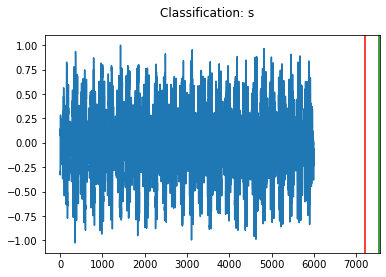

for 1:1
2
2018-10-17T10:44:06.752483Z


<Figure size 432x288 with 0 Axes>

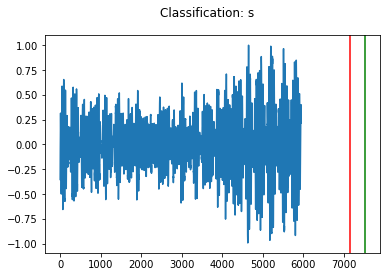

for 2:1
2
2018-10-17T10:44:19.429796Z


<Figure size 432x288 with 0 Axes>

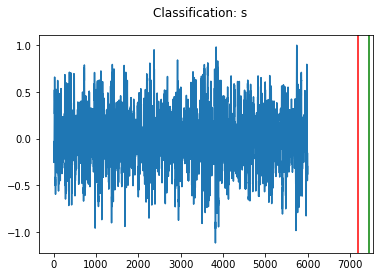

for 3:1
2
2018-10-17T10:46:22.316227Z


<Figure size 432x288 with 0 Axes>

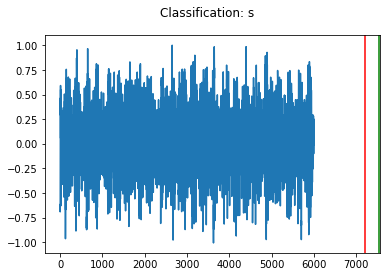

for 4:1
2
2018-10-17T10:47:01.228957Z


<Figure size 432x288 with 0 Axes>

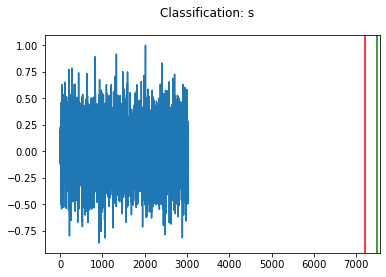

for 5:1
2
2018-10-17T10:48:49.866153Z


<Figure size 432x288 with 0 Axes>

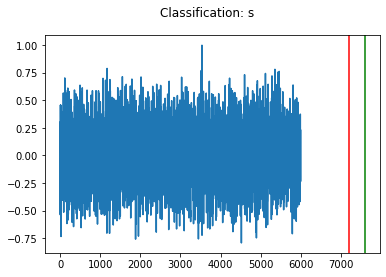

for 6:1
2
2018-10-17T10:54:21.988852Z


<Figure size 432x288 with 0 Axes>

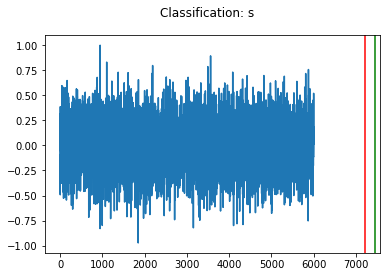

for 7:1
2
2018-10-23T14:22:12.907697Z


<Figure size 432x288 with 0 Axes>

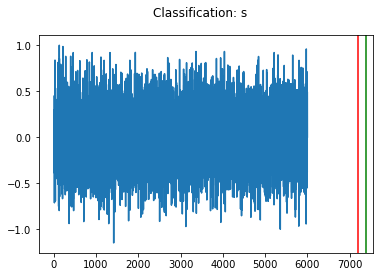

for 8:1
2
2018-10-23T14:27:16.272296Z


<Figure size 432x288 with 0 Axes>

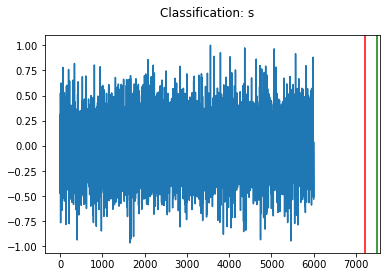

for 9:1
2
2018-10-23T14:30:57.455669Z


<Figure size 432x288 with 0 Axes>

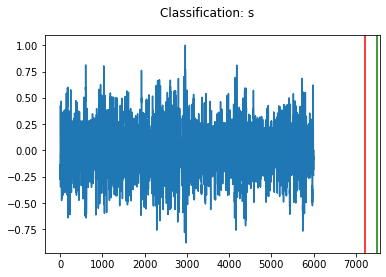

for 10:1
2
2018-10-23T14:35:44.106102Z


<Figure size 432x288 with 0 Axes>

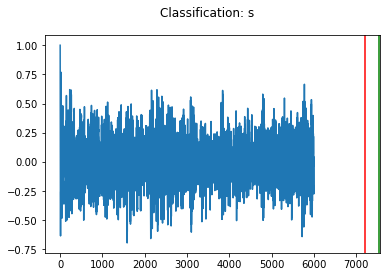

for 11:1
2
2018-10-23T14:36:15.925023Z


<Figure size 432x288 with 0 Axes>

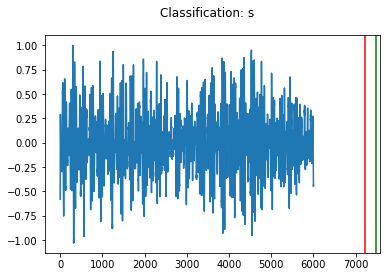

for 12:1
3
2018-10-23T14:36:50.830293Z


<Figure size 432x288 with 0 Axes>

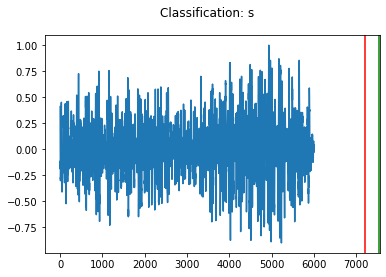

for 13:1
2
2018-10-23T14:37:29.421876Z


<Figure size 432x288 with 0 Axes>

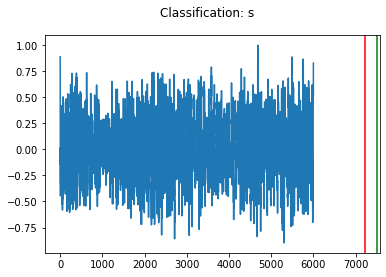

for 14:1
2
2018-10-23T14:38:07.166302Z


<Figure size 432x288 with 0 Axes>

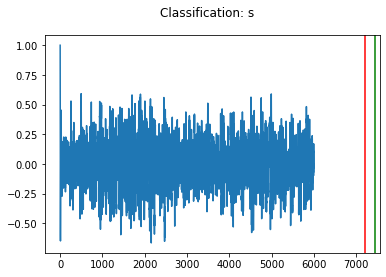

for 15:1
2
2018-10-23T14:39:14.222327Z


<Figure size 432x288 with 0 Axes>

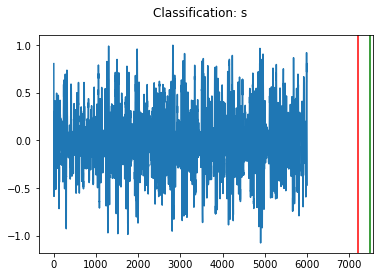

for 16:1
2
2018-10-23T14:39:20.808372Z


<Figure size 432x288 with 0 Axes>

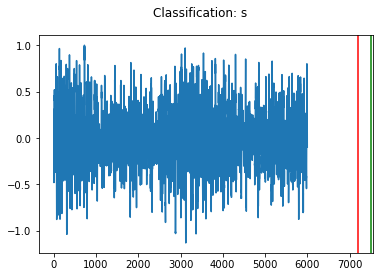

for 17:2
3
2018-10-23T14:40:34.543000Z


<Figure size 432x288 with 0 Axes>

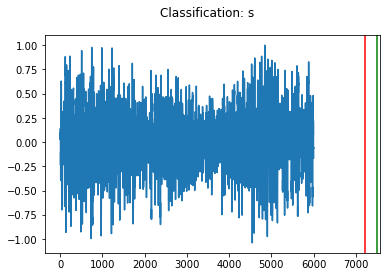

for 18:1
2
2018-10-23T14:41:41.282625Z


<Figure size 432x288 with 0 Axes>

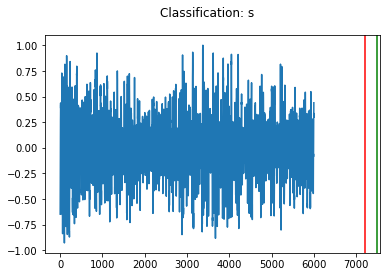

for 19:1
2
2018-10-23T14:41:50.514001Z


<Figure size 432x288 with 0 Axes>

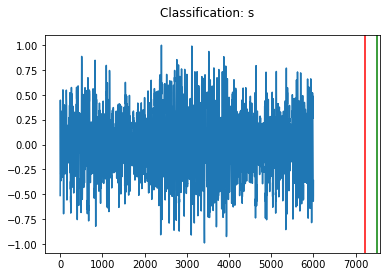

for 20:1
2
2018-10-23T14:41:53.520754Z


<Figure size 432x288 with 0 Axes>

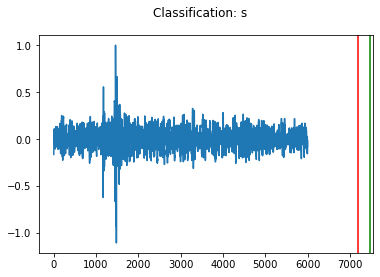

for 21:1
2
2018-10-23T14:44:25.484501Z


<Figure size 432x288 with 0 Axes>

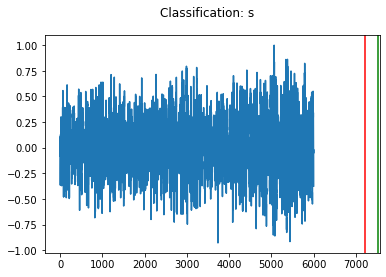

for 22:1
2
2018-10-23T14:44:29.559719Z


<Figure size 432x288 with 0 Axes>

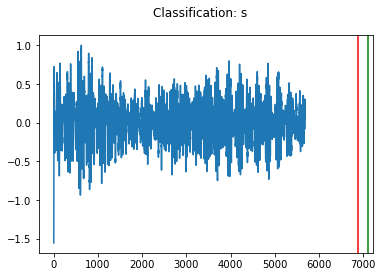

for 23:2
3
2018-10-23T14:44:35.826000Z


<Figure size 432x288 with 0 Axes>

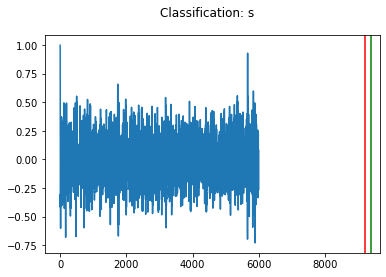

for 24:1
2
2018-10-23T14:44:37.700141Z


<Figure size 432x288 with 0 Axes>

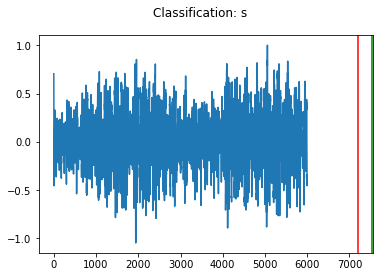

for 25:1
2
2018-10-23T14:44:44.686276Z


<Figure size 432x288 with 0 Axes>

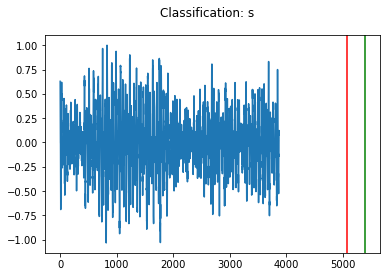

for 26:1
2
2018-10-23T14:35:00.067670Z


<Figure size 432x288 with 0 Axes>

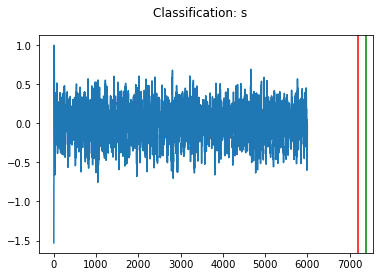

for 27:1
2
2018-10-23T14:45:32.951670Z


<Figure size 432x288 with 0 Axes>

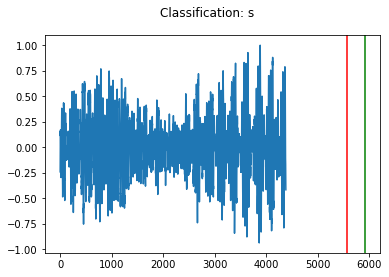

for 28:1
2
2018-10-23T14:45:40.391110Z


<Figure size 432x288 with 0 Axes>

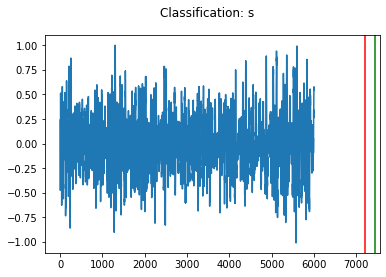

for 29:1
2
2018-10-23T14:45:44.283500Z


<Figure size 432x288 with 0 Axes>

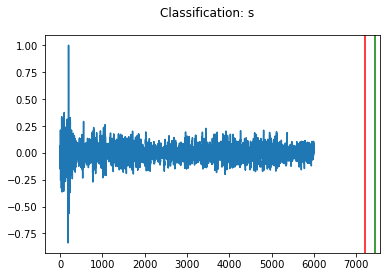

for 30:1
2
2018-10-23T14:42:01.654500Z


<Figure size 432x288 with 0 Axes>

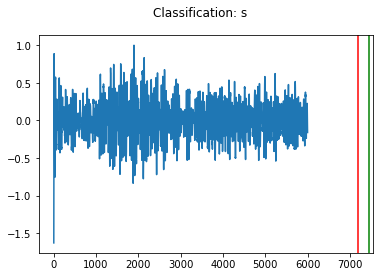

for 31:1
2
2018-10-23T14:48:46.445333Z


<Figure size 432x288 with 0 Axes>

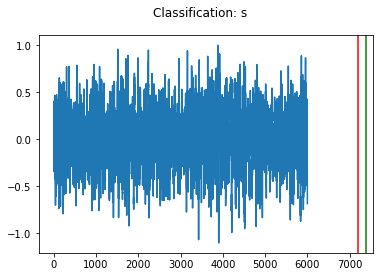

for 32:1
2
2018-10-23T14:49:00.705501Z


<Figure size 432x288 with 0 Axes>

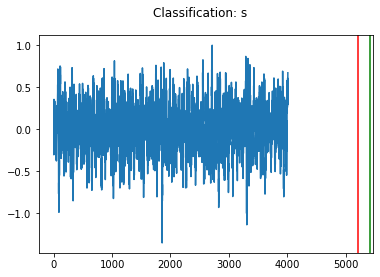

for 33:1
2
2018-10-23T14:49:49.056822Z


<Figure size 432x288 with 0 Axes>

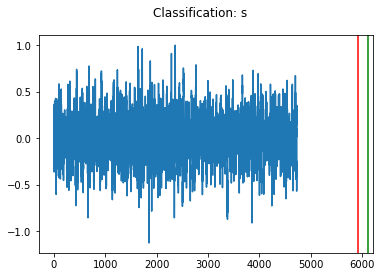

for 34:1
2
2018-10-23T14:51:51.896492Z


<Figure size 432x288 with 0 Axes>

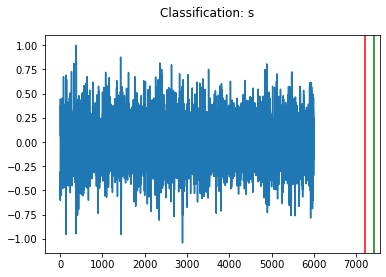

for 35:2
4
2018-10-23T14:52:02.612999Z


<Figure size 432x288 with 0 Axes>

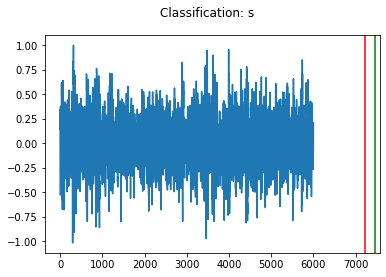

for 36:1
2
2018-10-23T14:52:36.389500Z


<Figure size 432x288 with 0 Axes>

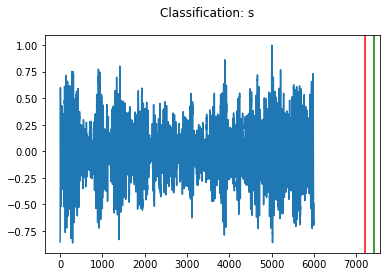

for 37:1
2
2018-10-23T14:53:38.781001Z


<Figure size 432x288 with 0 Axes>

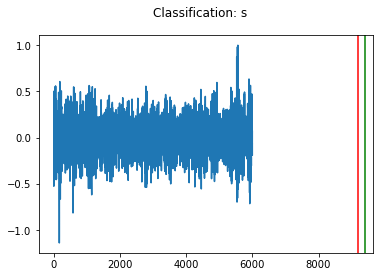

for 38:2
4
2018-10-23T14:53:42.381478Z


<Figure size 432x288 with 0 Axes>

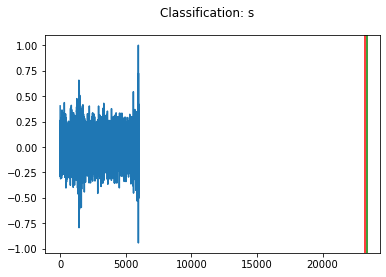

for 39:1
2
2018-10-23T14:54:25.266013Z


<Figure size 432x288 with 0 Axes>

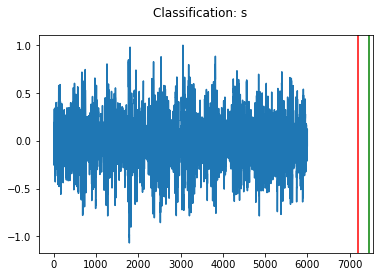

for 40:3
6
2018-10-23T14:55:58.092472Z


<Figure size 432x288 with 0 Axes>

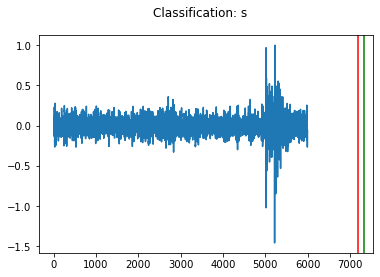

for 41:2
3
2018-10-23T14:56:27.729500Z


<Figure size 432x288 with 0 Axes>

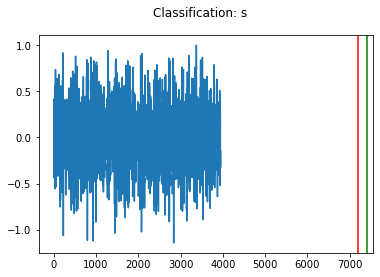

for 42:1
2
2018-10-23T14:57:04.438996Z


<Figure size 432x288 with 0 Axes>

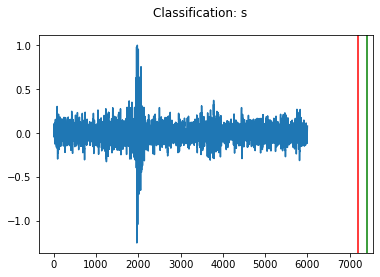

for 43:2
3
2018-10-23T14:57:33.931999Z


<Figure size 432x288 with 0 Axes>

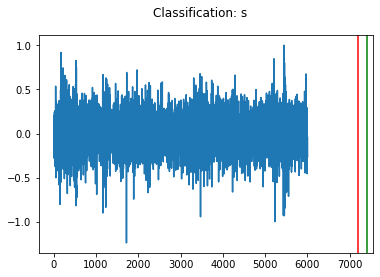

for 44:1
2
2018-10-23T14:57:41.151501Z


<Figure size 432x288 with 0 Axes>

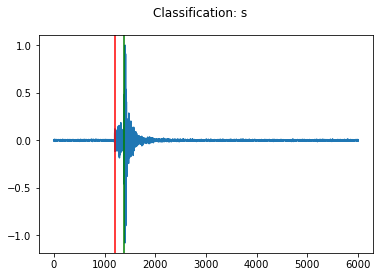

for 45:2
3
2018-10-23T14:57:49.629999Z


<Figure size 432x288 with 0 Axes>

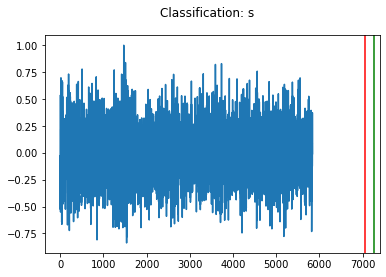

for 46:1
2
2018-10-23T14:58:02.238001Z


<Figure size 432x288 with 0 Axes>

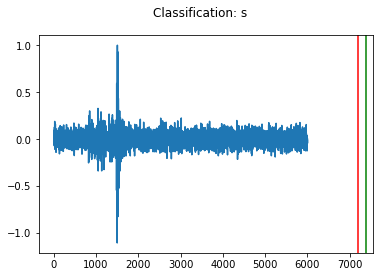

for 47:1
2
2018-10-23T14:58:06.002501Z


<Figure size 432x288 with 0 Axes>

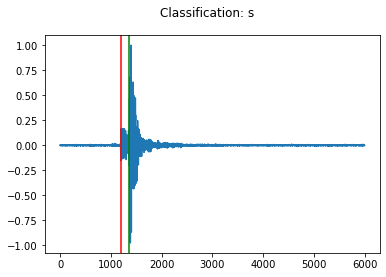

for 48:1
2
2018-10-23T14:58:39.379893Z


<Figure size 432x288 with 0 Axes>

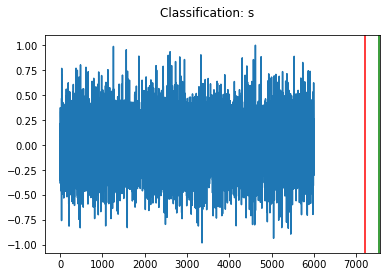

for 49:1
2
2018-10-23T14:58:48.855501Z


<Figure size 432x288 with 0 Axes>

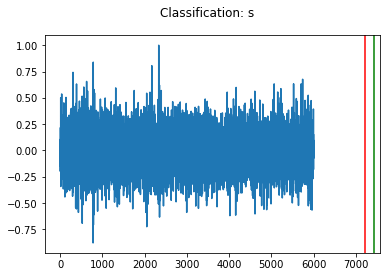

for 50:4
8
2018-10-23T14:59:02.937000Z


<Figure size 432x288 with 0 Axes>

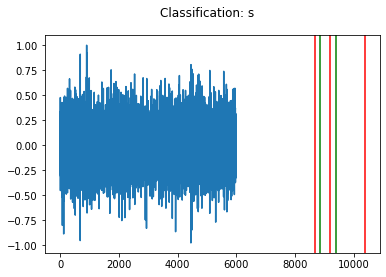

for 51:3
5
2018-10-23T14:59:16.910999Z


<Figure size 432x288 with 0 Axes>

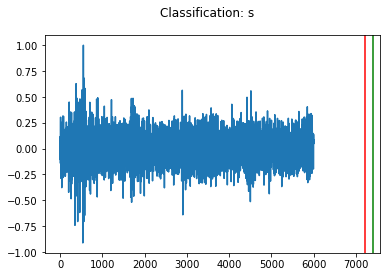

for 52:4
8
2018-10-23T14:59:19.390999Z


<Figure size 432x288 with 0 Axes>

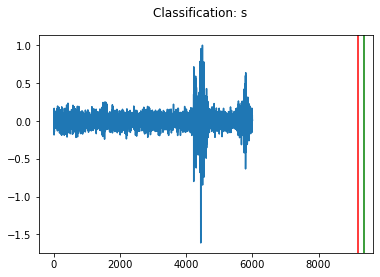

for 53:1
2
2018-10-23T14:59:24.903624Z


<Figure size 432x288 with 0 Axes>

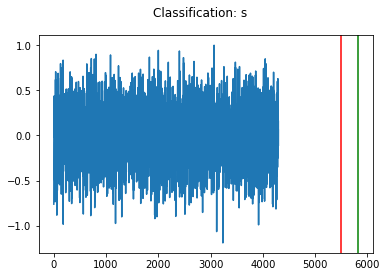

for 54:1
2
2018-10-23T14:59:29.121514Z


<Figure size 432x288 with 0 Axes>

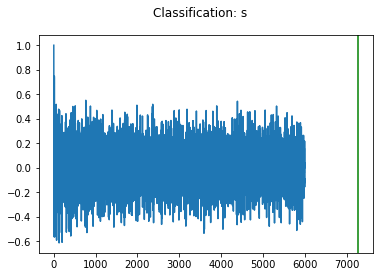

for 55:1
2
2018-10-23T14:59:37.871000Z


<Figure size 432x288 with 0 Axes>

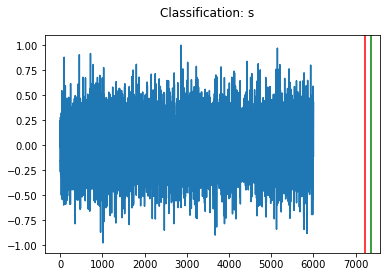

for 56:0
2
2018-10-23T14:59:38.550500Z


<Figure size 432x288 with 0 Axes>

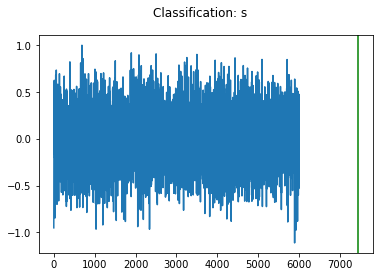

for 57:1
2
2018-10-29T09:07:44.758459Z


<Figure size 432x288 with 0 Axes>

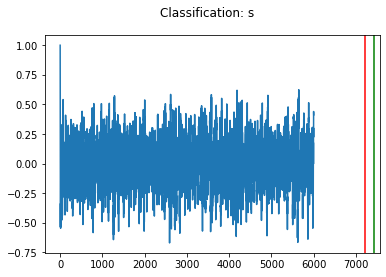

for 58:1
2
2018-10-29T09:11:10.322020Z


<Figure size 432x288 with 0 Axes>

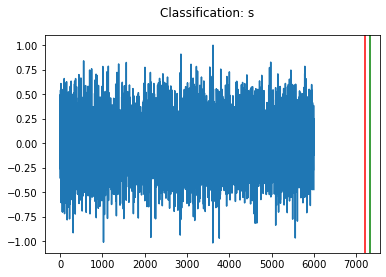

for 59:1
2
2018-10-29T09:11:28.636414Z


<Figure size 432x288 with 0 Axes>

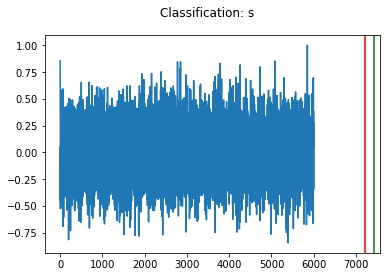

for 60:1
2
2018-10-29T09:13:16.450352Z


<Figure size 432x288 with 0 Axes>

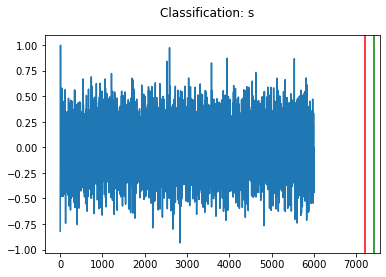

for 61:1
2
2018-10-29T09:13:27.507081Z


<Figure size 432x288 with 0 Axes>

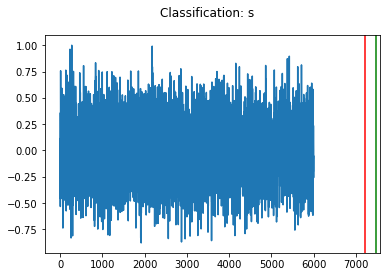

for 62:1
2
2018-10-29T09:17:59.691887Z


<Figure size 432x288 with 0 Axes>

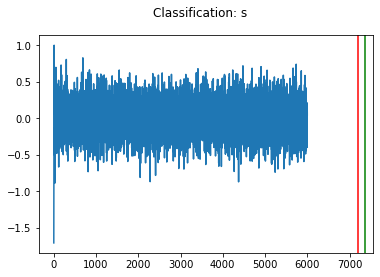

for 63:1
2
2018-10-29T09:24:15.884174Z


<Figure size 432x288 with 0 Axes>

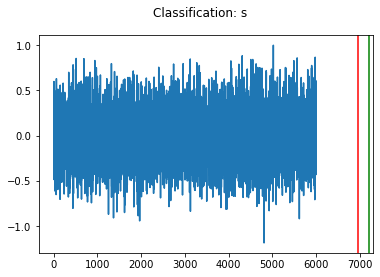

for 64:1
2
2018-10-29T09:26:06.021933Z


<Figure size 432x288 with 0 Axes>

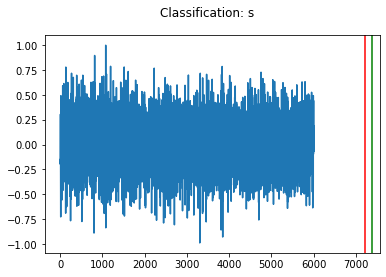

for 65:1
2
2018-10-29T09:29:51.471275Z


<Figure size 432x288 with 0 Axes>

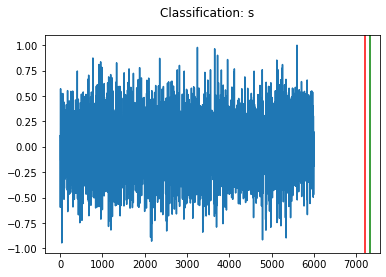

for 66:2
3
2018-10-29T09:30:20.615192Z


<Figure size 432x288 with 0 Axes>

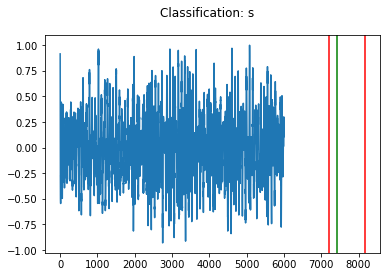

for 67:2
3
2018-10-29T09:31:18.519956Z


<Figure size 432x288 with 0 Axes>

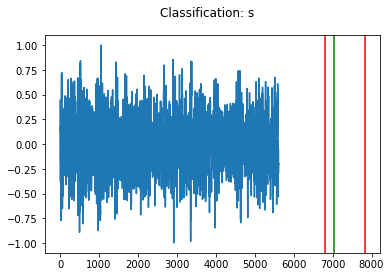

for 68:1
2
2018-10-29T09:31:41.001847Z


<Figure size 432x288 with 0 Axes>

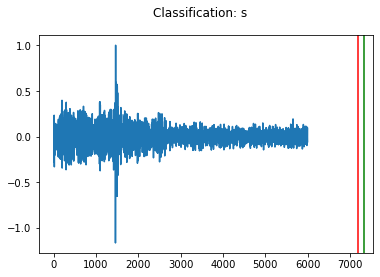

for 69:3
4
2018-10-29T09:31:48.173910Z


<Figure size 432x288 with 0 Axes>

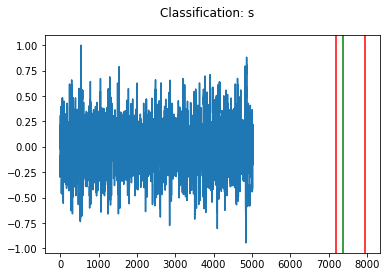

for 70:1
2
2018-10-29T09:31:50.552337Z


<Figure size 432x288 with 0 Axes>

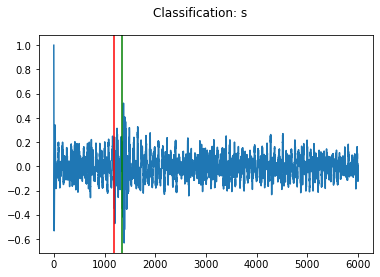

for 71:1
2
2018-10-29T09:31:59.022528Z


<Figure size 432x288 with 0 Axes>

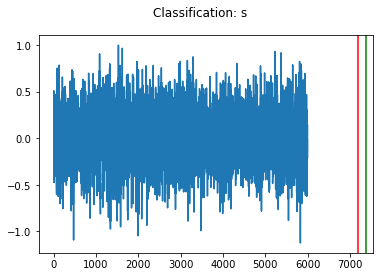

for 72:1
2
2018-10-29T09:32:40.102250Z


<Figure size 432x288 with 0 Axes>

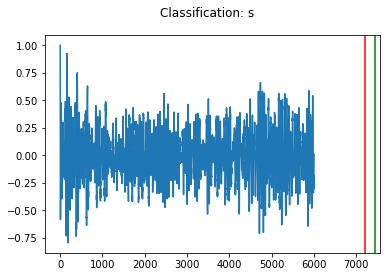

for 73:1
2
2018-10-29T09:50:49.633060Z


<Figure size 432x288 with 0 Axes>

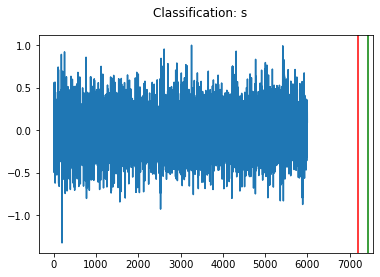

for 74:1
2
2018-10-29T09:53:28.946347Z


<Figure size 432x288 with 0 Axes>

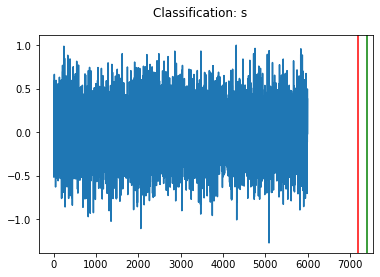

for 75:1
2
2018-10-29T09:57:34.908267Z


<Figure size 432x288 with 0 Axes>

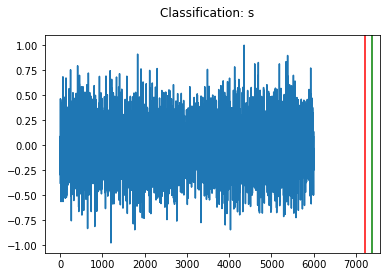

for 76:2
4
2018-10-29T09:58:53.324098Z


<Figure size 432x288 with 0 Axes>

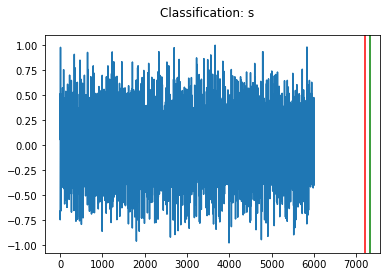

for 77:1
2
2018-10-29T09:59:25.996310Z


<Figure size 432x288 with 0 Axes>

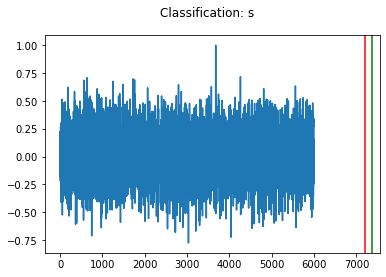

for 78:1
2
2018-10-29T09:59:31.480156Z


<Figure size 432x288 with 0 Axes>

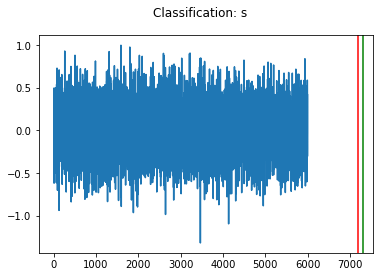

for 79:2
4
2018-12-11T09:19:19.420001Z


<Figure size 432x288 with 0 Axes>

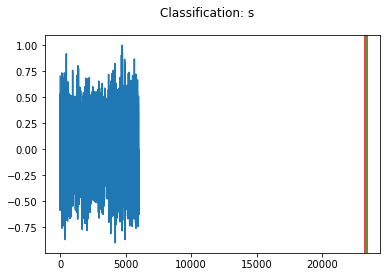

for 80:1
3
2018-12-11T09:22:29.312658Z


<Figure size 432x288 with 0 Axes>

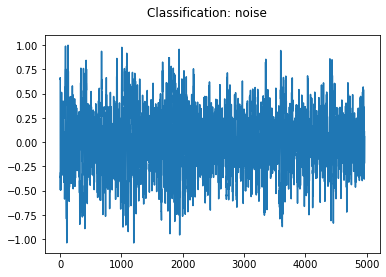

for 81:2
4
2018-12-11T09:25:21.968001Z


<Figure size 432x288 with 0 Axes>

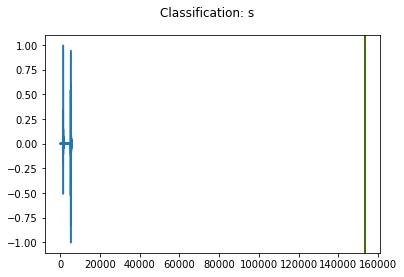

for 82:1
2
2018-12-11T09:25:56.155501Z


<Figure size 432x288 with 0 Axes>

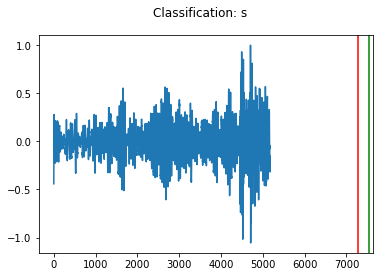

for 83:2
3
2018-12-11T09:27:07.841999Z


<Figure size 432x288 with 0 Axes>

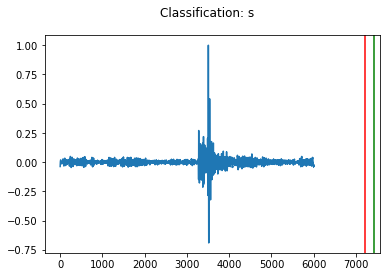

for 84:3
4
2018-12-11T09:27:26.529002Z


<Figure size 432x288 with 0 Axes>

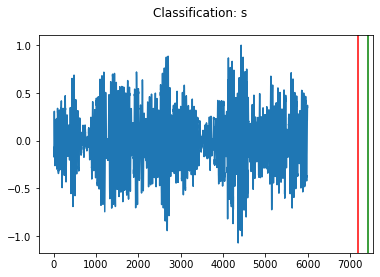

for 85:1
2
2018-12-11T09:28:28.816000Z


<Figure size 432x288 with 0 Axes>

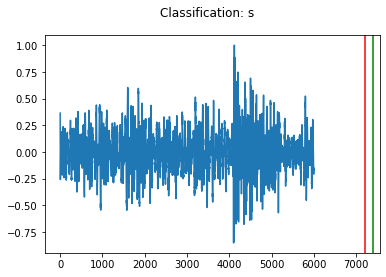

for 86:1
3
2018-12-11T09:33:03.032002Z


<Figure size 432x288 with 0 Axes>

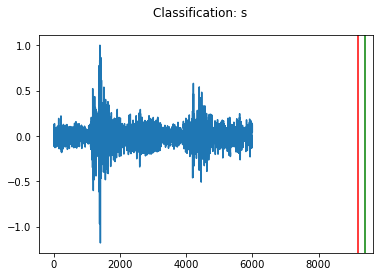

for 87:1
2
2018-12-11T09:33:41.244497Z


<Figure size 432x288 with 0 Axes>

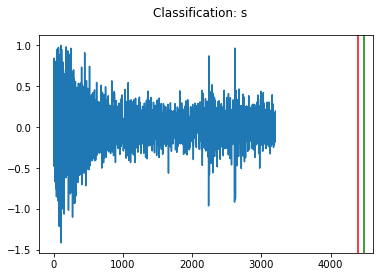

for 88:2
5
2018-12-11T09:37:46.002116Z


<Figure size 432x288 with 0 Axes>

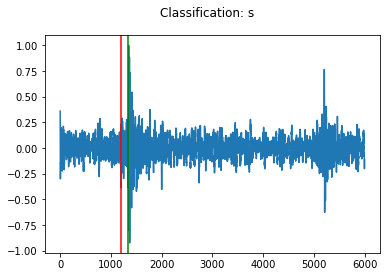

for 89:1
2
2018-12-11T09:41:22.950110Z


<Figure size 432x288 with 0 Axes>

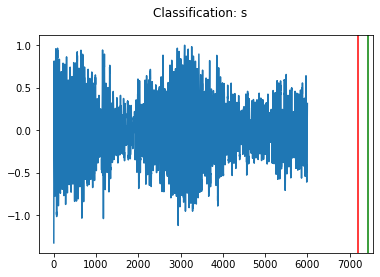

for 90:2
4
2018-12-11T09:42:20.860003Z


<Figure size 432x288 with 0 Axes>

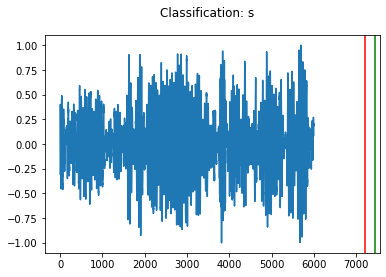

for 91:0
1
2018-12-11T09:43:38.601276Z


<Figure size 432x288 with 0 Axes>

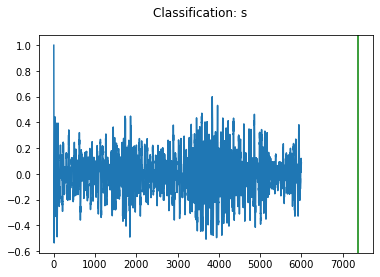

for 92:3
4
2018-12-11T09:50:33.926501Z


<Figure size 432x288 with 0 Axes>

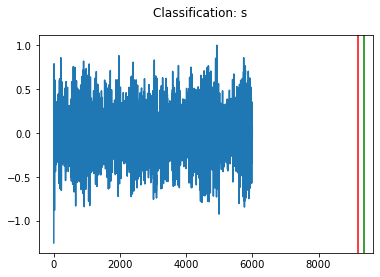

for 93:2
2
2018-12-11T09:50:50.215503Z


<Figure size 432x288 with 0 Axes>

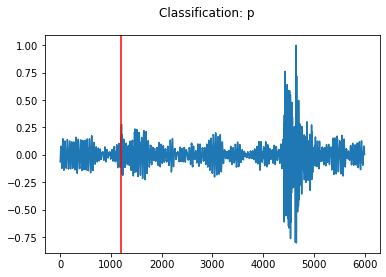

for 94:2
4
2018-12-11T09:52:46.716497Z


<Figure size 432x288 with 0 Axes>

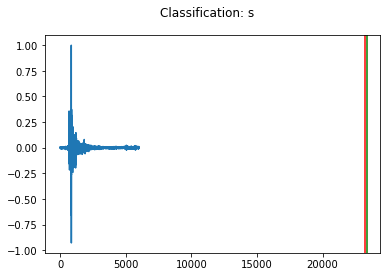

for 95:3
6
2018-12-11T09:54:57.840501Z


<Figure size 432x288 with 0 Axes>

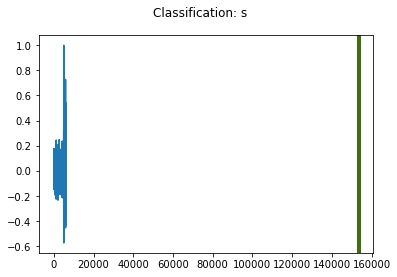

for 96:2
4
2018-12-11T09:55:23.160502Z


<Figure size 432x288 with 0 Axes>

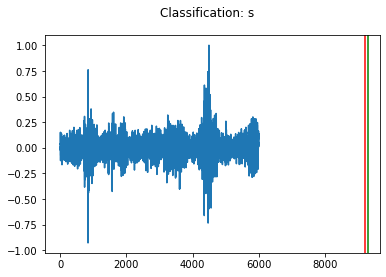

for 97:2
4
2018-12-11T09:55:58.304001Z


<Figure size 432x288 with 0 Axes>

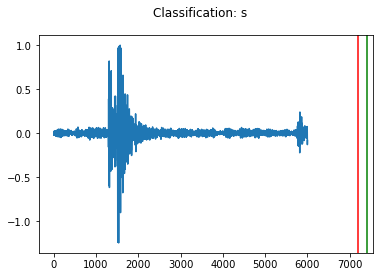

for 98:2
4
2018-12-11T09:57:28.542947Z


<Figure size 432x288 with 0 Axes>

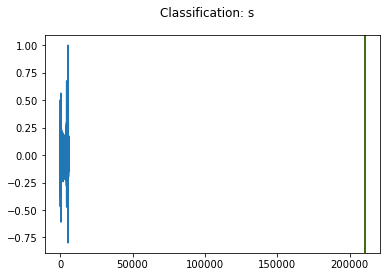

for 99:2
4
2018-12-11T09:59:12.846001Z


<Figure size 432x288 with 0 Axes>

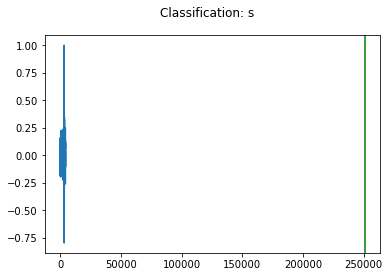

for 100:1
2
2018-12-11T11:21:15.919824Z


<Figure size 432x288 with 0 Axes>

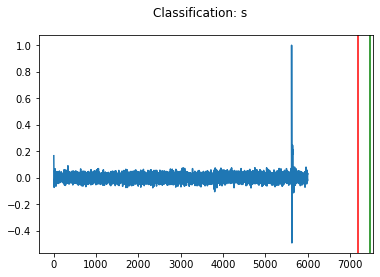

for 101:1
2
2018-10-29T11:30:39.519076Z


<Figure size 432x288 with 0 Axes>

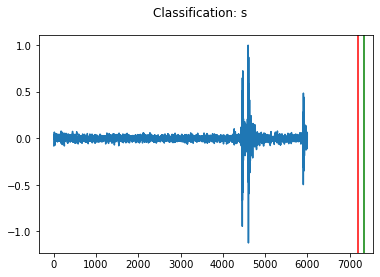

for 102:1
2
2018-10-29T18:01:12.720937Z


<Figure size 432x288 with 0 Axes>

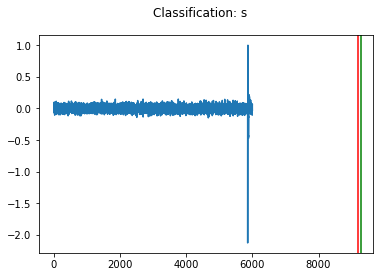

for 103:1
2
2018-10-26T11:36:59.167398Z


<Figure size 432x288 with 0 Axes>

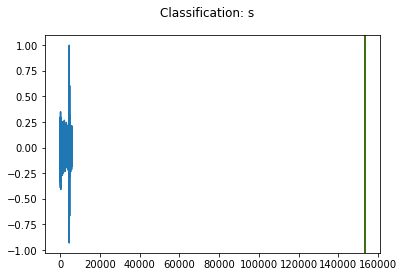

for 104:1
2
2018-10-27T10:55:25.958788Z


<Figure size 432x288 with 0 Axes>

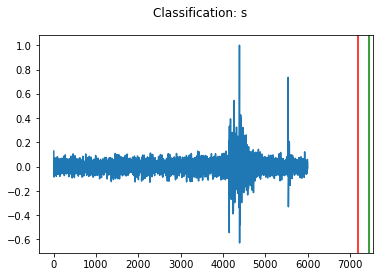

for 105:1
2
2018-11-04T16:24:06.676114Z


<Figure size 432x288 with 0 Axes>

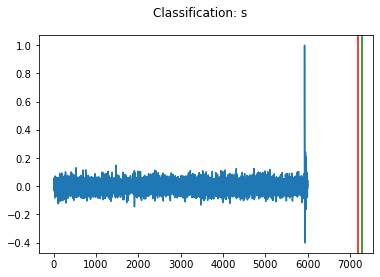

for 106:1
2
2018-10-24T13:02:29.781215Z


<Figure size 432x288 with 0 Axes>

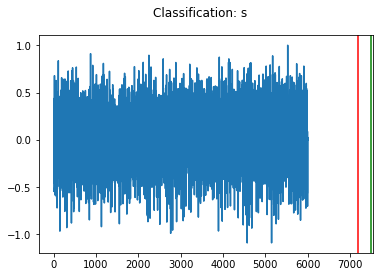

for 107:1
2
2018-10-25T14:59:27.765128Z


<Figure size 432x288 with 0 Axes>

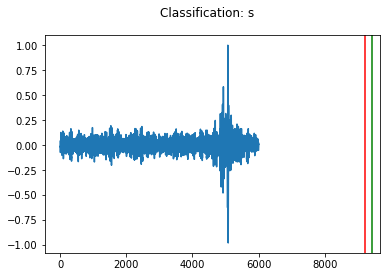

for 108:1
2
2018-10-23T14:45:32.816670Z


<Figure size 432x288 with 0 Axes>

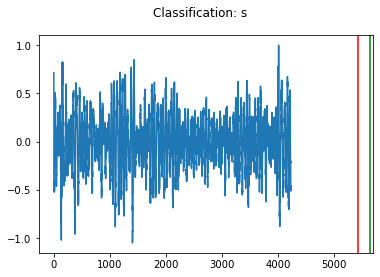

for 109:1
2
2018-12-14T13:41:06.187303Z


<Figure size 432x288 with 0 Axes>

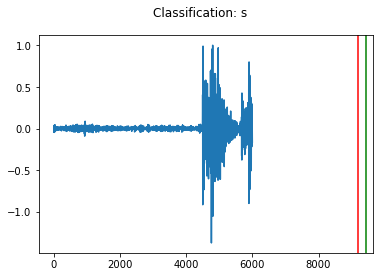

for 110:1
2
2018-10-25T17:00:34.513072Z


<Figure size 432x288 with 0 Axes>

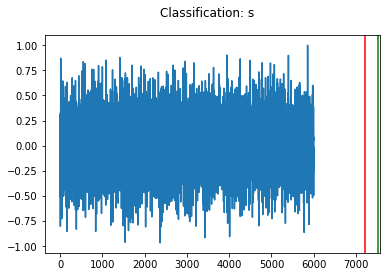

for 111:1
2
2018-10-26T11:26:45.228376Z


<Figure size 432x288 with 0 Axes>

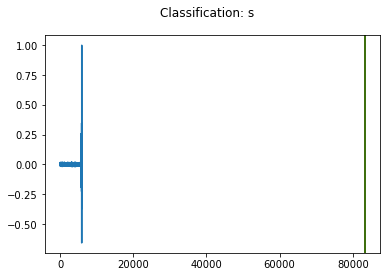

for 112:1
2
2018-12-11T09:53:31.628274Z


<Figure size 432x288 with 0 Axes>

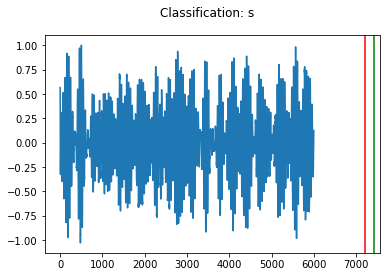

for 113:1
2
2018-10-29T11:58:35.094222Z


<Figure size 432x288 with 0 Axes>

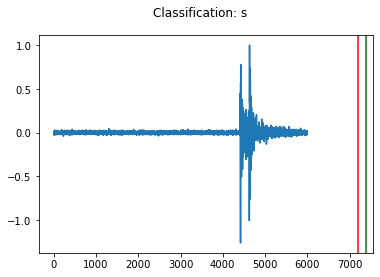

for 114:1
2
2018-12-11T10:06:45.115583Z


<Figure size 432x288 with 0 Axes>

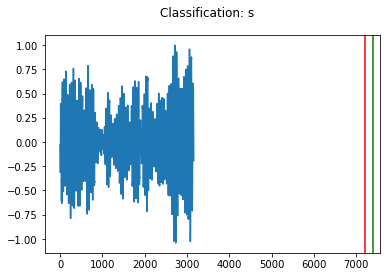

for 115:1
2
2018-12-14T13:09:52.013000Z


<Figure size 432x288 with 0 Axes>

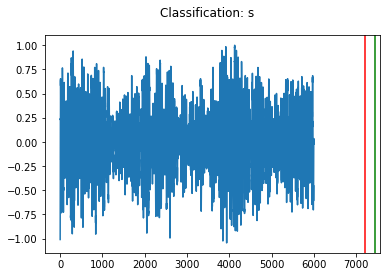

for 116:1
2
2018-12-11T09:35:01.688777Z


<Figure size 432x288 with 0 Axes>

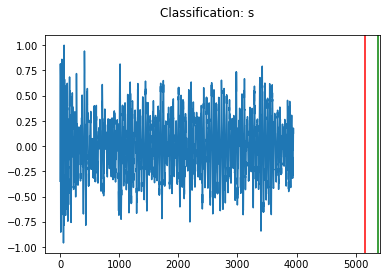

for 117:1
2
2018-10-26T20:39:23.377610Z


<Figure size 432x288 with 0 Axes>

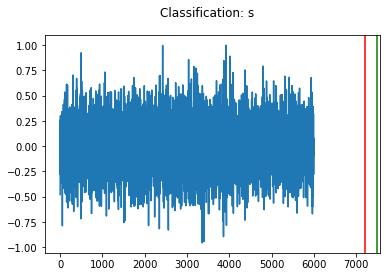

for 118:1
3
2018-10-24T13:26:26.958736Z


<Figure size 432x288 with 0 Axes>

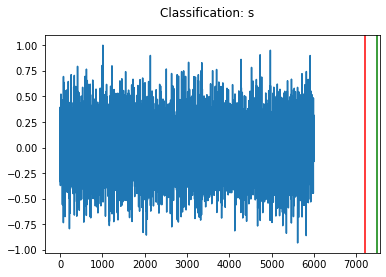

for 119:1
2
2018-12-14T14:51:57.150504Z


<Figure size 432x288 with 0 Axes>

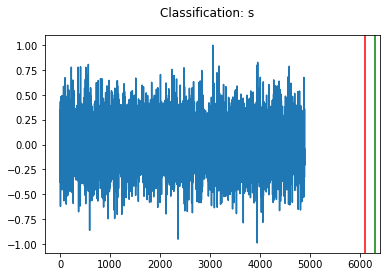

for 120:1
2
2018-12-13T13:25:17.297558Z


<Figure size 432x288 with 0 Axes>

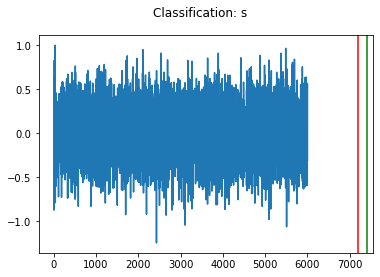

for 121:1
2
2018-12-08T12:28:22.536485Z


<Figure size 432x288 with 0 Axes>

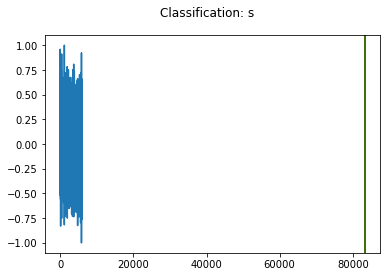

for 122:1
2
2018-10-25T15:06:05.109139Z


<Figure size 432x288 with 0 Axes>

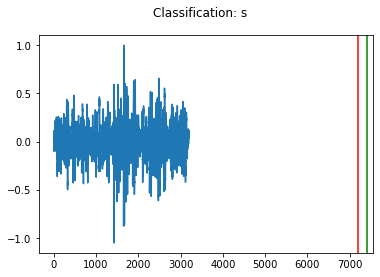

for 123:1
2
2018-10-24T23:56:13.486137Z


<Figure size 432x288 with 0 Axes>

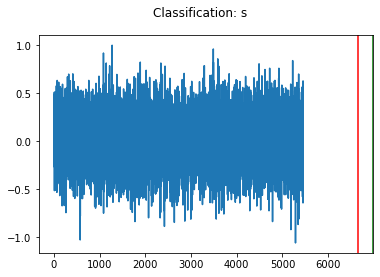

for 124:1
2
2018-10-25T12:40:57.062937Z


<Figure size 432x288 with 0 Axes>

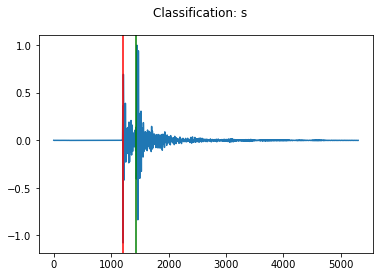

for 125:1
2
2018-10-18T15:48:53.993427Z


<Figure size 432x288 with 0 Axes>

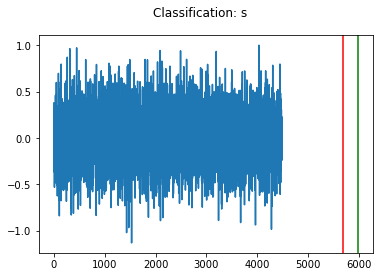

for 126:1
2
2018-12-11T10:34:35.785646Z


<Figure size 432x288 with 0 Axes>

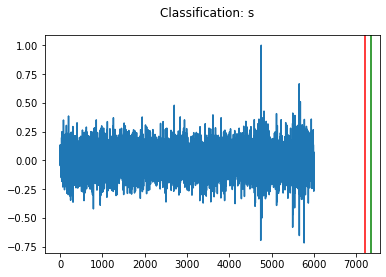

for 127:1
2
2018-10-29T21:13:59.152642Z


<Figure size 432x288 with 0 Axes>

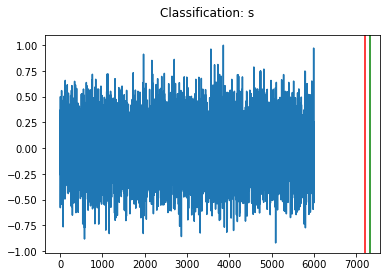

for 128:1
2
2018-10-30T01:37:38.030873Z


<Figure size 432x288 with 0 Axes>

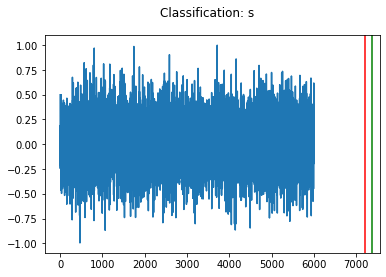

for 129:1
2
2018-10-27T11:44:31.666597Z


<Figure size 432x288 with 0 Axes>

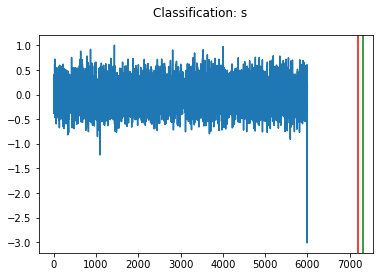

for 130:1
2
2018-12-11T10:18:47.136932Z


<Figure size 432x288 with 0 Axes>

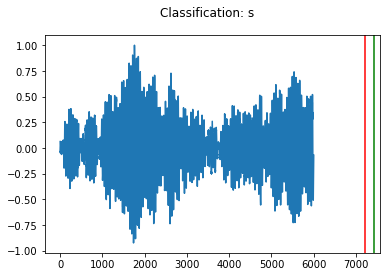

for 131:1
3
2018-10-20T03:44:01.804986Z


<Figure size 432x288 with 0 Axes>

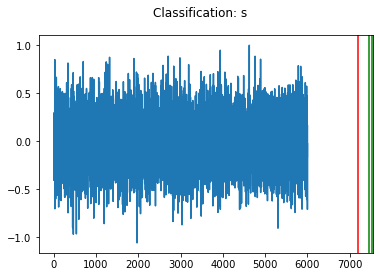

for 132:1
2
2018-10-29T11:44:42.401886Z


<Figure size 432x288 with 0 Axes>

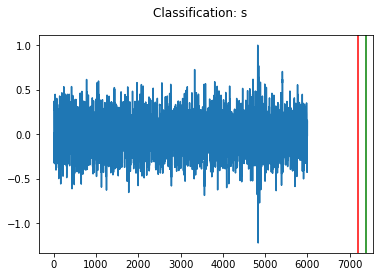

for 133:1
2
2018-10-19T13:20:49.141106Z


<Figure size 432x288 with 0 Axes>

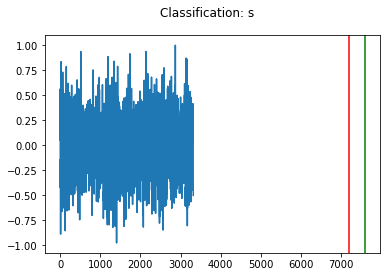

for 134:1
2
2018-10-25T14:56:28.733150Z


<Figure size 432x288 with 0 Axes>

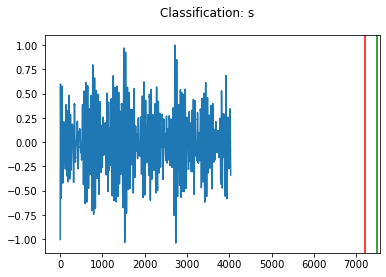

for 135:1
2
2018-10-26T02:13:02.205291Z


<Figure size 432x288 with 0 Axes>

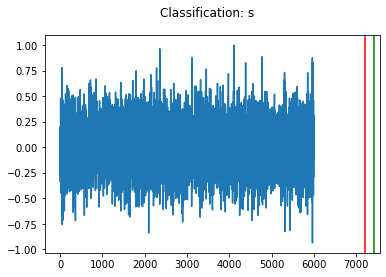

for 136:1
2
2018-12-10T10:30:58.344963Z


<Figure size 432x288 with 0 Axes>

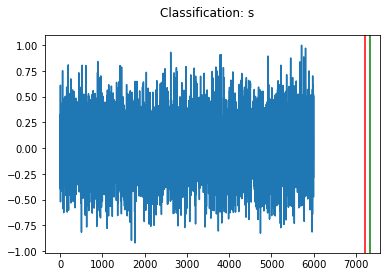

for 137:1
2
2018-12-11T10:20:28.023469Z


<Figure size 432x288 with 0 Axes>

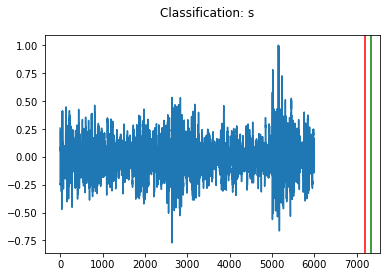

for 138:1
2
2018-10-27T11:07:17.201670Z


<Figure size 432x288 with 0 Axes>

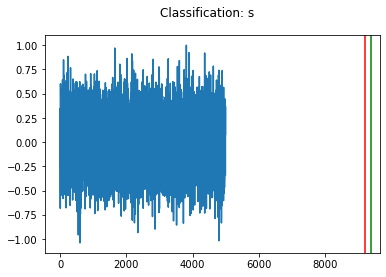

for 139:1
2
2018-12-14T13:06:37.398000Z


<Figure size 432x288 with 0 Axes>

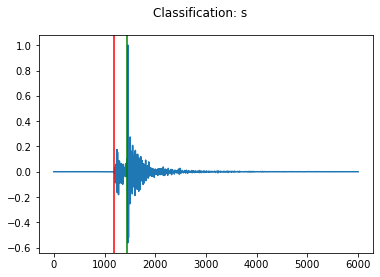

for 140:1
2
2018-10-26T14:14:04.309392Z


<Figure size 432x288 with 0 Axes>

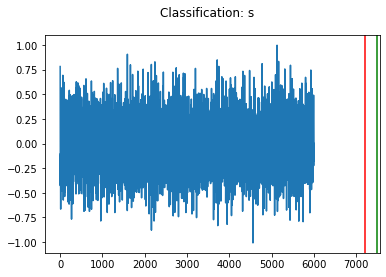

for 141:1
2
2018-10-26T11:17:03.358776Z


<Figure size 432x288 with 0 Axes>

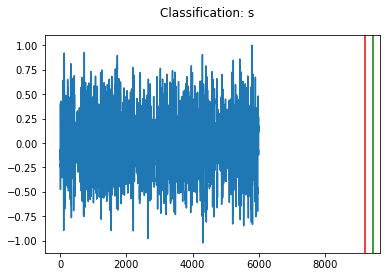

for 142:1
2
2018-12-14T13:18:30.776496Z


<Figure size 432x288 with 0 Axes>

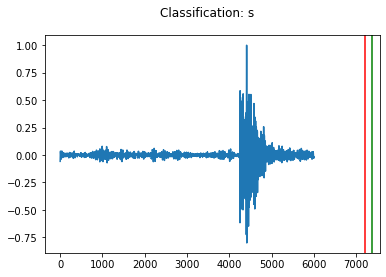

for 143:1
2
2018-12-11T09:34:03.780759Z


<Figure size 432x288 with 0 Axes>

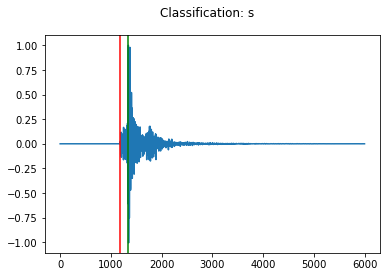

for 144:1
2
2018-10-25T17:04:13.867001Z


<Figure size 432x288 with 0 Axes>

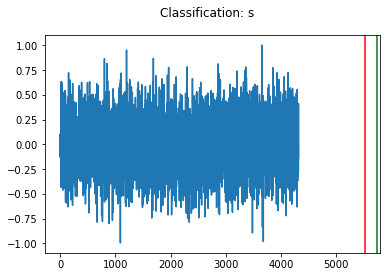

for 145:1
2
2018-10-24T13:19:01.059000Z


<Figure size 432x288 with 0 Axes>

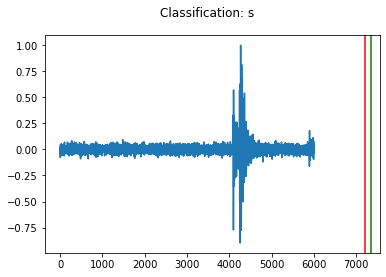

for 146:1
2
2018-10-29T11:43:29.894477Z


<Figure size 432x288 with 0 Axes>

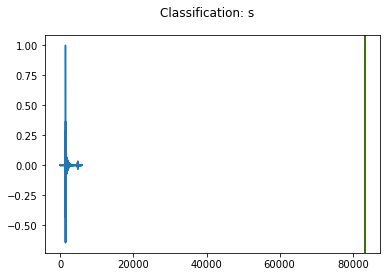

for 147:1
2
2018-10-25T15:24:29.162999Z


<Figure size 432x288 with 0 Axes>

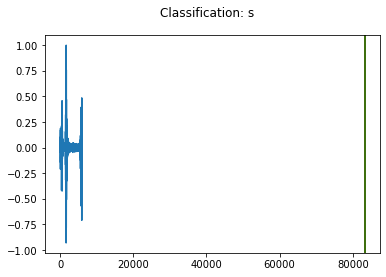

for 148:1
2
2018-10-24T12:57:14.321501Z


<Figure size 432x288 with 0 Axes>

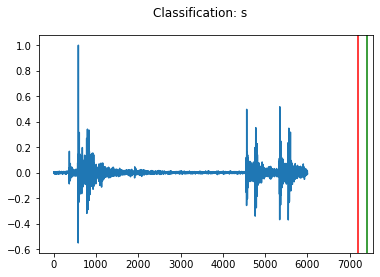

for 149:1
2
2018-10-25T15:22:59.470499Z


<Figure size 432x288 with 0 Axes>

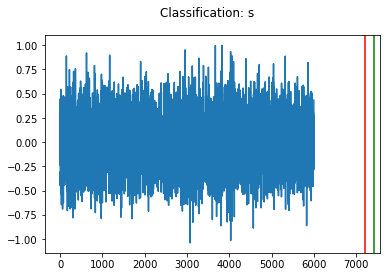

for 150:0
1
2018-12-15T09:40:07.540999Z


<Figure size 432x288 with 0 Axes>

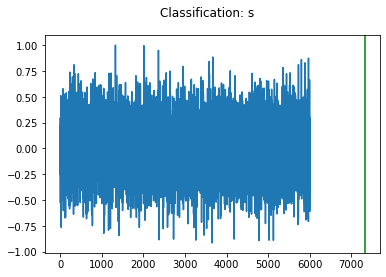

for 151:1
2
2018-12-14T19:22:45.418000Z


<Figure size 432x288 with 0 Axes>

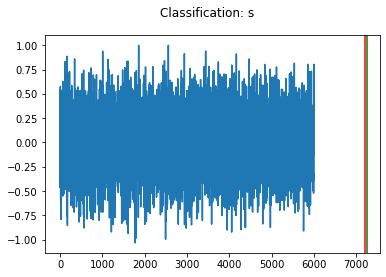

for 152:1
2
2018-12-15T05:14:05.670001Z


<Figure size 432x288 with 0 Axes>

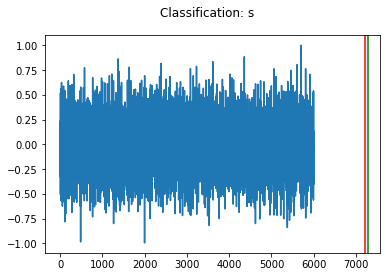

for 153:1
2
2018-12-14T20:17:15.722500Z


<Figure size 432x288 with 0 Axes>

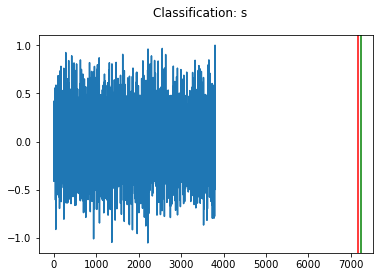

for 154:1
2
2018-12-18T02:37:07.055323Z


<Figure size 432x288 with 0 Axes>

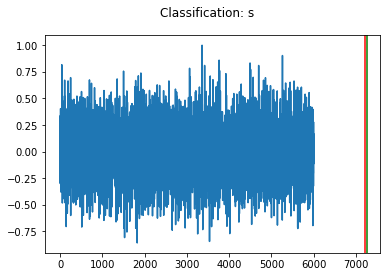

for 155:1
1
2018-12-18T08:08:33.549378Z


<Figure size 432x288 with 0 Axes>

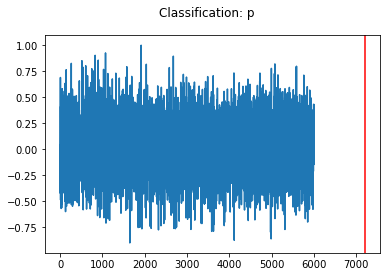

for 156:1
2
2018-12-14T19:05:19.866270Z


<Figure size 432x288 with 0 Axes>

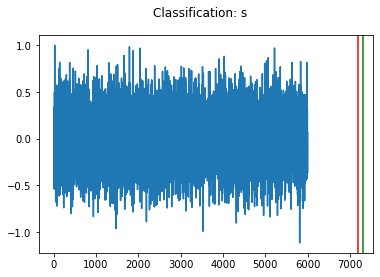

for 157:1
2
2018-12-17T17:53:15.555503Z


<Figure size 432x288 with 0 Axes>

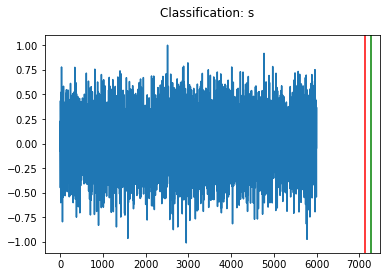

for 158:1
2
2018-12-18T08:09:11.718826Z


<Figure size 432x288 with 0 Axes>

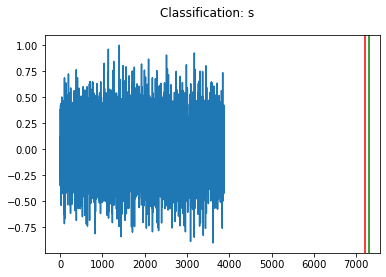

for 159:1
2
2018-12-18T00:16:31.301860Z


<Figure size 432x288 with 0 Axes>

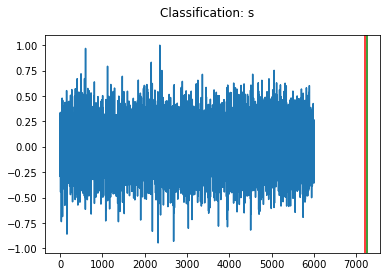

for 160:1
2
2018-12-15T04:24:17.922999Z


<Figure size 432x288 with 0 Axes>

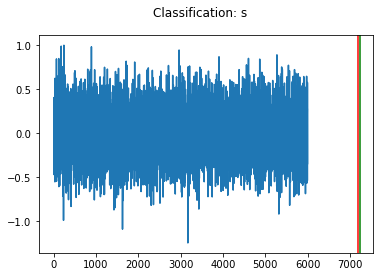

for 161:1
2
2018-12-17T18:23:08.079902Z


<Figure size 432x288 with 0 Axes>

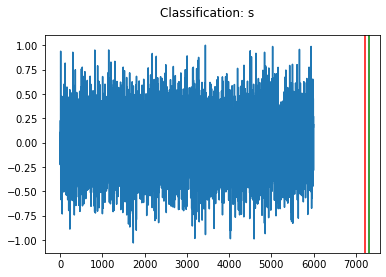

for 162:1
2
2018-12-17T17:35:41.090749Z


<Figure size 432x288 with 0 Axes>

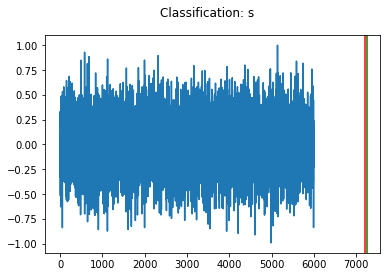

for 163:1
3
2018-12-14T15:45:00.607000Z


<Figure size 432x288 with 0 Axes>

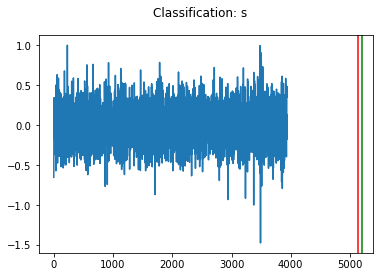

for 164:1
2
2018-12-17T19:39:35.757497Z


<Figure size 432x288 with 0 Axes>

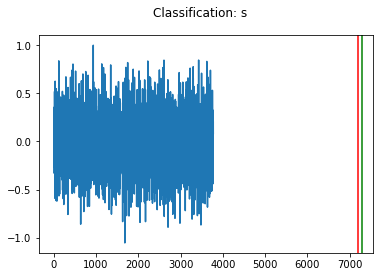

for 165:0
1
2018-12-18T00:20:43.195939Z


<Figure size 432x288 with 0 Axes>

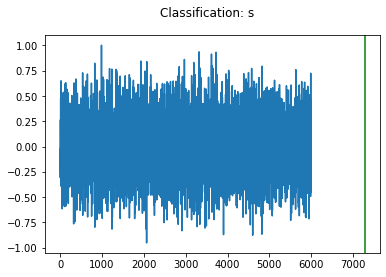

for 166:1
2
2018-12-18T00:39:03.223666Z


<Figure size 432x288 with 0 Axes>

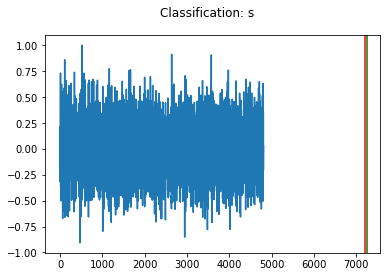

for 167:1
2
2018-12-15T03:05:17.620441Z


<Figure size 432x288 with 0 Axes>

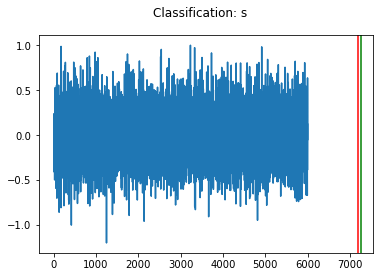

for 168:1
2
2018-12-18T03:38:55.770431Z


<Figure size 432x288 with 0 Axes>

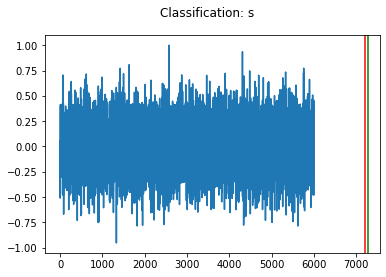

for 169:1
2
2018-12-18T04:16:03.727612Z


<Figure size 432x288 with 0 Axes>

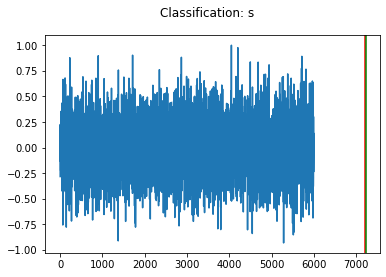

for 170:1
2
2018-12-18T03:49:23.567724Z


<Figure size 432x288 with 0 Axes>

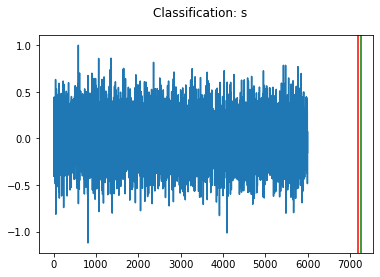

for 171:1
2
2018-12-14T20:53:07.933002Z


<Figure size 432x288 with 0 Axes>

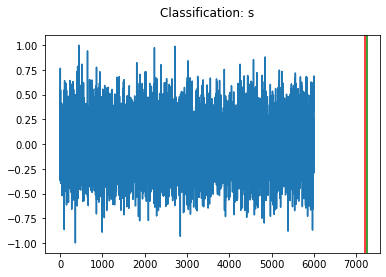

for 172:1
2
2018-12-17T16:25:31.908592Z


<Figure size 432x288 with 0 Axes>

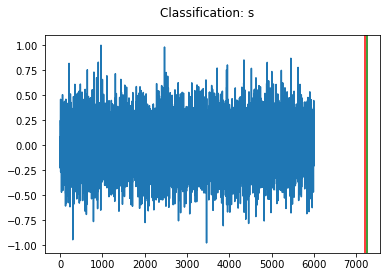

for 173:1
2
2018-12-14T14:59:47.016501Z


<Figure size 432x288 with 0 Axes>

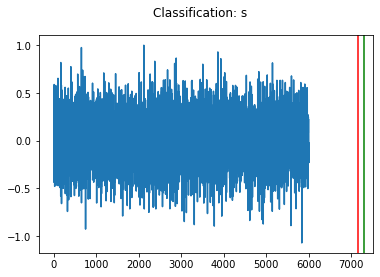

for 174:1
2
2018-12-17T22:22:55.306300Z


<Figure size 432x288 with 0 Axes>

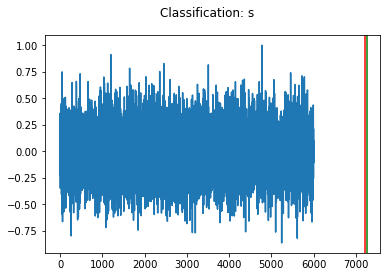

for 175:1
2
2018-12-17T23:33:57.752907Z


<Figure size 432x288 with 0 Axes>

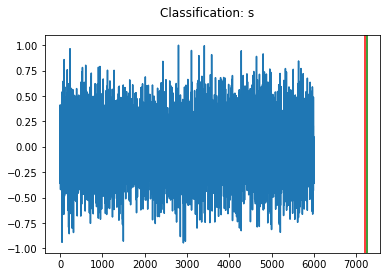

for 176:1
2
2018-12-18T01:05:38.853657Z


<Figure size 432x288 with 0 Axes>

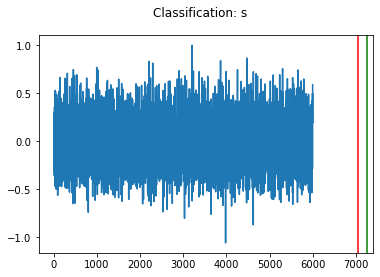

for 177:1
2
2018-12-17T20:33:53.967724Z


<Figure size 432x288 with 0 Axes>

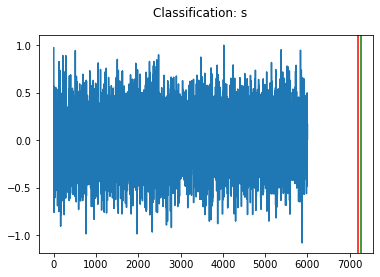

for 178:1
2
2018-12-14T19:41:43.690502Z


<Figure size 432x288 with 0 Axes>

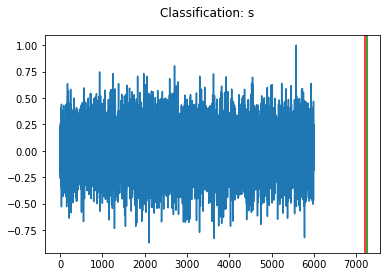

for 179:1
2
2018-12-18T05:43:59.435138Z


<Figure size 432x288 with 0 Axes>

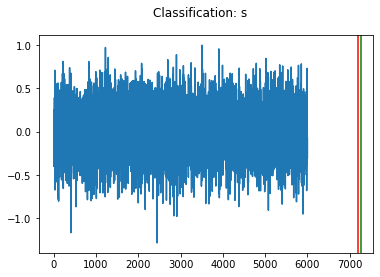

for 180:2
4
2018-12-14T16:34:59.789000Z


<Figure size 432x288 with 0 Axes>

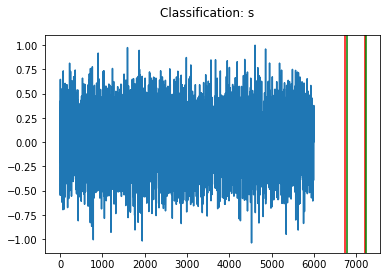

for 181:2
3
2018-12-18T02:14:27.949875Z


<Figure size 432x288 with 0 Axes>

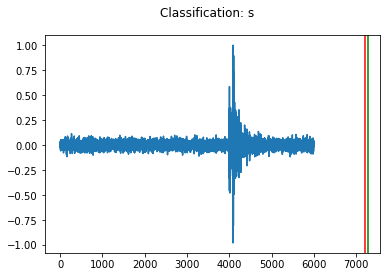

for 182:1
2
2018-12-17T23:51:17.507954Z


<Figure size 432x288 with 0 Axes>

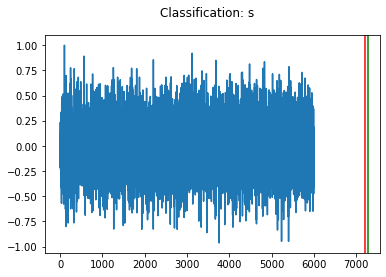

for 183:1
2
2018-12-18T08:22:58.056358Z


<Figure size 432x288 with 0 Axes>

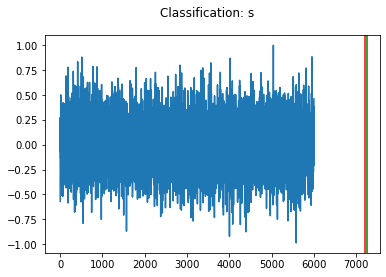

for 184:1
2
2018-12-14T17:22:42.675499Z


<Figure size 432x288 with 0 Axes>

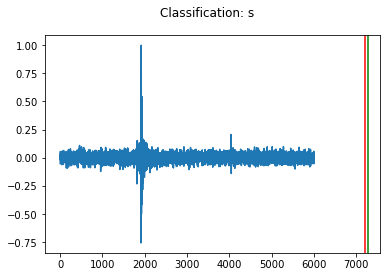

for 185:2
4
2018-12-15T03:03:12.658500Z


<Figure size 432x288 with 0 Axes>

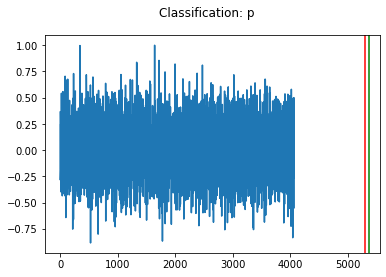

for 186:1
2
2018-12-17T18:35:58.865838Z


<Figure size 432x288 with 0 Axes>

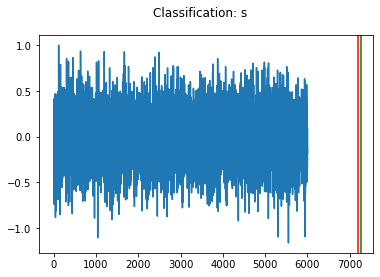

for 187:1
2
2018-12-15T04:53:41.535500Z


<Figure size 432x288 with 0 Axes>

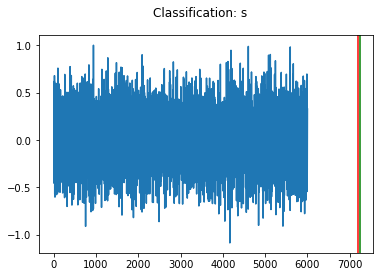

for 188:1
2
2018-12-17T19:46:31.569621Z


<Figure size 432x288 with 0 Axes>

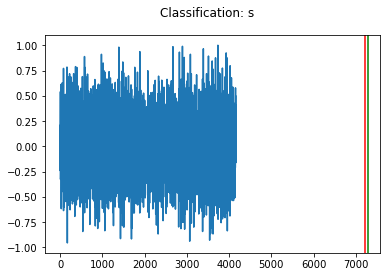

for 189:1
2
2018-12-18T01:06:05.327945Z


<Figure size 432x288 with 0 Axes>

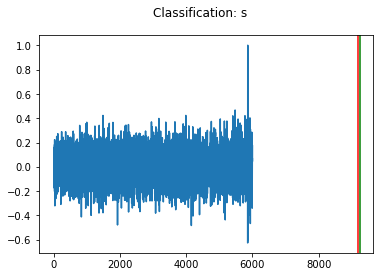

for 190:2
4
2018-12-14T15:03:35.531500Z


<Figure size 432x288 with 0 Axes>

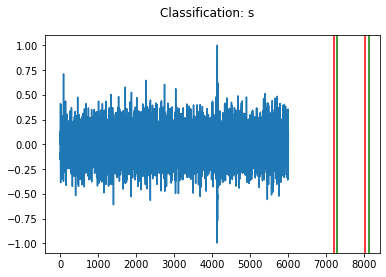

for 191:1
2
2018-12-18T04:02:55.329356Z


<Figure size 432x288 with 0 Axes>

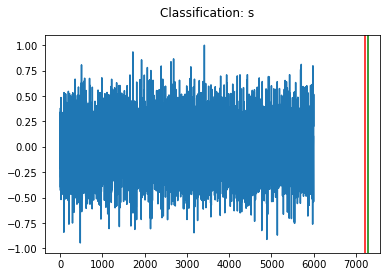

for 192:2
4
2018-12-14T17:35:11.920328Z


<Figure size 432x288 with 0 Axes>

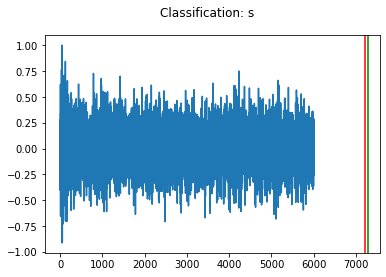

for 193:1
2
2018-12-17T21:07:05.393411Z


<Figure size 432x288 with 0 Axes>

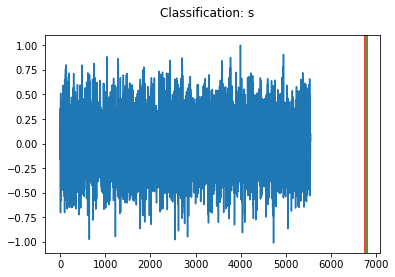

for 194:1
2
2018-12-14T20:25:16.036501Z


<Figure size 432x288 with 0 Axes>

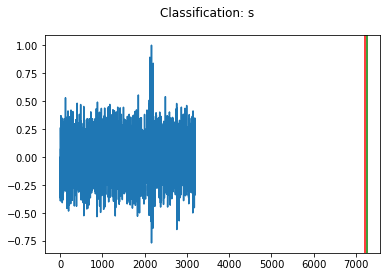

for 195:2
3
2018-12-18T05:28:27.166603Z


<Figure size 432x288 with 0 Axes>

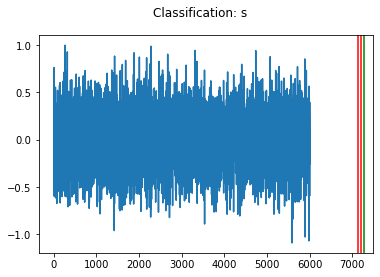

for 196:0
1
2018-12-15T04:40:32.564846Z


<Figure size 432x288 with 0 Axes>

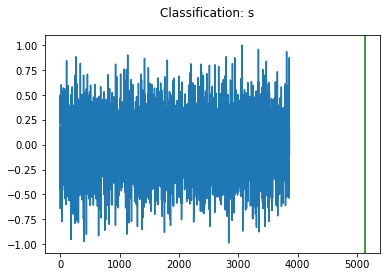

for 197:1
2
2018-12-14T15:59:47.932001Z


<Figure size 432x288 with 0 Axes>

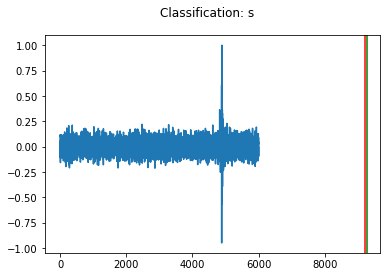

for 198:1
2
2018-12-17T19:05:27.053105Z


<Figure size 432x288 with 0 Axes>

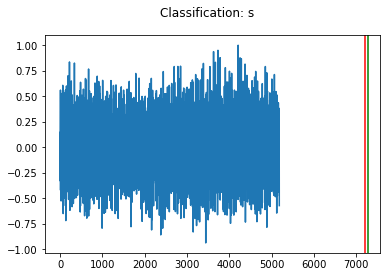

for 199:1
2
2018-12-15T14:18:26.986000Z


<Figure size 432x288 with 0 Axes>

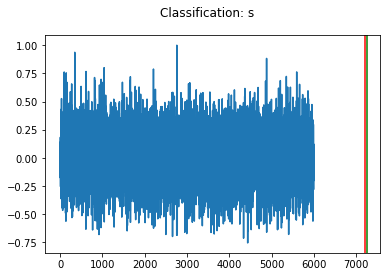

for 200:2
4
2018-10-16T13:50:03.054497Z


<Figure size 432x288 with 0 Axes>

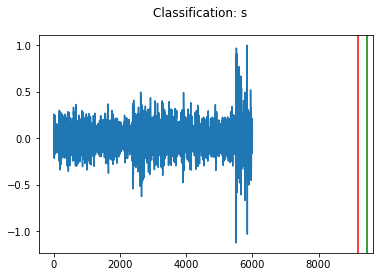

for 201:1
2
2018-10-18T14:36:56.365577Z


<Figure size 432x288 with 0 Axes>

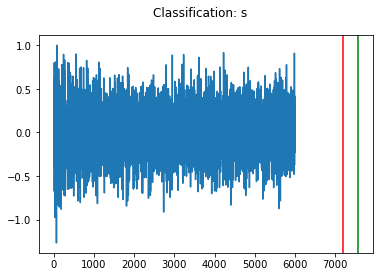

for 202:1
2
2018-10-18T15:28:10.374497Z


<Figure size 432x288 with 0 Axes>

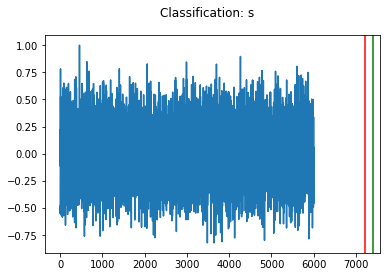

for 203:1
2
2018-10-22T11:50:58.318499Z


<Figure size 432x288 with 0 Axes>

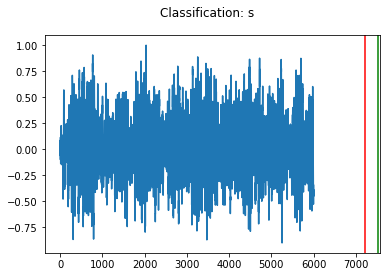

for 204:1
2
2018-10-24T13:39:32.605000Z


<Figure size 432x288 with 0 Axes>

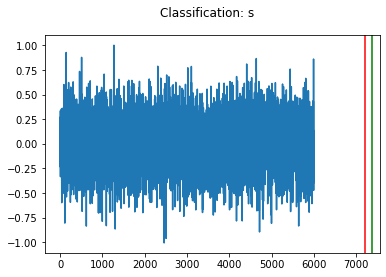

for 205:1
2
2018-10-24T13:50:30.363500Z


<Figure size 432x288 with 0 Axes>

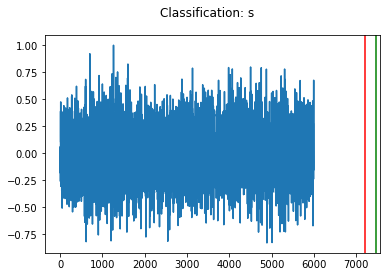

for 206:1
2
2018-10-25T11:35:09.063999Z


<Figure size 432x288 with 0 Axes>

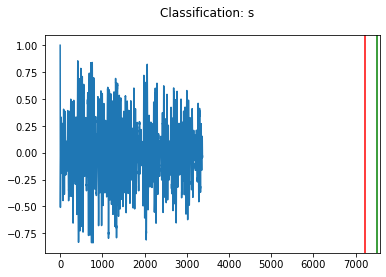

for 207:2
3
2018-10-25T12:06:06.030500Z


<Figure size 432x288 with 0 Axes>

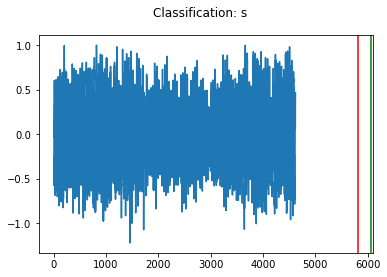

for 208:1
2
2018-10-25T13:06:04.392500Z


<Figure size 432x288 with 0 Axes>

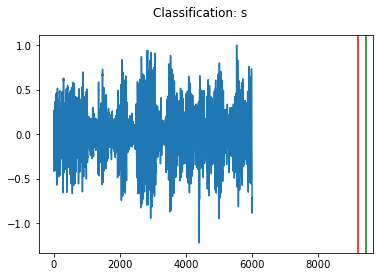

for 209:1
2
2018-10-25T13:24:57.868499Z


<Figure size 432x288 with 0 Axes>

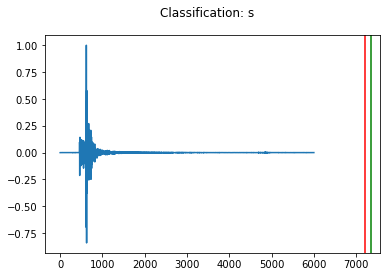

for 210:1
2
2018-10-25T14:51:08.971501Z


<Figure size 432x288 with 0 Axes>

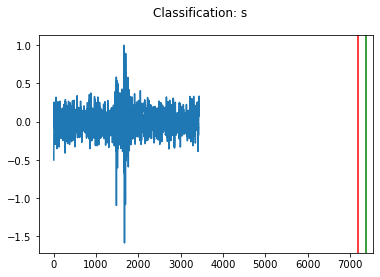

for 211:1
2
2018-10-25T15:21:02.568500Z


<Figure size 432x288 with 0 Axes>

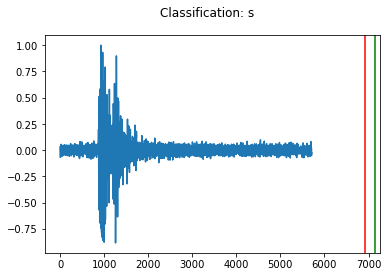

for 212:1
2
2018-10-25T15:29:13.992499Z


<Figure size 432x288 with 0 Axes>

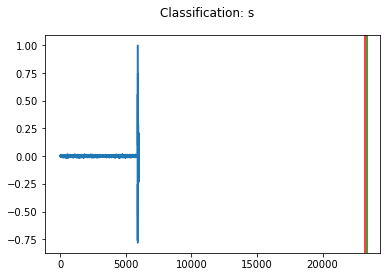

for 213:2
4
2018-10-26T08:41:33.930720Z


<Figure size 432x288 with 0 Axes>

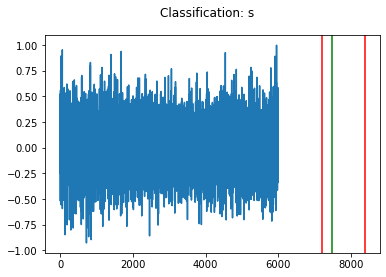

for 214:1
2
2018-10-26T11:10:38.751499Z


<Figure size 432x288 with 0 Axes>

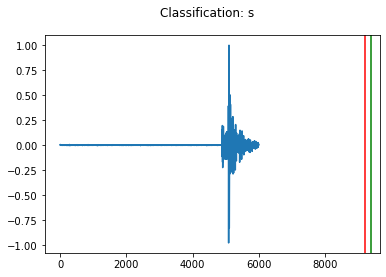

for 215:1
2
2018-10-27T11:03:25.592501Z


<Figure size 432x288 with 0 Axes>

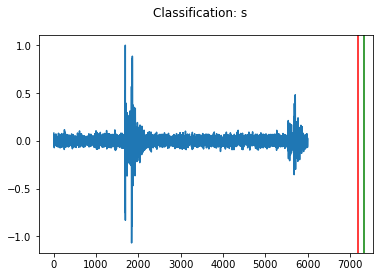

for 216:1
2
2018-10-27T11:07:27.968499Z


<Figure size 432x288 with 0 Axes>

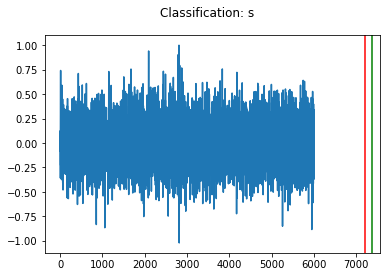

for 217:1
2
2018-10-30T14:44:14.028515Z


<Figure size 432x288 with 0 Axes>

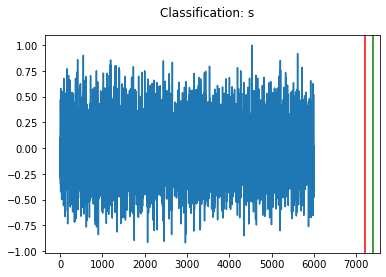

for 218:1
2
2018-10-31T08:22:53.634743Z


<Figure size 432x288 with 0 Axes>

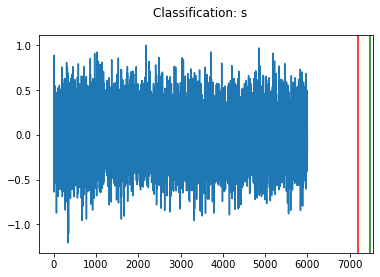

for 219:1
2
2018-10-31T10:41:20.509942Z


<Figure size 432x288 with 0 Axes>

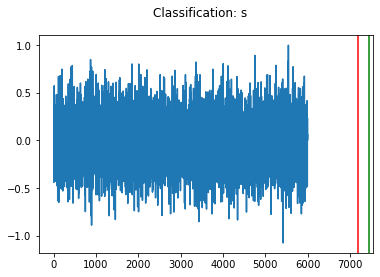

for 220:1
2
2018-12-09T21:15:05.094503Z


<Figure size 432x288 with 0 Axes>

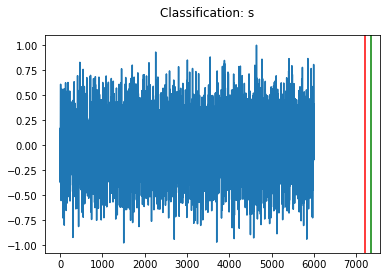

for 221:1
2
2018-12-10T12:38:48.028501Z


<Figure size 432x288 with 0 Axes>

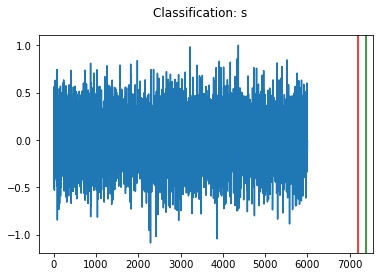

for 222:2
4
2018-12-11T10:02:18.704499Z


<Figure size 432x288 with 0 Axes>

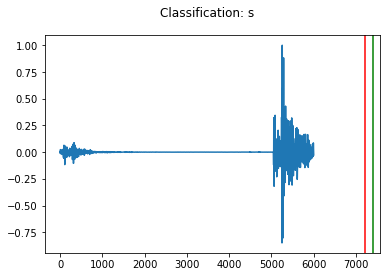

for 223:1
2
2018-12-14T13:08:09.864999Z


<Figure size 432x288 with 0 Axes>

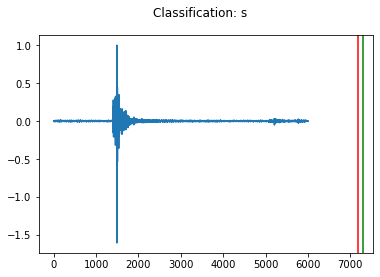

for 224:1
2
2018-12-14T14:29:28.540495Z


<Figure size 432x288 with 0 Axes>

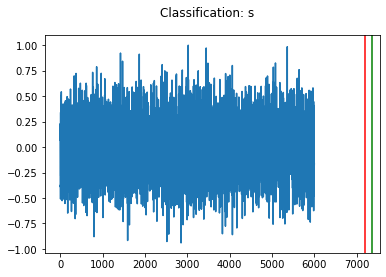

for 225:1
2
2018-10-16T14:19:06.757500Z


<Figure size 432x288 with 0 Axes>

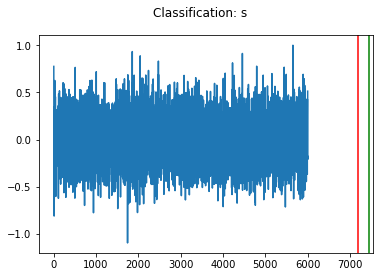

for 226:1
2
2018-10-16T15:09:03.861004Z


<Figure size 432x288 with 0 Axes>

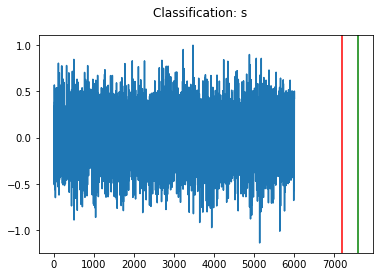

for 227:1
2
2018-10-17T17:42:02.327497Z


<Figure size 432x288 with 0 Axes>

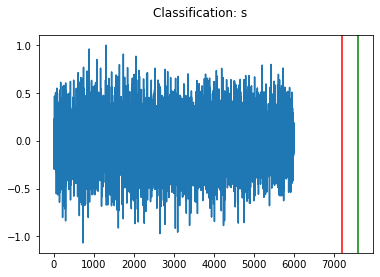

for 228:1
3
2018-10-17T18:08:09.744003Z


<Figure size 432x288 with 0 Axes>

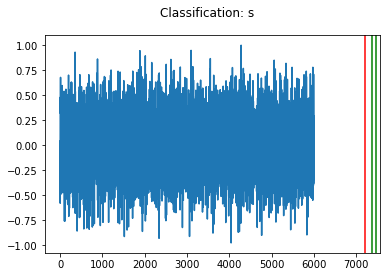

for 229:1
2
2018-10-18T14:33:02.257499Z


<Figure size 432x288 with 0 Axes>

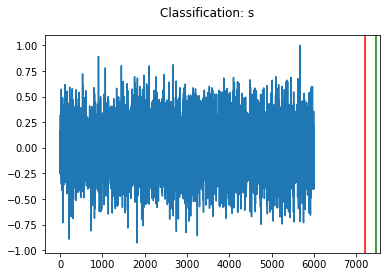

for 230:1
2
2018-10-18T14:51:27.571075Z


<Figure size 432x288 with 0 Axes>

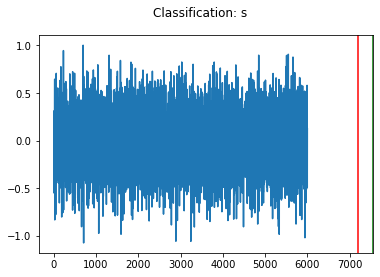

for 231:1
2
2018-10-19T12:51:45.401329Z


<Figure size 432x288 with 0 Axes>

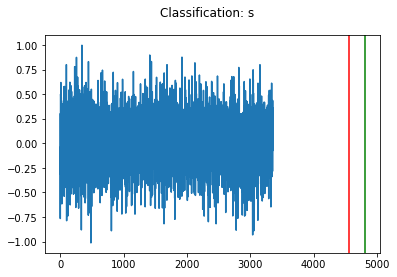

for 232:1
2
2018-10-22T22:16:28.447965Z


<Figure size 432x288 with 0 Axes>

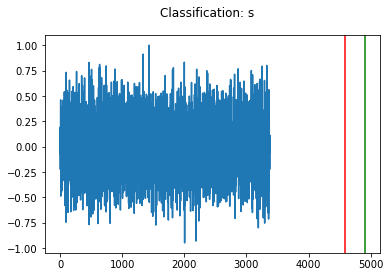

for 233:4
8
2018-10-25T11:39:17.202878Z


<Figure size 432x288 with 0 Axes>

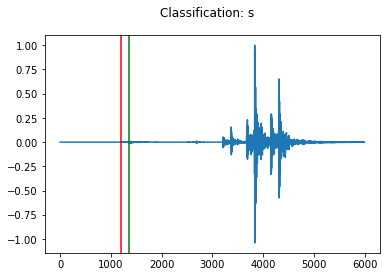

for 234:1
2
2018-10-25T12:17:17.935881Z


<Figure size 432x288 with 0 Axes>

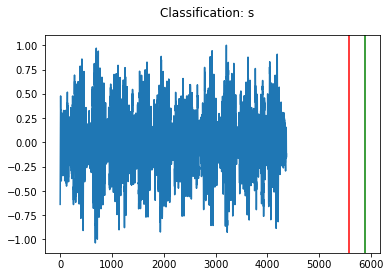

for 235:1
3
2018-10-25T12:41:31.613562Z


<Figure size 432x288 with 0 Axes>

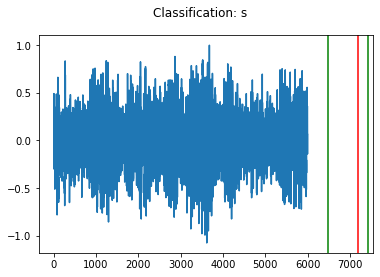

for 236:2
4
2018-10-25T15:07:15.980209Z


<Figure size 432x288 with 0 Axes>

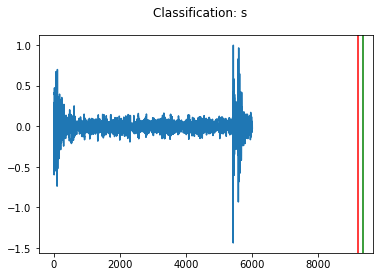

for 237:2
4
2018-10-25T17:08:35.407500Z


<Figure size 432x288 with 0 Axes>

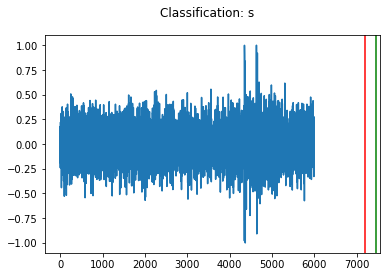

for 238:1
2
2018-10-26T11:33:25.464501Z


<Figure size 432x288 with 0 Axes>

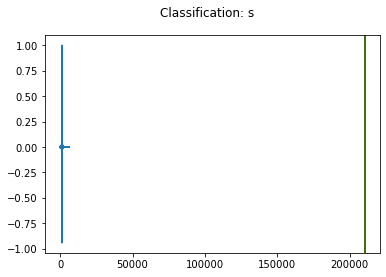

for 239:1
2
2018-10-27T10:38:21.402500Z


<Figure size 432x288 with 0 Axes>

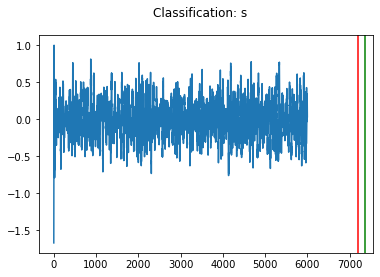

for 240:1
2
2018-10-27T10:59:00.343500Z


<Figure size 432x288 with 0 Axes>

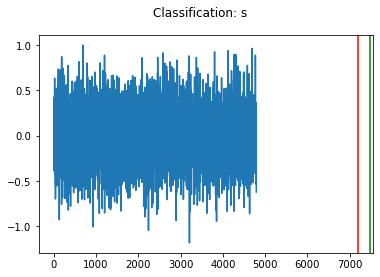

for 241:1
2
2018-10-27T14:33:33.790499Z


<Figure size 432x288 with 0 Axes>

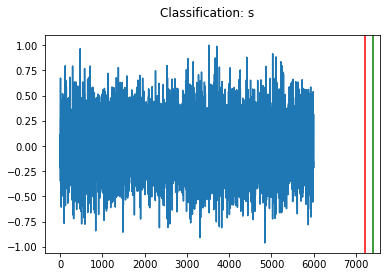

for 242:1
2
2018-11-02T17:46:02.084999Z


<Figure size 432x288 with 0 Axes>

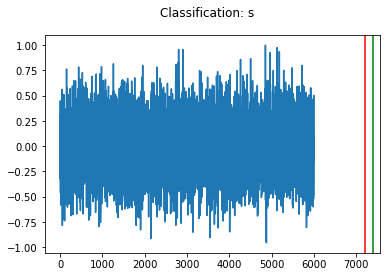

for 243:3
4
2018-12-11T09:21:27.727003Z


<Figure size 432x288 with 0 Axes>

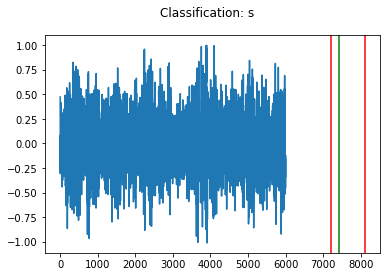

for 244:3
5
2018-12-11T09:32:04.531499Z


<Figure size 432x288 with 0 Axes>

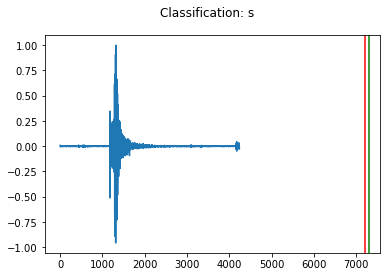

for 245:1
2
2018-12-11T10:29:19.072503Z


<Figure size 432x288 with 0 Axes>

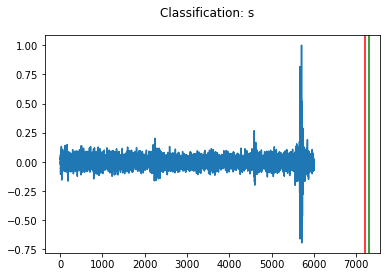

for 246:2
4
2018-12-13T11:19:20.107003Z


<Figure size 432x288 with 0 Axes>

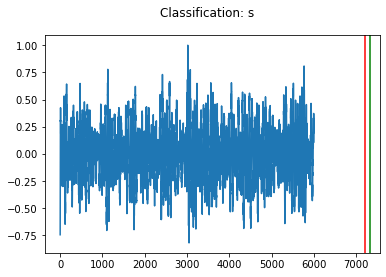

for 247:1
2
2018-12-14T20:12:31.725999Z


<Figure size 432x288 with 0 Axes>

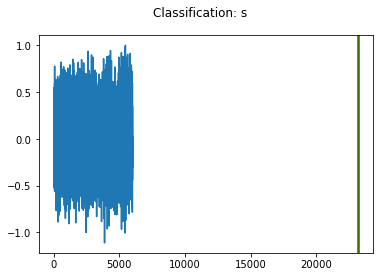

for 248:3
5
2018-12-17T11:31:06.791688Z


<Figure size 432x288 with 0 Axes>

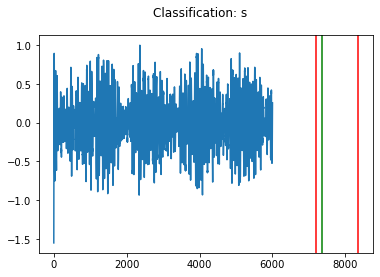

for 249:2
3
2018-12-17T12:07:50.291187Z


<Figure size 432x288 with 0 Axes>

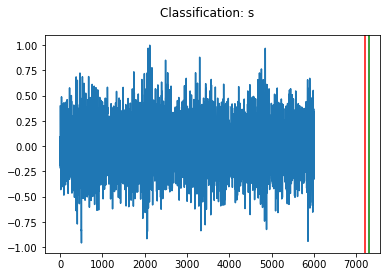

250
All done with S.


<Figure size 432x288 with 0 Axes>

In [88]:

# looking at what the df looks like

folders = glob.glob('./output_S/CF2021/*')
folders.sort()

# make a dataframe for each event, put all picks in one df
# limit the pick starttime to +- 500 samples (+- 0.25s) from the pick time

results_S = pd.DataFrame(index= np.arange(0,len(S_df)),columns=['time', 'sta', 'pha', 'prob'])

for i in np.arange(0,len(folders)):
# for i in np.arange(0,3):
    
    df = pd.DataFrame()
    files = glob.glob(str(folders[i]) + '/*.csv')
    files.sort()
    picks_df = pd.read_csv(files[0],delim_whitespace=True)
    p_idx = literal_eval(picks_df['p_idx'].iloc[0])
    s_idx = literal_eval(picks_df['s_idx'].iloc[0])
    p_prob = literal_eval(picks_df['p_prob'].iloc[0])
    s_prob = literal_eval(picks_df['s_prob'].iloc[0])
    p_amp = literal_eval(picks_df['p_amp'].iloc[0])
    s_amp = literal_eval(picks_df['s_amp'].iloc[0])
    
    p_times = []
    
    for j in np.arange(0,len(p_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (p_idx[j]/2000)
        p_times.append(time1)
        
    s_times = []
    for j in np.arange(0,len(s_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (s_idx[j]/2000)
        s_times.append(time1)
        
    df_P = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(p_times)))
    for j in np.arange(0,len(p_times)):
        df_P['time'].iloc[j] = p_times[j]
        df_P['pha'].iloc[j] = 'p'
        df_P['prob'].iloc[j] = p_prob[j]
        df_P['amp'].iloc[j] = p_amp[j]
        if (i+1)<10:
            df_P['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_P['sta'].iloc[j] = '0'+str(i+1)     
    

    df_S = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(s_times)))
    for j in np.arange(0,len(s_times)):
        df_S['time'].iloc[j] = s_times[j]
        df_S['pha'].iloc[j] = 's'
        df_S['prob'].iloc[j] = s_prob[j]
        df_S['amp'].iloc[j] = s_amp[j]
        if (i+1)<10:
            df_S['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_S['sta'].iloc[j] = '0'+str(i+1)
    print('for ' + str(i) + ':' + str(len(df_P)))        
    df = pd.concat([df,df_P,df_S])
    print(len(df))
    
    ####################################################
    # filtering the picks out and visualising them
    ####################################################
    
    midwindow = S_df['starttime'].iloc[i]
    toplim = midwindow + 0.5
    botlim = midwindow - 0.5
    print(midwindow)


    df_final = df[df['time'] >= botlim]
    df_final = df_final[df_final['time'] <= toplim]
    
    st = read(glob.glob(data_dir[i] + '/*')[0])

    fig, axs = plt.subplots(1)

    # get the one nearest to the middle of the window
    if len(df_final) > 0:
        timediff = []
        for dfii in np.arange(0,len(df_final)):
            timediff1 = abs(midwindow - df_final['time'].iloc[dfii])
            timediff.append(timediff1)

        fig.suptitle('Classification: '+ df_final['pha'].iloc[np.argmin(timediff)])

    else:
        fig.suptitle('Classification: noise')

    axs.plot(st[0].data/max(st[0].data))
    if len(df_final) > 0:
#         df_final.to_csv('./Model_results/PhaseNet/S/df_final_'+str(i+1)+'.csv')
        for thepicks in np.arange(0,len(df_final)):
            if df_final['pha'].iloc[thepicks] == 'p':
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='r')
            else:
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='g')

    else:
        pass

    plt.show()

#     if (i+1) < 10:
#         fig.savefig('./Model_results/PhaseNet/S/S_result_00'+str(i+1)+'.png')
#     elif ((i+1) > 9) and ((i+1) < 100):
#         fig.savefig('./Model_results/PhaseNet/S/S_result_0'+str(i+1)+'.png')
#     else:
#         fig.savefig('./Model_results/PhaseNet/S/S_result_'+str(i+1)+'.png')

    plt.close()
    plt.clf()
    #############

    # run through all S picks
    if len(df_final)>0:
        results_S['time'].iloc[i] = df_final['time'].iloc[0]
        results_S['sta'].iloc[i] = df_final['sta'].iloc[0]
        results_S['pha'].iloc[i] = df_final['pha'].iloc[np.argmin(timediff)]
        results_S['prob'].iloc[i] = df_final['prob'].iloc[np.argmin(timediff)]
    else:
        results_S['time'].iloc[i] = np.nan
        results_S['sta'].iloc[i] = S_df['sta_str'].iloc[indx]
        results_S['pha'].iloc[i] = 'n'
        results_S['prob'].iloc[i] = np.nan

    
# results_S.to_csv('./Model_results/PhaseNet/S/250results_S.csv')
print(len(results_S))
print("All done with S.")


# df.sort_values(by='time')

____

## N

In [33]:
# make a list of data directories, datalist directories, result directories

input_model = 'PhaseNet/model/190703-214543'
data_dir = []
data_list = []
result_dir = []


data_dir1 = 'mseeds_N/CF2021/'
data_list1 = 'fnames_N/fnames_CF2021_'
result_dir1 = './output_N/CF2021/'

# making a folder for each event
for i in np.arange(0,len(N_df)):
    if (i+1) < 10:
        data_dir.append(data_dir1  + '00' + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])
        data_list.append(data_list1 + '00' + str(i+1) + '_' + 'PR' + N_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '00' + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])
        
    elif ((i+1) < 100) and ((i+1) > 9):
        data_dir.append(data_dir1  +  '0' + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])
        data_list.append(data_list1 +  '0' + str(i+1) + '_' + 'PR' + N_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 +  '0' + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])
        
    else:
        
        data_dir.append(data_dir1  + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])
        data_list.append(data_list1 + str(i+1) + '_' + 'PR' + N_df['sta_str'].iloc[i] + '.csv')
        result_dir.append(result_dir1 + str(i+1) + '/' + 'PR' + N_df['sta_str'].iloc[i])


try:
    os.mkdir('./mseeds_n/')
except:
    pass

try:
    os.mkdir('./output_n/')
except:
    pass

try:
    os.mkdir('./fnames_n/')
except:
    pass

os.mkdir('./mseeds_N/CF2021/')
os.mkdir('./output_N/CF2021/')

for i in np.arange(0, 250):
    if (i+1) < 10:
        os.mkdir('./mseeds_N/CF2021/00' + str(i+1))
        os.mkdir('./output_N/CF2021/00' + str(i+1))        
    elif (i+1) > 99:
        os.mkdir('./mseeds_N/CF2021/' + str(i+1))
        os.mkdir('./output_N/CF2021/' + str(i+1))        
    else:
        os.mkdir('./mseeds_N/CF2021/0' + str(i+1))
        os.mkdir('./output_N/CF2021/0' + str(i+1))

for i in np.arange(0,len(data_dir)):
    os.mkdir('./' + data_dir[i])
    os.mkdir('./' + data_list[i])
    os.mkdir(result_dir[i])

folders = glob.glob('./mseeds_N/CF2021/*')
folders.sort()

col1 = []
col2 = []
col3 = []
col4 = []

for i in np.arange(0,len(folders)):
    print(i)
    names = glob.glob(folders[i] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

fnames = pd.DataFrame(index=np.arange(0,24),columns=['fname','E','N','Z'])

for i in np.arange(0,24):
    fnames['fname'].iloc[i] = col1[i]
    fnames['E'].iloc[i] = col2[i]
    fnames['N'].iloc[i] = col3[i]
    fnames['Z'].iloc[i] = col4[i]



for indx in np.arange(0, len(N_df)):
    # Dataframe to store picks from trigger
    df = pd.DataFrame(columns=['time', 'sta', 'pha', 'prob'])

    # saving 3s (6000 sample) window of phases
    evnt= N_df.iloc[indx]

    print('idx:', indx)
    print('Origin time:', evnt['starttime'])
    print('Station:', evnt['sta'])

    # select event origin time to mark start of event cut
    starttime = evnt['starttime']

    # Folders of events are labelled by their date, use this to find correct path to folder
#     rootpath = root + 'pre-multijob/data/'
    rootpath = '../../../../../Volumes/CindyPNR/'
    dayfolder = starttime.strftime('%y%m%d')
    daypath = os.path.join(rootpath,dayfolder)

    # Get a list of file names from the folder
    f = []
    for (_, _, filenames) in os.walk(daypath):
        f.extend(filenames)

    # File names are labelled by the starttime of the file
    # get a list of all filenames with a starttime before the event
    f_before = filter(lambda s: UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S") < starttime, f)


    # Find the file name and path of the last file starting before the event (should contain event)
    file = min(f_before, key=lambda s: abs(starttime - UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S")))
    filepath=os.path.join(daypath,file)

    ##################################################
    
# cut the data to 6000 samples (3 seconds)

    # cutting 6000 sample trace
    st_ENZ = readPNR_ENZ(filepath, unpack_trace_headers=True)
    stcut_ENZ =st_ENZ.slice(starttime=evnt['starttime']-1.5,endtime=evnt['starttime']+1.5)
#     stcut_ENZ = st_ENZ.slice(starttime=evnt['starttime']-8,endtime=evnt['starttime']+8)
    # detrend
    stcut_ENZ.detrend(type='linear')
    # filtered
    stcut_ENZ.filter("highpass",freq=50.0)
    stcut_ENZ.select(station= N_df['sta_str'].iloc[indx])
#     stcut_ENZ.trim(starttime=evnt['starttime']-8,endtime=evnt['starttime']+52, pad=True, fill_value=0)
    
    ##################################################     

    stseed = Stream()
    for i in np.arange(1,4):
        firststarttime = stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.endtime
        lastendtime = stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.endtime
        
        stseed += stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i]
        stats = {'network': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.network, 'station': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.station, 'starttime': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.starttime, 'endtime': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.endtime,
             'location': '', 'channel': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.channel, 'npts': len(stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].data), 'sampling_rate': 2000, 'delta': 1/2000,
         'mseed': {'dataquality': 'D'},
         'distance': stcut_ENZ[(int(N_df['sta'].iloc[indx])*3)-i].stats.distance, 'segy': stcut_ENZ[i].stats.segy}
        
    stseed.write(data_dir[indx] + "/" + "PR.PR"+ N_df['sta_str'].iloc[indx] + "__" + str(firststarttime)[0:13] + str(firststarttime)[14:16] + str(firststarttime)[17:19] + "Z" +"__" + str(lastendtime)[0:13] + str(lastendtime)[14:16] + str(lastendtime)[17:19] + "Z" +  ".mseed", format='MSEED')

# print("All done with S.")

folders = glob.glob('./mseeds_N/CF2021/*')
folders.sort()

for i in np.arange(0,len(folders)):
    
    fnames = pd.DataFrame()

    col1 = []
    col2 = []
    col3 = []
    col4 = []
    print(i)
    names = []
    names = glob.glob(folders[i] + '/*')
    names = glob.glob(names[0] + '/*')
    print(names)
    col1.append(names[0].split("/")[-1])
    col2.append("BSE")
    col3.append("BSN")
    col4.append("BSZ")

    fnames = pd.DataFrame(index=np.arange(0,len(names)),columns=['fname','E','N','Z'])

    for j in np.arange(0,len(names)):
        fnames['fname'].iloc[j] = col1[j]
        fnames['E'].iloc[j] = col2[j]
        fnames['N'].iloc[j] = col3[j]
        fnames['Z'].iloc[j] = col4[j]
    
    if (i+1) < 10:
        fnames.to_csv('./fnames_N/00'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    elif (i+1) > 99:
        fnames.to_csv('./fnames_N/'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')
    else:
        fnames.to_csv('./fnames_N/0'+ str(i+1) +'_fnames_' + fnames['fname'].iloc[0][3:8]+'.csv')

data_list = glob.glob('./fnames_N/*')
data_list.sort()

result_dir = glob.glob('./output_N/CF2021/*')
result_dir.sort()

# actually running PhaseNet
for i in np.arange(0,len(data_dir)):

    string = 'python PhaseNet/phasenet/predict.py --mode=pred --model_dir=PhaseNet/model/190703-214543 --data_dir='+str(data_dir[i])+' --data_list='+str(data_list[i])+' --format=mseed --amplitude --result_dir='+str(result_dir[i])

    os.system(string)
    print('Event '+str(i+1) + ' done.')

0
['./mseeds_N/CF2021/001/PR010']
1
['./mseeds_N/CF2021/002/PR006']
2
['./mseeds_N/CF2021/003/PR019']
3
['./mseeds_N/CF2021/004/PR010']
4
['./mseeds_N/CF2021/005/PR016']
5
['./mseeds_N/CF2021/006/PR002']
6
['./mseeds_N/CF2021/007/PR024']
7
['./mseeds_N/CF2021/008/PR023']
8
['./mseeds_N/CF2021/009/PR010']
9
['./mseeds_N/CF2021/010/PR009']
10
['./mseeds_N/CF2021/011/PR001']
11
['./mseeds_N/CF2021/012/PR013']
12
['./mseeds_N/CF2021/013/PR003']
13
['./mseeds_N/CF2021/014/PR010']
14
['./mseeds_N/CF2021/015/PR014']
15
['./mseeds_N/CF2021/016/PR011']
16
['./mseeds_N/CF2021/017/PR009']
17
['./mseeds_N/CF2021/018/PR009']
18
['./mseeds_N/CF2021/019/PR009']
19
['./mseeds_N/CF2021/020/PR009']
20
['./mseeds_N/CF2021/021/PR010']
21
['./mseeds_N/CF2021/022/PR007']
22
['./mseeds_N/CF2021/023/PR017']
23
['./mseeds_N/CF2021/024/PR021']
24
['./mseeds_N/CF2021/025/PR003']
25
['./mseeds_N/CF2021/026/PR009']
26
['./mseeds_N/CF2021/027/PR021']
27
['./mseeds_N/CF2021/028/PR004']
28
['./mseeds_N/CF2021/029/PR0

idx: 1
Origin time: 2018-10-17T10:44:04.472483Z
Station: 6.0
idx: 2
Origin time: 2018-10-17T10:44:17.199796Z
Station: 19.0
idx: 3
Origin time: 2018-10-17T10:46:20.051227Z
Station: 10.0
idx: 4
Origin time: 2018-10-17T10:46:58.983957Z
Station: 16.0
idx: 5
Origin time: 2018-10-17T10:48:47.566153Z
Station: 2.0
idx: 6
Origin time: 2018-10-17T10:54:19.768852Z
Station: 24.0
idx: 7
Origin time: 2018-10-23T14:22:10.717697Z
Station: 23.0
idx: 8
Origin time: 2018-10-23T14:27:14.027296Z
Station: 10.0
idx: 9
Origin time: 2018-10-23T14:30:55.205669Z
Station: 9.0
idx: 10
Origin time: 2018-10-23T14:35:41.846102Z
Station: 1.0
idx: 11
Origin time: 2018-10-23T14:36:13.695023Z
Station: 13.0
idx: 12
Origin time: 2018-10-23T14:36:48.565293Z
Station: 3.0
idx: 13
Origin time: 2018-10-23T14:37:27.176876Z
Station: 10.0
idx: 14
Origin time: 2018-10-23T14:38:04.956302Z
Station: 14.0
idx: 15
Origin time: 2018-10-23T14:39:11.987327Z
Station: 11.0
idx: 16
Origin time: 2018-10-23T14:39:18.568372Z
Station: 9.0
idx: 17

idx: 132
Origin time: 2018-10-29T11:44:40.201886Z
Station: 14.0
idx: 133
Origin time: 2018-10-19T13:20:46.841106Z
Station: 6.0
idx: 134
Origin time: 2018-10-25T14:56:26.483150Z
Station: 5.0
idx: 135
Origin time: 2018-10-26T02:12:59.995291Z
Station: 19.0
idx: 136
Origin time: 2018-12-10T10:30:56.174963Z
Station: 18.0
idx: 137
Origin time: 2018-12-11T10:20:25.858469Z
Station: 19.0
idx: 138
Origin time: 2018-10-27T11:07:14.001670Z
Station: 15.0
idx: 139
Origin time: 2018-12-14T13:06:38.173000Z
Station: 1.0
idx: 140
Origin time: 2018-10-26T14:14:02.064392Z
Station: 3.0
idx: 141
Origin time: 2018-10-26T11:17:00.133776Z
Station: 9.0
idx: 142
Origin time: 2018-12-14T13:18:28.591496Z
Station: 13.0
idx: 143
Origin time: 2018-12-11T09:34:04.615759Z
Station: 17.0
idx: 144
Origin time: 2018-10-25T17:04:11.657001Z
Station: 14.0
idx: 145
Origin time: 2018-10-24T13:18:58.879000Z
Station: 24.0
idx: 146
Origin time: 2018-10-29T11:42:49.719477Z
Station: 24.0
idx: 147
Origin time: 2018-10-25T15:23:48.987

['./mseeds_N/CF2021/067/PR012/PR.PR012__2018-10-29T093019Z__2018-10-29T093019Z.mseed']
67
['./mseeds_N/CF2021/068/PR010/PR.PR010__2018-10-29T093117Z__2018-10-29T093117Z.mseed']
68
['./mseeds_N/CF2021/069/PR022/PR.PR022__2018-10-29T093140Z__2018-10-29T093140Z.mseed']
69
['./mseeds_N/CF2021/070/PR014/PR.PR014__2018-10-29T093146Z__2018-10-29T093146Z.mseed']
70
['./mseeds_N/CF2021/071/PR019/PR.PR019__2018-10-29T093152Z__2018-10-29T093152Z.mseed']
71
['./mseeds_N/CF2021/072/PR015/PR.PR015__2018-10-29T093158Z__2018-10-29T093158Z.mseed']
72
['./mseeds_N/CF2021/073/PR005/PR.PR005__2018-10-29T093239Z__2018-10-29T093239Z.mseed']
73
['./mseeds_N/CF2021/074/PR017/PR.PR017__2018-10-29T095048Z__2018-10-29T095048Z.mseed']
74
['./mseeds_N/CF2021/075/PR011/PR.PR011__2018-10-29T095328Z__2018-10-29T095328Z.mseed']
75
['./mseeds_N/CF2021/076/PR018/PR.PR018__2018-10-29T095734Z__2018-10-29T095734Z.mseed']
76
['./mseeds_N/CF2021/077/PR021/PR.PR021__2018-10-29T095852Z__2018-10-29T095852Z.mseed']
77
['./mseeds

200
['./mseeds_N/CF2021/201/PR021/PR.PR021__2018-10-16T135001Z__2018-10-16T135001Z.mseed']
201
['./mseeds_N/CF2021/202/PR001/PR.PR001__2018-10-18T143655Z__2018-10-18T143655Z.mseed']
202
['./mseeds_N/CF2021/203/PR022/PR.PR022__2018-10-18T152809Z__2018-10-18T152809Z.mseed']
203
['./mseeds_N/CF2021/204/PR007/PR.PR007__2018-10-22T115057Z__2018-10-22T115057Z.mseed']
204
['./mseeds_N/CF2021/205/PR020/PR.PR020__2018-10-24T133931Z__2018-10-24T133931Z.mseed']
205
['./mseeds_N/CF2021/206/PR008/PR.PR008__2018-10-24T135029Z__2018-10-24T135029Z.mseed']
206
['./mseeds_N/CF2021/207/PR008/PR.PR008__2018-10-25T113506Z__2018-10-25T113506Z.mseed']
207
['./mseeds_N/CF2021/208/PR011/PR.PR011__2018-10-25T120605Z__2018-10-25T120605Z.mseed']
208
['./mseeds_N/CF2021/209/PR013/PR.PR013__2018-10-25T130602Z__2018-10-25T130602Z.mseed']
209
['./mseeds_N/CF2021/210/PR023/PR.PR023__2018-10-25T132457Z__2018-10-25T132457Z.mseed']
210
['./mseeds_N/CF2021/211/PR020/PR.PR020__2018-10-25T145106Z__2018-10-25T145106Z.mseed']

Event 236 done.
Event 237 done.
Event 238 done.
Event 239 done.
Event 240 done.
Event 241 done.
Event 242 done.
Event 243 done.
Event 244 done.
Event 245 done.
Event 246 done.
Event 247 done.
Event 248 done.
Event 249 done.
Event 250 done.


for 0:1
1
2018-10-16T10:54:16.248596Z


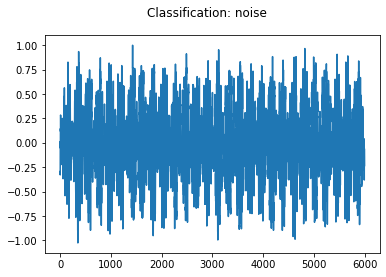

for 1:0
0
2018-10-17T10:44:04.472483Z


<Figure size 432x288 with 0 Axes>

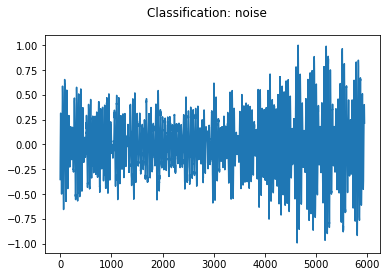

for 2:0
0
2018-10-17T10:44:17.199796Z


<Figure size 432x288 with 0 Axes>

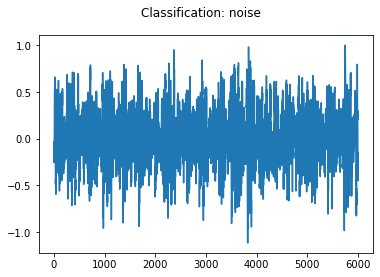

for 3:0
0
2018-10-17T10:46:20.051227Z


<Figure size 432x288 with 0 Axes>

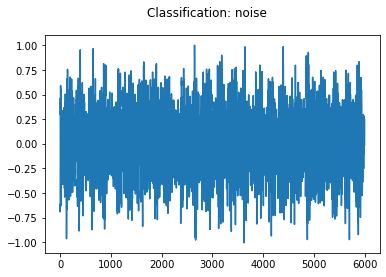

for 4:0
0
2018-10-17T10:46:58.983957Z


<Figure size 432x288 with 0 Axes>

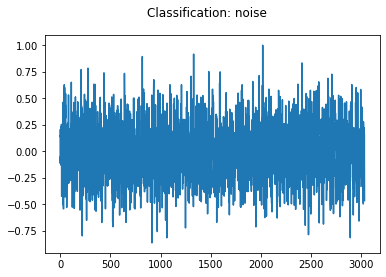

for 5:0
0
2018-10-17T10:48:47.566153Z


<Figure size 432x288 with 0 Axes>

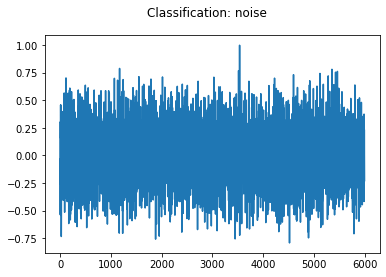

for 6:0
0
2018-10-17T10:54:19.768852Z


<Figure size 432x288 with 0 Axes>

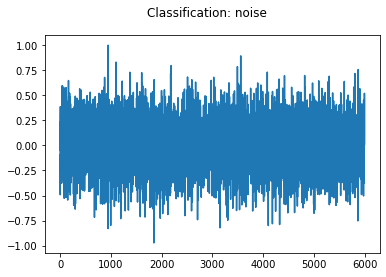

for 7:0
1
2018-10-23T14:22:10.717697Z


<Figure size 432x288 with 0 Axes>

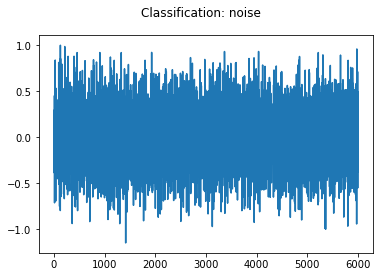

for 8:0
0
2018-10-23T14:27:14.027296Z


<Figure size 432x288 with 0 Axes>

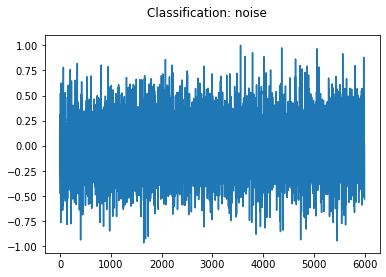

for 9:1
1
2018-10-23T14:30:55.205669Z


<Figure size 432x288 with 0 Axes>

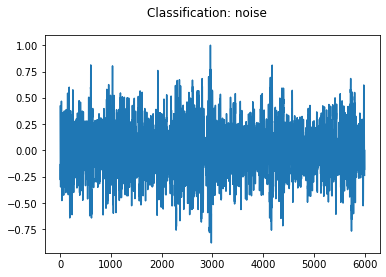

for 10:0
0
2018-10-23T14:35:41.846102Z


<Figure size 432x288 with 0 Axes>

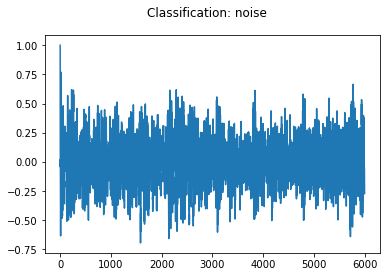

for 11:0
0
2018-10-23T14:36:13.695023Z


<Figure size 432x288 with 0 Axes>

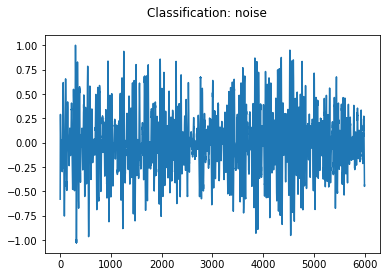

for 12:0
0
2018-10-23T14:36:48.565293Z


<Figure size 432x288 with 0 Axes>

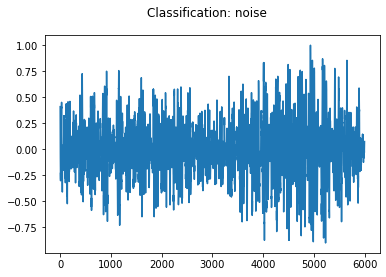

for 13:0
0
2018-10-23T14:37:27.176876Z


<Figure size 432x288 with 0 Axes>

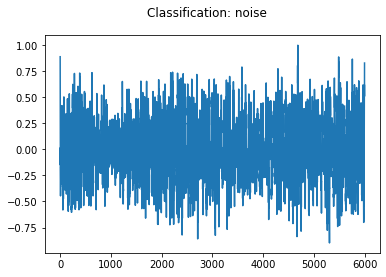

for 14:0
0
2018-10-23T14:38:04.956302Z


<Figure size 432x288 with 0 Axes>

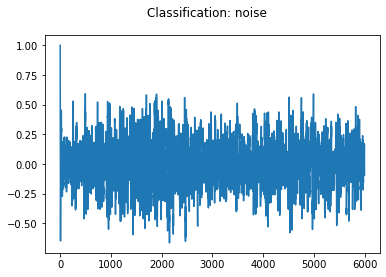

for 15:0
0
2018-10-23T14:39:11.987327Z


<Figure size 432x288 with 0 Axes>

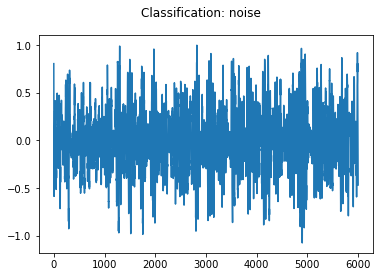

for 16:0
0
2018-10-23T14:39:18.568372Z


<Figure size 432x288 with 0 Axes>

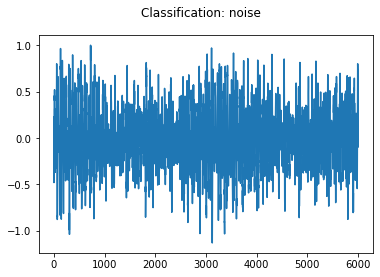

for 17:0
0
2018-10-23T14:40:32.303000Z


<Figure size 432x288 with 0 Axes>

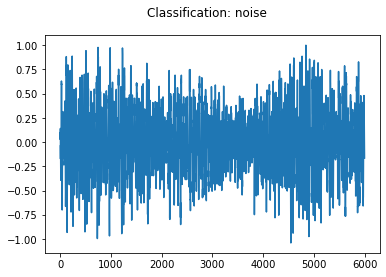

for 18:1
1
2018-10-23T14:41:39.037625Z


<Figure size 432x288 with 0 Axes>

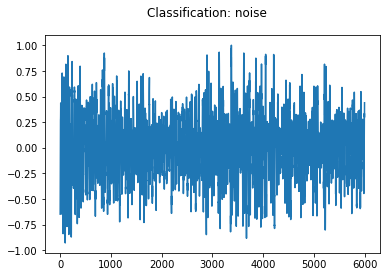

for 19:0
0
2018-10-23T14:41:48.264001Z


<Figure size 432x288 with 0 Axes>

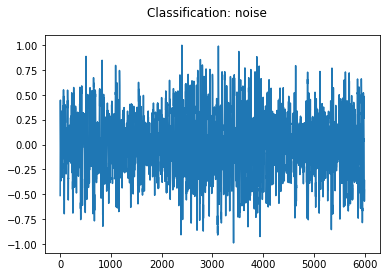

for 20:1
2
2018-10-23T14:41:51.280754Z


<Figure size 432x288 with 0 Axes>

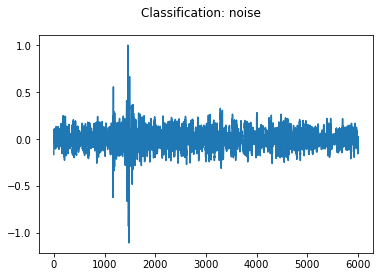

for 21:0
0
2018-10-23T14:44:23.224501Z


<Figure size 432x288 with 0 Axes>

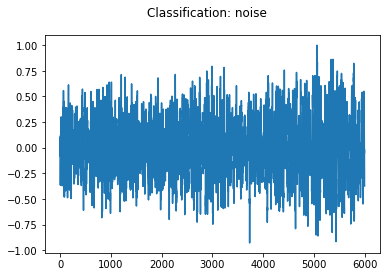

for 22:0
0
2018-10-23T14:44:27.344719Z


<Figure size 432x288 with 0 Axes>

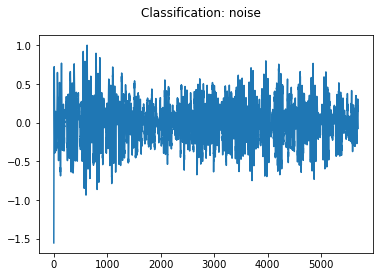

for 23:0
0
2018-10-23T14:44:32.631000Z


<Figure size 432x288 with 0 Axes>

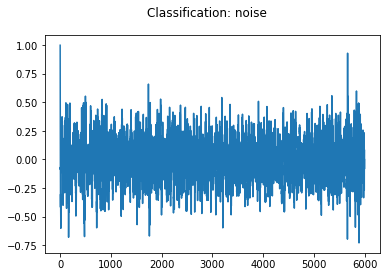

for 24:0
0
2018-10-23T14:44:35.440141Z


<Figure size 432x288 with 0 Axes>

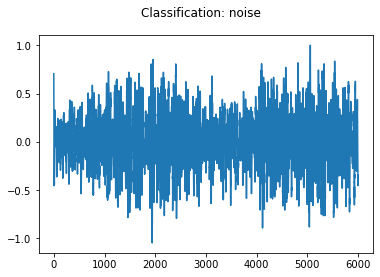

for 25:0
0
2018-10-23T14:44:42.436276Z


<Figure size 432x288 with 0 Axes>

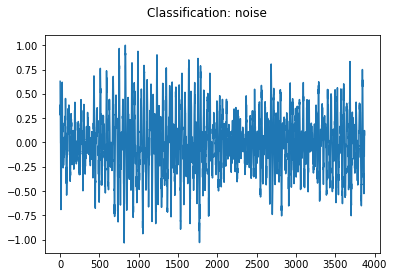

for 26:0
0
2018-10-23T14:34:57.867670Z


<Figure size 432x288 with 0 Axes>

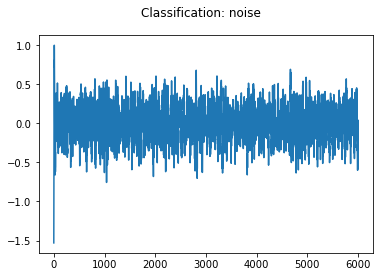

for 27:0
0
2018-10-23T14:45:30.691670Z


<Figure size 432x288 with 0 Axes>

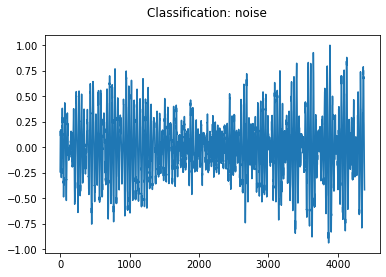

for 28:1
1
2018-10-23T14:45:38.166110Z


<Figure size 432x288 with 0 Axes>

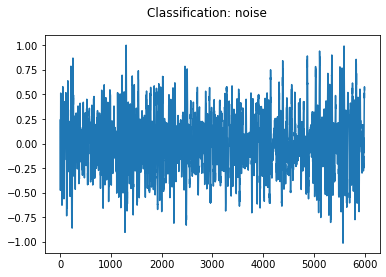

for 29:1
2
2018-10-23T14:45:42.057500Z


<Figure size 432x288 with 0 Axes>

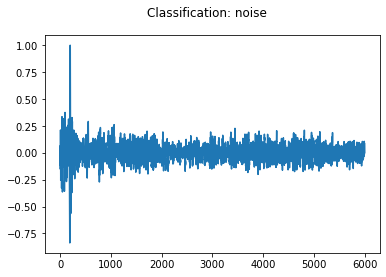

for 30:0
0
2018-10-23T14:41:59.429500Z


<Figure size 432x288 with 0 Axes>

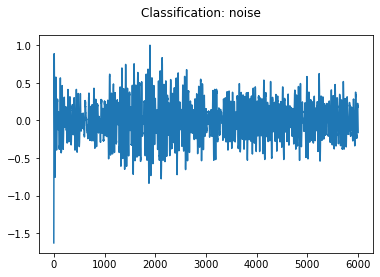

for 31:1
1
2018-10-23T14:48:44.251333Z


<Figure size 432x288 with 0 Axes>

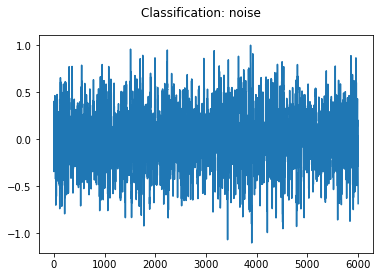

for 32:0
0
2018-10-23T14:48:58.505501Z


<Figure size 432x288 with 0 Axes>

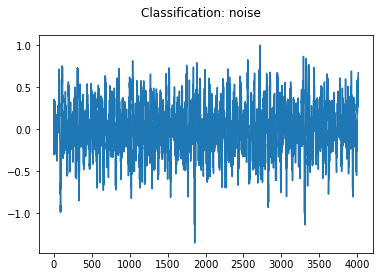

for 33:1
2
2018-10-23T14:49:46.866822Z


<Figure size 432x288 with 0 Axes>

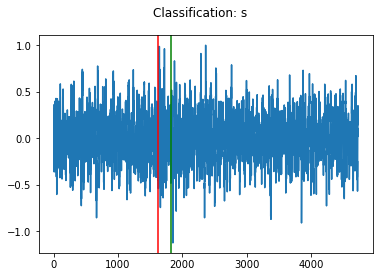

for 34:1
2
2018-10-23T14:51:49.680492Z


<Figure size 432x288 with 0 Axes>

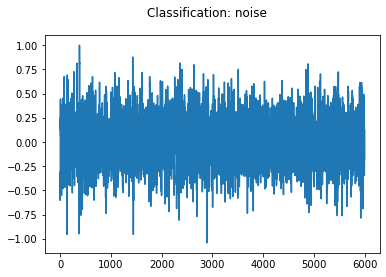

for 35:1
1
2018-10-23T14:52:00.384999Z


<Figure size 432x288 with 0 Axes>

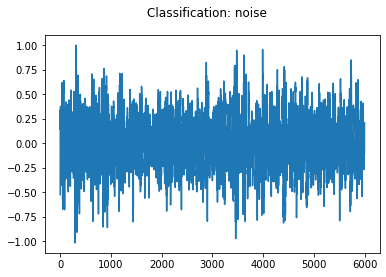

for 36:0
0
2018-10-23T14:52:34.182500Z


<Figure size 432x288 with 0 Axes>

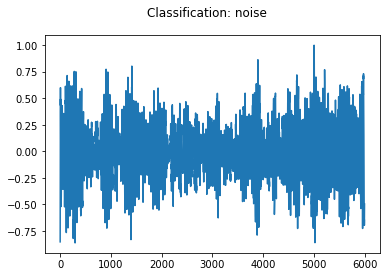

for 37:2
3
2018-10-23T14:53:35.571001Z


<Figure size 432x288 with 0 Axes>

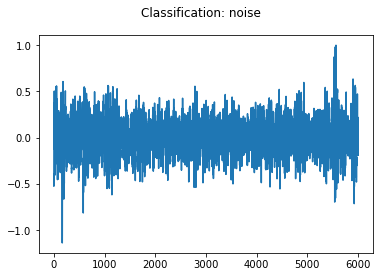

for 38:2
3
2018-10-23T14:53:32.181478Z


<Figure size 432x288 with 0 Axes>

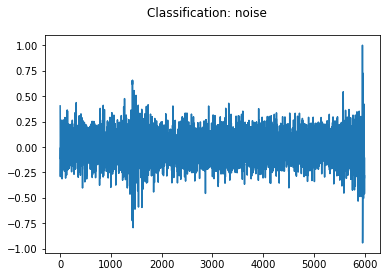

for 39:0
0
2018-10-23T14:54:23.041013Z


<Figure size 432x288 with 0 Axes>

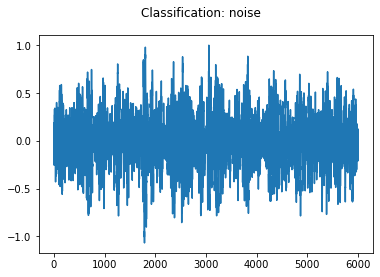

for 40:2
3
2018-10-23T14:55:55.916572Z


<Figure size 432x288 with 0 Axes>

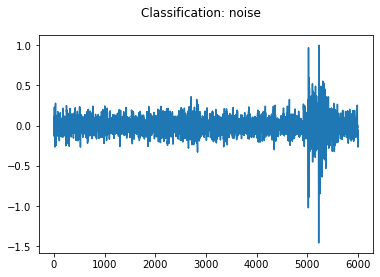

for 41:0
0
2018-10-23T14:56:25.526500Z


<Figure size 432x288 with 0 Axes>

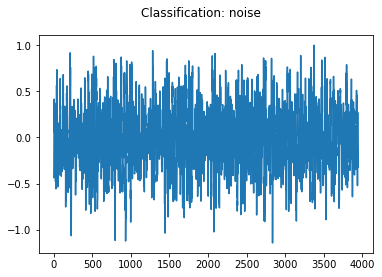

for 42:1
2
2018-10-23T14:57:02.238996Z


<Figure size 432x288 with 0 Axes>

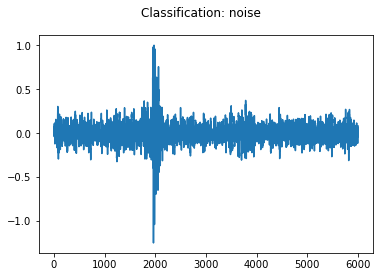

for 43:2
3
2018-10-23T14:57:31.732999Z


<Figure size 432x288 with 0 Axes>

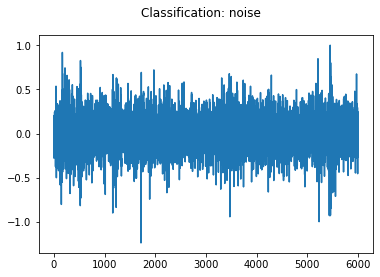

for 44:1
2
2018-10-23T14:57:41.961501Z


<Figure size 432x288 with 0 Axes>

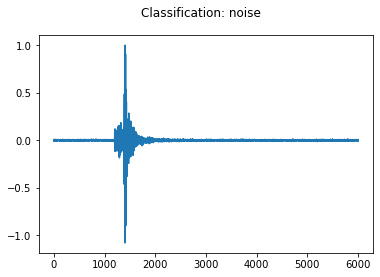

for 45:0
0
2018-10-23T14:57:47.420499Z


<Figure size 432x288 with 0 Axes>

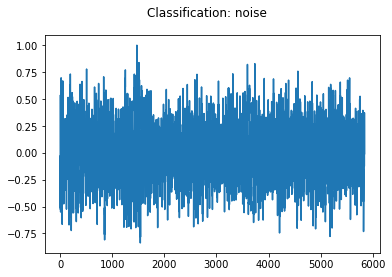

for 46:2
4
2018-10-23T14:58:00.046001Z


<Figure size 432x288 with 0 Axes>

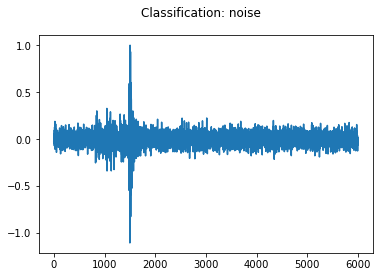

for 47:1
2
2018-10-23T14:58:06.818501Z


<Figure size 432x288 with 0 Axes>

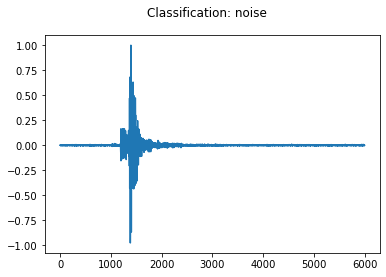

for 48:0
0
2018-10-23T14:58:37.114893Z


<Figure size 432x288 with 0 Axes>

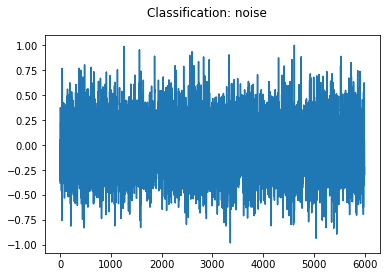

for 49:1
2
2018-10-23T14:58:46.647501Z


<Figure size 432x288 with 0 Axes>

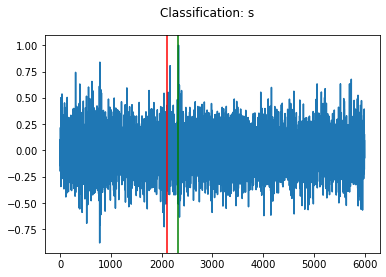

for 50:1
3
2018-10-23T14:58:59.740000Z


<Figure size 432x288 with 0 Axes>

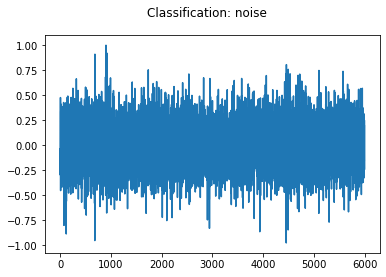

for 51:2
3
2018-10-23T14:59:14.711999Z


<Figure size 432x288 with 0 Axes>

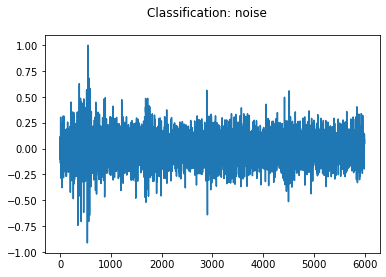

for 52:2
4
2018-10-23T14:59:16.205999Z


<Figure size 432x288 with 0 Axes>

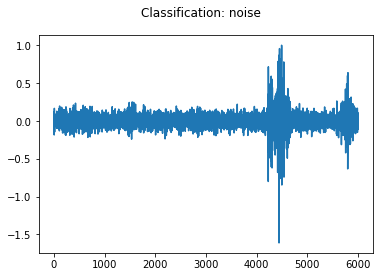

for 53:0
0
2018-10-23T14:59:22.648624Z


<Figure size 432x288 with 0 Axes>

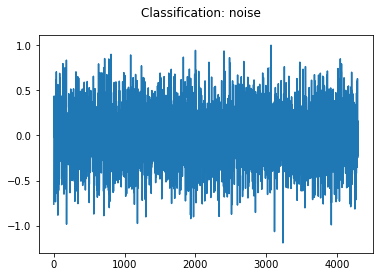

for 54:0
1
2018-10-23T14:59:26.986514Z


<Figure size 432x288 with 0 Axes>

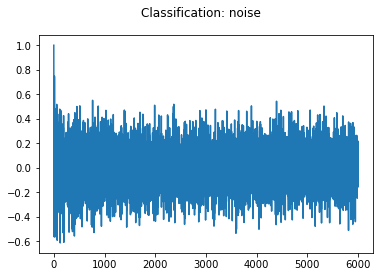

for 55:0
0
2018-10-23T14:59:35.694000Z


<Figure size 432x288 with 0 Axes>

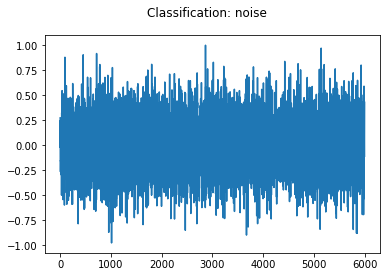

for 56:0
0
2018-10-23T14:59:36.325500Z


<Figure size 432x288 with 0 Axes>

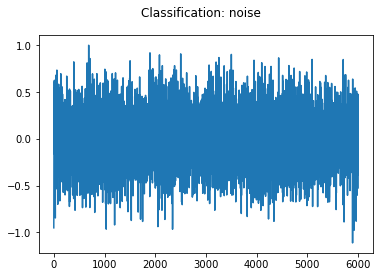

for 57:0
0
2018-10-29T09:07:42.543459Z


<Figure size 432x288 with 0 Axes>

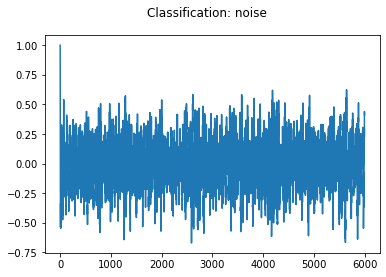

for 58:0
0
2018-10-29T09:11:08.154020Z


<Figure size 432x288 with 0 Axes>

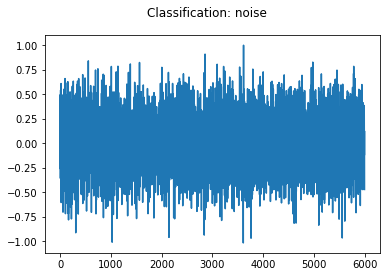

for 59:0
0
2018-10-29T09:11:26.426414Z


<Figure size 432x288 with 0 Axes>

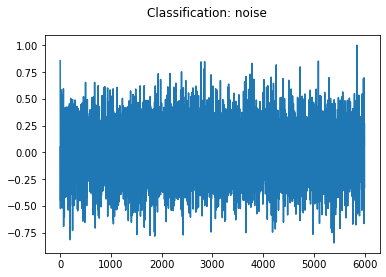

for 60:0
0
2018-10-29T09:13:14.237352Z


<Figure size 432x288 with 0 Axes>

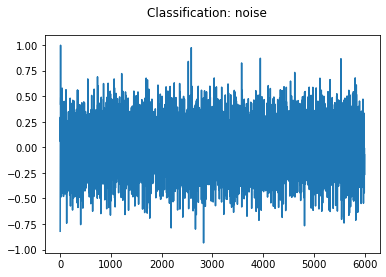

for 61:0
0
2018-10-29T09:13:25.269081Z


<Figure size 432x288 with 0 Axes>

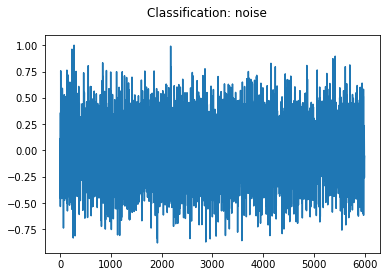

for 62:0
0
2018-10-29T09:17:57.515387Z


<Figure size 432x288 with 0 Axes>

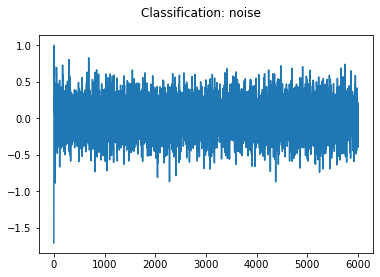

for 63:0
0
2018-10-29T09:24:13.784174Z


<Figure size 432x288 with 0 Axes>

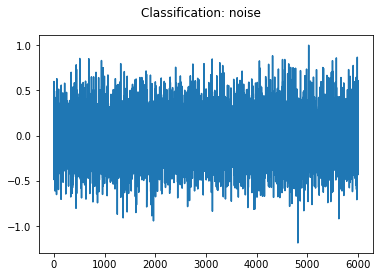

for 64:0
0
2018-10-29T09:26:03.826933Z


<Figure size 432x288 with 0 Axes>

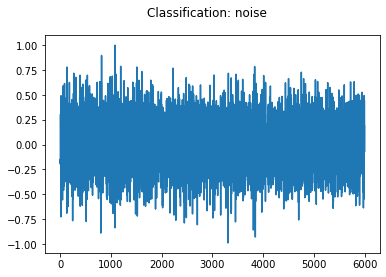

for 65:0
0
2018-10-29T09:29:49.316275Z


<Figure size 432x288 with 0 Axes>

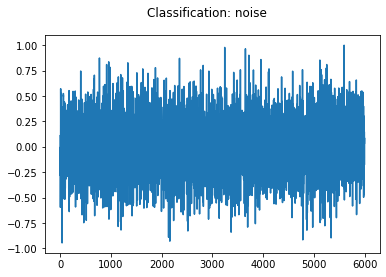

for 66:0
0
2018-10-29T09:30:18.400192Z


<Figure size 432x288 with 0 Axes>

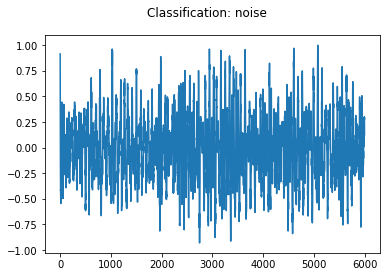

for 67:0
0
2018-10-29T09:31:16.304956Z


<Figure size 432x288 with 0 Axes>

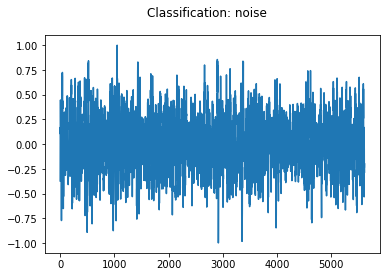

for 68:0
0
2018-10-29T09:31:38.836847Z


<Figure size 432x288 with 0 Axes>

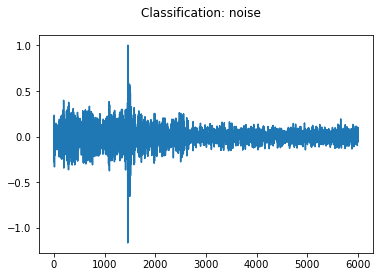

for 69:0
0
2018-10-29T09:31:45.983910Z


<Figure size 432x288 with 0 Axes>

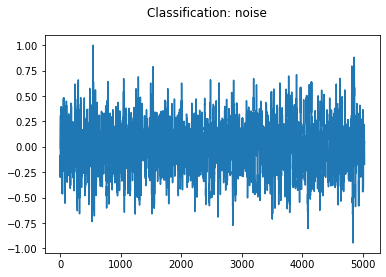

for 70:1
2
2018-10-29T09:31:51.377337Z


<Figure size 432x288 with 0 Axes>

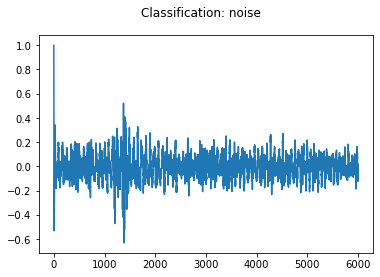

for 71:0
0
2018-10-29T09:31:56.829528Z


<Figure size 432x288 with 0 Axes>

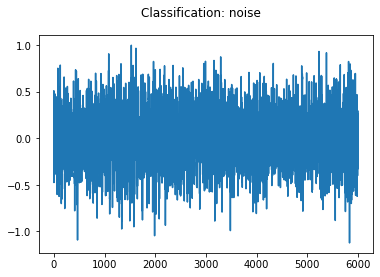

for 72:0
0
2018-10-29T09:32:37.878250Z


<Figure size 432x288 with 0 Axes>

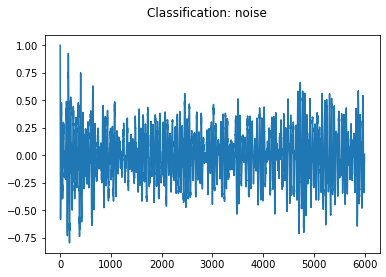

for 73:0
0
2018-10-29T09:50:47.413060Z


<Figure size 432x288 with 0 Axes>

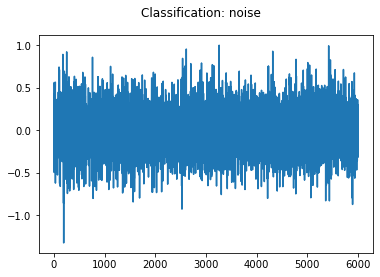

for 74:0
0
2018-10-29T09:53:26.741347Z


<Figure size 432x288 with 0 Axes>

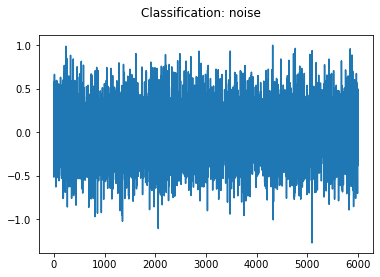

for 75:1
1
2018-10-29T09:57:32.718267Z


<Figure size 432x288 with 0 Axes>

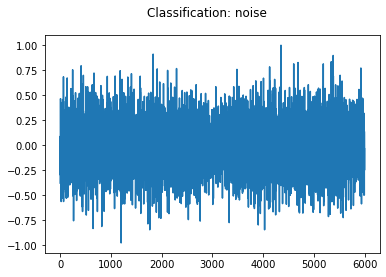

for 76:0
0
2018-10-29T09:58:51.163098Z


<Figure size 432x288 with 0 Axes>

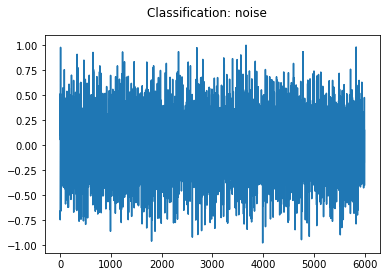

for 77:0
0
2018-10-29T09:59:23.815310Z


<Figure size 432x288 with 0 Axes>

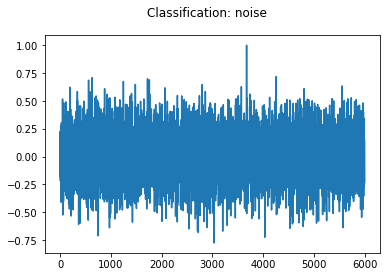

for 78:0
0
2018-10-29T09:59:29.322156Z


<Figure size 432x288 with 0 Axes>

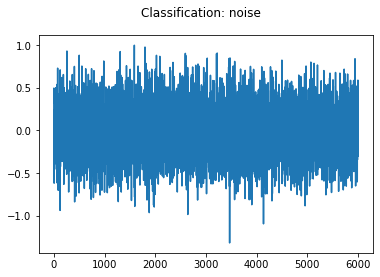

for 79:0
0
2018-12-11T09:19:09.230001Z


<Figure size 432x288 with 0 Axes>

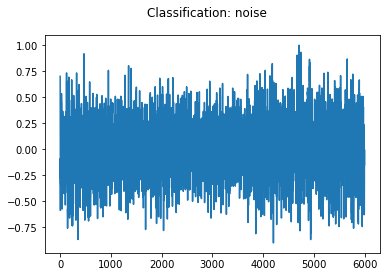

for 80:1
2
2018-12-11T09:22:26.017658Z


<Figure size 432x288 with 0 Axes>

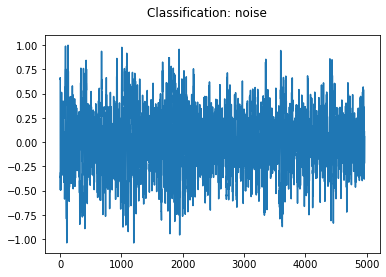

for 81:2
4
2018-12-11T09:24:06.815001Z


<Figure size 432x288 with 0 Axes>

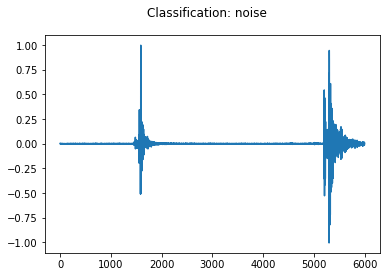

for 82:1
2
2018-12-11T09:25:53.910501Z


<Figure size 432x288 with 0 Axes>

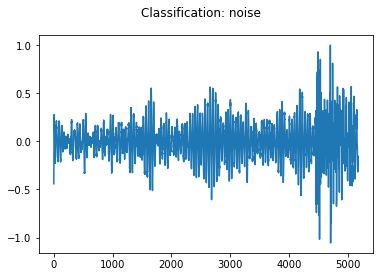

for 83:2
3
2018-12-11T09:27:05.631999Z


<Figure size 432x288 with 0 Axes>

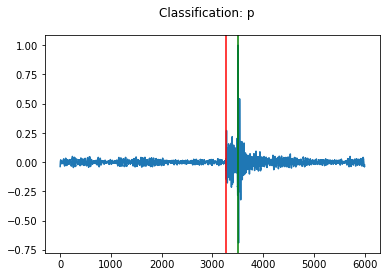

for 84:1
1
2018-12-11T09:27:24.309002Z


<Figure size 432x288 with 0 Axes>

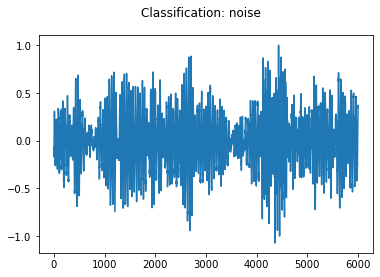

for 85:2
4
2018-12-11T09:28:26.621000Z


<Figure size 432x288 with 0 Axes>

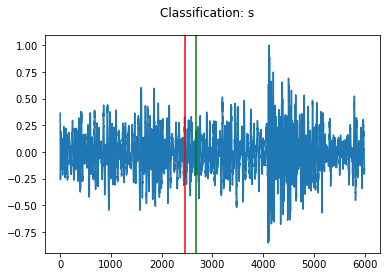

for 86:2
4
2018-12-11T09:32:59.832002Z


<Figure size 432x288 with 0 Axes>

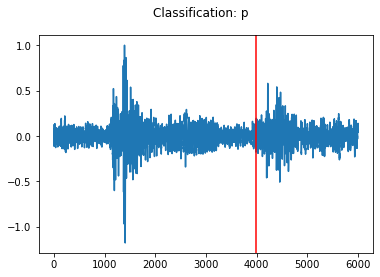

for 87:1
3
2018-12-11T09:33:39.099497Z


<Figure size 432x288 with 0 Axes>

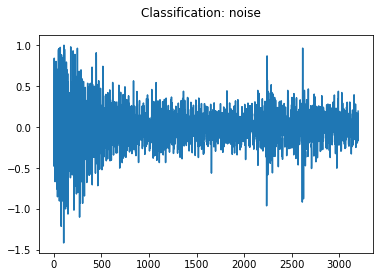

for 88:2
4
2018-12-11T09:37:46.832116Z


<Figure size 432x288 with 0 Axes>

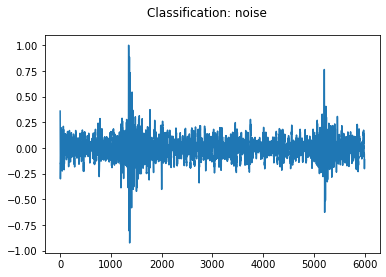

for 89:1
2
2018-12-11T09:41:20.745110Z


<Figure size 432x288 with 0 Axes>

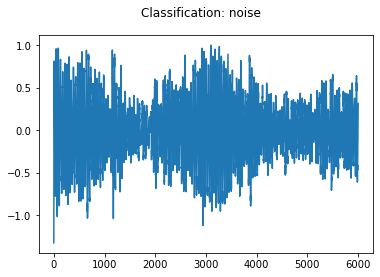

for 90:1
1
2018-12-11T09:42:18.640003Z


<Figure size 432x288 with 0 Axes>

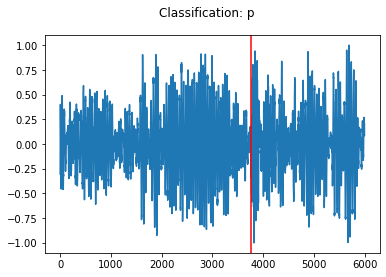

for 91:2
3
2018-12-11T09:43:36.406276Z


<Figure size 432x288 with 0 Axes>

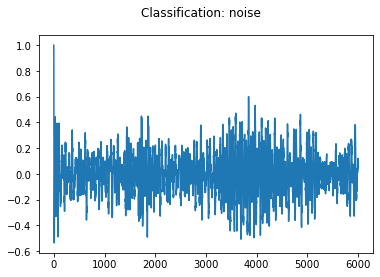

for 92:2
4
2018-12-11T09:50:30.746501Z


<Figure size 432x288 with 0 Axes>

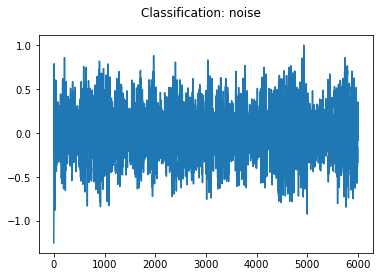

for 93:2
4
2018-12-11T09:50:50.995503Z


<Figure size 432x288 with 0 Axes>

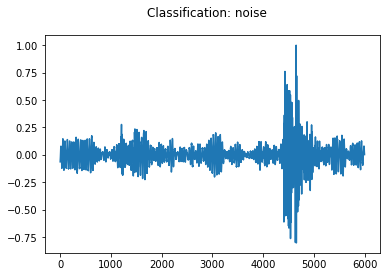

for 94:3
6
2018-12-11T09:52:36.546497Z


<Figure size 432x288 with 0 Axes>

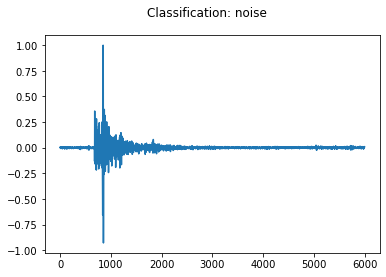

for 95:3
6
2018-12-11T09:53:42.695501Z


<Figure size 432x288 with 0 Axes>

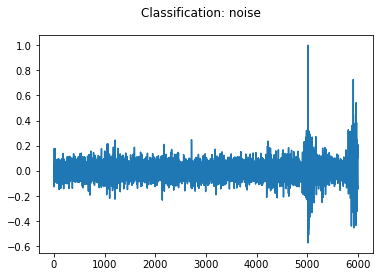

for 96:3
7
2018-12-11T09:55:20.010502Z


<Figure size 432x288 with 0 Axes>

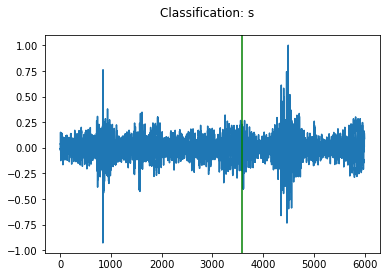

for 97:2
4
2018-12-11T09:55:56.104001Z


<Figure size 432x288 with 0 Axes>

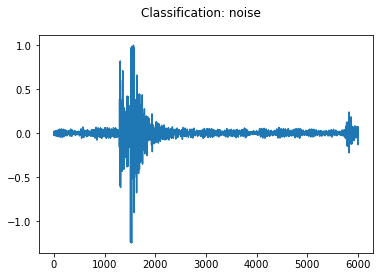

for 98:3
6
2018-12-11T09:55:44.867947Z


<Figure size 432x288 with 0 Axes>

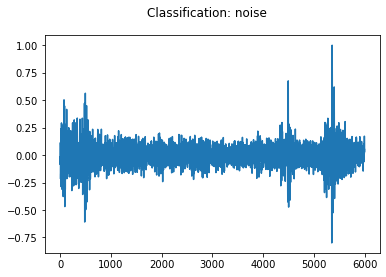

for 99:2
4
2018-12-11T09:57:07.696001Z


<Figure size 432x288 with 0 Axes>

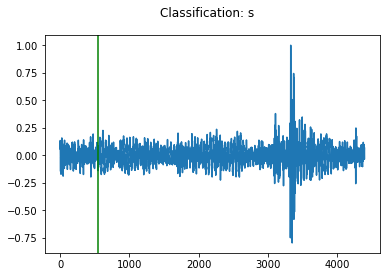

for 100:0
0
2018-12-11T11:21:13.689824Z


<Figure size 432x288 with 0 Axes>

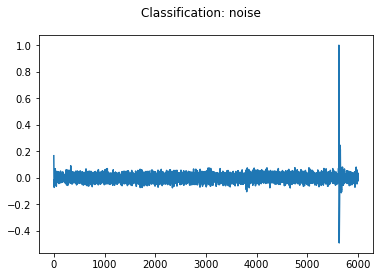

for 101:3
4
2018-10-29T11:30:37.354076Z


<Figure size 432x288 with 0 Axes>

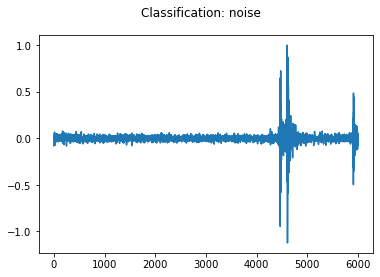

for 102:0
0
2018-10-29T18:01:09.570937Z


<Figure size 432x288 with 0 Axes>

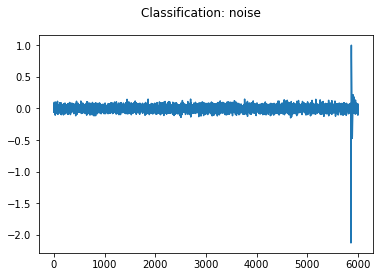

for 103:1
2
2018-10-26T11:35:43.957398Z


<Figure size 432x288 with 0 Axes>

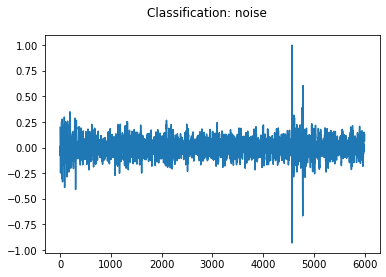

for 104:1
2
2018-10-27T10:55:23.728788Z


<Figure size 432x288 with 0 Axes>

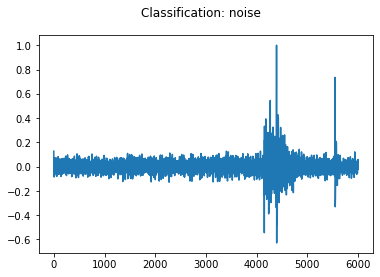

for 105:0
0
2018-11-04T16:24:04.536114Z


<Figure size 432x288 with 0 Axes>

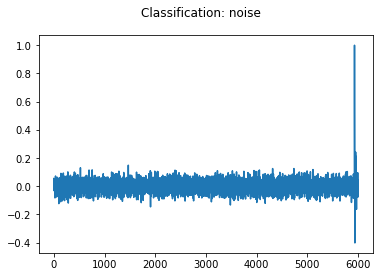

for 106:0
0
2018-10-24T13:02:27.536215Z


<Figure size 432x288 with 0 Axes>

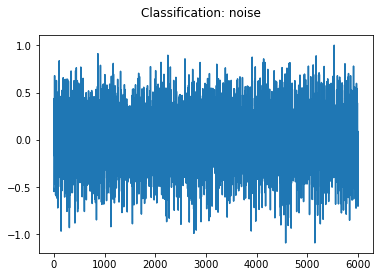

for 107:1
2
2018-10-25T14:59:24.550128Z


<Figure size 432x288 with 0 Axes>

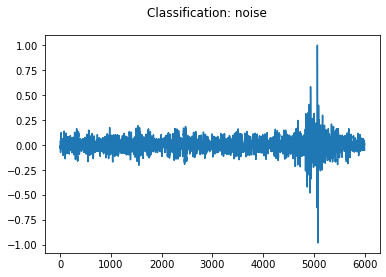

for 108:0
0
2018-10-23T14:45:30.611670Z


<Figure size 432x288 with 0 Axes>

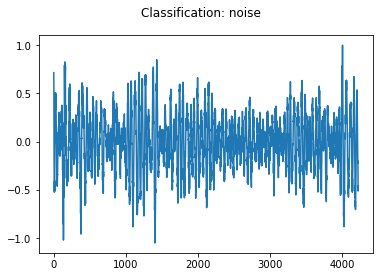

for 109:2
4
2018-12-14T13:41:02.977303Z


<Figure size 432x288 with 0 Axes>

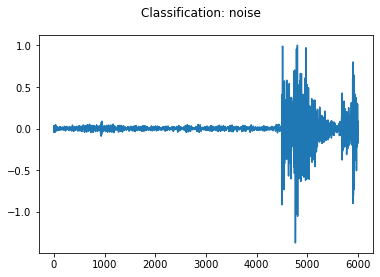

for 110:0
0
2018-10-25T17:00:32.253072Z


<Figure size 432x288 with 0 Axes>

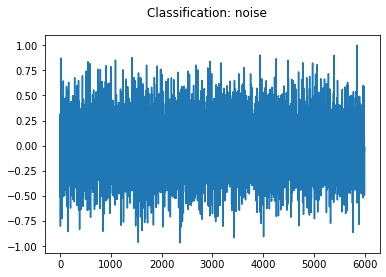

for 111:3
6
2018-10-26T11:26:05.025376Z


<Figure size 432x288 with 0 Axes>

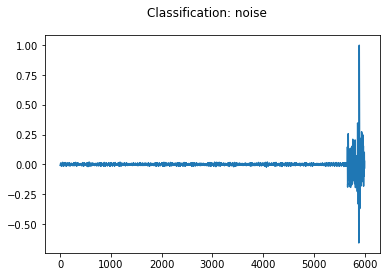

for 112:0
0
2018-12-11T09:53:29.423274Z


<Figure size 432x288 with 0 Axes>

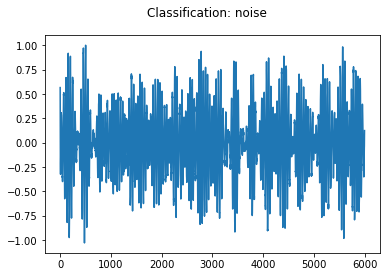

for 113:1
2
2018-10-29T11:58:32.907222Z


<Figure size 432x288 with 0 Axes>

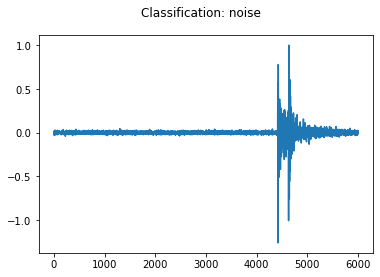

for 114:0
0
2018-12-11T10:06:42.920583Z


<Figure size 432x288 with 0 Axes>

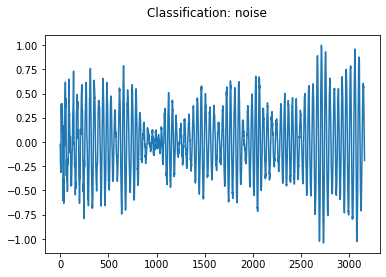

for 115:1
1
2018-12-14T13:09:49.783000Z


<Figure size 432x288 with 0 Axes>

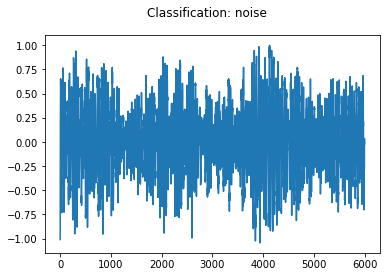

for 116:2
2
2018-12-11T09:34:59.473777Z


<Figure size 432x288 with 0 Axes>

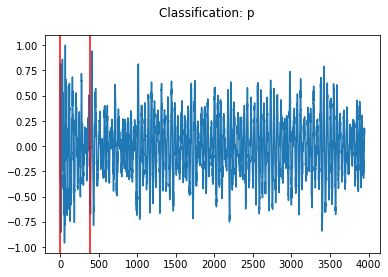

for 117:0
0
2018-10-26T20:39:21.134610Z


<Figure size 432x288 with 0 Axes>

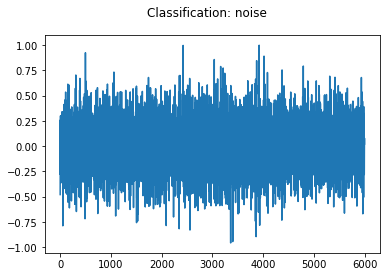

for 118:0
0
2018-10-24T13:26:24.708736Z


<Figure size 432x288 with 0 Axes>

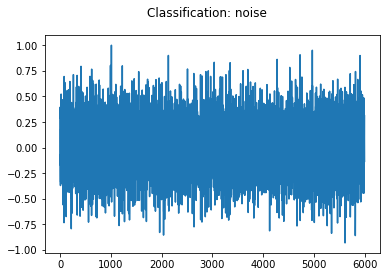

for 119:0
0
2018-12-14T14:51:54.948504Z


<Figure size 432x288 with 0 Axes>

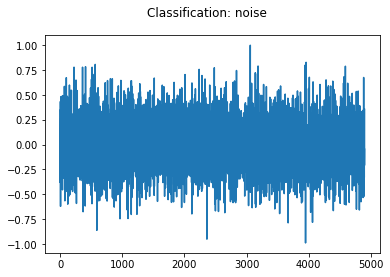

for 120:0
0
2018-12-13T13:25:15.097558Z


<Figure size 432x288 with 0 Axes>

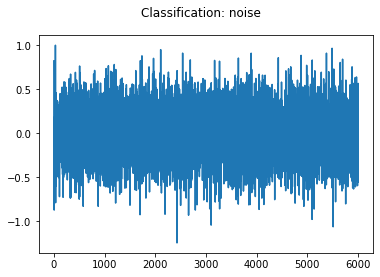

for 121:0
2
2018-12-08T12:27:42.381485Z


<Figure size 432x288 with 0 Axes>

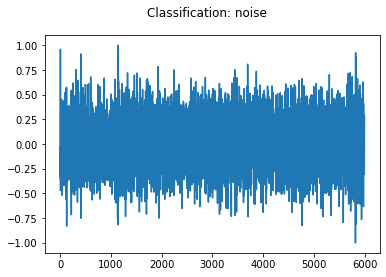

for 122:1
2
2018-10-25T15:06:02.902139Z


<Figure size 432x288 with 0 Axes>

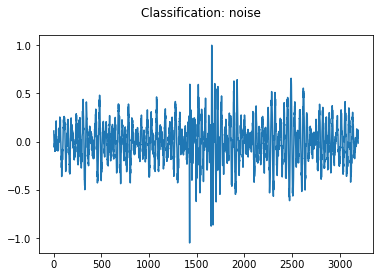

for 123:0
0
2018-10-24T23:56:11.226137Z


<Figure size 432x288 with 0 Axes>

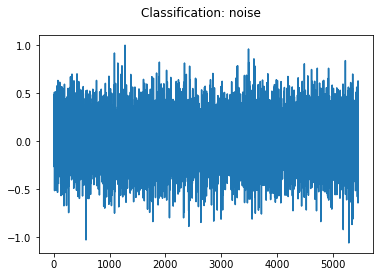

for 124:1
2
2018-10-25T12:40:57.846937Z


<Figure size 432x288 with 0 Axes>

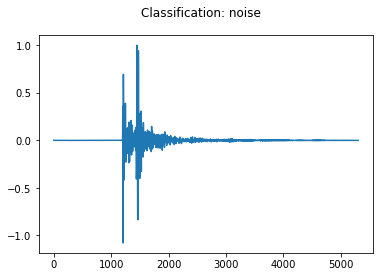

for 125:0
0
2018-10-18T15:48:51.743427Z


<Figure size 432x288 with 0 Axes>

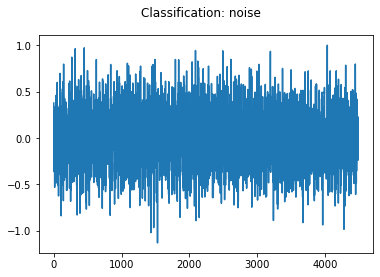

for 126:2
4
2018-12-11T10:34:33.615646Z


<Figure size 432x288 with 0 Axes>

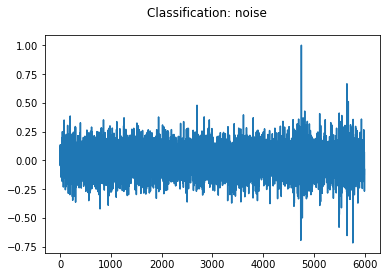

for 127:0
0
2018-10-29T21:13:56.987642Z


<Figure size 432x288 with 0 Axes>

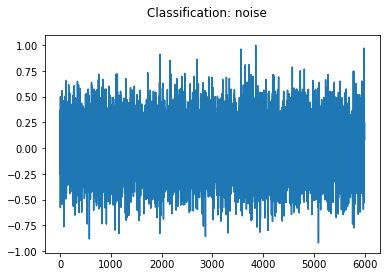

for 128:0
0
2018-10-30T01:37:35.840873Z


<Figure size 432x288 with 0 Axes>

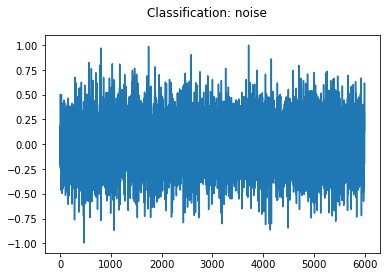

for 129:0
0
2018-10-27T11:44:29.501597Z


<Figure size 432x288 with 0 Axes>

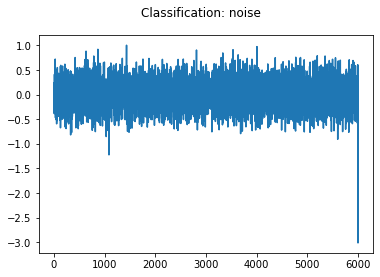

for 130:3
3
2018-12-11T10:18:44.921932Z


<Figure size 432x288 with 0 Axes>

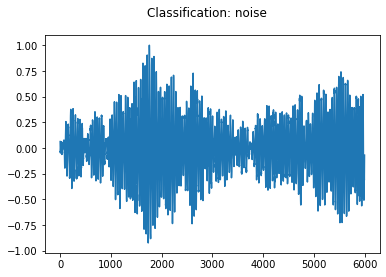

for 131:0
0
2018-10-20T03:43:59.574986Z


<Figure size 432x288 with 0 Axes>

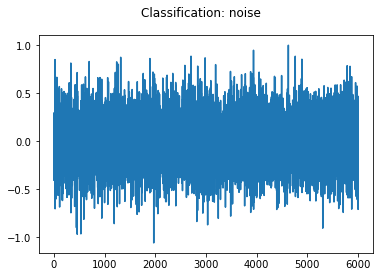

for 132:1
2
2018-10-29T11:44:40.201886Z


<Figure size 432x288 with 0 Axes>

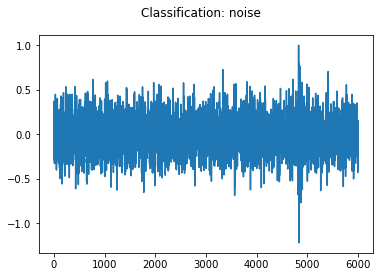

for 133:0
0
2018-10-19T13:20:46.841106Z


<Figure size 432x288 with 0 Axes>

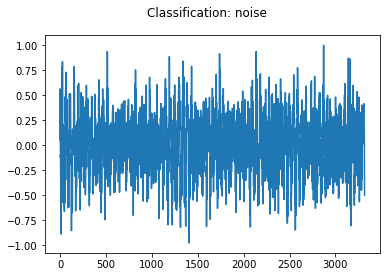

for 134:0
0
2018-10-25T14:56:26.483150Z


<Figure size 432x288 with 0 Axes>

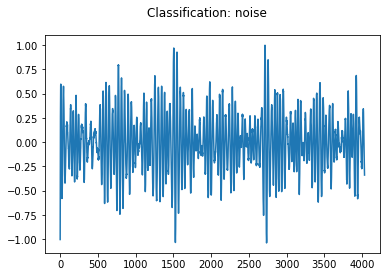

for 135:0
0
2018-10-26T02:12:59.995291Z


<Figure size 432x288 with 0 Axes>

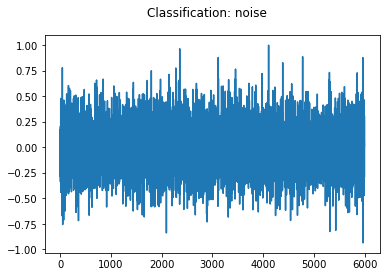

for 136:0
0
2018-12-10T10:30:56.174963Z


<Figure size 432x288 with 0 Axes>

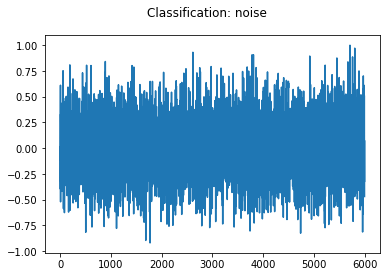

for 137:2
3
2018-12-11T10:20:25.858469Z


<Figure size 432x288 with 0 Axes>

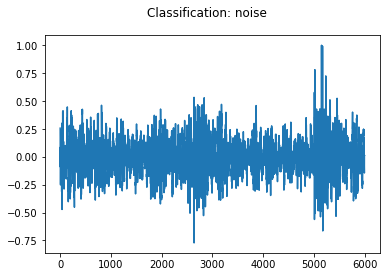

for 138:0
0
2018-10-27T11:07:14.001670Z


<Figure size 432x288 with 0 Axes>

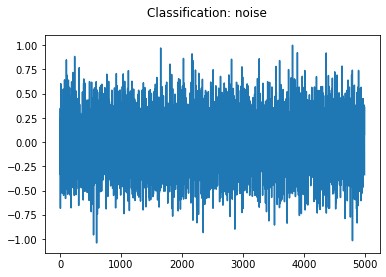

for 139:2
3
2018-12-14T13:06:38.173000Z


<Figure size 432x288 with 0 Axes>

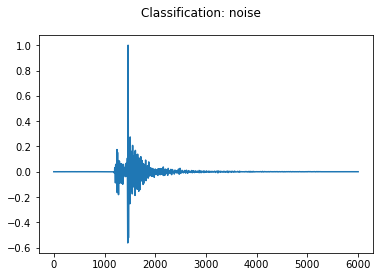

for 140:0
0
2018-10-26T14:14:02.064392Z


<Figure size 432x288 with 0 Axes>

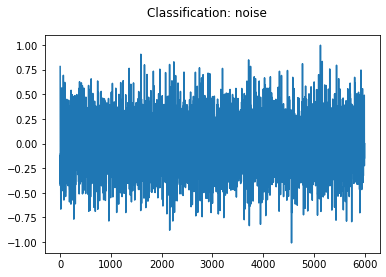

for 141:0
0
2018-10-26T11:17:00.133776Z


<Figure size 432x288 with 0 Axes>

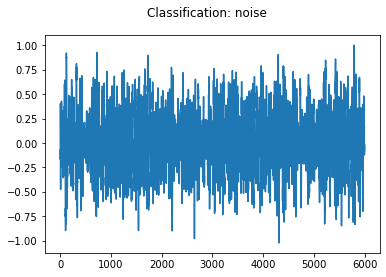

for 142:2
4
2018-12-14T13:18:28.591496Z


<Figure size 432x288 with 0 Axes>

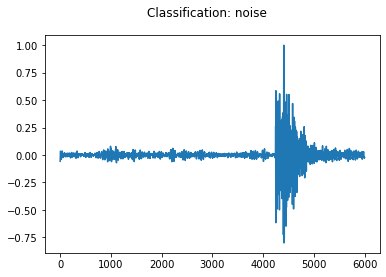

for 143:1
2
2018-12-11T09:34:04.615759Z


<Figure size 432x288 with 0 Axes>

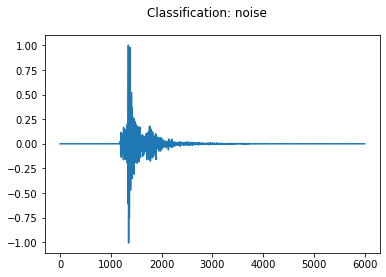

for 144:0
0
2018-10-25T17:04:11.657001Z


<Figure size 432x288 with 0 Axes>

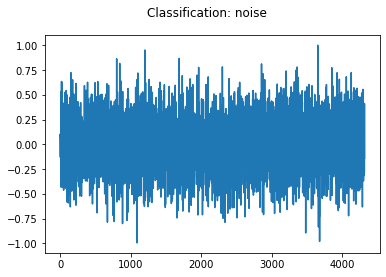

for 145:1
3
2018-10-24T13:18:58.879000Z


<Figure size 432x288 with 0 Axes>

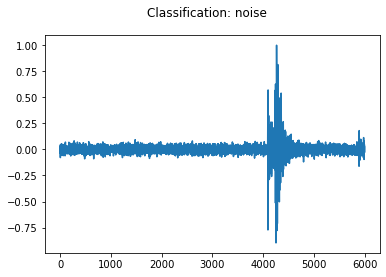

for 146:2
4
2018-10-29T11:42:49.719477Z


<Figure size 432x288 with 0 Axes>

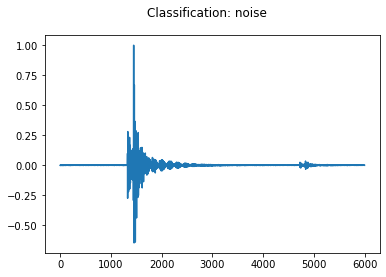

for 147:3
6
2018-10-25T15:23:48.987999Z


<Figure size 432x288 with 0 Axes>

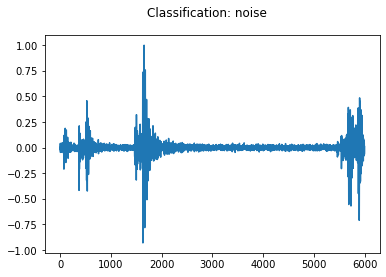

for 148:3
6
2018-10-24T12:57:12.116501Z


<Figure size 432x288 with 0 Axes>

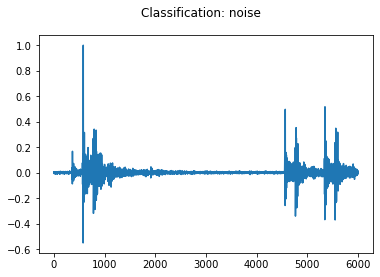

for 149:0
1
2018-10-25T15:22:57.260499Z


<Figure size 432x288 with 0 Axes>

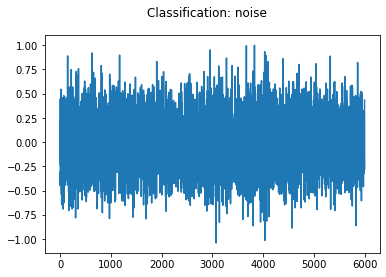

for 150:0
0
2018-12-15T09:40:05.380999Z


<Figure size 432x288 with 0 Axes>

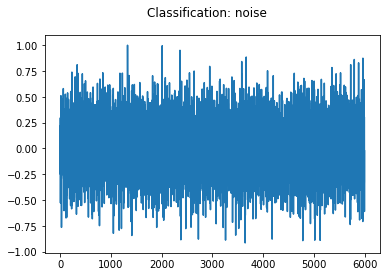

for 151:0
0
2018-12-14T19:22:43.298000Z


<Figure size 432x288 with 0 Axes>

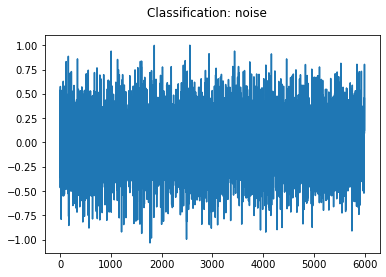

for 152:0
0
2018-12-15T05:14:03.533001Z


<Figure size 432x288 with 0 Axes>

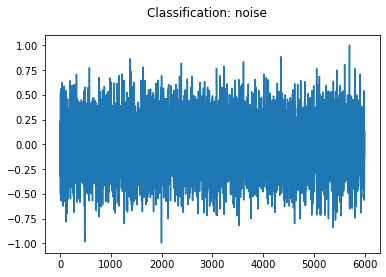

for 153:0
0
2018-12-14T20:17:13.597500Z


<Figure size 432x288 with 0 Axes>

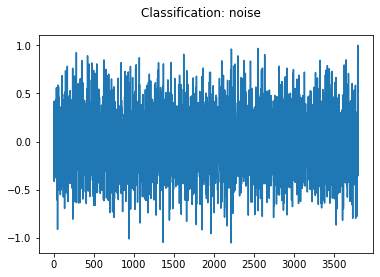

for 154:0
0
2018-12-18T02:37:04.920323Z


<Figure size 432x288 with 0 Axes>

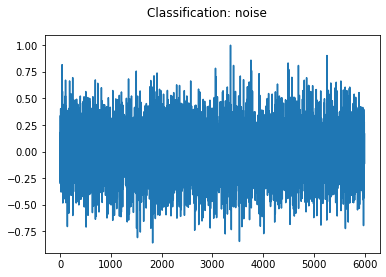

for 155:0
0
2018-12-18T08:08:31.404378Z


<Figure size 432x288 with 0 Axes>

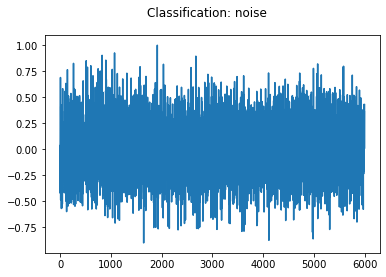

for 156:0
0
2018-12-14T19:05:17.706270Z


<Figure size 432x288 with 0 Axes>

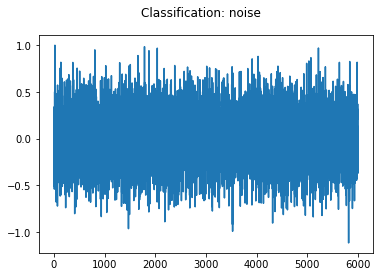

for 157:0
0
2018-12-17T17:53:13.415503Z


<Figure size 432x288 with 0 Axes>

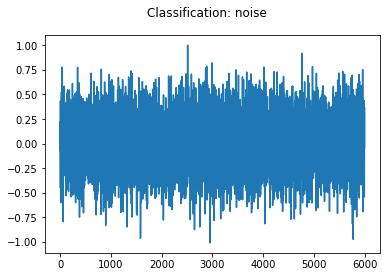

for 158:0
0
2018-12-18T08:09:09.558826Z


<Figure size 432x288 with 0 Axes>

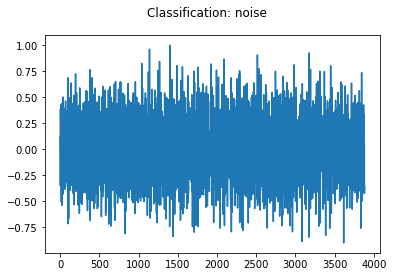

for 159:0
0
2018-12-18T00:16:29.176860Z


<Figure size 432x288 with 0 Axes>

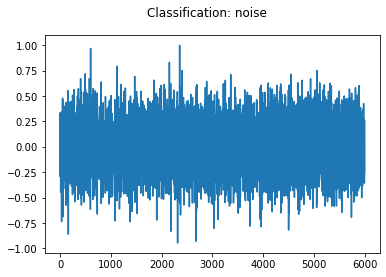

for 160:0
0
2018-12-15T04:24:15.802999Z


<Figure size 432x288 with 0 Axes>

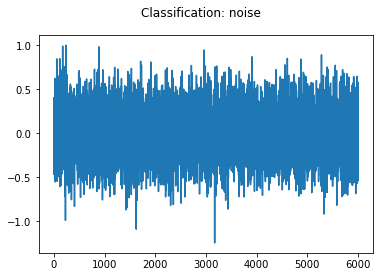

for 161:0
0
2018-12-17T18:23:05.929902Z


<Figure size 432x288 with 0 Axes>

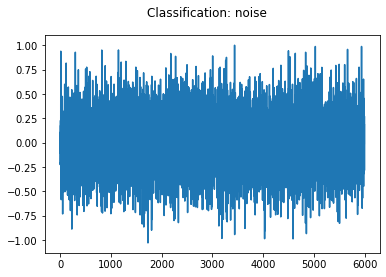

for 162:0
0
2018-12-17T17:35:38.960749Z


<Figure size 432x288 with 0 Axes>

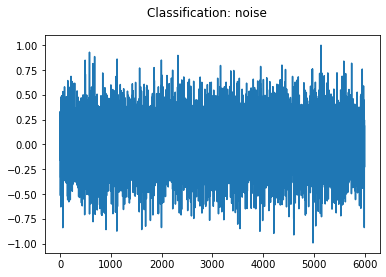

for 163:0
0
2018-12-14T15:44:58.467000Z


<Figure size 432x288 with 0 Axes>

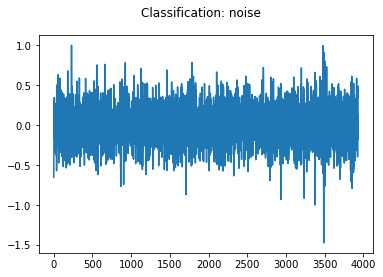

for 164:0
0
2018-12-17T19:39:33.612497Z


<Figure size 432x288 with 0 Axes>

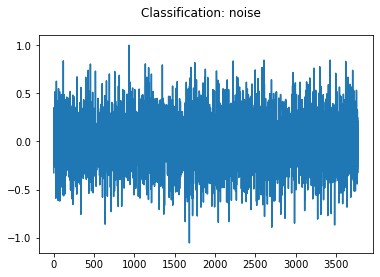

for 165:0
0
2018-12-18T00:20:41.060939Z


<Figure size 432x288 with 0 Axes>

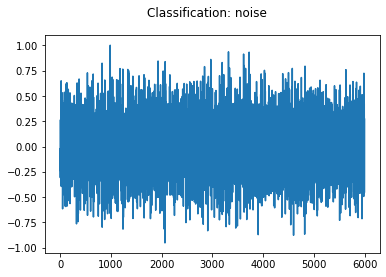

for 166:0
0
2018-12-18T00:39:01.095666Z


<Figure size 432x288 with 0 Axes>

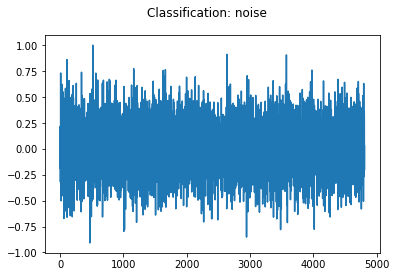

for 167:0
0
2018-12-15T03:05:15.485441Z


<Figure size 432x288 with 0 Axes>

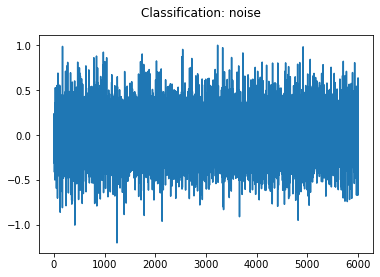

for 168:0
0
2018-12-18T03:38:53.633431Z


<Figure size 432x288 with 0 Axes>

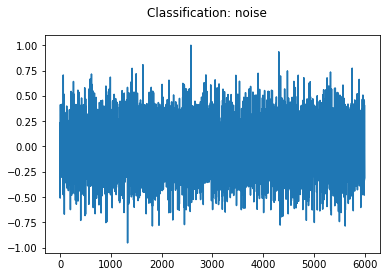

for 169:0
0
2018-12-18T04:16:01.604612Z


<Figure size 432x288 with 0 Axes>

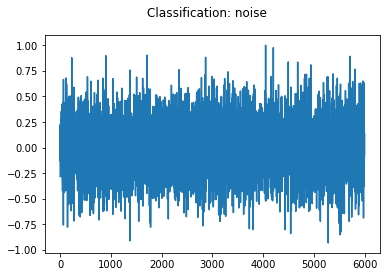

for 170:0
0
2018-12-18T03:49:21.433724Z


<Figure size 432x288 with 0 Axes>

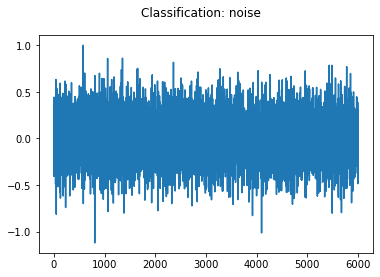

for 171:0
0
2018-12-14T20:53:05.808002Z


<Figure size 432x288 with 0 Axes>

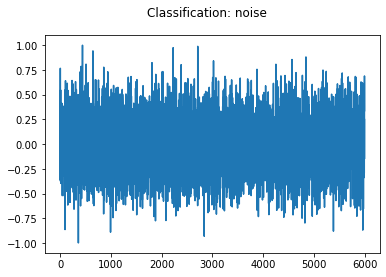

for 172:0
0
2018-12-17T16:25:29.783592Z


<Figure size 432x288 with 0 Axes>

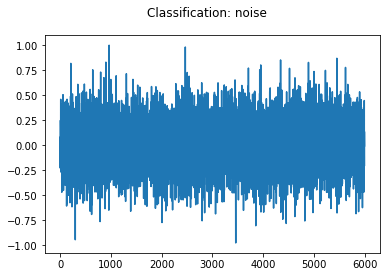

for 173:0
0
2018-12-14T14:59:44.866501Z


<Figure size 432x288 with 0 Axes>

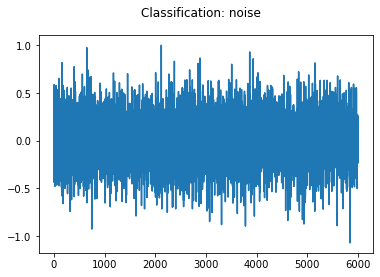

for 174:0
0
2018-12-17T22:22:53.176300Z


<Figure size 432x288 with 0 Axes>

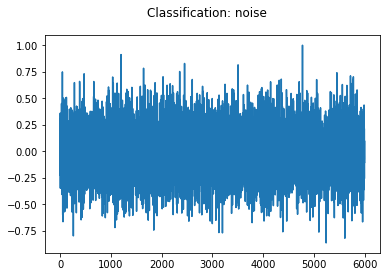

for 175:0
0
2018-12-17T23:33:55.632907Z


<Figure size 432x288 with 0 Axes>

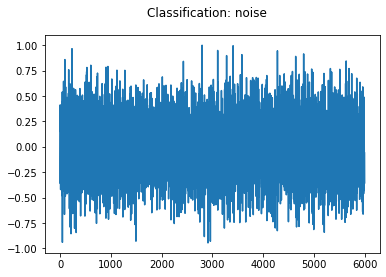

for 176:0
0
2018-12-18T01:05:36.723657Z


<Figure size 432x288 with 0 Axes>

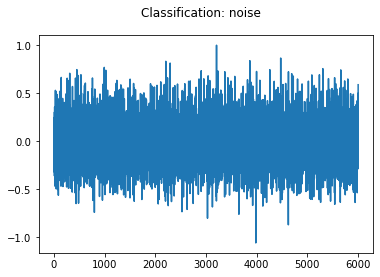

for 177:0
0
2018-12-17T20:33:51.832724Z


<Figure size 432x288 with 0 Axes>

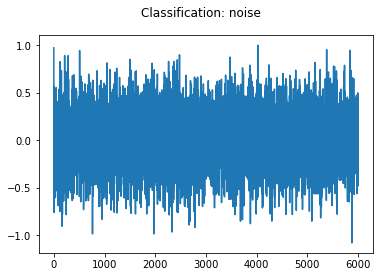

for 178:0
0
2018-12-14T19:41:41.565502Z


<Figure size 432x288 with 0 Axes>

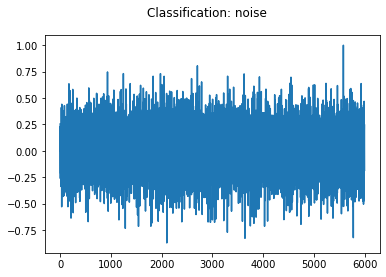

for 179:0
0
2018-12-18T05:43:57.300138Z


<Figure size 432x288 with 0 Axes>

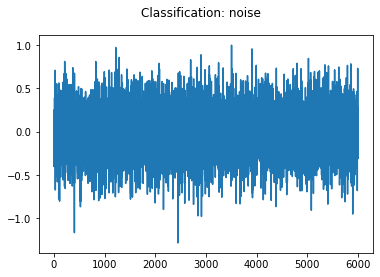

for 180:0
0
2018-12-14T16:34:57.666000Z


<Figure size 432x288 with 0 Axes>

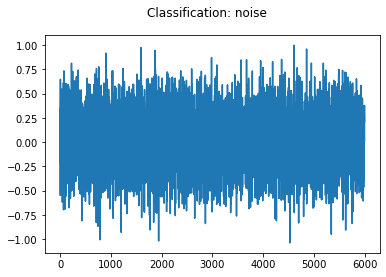

for 181:1
2
2018-12-18T02:14:25.814875Z


<Figure size 432x288 with 0 Axes>

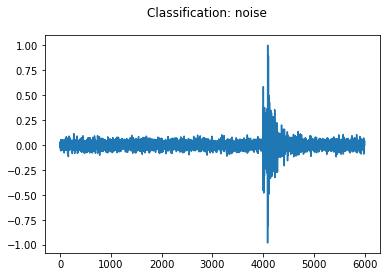

for 182:0
0
2018-12-17T23:51:15.367954Z


<Figure size 432x288 with 0 Axes>

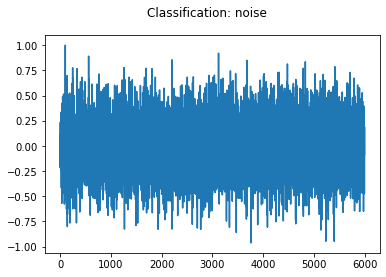

for 183:0
0
2018-12-18T08:22:55.926358Z


<Figure size 432x288 with 0 Axes>

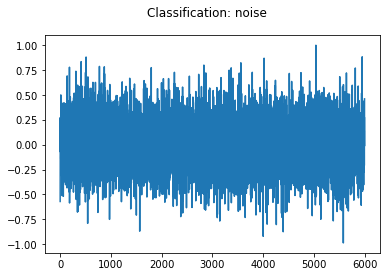

for 184:1
2
2018-12-14T17:22:40.540499Z


<Figure size 432x288 with 0 Axes>

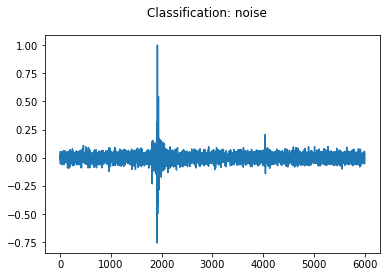

for 185:0
0
2018-12-15T03:03:10.531500Z


<Figure size 432x288 with 0 Axes>

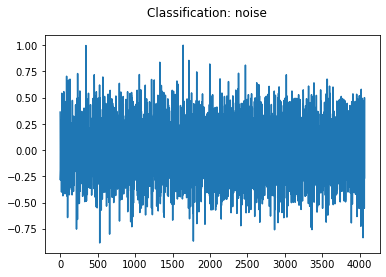

for 186:0
0
2018-12-17T18:35:56.740838Z


<Figure size 432x288 with 0 Axes>

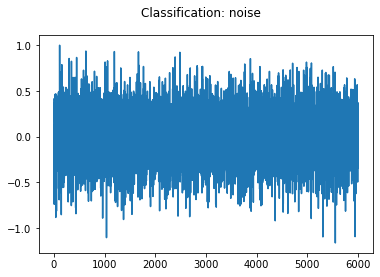

for 187:0
0
2018-12-15T04:53:39.408500Z


<Figure size 432x288 with 0 Axes>

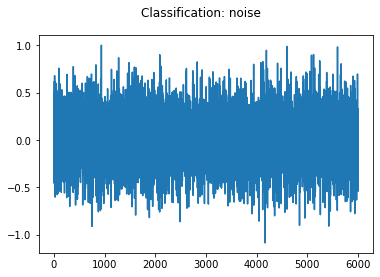

for 188:0
0
2018-12-17T19:46:29.421621Z


<Figure size 432x288 with 0 Axes>

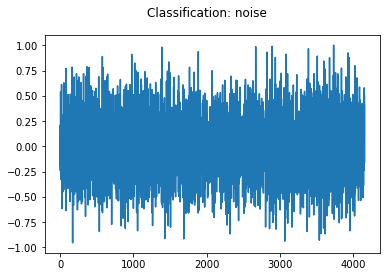

for 189:0
0
2018-12-18T01:06:02.209945Z


<Figure size 432x288 with 0 Axes>

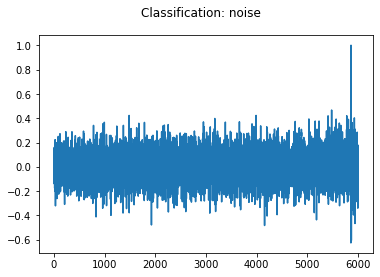

for 190:0
0
2018-12-14T15:03:33.396500Z


<Figure size 432x288 with 0 Axes>

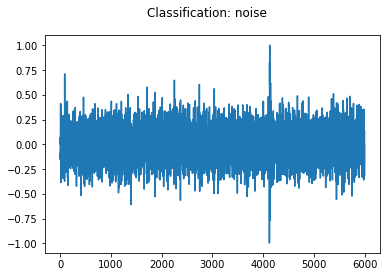

for 191:0
0
2018-12-18T04:02:53.189356Z


<Figure size 432x288 with 0 Axes>

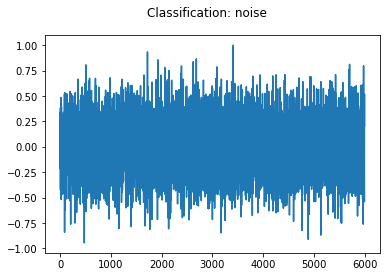

for 192:1
2
2018-12-14T17:35:09.780328Z


<Figure size 432x288 with 0 Axes>

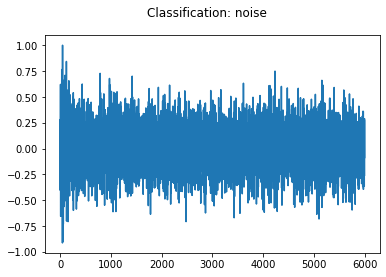

for 193:0
0
2018-12-17T21:07:03.273411Z


<Figure size 432x288 with 0 Axes>

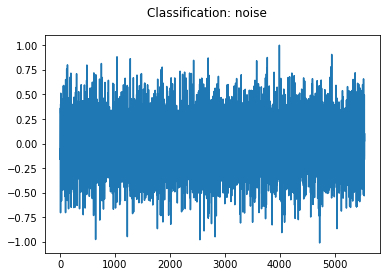

for 194:0
0
2018-12-14T20:25:13.901501Z


<Figure size 432x288 with 0 Axes>

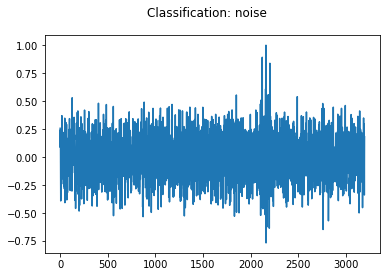

for 195:0
0
2018-12-18T05:28:25.031603Z


<Figure size 432x288 with 0 Axes>

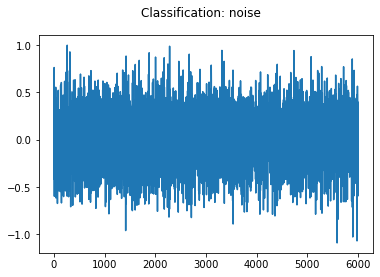

for 196:0
0
2018-12-15T04:40:30.429846Z


<Figure size 432x288 with 0 Axes>

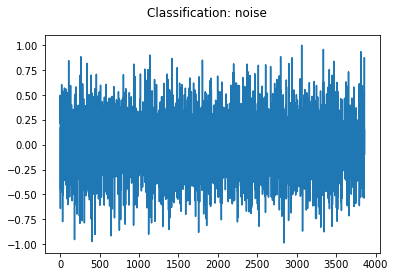

for 197:1
2
2018-12-14T15:59:44.792001Z


<Figure size 432x288 with 0 Axes>

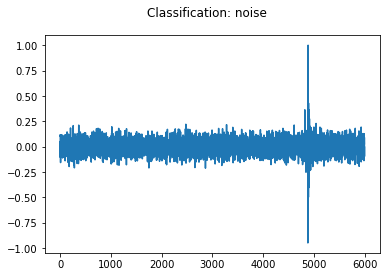

for 198:0
0
2018-12-17T19:05:24.908105Z


<Figure size 432x288 with 0 Axes>

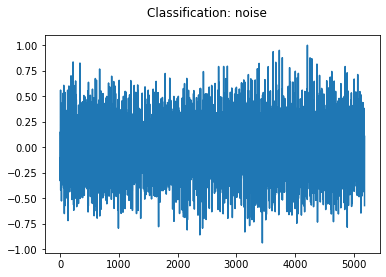

for 199:0
0
2018-12-15T14:18:24.858000Z


<Figure size 432x288 with 0 Axes>

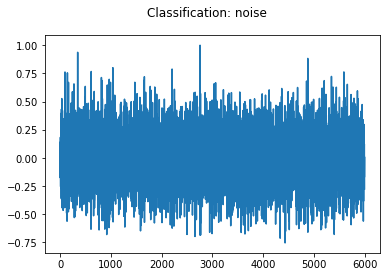

for 200:2
3
2018-10-16T13:49:59.824497Z


<Figure size 432x288 with 0 Axes>

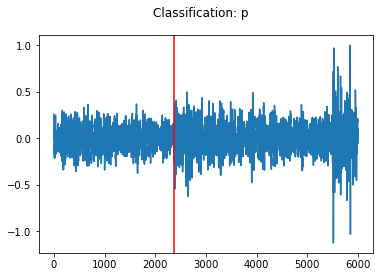

for 201:1
1
2018-10-18T14:36:54.081577Z


<Figure size 432x288 with 0 Axes>

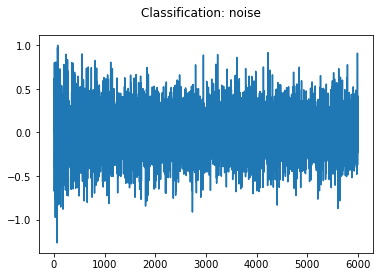

for 202:0
0
2018-10-18T15:28:08.172497Z


<Figure size 432x288 with 0 Axes>

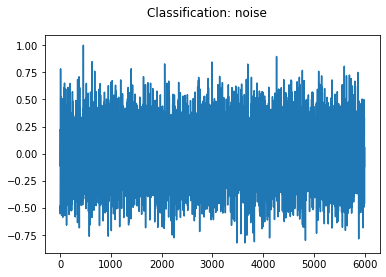

for 203:1
1
2018-10-22T11:50:56.058499Z


<Figure size 432x288 with 0 Axes>

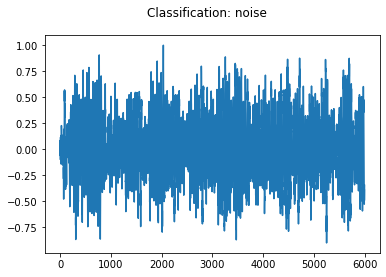

for 204:0
0
2018-10-24T13:39:30.415000Z


<Figure size 432x288 with 0 Axes>

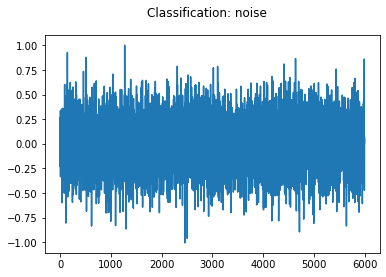

for 205:1
1
2018-10-24T13:50:28.123500Z


<Figure size 432x288 with 0 Axes>

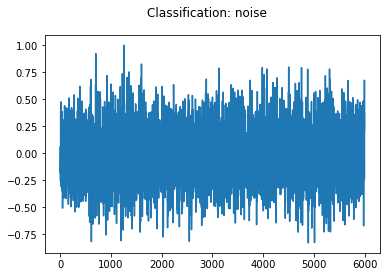

for 206:0
0
2018-10-25T11:35:06.813999Z


<Figure size 432x288 with 0 Axes>

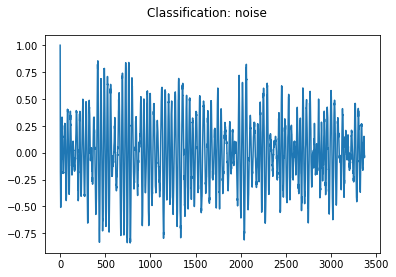

for 207:0
0
2018-10-25T12:06:03.809500Z


<Figure size 432x288 with 0 Axes>

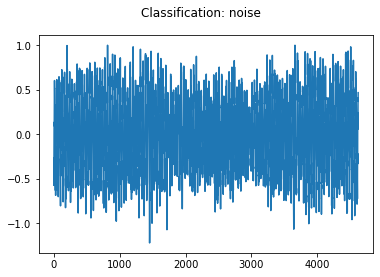

for 208:3
5
2018-10-25T13:06:01.177500Z


<Figure size 432x288 with 0 Axes>

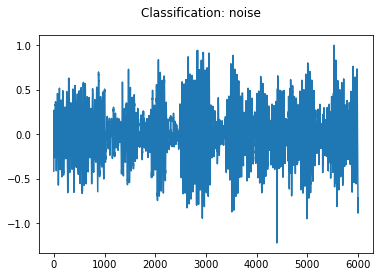

for 209:2
4
2018-10-25T13:24:55.688499Z


<Figure size 432x288 with 0 Axes>

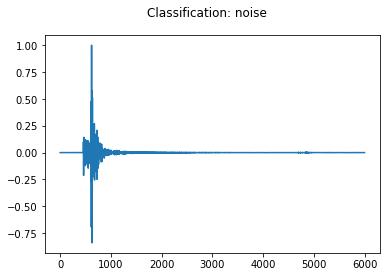

for 210:1
2
2018-10-25T14:51:06.781501Z


<Figure size 432x288 with 0 Axes>

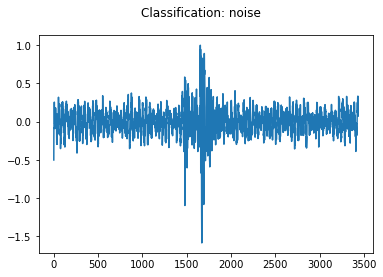

for 211:1
2
2018-10-25T15:21:00.353500Z


<Figure size 432x288 with 0 Axes>

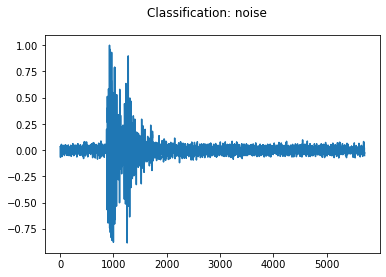

for 212:2
3
2018-10-25T15:29:03.817499Z


<Figure size 432x288 with 0 Axes>

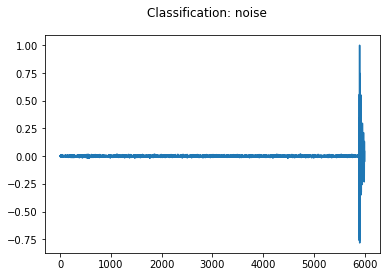

for 213:0
0
2018-10-26T08:41:31.695720Z


<Figure size 432x288 with 0 Axes>

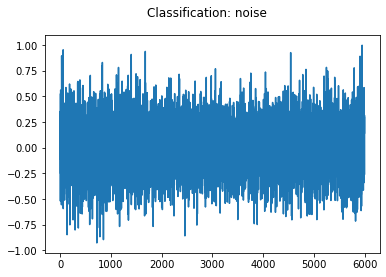

for 214:1
3
2018-10-26T11:10:35.557499Z


<Figure size 432x288 with 0 Axes>

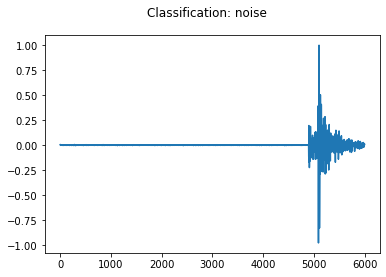

for 215:2
4
2018-10-27T11:03:23.426501Z


<Figure size 432x288 with 0 Axes>

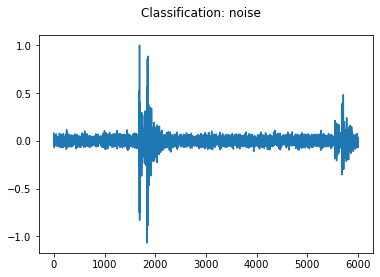

for 216:0
1
2018-10-27T11:07:25.788499Z


<Figure size 432x288 with 0 Axes>

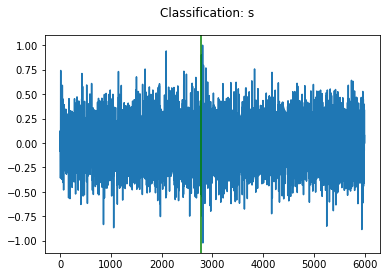

for 217:0
0
2018-10-30T14:44:11.823515Z


<Figure size 432x288 with 0 Axes>

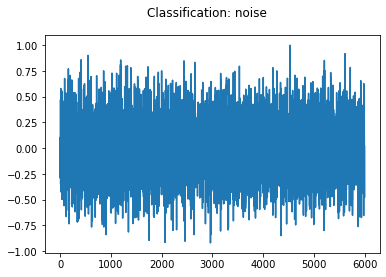

for 218:0
0
2018-10-31T08:22:51.389743Z


<Figure size 432x288 with 0 Axes>

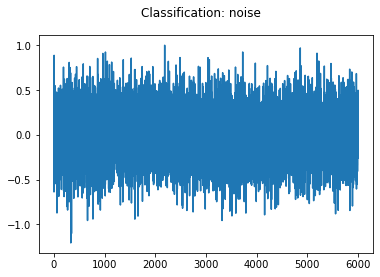

for 219:0
0
2018-10-31T10:41:18.284942Z


<Figure size 432x288 with 0 Axes>

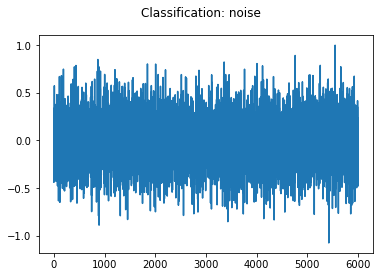

for 220:0
0
2018-12-09T21:15:02.914503Z


<Figure size 432x288 with 0 Axes>

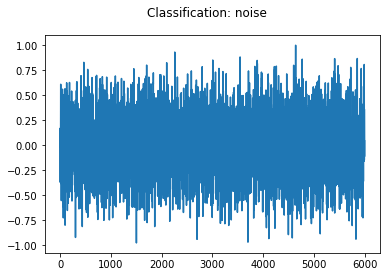

for 221:0
0
2018-12-10T12:38:45.835501Z


<Figure size 432x288 with 0 Axes>

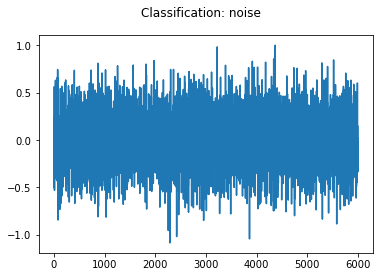

for 222:2
4
2018-12-11T10:02:16.506499Z


<Figure size 432x288 with 0 Axes>

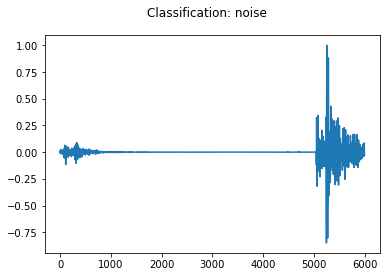

for 223:3
5
2018-12-14T13:08:07.714999Z


<Figure size 432x288 with 0 Axes>

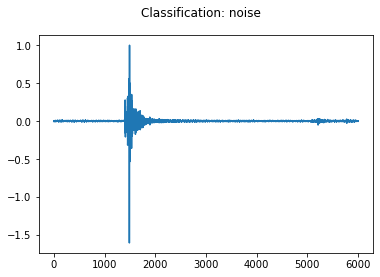

for 224:0
0
2018-12-14T14:29:26.360495Z


<Figure size 432x288 with 0 Axes>

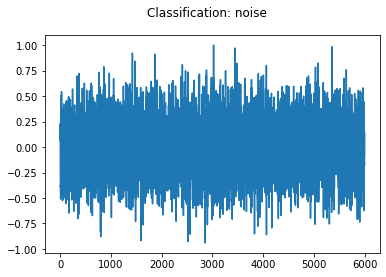

for 225:1
2
2018-10-16T14:19:04.527500Z


<Figure size 432x288 with 0 Axes>

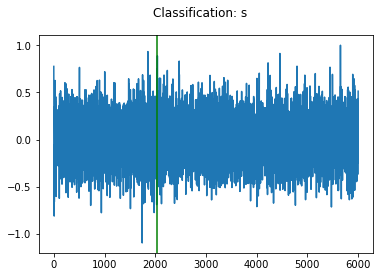

for 226:0
0
2018-10-16T15:09:01.566004Z


<Figure size 432x288 with 0 Axes>

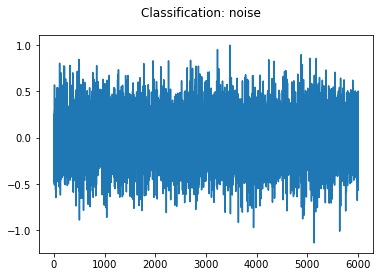

for 227:0
0
2018-10-17T17:42:00.022497Z


<Figure size 432x288 with 0 Axes>

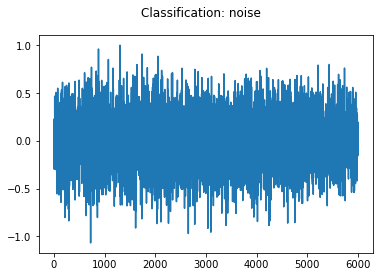

for 228:0
0
2018-10-17T18:08:07.517003Z


<Figure size 432x288 with 0 Axes>

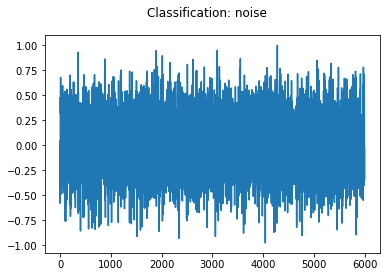

for 229:0
0
2018-10-18T14:33:00.017499Z


<Figure size 432x288 with 0 Axes>

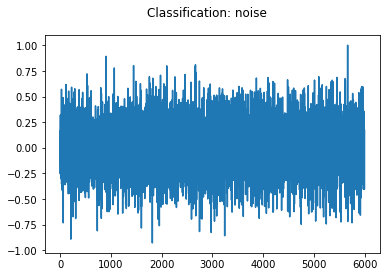

for 230:0
0
2018-10-18T14:51:25.291075Z


<Figure size 432x288 with 0 Axes>

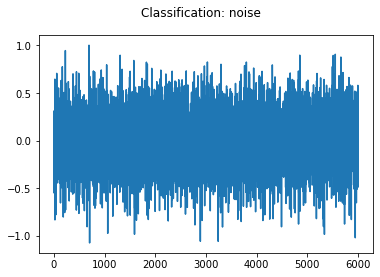

for 231:0
0
2018-10-19T12:51:43.176329Z


<Figure size 432x288 with 0 Axes>

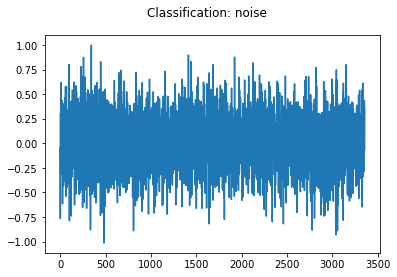

for 232:0
0
2018-10-22T22:16:26.187965Z


<Figure size 432x288 with 0 Axes>

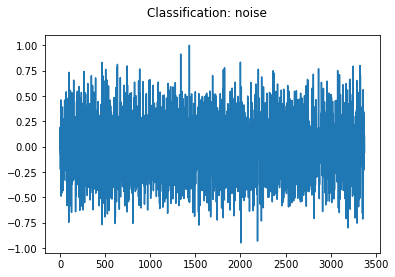

for 233:2
5
2018-10-25T11:39:18.022878Z


<Figure size 432x288 with 0 Axes>

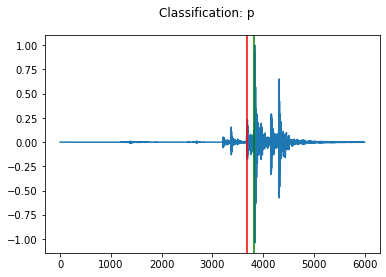

for 234:0
0
2018-10-25T12:17:15.683881Z


<Figure size 432x288 with 0 Axes>

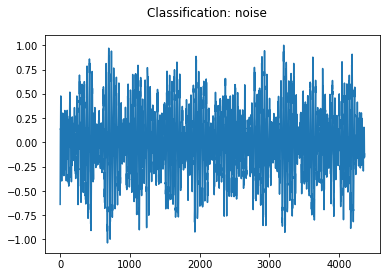

for 235:1
1
2018-10-25T12:41:29.403562Z


<Figure size 432x288 with 0 Axes>

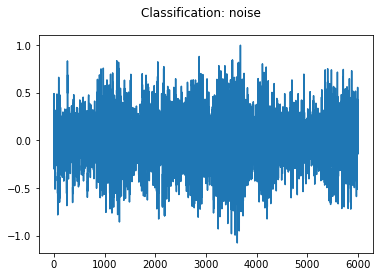

for 236:1
3
2018-10-25T15:07:12.805209Z


<Figure size 432x288 with 0 Axes>

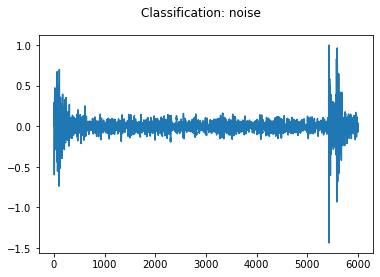

for 237:1
2
2018-10-25T17:08:33.172500Z


<Figure size 432x288 with 0 Axes>

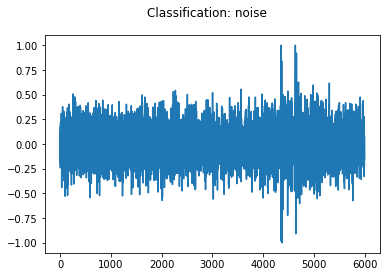

for 238:1
2
2018-10-26T11:31:41.799501Z


<Figure size 432x288 with 0 Axes>

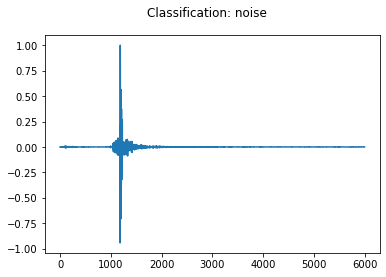

for 239:1
3
2018-10-27T10:38:19.212500Z


<Figure size 432x288 with 0 Axes>

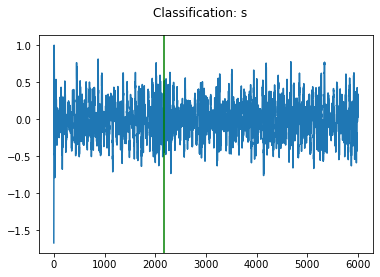

for 240:0
0
2018-10-27T10:58:58.104500Z


<Figure size 432x288 with 0 Axes>

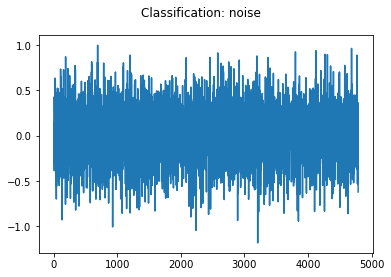

for 241:0
0
2018-10-27T14:33:31.600499Z


<Figure size 432x288 with 0 Axes>

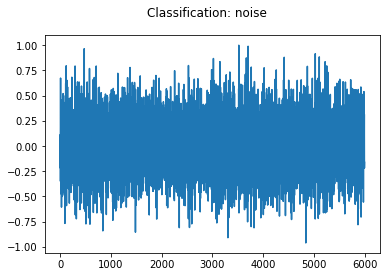

for 242:0
0
2018-11-02T17:45:59.884999Z


<Figure size 432x288 with 0 Axes>

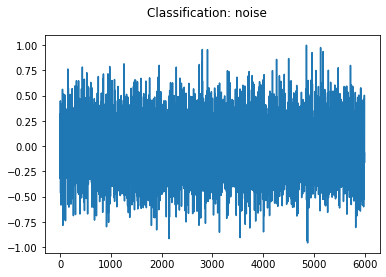

for 243:0
0
2018-12-11T09:21:25.517003Z


<Figure size 432x288 with 0 Axes>

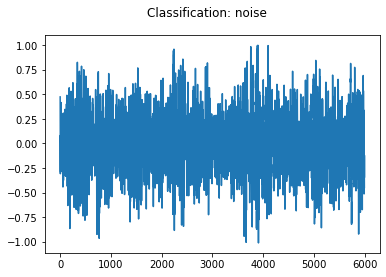

for 244:2
3
2018-12-11T09:32:02.381499Z


<Figure size 432x288 with 0 Axes>

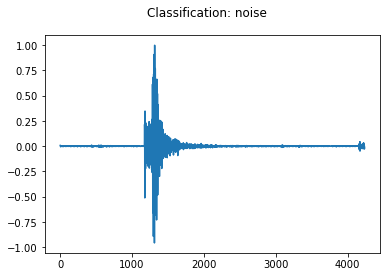

for 245:2
5
2018-12-11T10:29:16.927503Z


<Figure size 432x288 with 0 Axes>

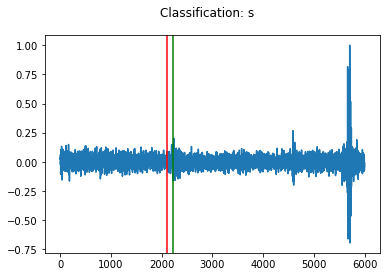

for 246:0
0
2018-12-13T11:19:17.937003Z


<Figure size 432x288 with 0 Axes>

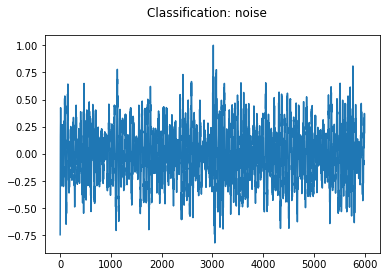

for 247:0
0
2018-12-14T20:12:21.600999Z


<Figure size 432x288 with 0 Axes>

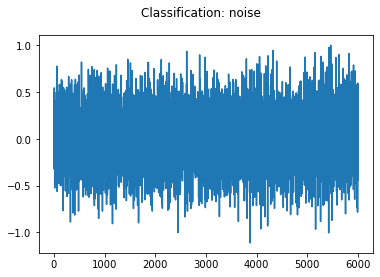

for 248:0
0
2018-12-17T11:31:04.611688Z


<Figure size 432x288 with 0 Axes>

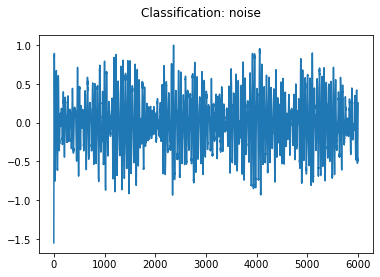

for 249:1
2
2018-12-17T12:07:48.136187Z


<Figure size 432x288 with 0 Axes>

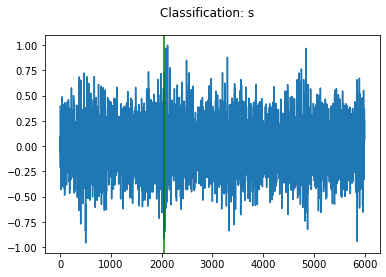

250
All done with N.


<Figure size 432x288 with 0 Axes>

In [84]:

# looking at what the df looks like

folders = glob.glob('./output_N/CF2021/*')
folders.sort()

# make a dataframe for each event, put all picks in one df
# limit the pick starttime to +- 500 samples (+- 0.25s) from the pick time

results_N = pd.DataFrame(index= np.arange(0,len(N_df)),columns=['time', 'sta', 'pha', 'prob'])

for i in np.arange(0,len(folders)):
# for i in np.arange(0,3):
    
    df = pd.DataFrame()
    files = glob.glob(str(folders[i]) + '/*.csv')
    files.sort()
    picks_df = pd.read_csv(files[0],delim_whitespace=True)
    p_idx = literal_eval(picks_df['p_idx'].iloc[0])
    s_idx = literal_eval(picks_df['s_idx'].iloc[0])
    p_prob = literal_eval(picks_df['p_prob'].iloc[0])
    s_prob = literal_eval(picks_df['s_prob'].iloc[0])
    p_amp = literal_eval(picks_df['p_amp'].iloc[0])
    s_amp = literal_eval(picks_df['s_amp'].iloc[0])
    
    p_times = []
    
    for j in np.arange(0,len(p_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (p_idx[j]/2000)
        p_times.append(time1)
        
    s_times = []
    for j in np.arange(0,len(s_idx)):
        time1 = UTCDateTime(picks_df.t0[0]) + (s_idx[j]/2000)
        s_times.append(time1)
        
    df_P = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(p_times)))
    for j in np.arange(0,len(p_times)):
        df_P['time'].iloc[j] = p_times[j]
        df_P['pha'].iloc[j] = 'p'
        df_P['prob'].iloc[j] = p_prob[j]
        df_P['amp'].iloc[j] = p_amp[j]
        if (i+1)<10:
            df_P['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_P['sta'].iloc[j] = '0'+str(i+1)     
    

    df_S = pd.DataFrame(columns=['time','sta','pha','prob','amp'],index=np.arange(0,len(s_times)))
    for j in np.arange(0,len(s_times)):
        df_S['time'].iloc[j] = s_times[j]
        df_S['pha'].iloc[j] = 's'
        df_S['prob'].iloc[j] = s_prob[j]
        df_S['amp'].iloc[j] = s_amp[j]
        if (i+1)<10:
            df_S['sta'].iloc[j] = '00'+str(i+1)
        else:
            df_S['sta'].iloc[j] = '0'+str(i+1)
    print('for ' + str(i) + ':' + str(len(df_P)))        
    df = pd.concat([df,df_P,df_S])
    print(len(df))
    
    ####################################################
    # filtering the picks out and visualising them
    ####################################################
    
    midwindow = N_df['starttime'].iloc[i]
    toplim = midwindow + 0.5
    botlim = midwindow - 0.5
    print(midwindow)


    df_final = df[df['time'] >= botlim]
    df_final = df_final[df_final['time'] <= toplim]
    
    st = read(glob.glob(data_dir[i] + '/*')[0])

    fig, axs = plt.subplots(1)

    # get the one nearest to the middle of the window
    if len(df_final) > 0:
        timediff = []
        for dfii in np.arange(0,len(df_final)):
            timediff1 = abs(midwindow - df_final['time'].iloc[dfii])
            timediff.append(timediff1)

        fig.suptitle('Classification: '+ df_final['pha'].iloc[np.argmin(timediff)])

    else:
        fig.suptitle('Classification: noise')

    axs.plot(st[0].data/max(st[0].data))
    if len(df_final) > 0:
        df_final.to_csv('./Model_results/PhaseNet/N/df_final_'+str(i+1)+'.csv')
        for thepicks in np.arange(0,len(df_final)):
            if df_final['pha'].iloc[thepicks] == 'p':
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='r')
            else:
                axs.axvline(x=(abs(df_final['time'].iloc[thepicks] - st[0].stats.starttime) / 0.0005),color='g')

    else:
        pass

    plt.show()

    if (i+1) < 10:
        fig.savefig('./Model_results/PhaseNet/N/N_result_00'+str(i+1)+'.png')
    elif ((i+1) > 9) and ((i+1) < 100):
        fig.savefig('./Model_results/PhaseNet/N/N_result_0'+str(i+1)+'.png')
    else:
        fig.savefig('./Model_results/PhaseNet/N/N_result_'+str(i+1)+'.png')

    plt.close()
    plt.clf()
    #############

    # run through all N picks
    if len(df_final)>0:
        results_N['time'].iloc[i] = df_final['time'].iloc[0]
        results_N['sta'].iloc[i] = df_final['sta'].iloc[0]
        results_N['pha'].iloc[i] = df_final['pha'].iloc[np.argmin(timediff)]
        results_N['prob'].iloc[i] = df_final['prob'].iloc[np.argmin(timediff)]
    else:
        results_N['time'].iloc[i] = np.nan
        results_N['sta'].iloc[i] = N_df['sta_str'].iloc[indx]
        results_N['pha'].iloc[i] = 'n'
        results_N['prob'].iloc[i] = np.nan

    
results_N.to_csv('./Model_results/PhaseNet/N/250results_N.csv')
print(len(results_N))
print("All done with N.")


# df.sort_values(by='time')


___

## Confusion matrix making

In [36]:
!pip install -U scikit-learn

     |████████████████████████████████| 7.8 MB 4.3 MB/s eta 0:00:01
     |████████████████████████████████| 306 kB 8.5 MB/s eta 0:00:01


In [38]:
CFM

array([[243,   3,   4],
       [242,   7,   1],
       [ 10,   6, 234]])

In [63]:
CFM

array([[243,   3,   4],
       [242,   7,   1],
       [ 10,   6, 234]])

In [67]:
CFM[1] = ([7,242,1])

In [68]:
CFM

array([[243,   3,   4],
       [  7, 242,   1],
       [ 10,   6, 234]])

In [39]:
PRF_250ev_df

,Precision,Recall,F-score
0,0.63583,0.645333,0.554012


In [62]:
results_S

,time,sta,pha,prob
0,2018-10-16T10:54:18.349000Z,001,p,0.982
1,2018-10-17T10:44:06.573000Z,002,p,0.917
2,2018-10-17T10:44:19.298500Z,003,p,0.98
3,2018-10-17T10:46:22.149000Z,004,p,0.846
4,2018-10-17T10:47:01.082500Z,005,p,0.979
...,...,...,...,...
245,2018-12-11T10:29:19.026500Z,0246,p,0.98
246,2018-12-13T11:19:20.037500Z,0247,p,0.986
247,2018-12-14T20:12:31.699500Z,0248,p,0.983
248,2018-12-17T11:31:06.710500Z,0249,p,0.978


In [85]:
len(results_P)
len(results_S)
len(results_N)

P_true = ['p'] * len(results_P)
S_true = ['s'] * len(results_S)
N_true = ['n'] * len(results_N)

P_predict = results_P['pha'].to_list()
S_predict = results_S['pha'].to_list()
N_predict = results_N['pha'].to_list()

from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix

true = P_true + S_true + N_true
predict = P_predict + S_predict + N_predict
CFM = confusion_matrix(true,predict,labels=['p','s','n'])

# precision, recall, weigted f-score
precision, recall, fscore, nth = precision_recall_fscore_support(true, predict, average='weighted',labels=['p', 's', 'n'])
PRF_250ev_df = pd.DataFrame(index = np.arange(0,1), columns=['Precision','Recall', 'F-score'])
PRF_250ev_df.iloc[0] = [precision, recall, fscore]

# PRF_250ev_df.to_pickle(root + 'confusion_matrix/PRF_250ev_df_'+str(min_proba[i_thr])+'_thr.pkl')
PRF_250ev_df.to_csv('./Model_results/PhaseNet/PhaseNet_PRF_250ev_df.csv')

# CFM_df = pd.DataFrame.from_items([('P', CFM[0]), 
#                          ('S', CFM[1]),
#                          ('Noise', CFM[2])],
#                         orient='index',
#                         columns=['P', 'S', 'Noise'])

CFM_df = pd.DataFrame(index = ['P','S','Noise'],columns = ['P','S','Noise'])
CFM_df['P'].iloc[0] = CFM[0][0]
CFM_df['S'].iloc[0] = CFM[0][1]
CFM_df['Noise'].iloc[0] = CFM[0][2]

CFM_df['P'].iloc[1] = CFM[1][0]
CFM_df['S'].iloc[1] = CFM[1][1]
CFM_df['Noise'].iloc[1] = CFM[1][2]

CFM_df['P'].iloc[2] = CFM[2][0]
CFM_df['S'].iloc[2] = CFM[2][1]
CFM_df['Noise'].iloc[2] = CFM[2][2]

CFM_250evdf = CFM_df.copy()
# CFM_250evdf.to_pickle(root+'confusion_matrix/CFM_f50_250evdf_'+str(min_proba[i_thr])+'_thr.pkl')
CFM_250evdf.to_csv('./Model_results/PhaseNet/PhaseNet_CFM_250ev_df.csv')

print('All done.')

All done.


In [86]:
CFM_df

,P,S,Noise
P,243,3,4
S,3,246,1
Noise,6,10,234


In [87]:
PRF_250ev_df

,Precision,Recall,F-score
0,0.964391,0.964,0.963928


____

idx: 0
Origin time: 2018-10-16T10:54:16.248596Z
Station: 10
29/29 [==============================] - 0s 2ms/step


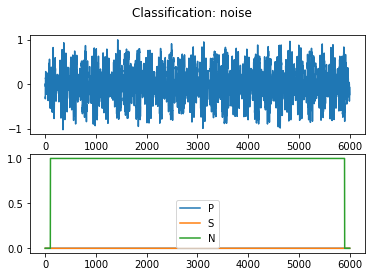

idx: 1
Origin time: 2018-10-17T10:44:04.472483Z
Station: 6.0
28/28 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

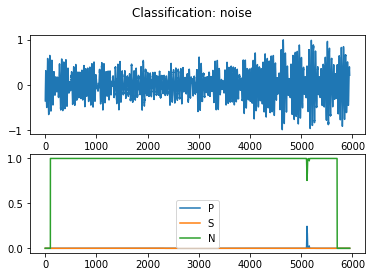

idx: 2
Origin time: 2018-10-17T10:44:17.199796Z
Station: 19
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

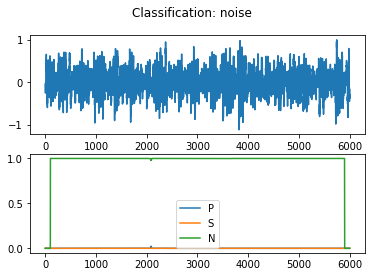

idx: 3
Origin time: 2018-10-17T10:46:20.051227Z
Station: 10
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

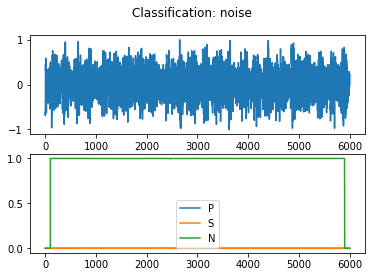

idx: 4
Origin time: 2018-10-17T10:46:58.983957Z
Station: 16.0
14/14 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

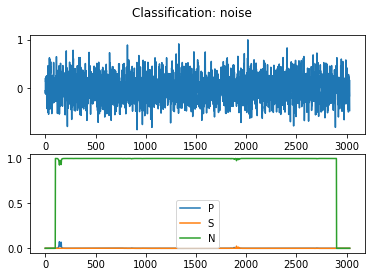

idx: 5
Origin time: 2018-10-17T10:48:47.566153Z
Station: 2.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

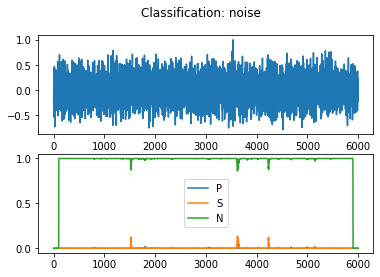

idx: 6
Origin time: 2018-10-17T10:54:19.768852Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

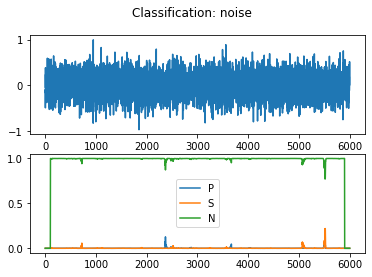

idx: 7
Origin time: 2018-10-23T14:22:10.717697Z
Station: 23.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

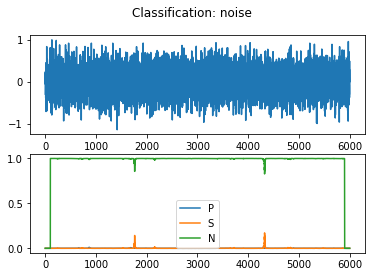

idx: 8
Origin time: 2018-10-23T14:27:14.027296Z
Station: 10.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

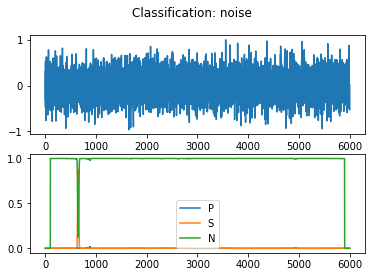

idx: 9
Origin time: 2018-10-23T14:30:55.205669Z
Station: 9.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

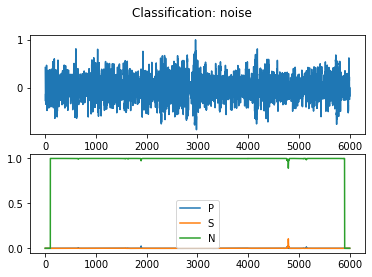

idx: 10
Origin time: 2018-10-23T14:35:41.846102Z
Station: 1.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

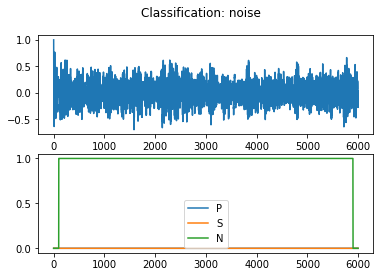

idx: 11
Origin time: 2018-10-23T14:36:13.695023Z
Station: 13.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

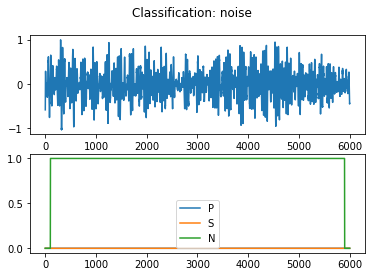

idx: 12
Origin time: 2018-10-23T14:36:48.565293Z
Station: 3.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

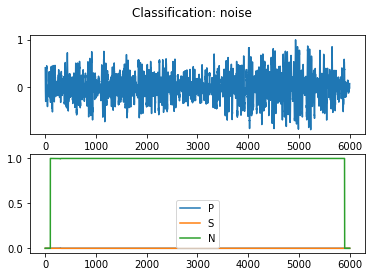

idx: 13
Origin time: 2018-10-23T14:37:27.176876Z
Station: 10
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

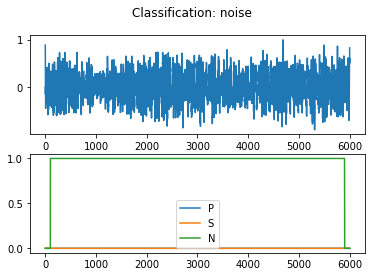

idx: 14
Origin time: 2018-10-23T14:38:04.956302Z
Station: 14
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

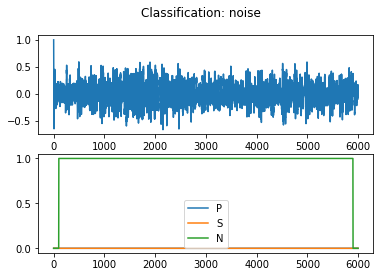

idx: 15
Origin time: 2018-10-23T14:39:11.987327Z
Station: 11.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

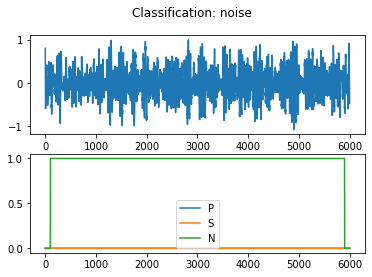

idx: 16
Origin time: 2018-10-23T14:39:18.568372Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

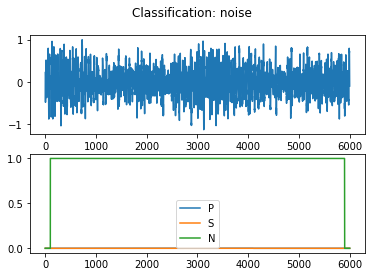

idx: 17
Origin time: 2018-10-23T14:40:32.303000Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

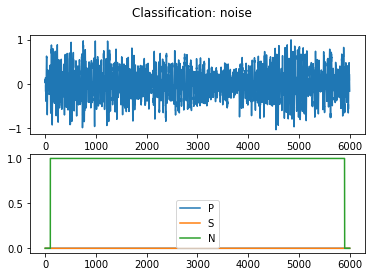

idx: 18
Origin time: 2018-10-23T14:41:39.037625Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

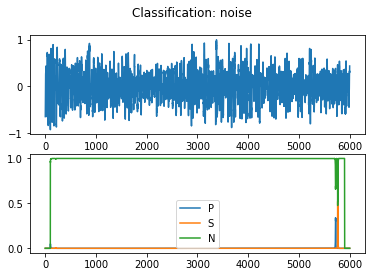

idx: 19
Origin time: 2018-10-23T14:41:48.264001Z
Station: 9.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

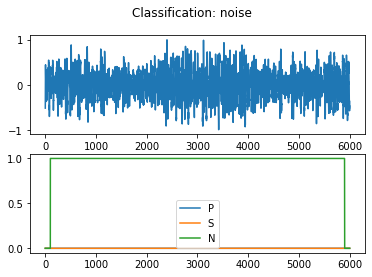

idx: 20
Origin time: 2018-10-23T14:41:51.280754Z
Station: 10.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

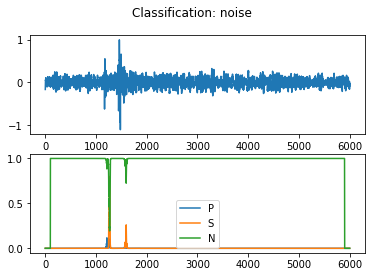

idx: 21
Origin time: 2018-10-23T14:44:23.224501Z
Station: 7
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

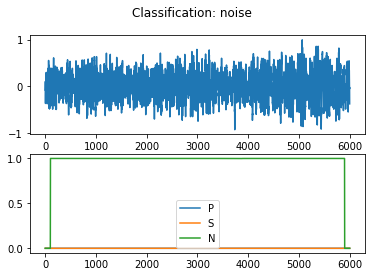

idx: 22
Origin time: 2018-10-23T14:44:27.344719Z
Station: 17.0
27/27 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

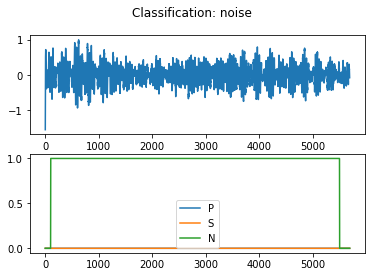

idx: 23
Origin time: 2018-10-23T14:44:33.631000Z
Station: 21.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

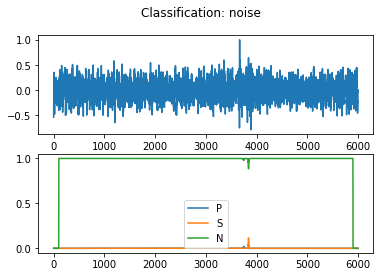

idx: 24
Origin time: 2018-10-23T14:44:35.440141Z
Station: 3.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

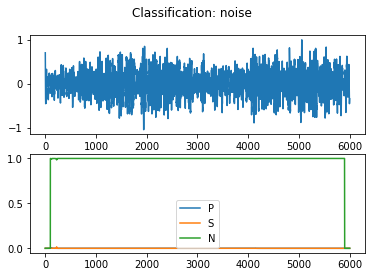

idx: 25
Origin time: 2018-10-23T14:44:42.436276Z
Station: 9
18/18 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

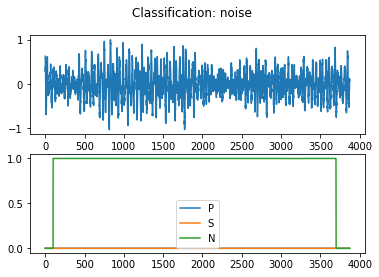

idx: 26
Origin time: 2018-10-23T14:34:57.867670Z
Station: 21
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

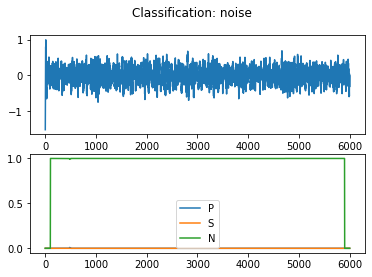

idx: 27
Origin time: 2018-10-23T14:45:30.691670Z
Station: 4.0
20/20 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

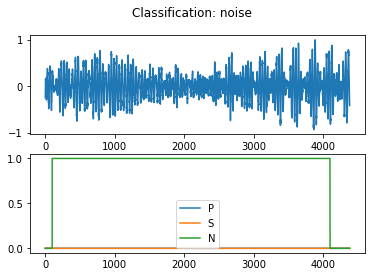

idx: 28
Origin time: 2018-10-23T14:45:38.166110Z
Station: 12
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

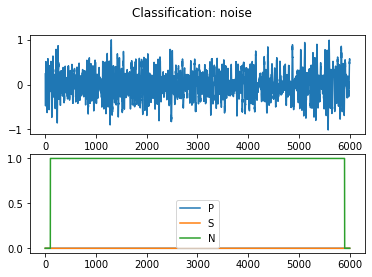

idx: 29
Origin time: 2018-10-23T14:45:42.057500Z
Station: 14.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

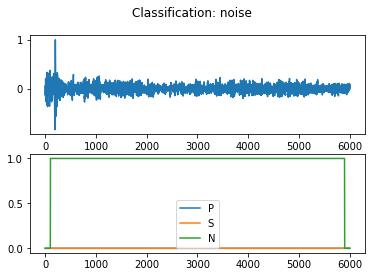

idx: 30
Origin time: 2018-10-23T14:41:59.429500Z
Station: 13
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

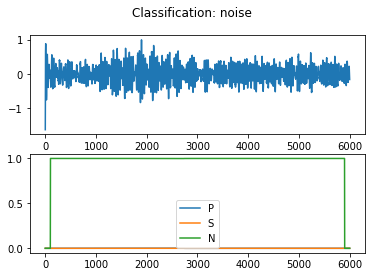

idx: 31
Origin time: 2018-10-23T14:48:44.251333Z
Station: 21.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

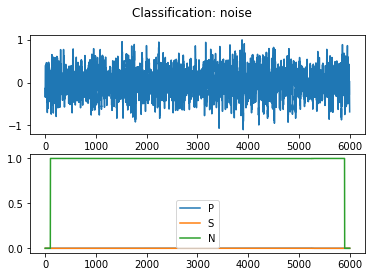

idx: 32
Origin time: 2018-10-23T14:48:58.505501Z
Station: 21.0
19/19 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

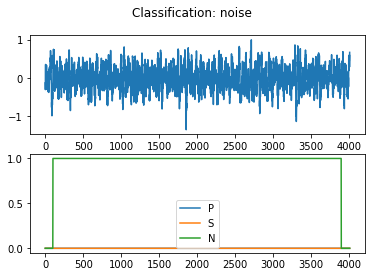

idx: 33
Origin time: 2018-10-23T14:49:46.866822Z
Station: 22
22/22 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

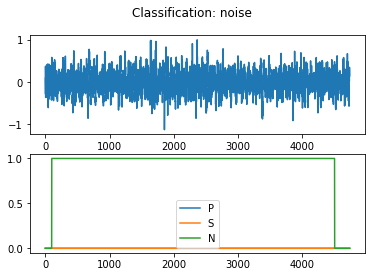

idx: 34
Origin time: 2018-10-23T14:51:49.680492Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

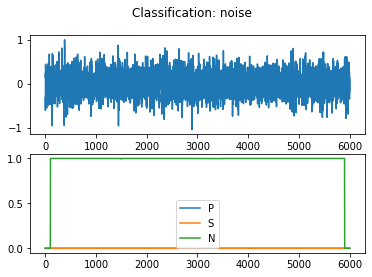

idx: 35
Origin time: 2018-10-23T14:52:00.384999Z
Station: 14.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

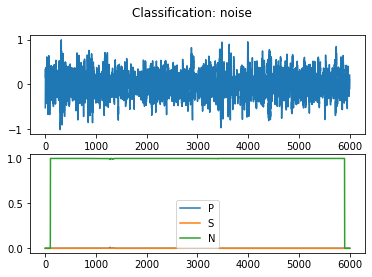

idx: 36
Origin time: 2018-10-23T14:52:34.182500Z
Station: 17
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

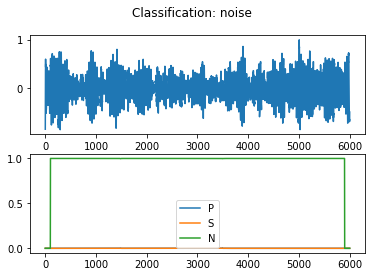

idx: 37
Origin time: 2018-10-23T14:53:36.571001Z
Station: 21.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

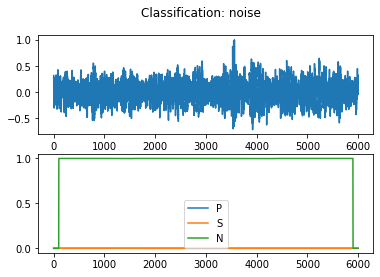

idx: 38
Origin time: 2018-10-23T14:53:40.181478Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

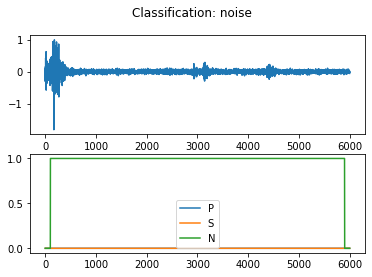

idx: 39
Origin time: 2018-10-23T14:54:23.041013Z
Station: 14
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

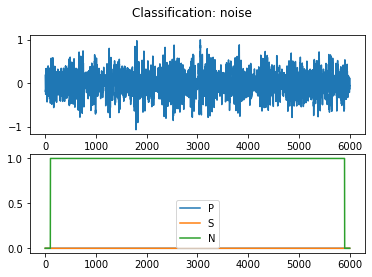

idx: 40
Origin time: 2018-10-23T14:55:55.916572Z
Station: 24
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

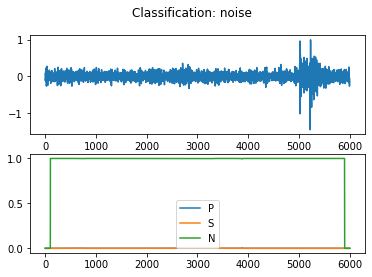

idx: 41
Origin time: 2018-10-23T14:56:25.526500Z
Station: 24.0
18/18 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

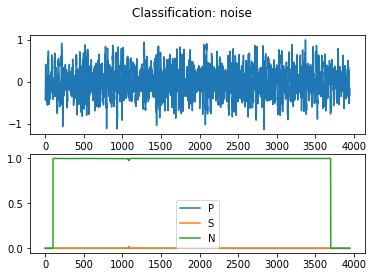

idx: 42
Origin time: 2018-10-23T14:57:02.238996Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

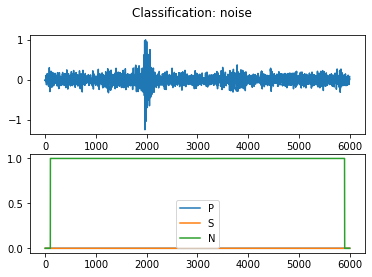

idx: 43
Origin time: 2018-10-23T14:57:31.732999Z
Station: 23
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

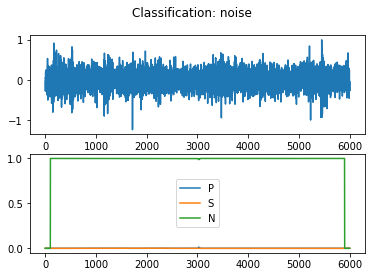

idx: 44
Origin time: 2018-10-23T14:57:38.961501Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

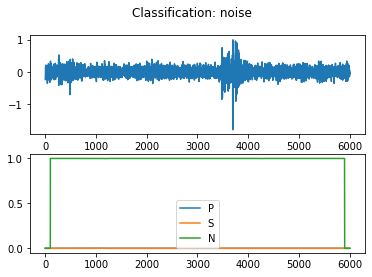

idx: 45
Origin time: 2018-10-23T14:57:47.420499Z
Station: 20
28/28 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

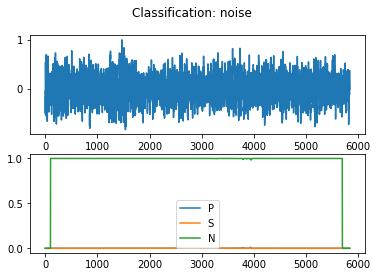

idx: 46
Origin time: 2018-10-23T14:58:00.046001Z
Station: 22.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

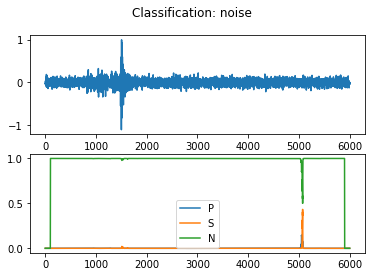

idx: 47
Origin time: 2018-10-23T14:58:03.818501Z
Station: 24.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

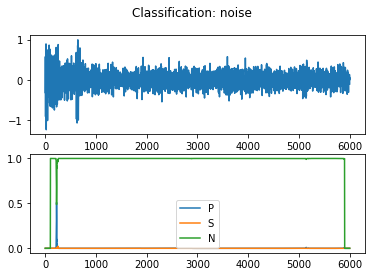

idx: 48
Origin time: 2018-10-23T14:58:37.114893Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

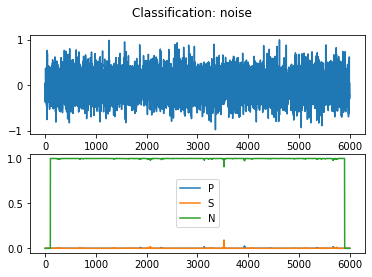

idx: 49
Origin time: 2018-10-23T14:58:46.647501Z
Station: 18.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

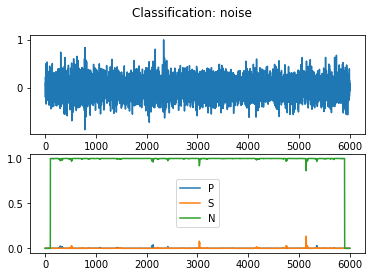

idx: 50
Origin time: 2018-10-23T14:59:00.740000Z
Station: 21.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

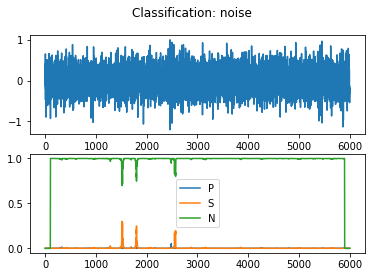

idx: 51
Origin time: 2018-10-23T14:59:14.711999Z
Station: 24.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

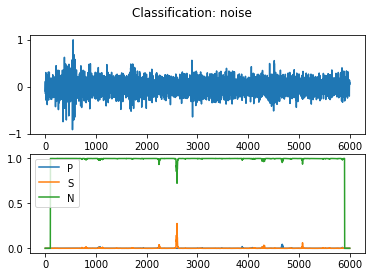

idx: 52
Origin time: 2018-10-23T14:59:17.205999Z
Station: 23
29/29 [==============================] - 0s 4ms/step


<Figure size 432x288 with 0 Axes>

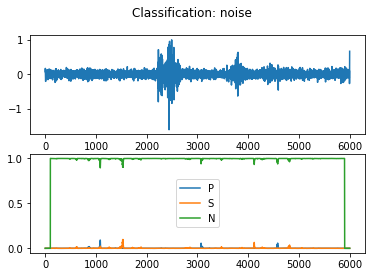

idx: 53
Origin time: 2018-10-23T14:59:22.648624Z
Station: 5.0
20/20 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

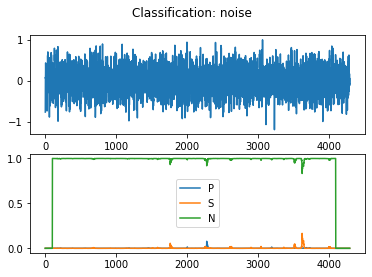

idx: 54
Origin time: 2018-10-23T14:59:26.986514Z
Station: 10.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

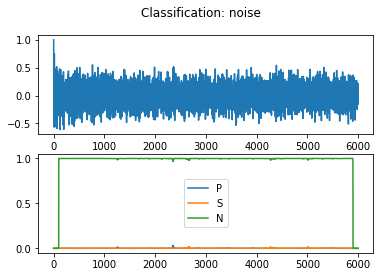

idx: 55
Origin time: 2018-10-23T14:59:35.694000Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

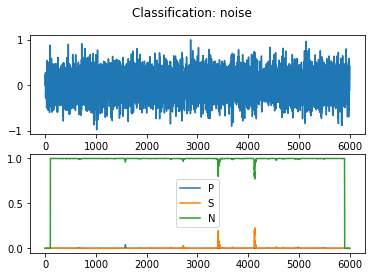

idx: 56
Origin time: 2018-10-23T14:59:36.325500Z
Station: 17.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

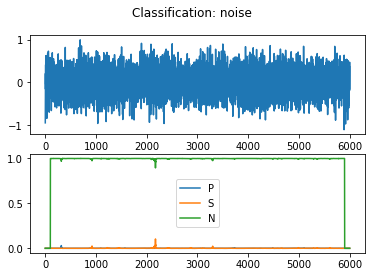

idx: 57
Origin time: 2018-10-29T09:07:42.543459Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

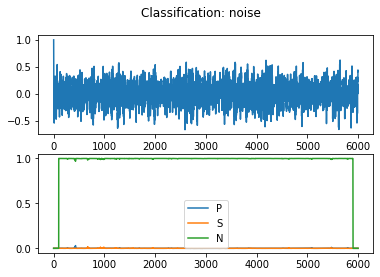

idx: 58
Origin time: 2018-10-29T09:11:08.154020Z
Station: 20
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

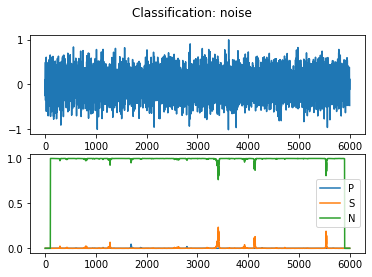

idx: 59
Origin time: 2018-10-29T09:11:26.426414Z
Station: 10.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

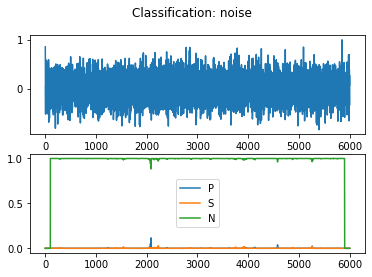

idx: 60
Origin time: 2018-10-29T09:13:14.237352Z
Station: 12.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

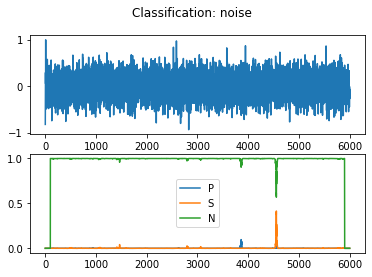

idx: 61
Origin time: 2018-10-29T09:13:25.269081Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

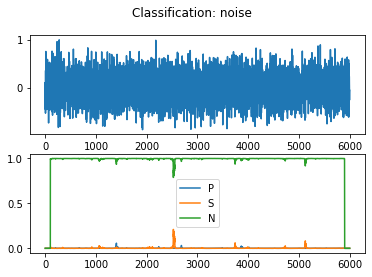

idx: 62
Origin time: 2018-10-29T09:17:57.515387Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

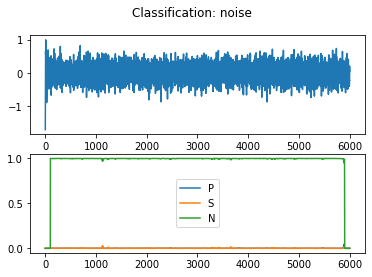

idx: 63
Origin time: 2018-10-29T09:24:13.784174Z
Station: 16.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

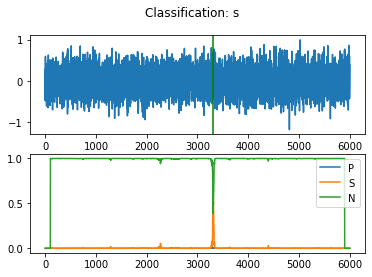

idx: 64
Origin time: 2018-10-29T09:26:03.826933Z
Station: 17.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

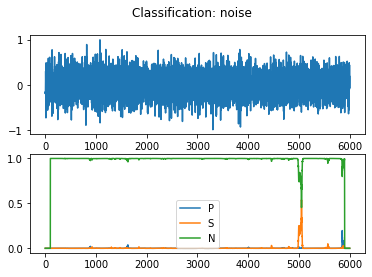

idx: 65
Origin time: 2018-10-29T09:29:49.316275Z
Station: 23
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

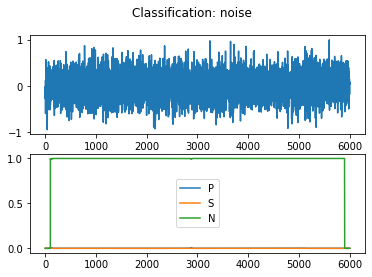

idx: 66
Origin time: 2018-10-29T09:30:18.400192Z
Station: 12
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

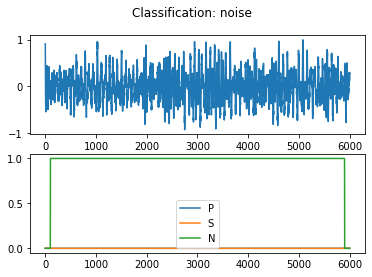

idx: 67
Origin time: 2018-10-29T09:31:16.304956Z
Station: 10.0
27/27 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

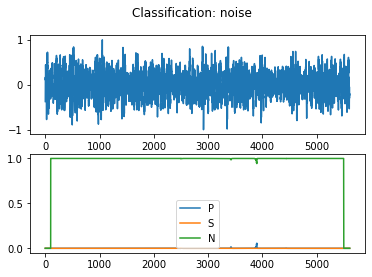

idx: 68
Origin time: 2018-10-29T09:31:38.836847Z
Station: 22
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

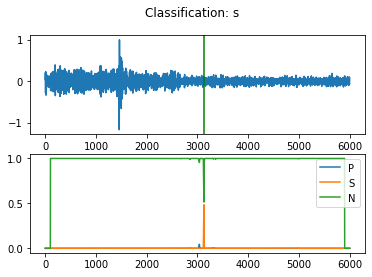

idx: 69
Origin time: 2018-10-29T09:31:45.983910Z
Station: 14
24/24 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

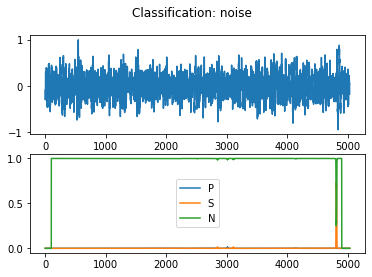

idx: 70
Origin time: 2018-10-29T09:31:48.377337Z
Station: 19
27/27 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

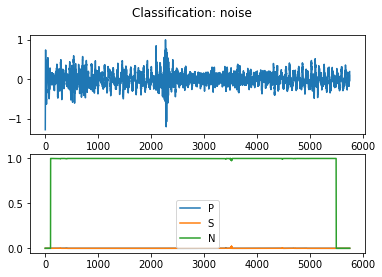

idx: 71
Origin time: 2018-10-29T09:31:56.829528Z
Station: 15
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

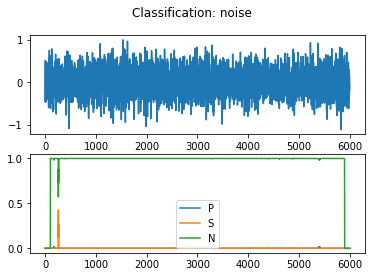

idx: 72
Origin time: 2018-10-29T09:32:37.878250Z
Station: 5.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

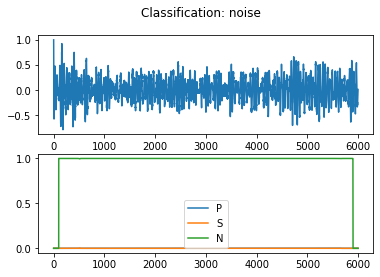

idx: 73
Origin time: 2018-10-29T09:50:47.413060Z
Station: 17
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

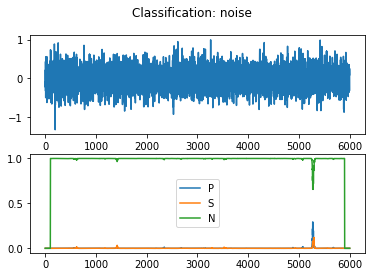

idx: 74
Origin time: 2018-10-29T09:53:26.741347Z
Station: 11.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

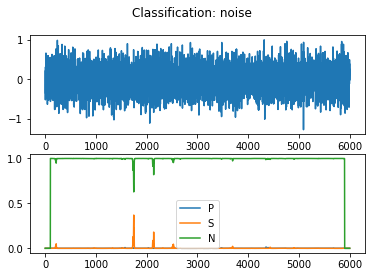

idx: 75
Origin time: 2018-10-29T09:57:32.718267Z
Station: 18.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

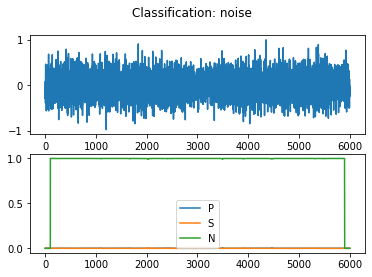

idx: 76
Origin time: 2018-10-29T09:58:51.163098Z
Station: 21
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

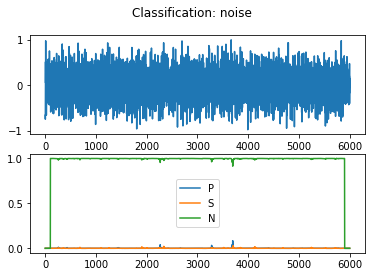

idx: 77
Origin time: 2018-10-29T09:59:23.815310Z
Station: 15
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

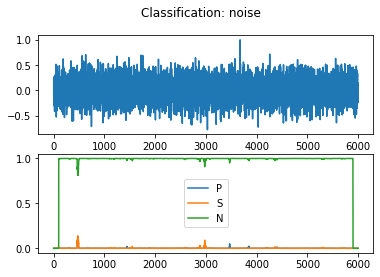

idx: 78
Origin time: 2018-10-29T09:59:29.322156Z
Station: 22.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

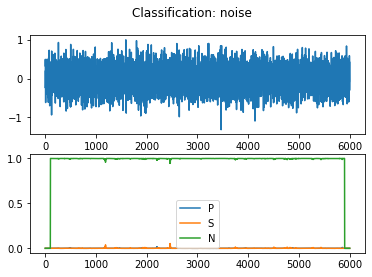

idx: 79
Origin time: 2018-12-11T09:19:17.230001Z
Station: 14.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

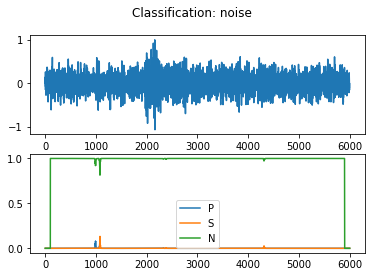

idx: 80
Origin time: 2018-12-11T09:22:27.017658Z
Station: 7
14/14 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

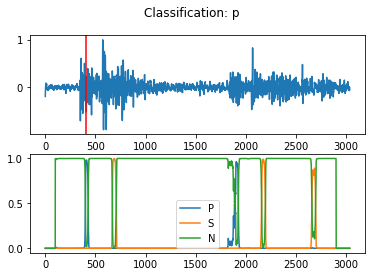

idx: 81
Origin time: 2018-12-11T09:25:19.815001Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

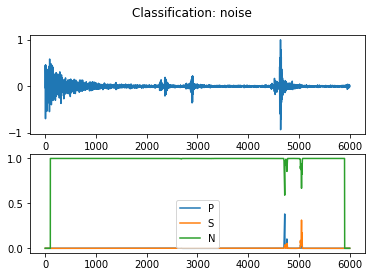

idx: 82
Origin time: 2018-12-11T09:25:53.910501Z
Station: 5.0
24/24 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

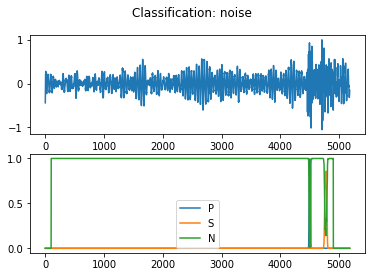

idx: 83
Origin time: 2018-12-11T09:27:05.631999Z
Station: 8.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

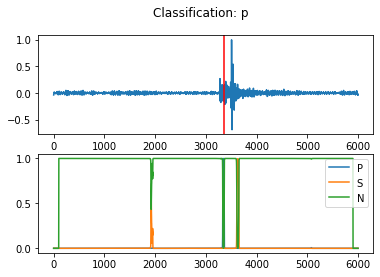

idx: 84
Origin time: 2018-12-11T09:27:24.309002Z
Station: 5.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

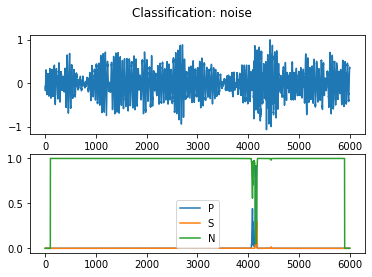

idx: 85
Origin time: 2018-12-11T09:28:26.621000Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

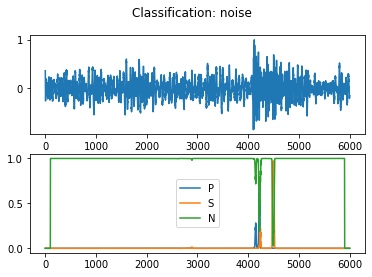

idx: 86
Origin time: 2018-12-11T09:33:00.832002Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

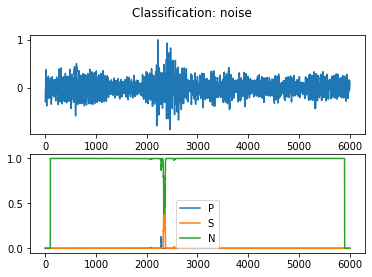

idx: 87
Origin time: 2018-12-11T09:33:39.099497Z
Station: 24.0
15/15 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

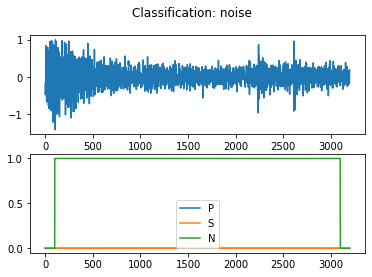

idx: 88
Origin time: 2018-12-11T09:37:43.832116Z
Station: 17
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

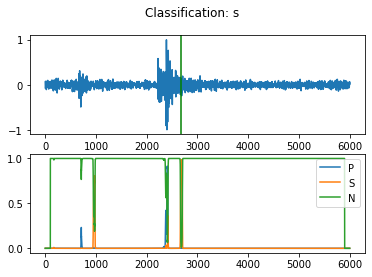

idx: 89
Origin time: 2018-12-11T09:41:20.745110Z
Station: 4.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

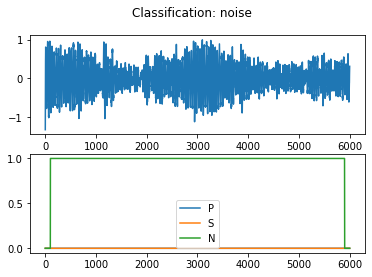

idx: 90
Origin time: 2018-12-11T09:42:18.640003Z
Station: 5.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

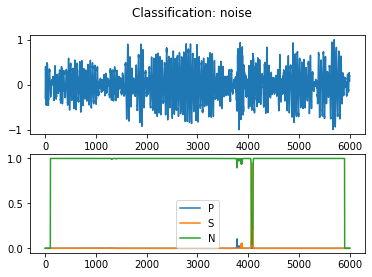

idx: 91
Origin time: 2018-12-11T09:43:36.406276Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

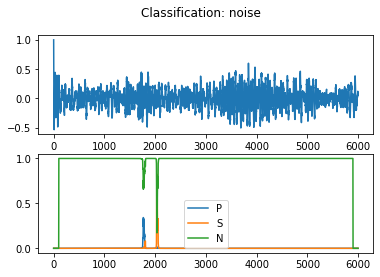

idx: 92
Origin time: 2018-12-11T09:50:31.746501Z
Station: 14
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

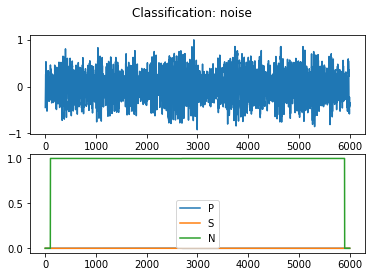

idx: 93
Origin time: 2018-12-11T09:50:47.995503Z
Station: 5.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

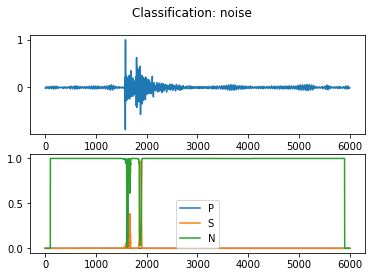

idx: 94
Origin time: 2018-12-11T09:52:44.546497Z
Station: 15.0
29/29 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

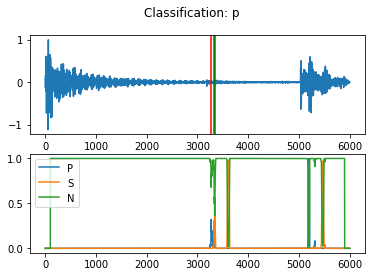

idx: 95
Origin time: 2018-12-11T09:54:55.695501Z
Station: 24
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

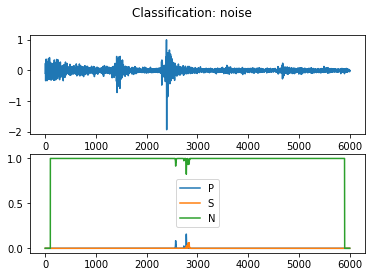

idx: 96
Origin time: 2018-12-11T09:55:21.010502Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

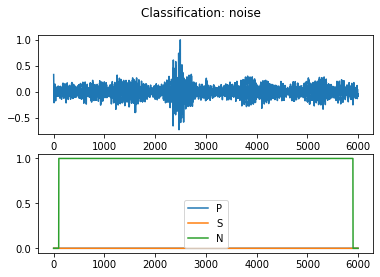

idx: 97
Origin time: 2018-12-11T09:55:56.104001Z
Station: 7.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

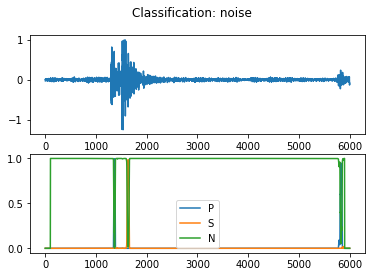

idx: 98
Origin time: 2018-12-11T09:57:26.367947Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

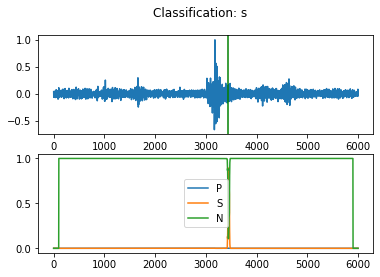

idx: 99
Origin time: 2018-12-11T09:59:10.696001Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

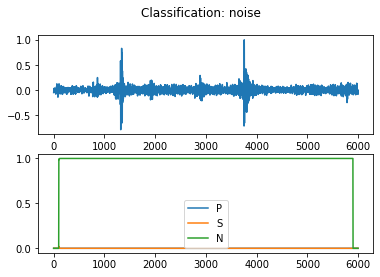

idx: 100
Origin time: 2018-12-11T11:21:13.689824Z
Station: 1.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

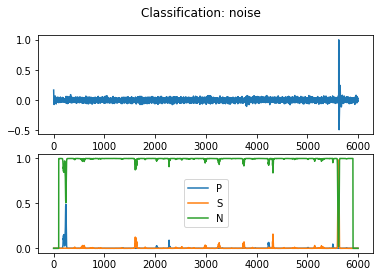

idx: 101
Origin time: 2018-10-29T11:30:37.354076Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

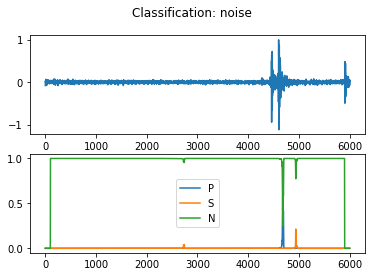

idx: 102
Origin time: 2018-10-29T18:01:10.570937Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

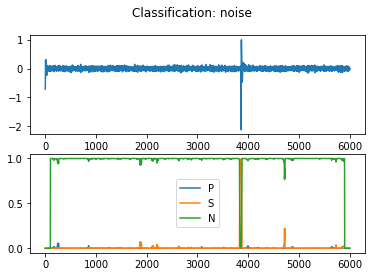

idx: 103
Origin time: 2018-10-26T11:36:56.957398Z
Station: 14.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

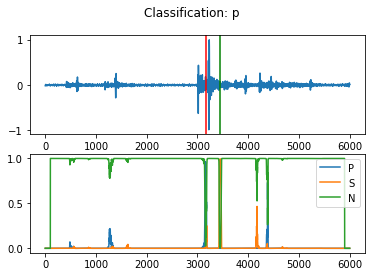

idx: 104
Origin time: 2018-10-27T10:55:23.728788Z
Station: 6.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

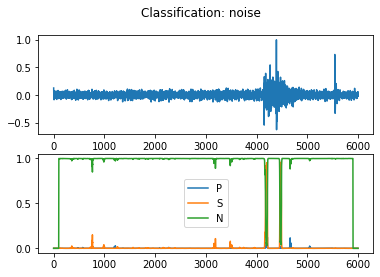

idx: 105
Origin time: 2018-11-04T16:24:04.536114Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

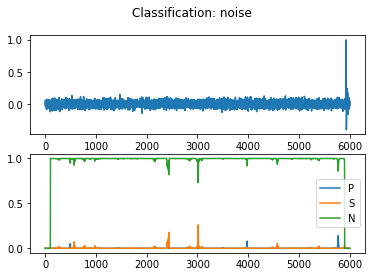

idx: 106
Origin time: 2018-10-24T13:02:27.536215Z
Station: 5.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

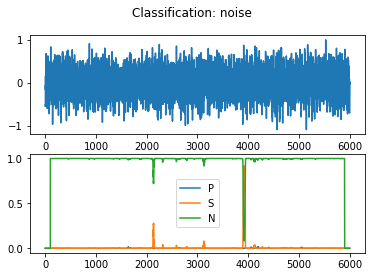

idx: 107
Origin time: 2018-10-25T14:59:25.550128Z
Station: 15.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

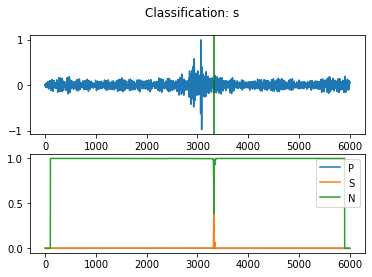

idx: 108
Origin time: 2018-10-23T14:45:30.611670Z
Station: 18.0
20/20 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

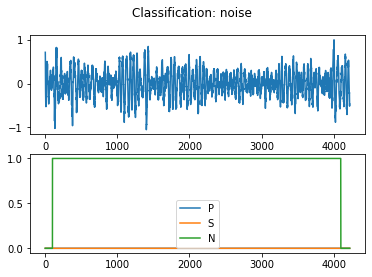

idx: 109
Origin time: 2018-12-14T13:41:03.977303Z
Station: 4.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

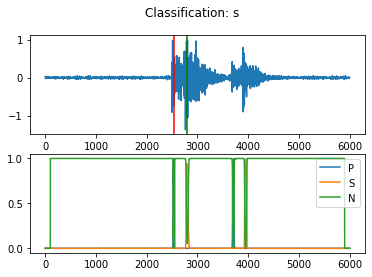

idx: 110
Origin time: 2018-10-25T17:00:32.253072Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

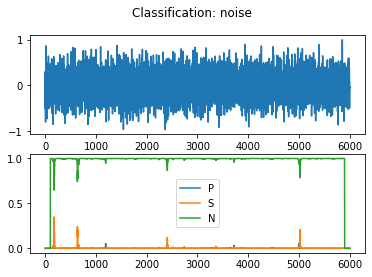

idx: 111
Origin time: 2018-10-26T11:26:43.025376Z
Station: 14.0
14/14 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

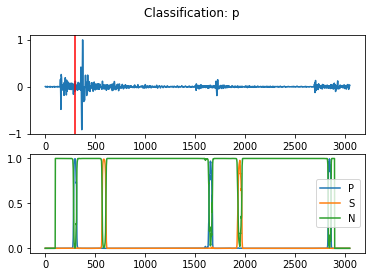

idx: 112
Origin time: 2018-12-11T09:53:29.423274Z
Station: 6.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

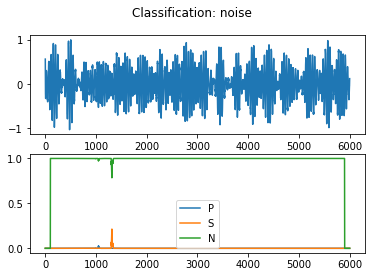

idx: 113
Origin time: 2018-10-29T11:58:32.907222Z
Station: 15.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

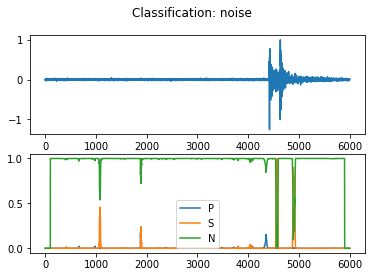

idx: 114
Origin time: 2018-12-11T10:06:42.920583Z
Station: 13.0
14/14 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

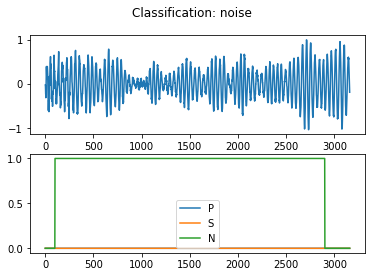

idx: 115
Origin time: 2018-12-14T13:09:49.783000Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

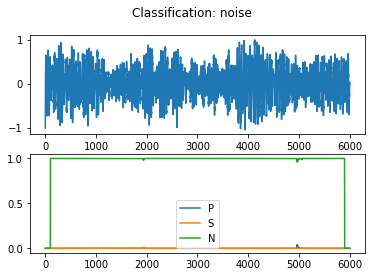

idx: 116
Origin time: 2018-12-11T09:34:59.473777Z
Station: 8.0
18/18 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

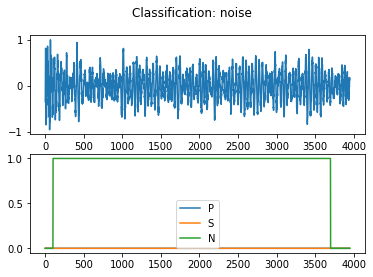

idx: 117
Origin time: 2018-10-26T20:39:21.134610Z
Station: 11.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

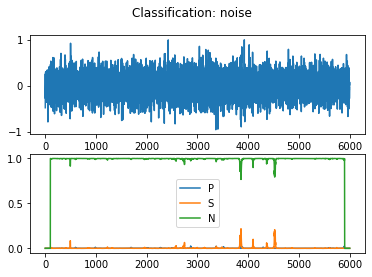

idx: 118
Origin time: 2018-10-24T13:26:24.708736Z
Station: 7.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

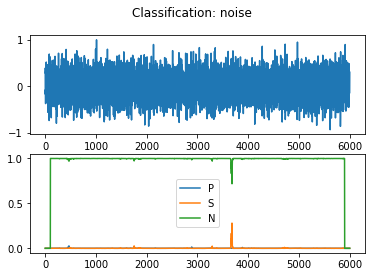

idx: 119
Origin time: 2018-12-14T14:51:54.948504Z
Station: 12.0
23/23 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

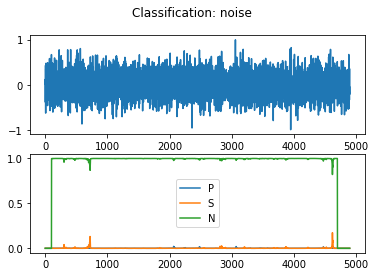

idx: 120
Origin time: 2018-12-13T13:25:15.097558Z
Station: 7.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

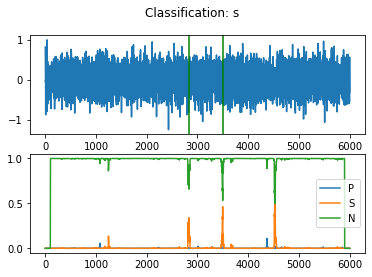

idx: 121
Origin time: 2018-12-08T12:28:20.381485Z
Station: 24.0
27/27 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

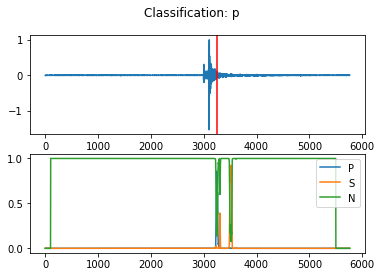

idx: 122
Origin time: 2018-10-25T15:06:02.902139Z
Station: 14.0
14/14 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

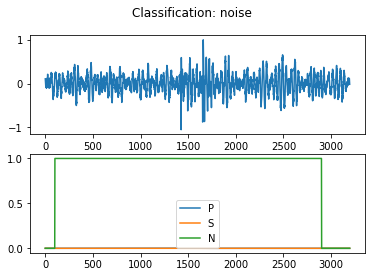

idx: 123
Origin time: 2018-10-24T23:56:11.226137Z
Station: 4.0
26/26 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

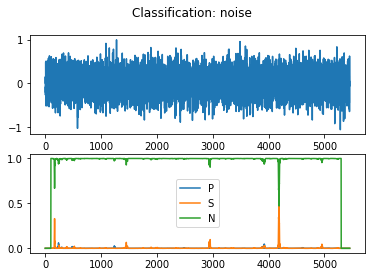

idx: 124
Origin time: 2018-10-25T12:40:54.846937Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

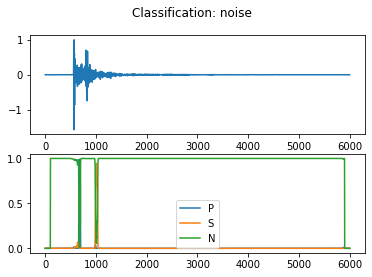

idx: 125
Origin time: 2018-10-18T15:48:51.743427Z
Station: 18.0
21/21 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

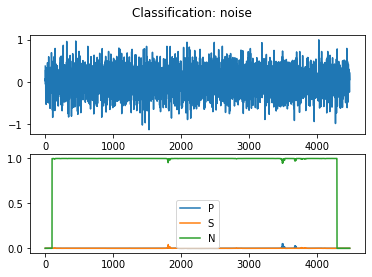

idx: 126
Origin time: 2018-12-11T10:34:33.615646Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

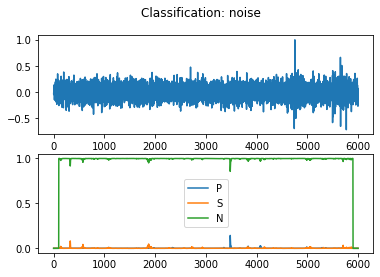

idx: 127
Origin time: 2018-10-29T21:13:56.987642Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

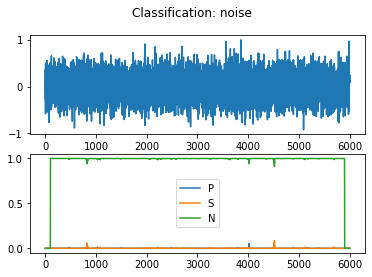

idx: 128
Origin time: 2018-10-30T01:37:35.840873Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

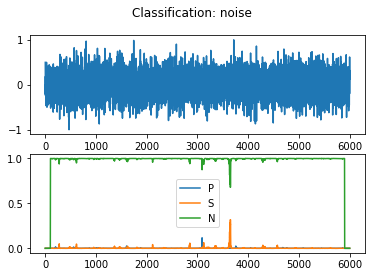

idx: 129
Origin time: 2018-10-27T11:44:29.501597Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

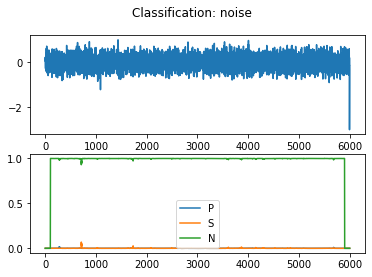

idx: 130
Origin time: 2018-12-11T10:18:44.921932Z
Station: 5.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

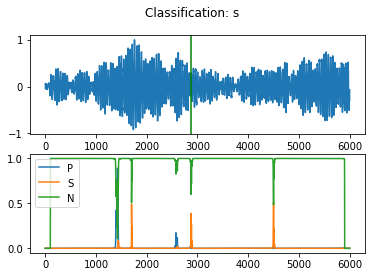

idx: 131
Origin time: 2018-10-20T03:43:59.574986Z
Station: 14.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

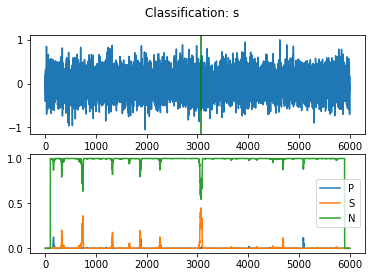

idx: 132
Origin time: 2018-10-29T11:44:40.201886Z
Station: 14.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

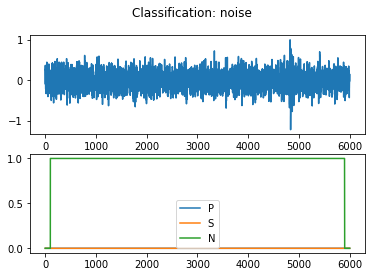

idx: 133
Origin time: 2018-10-19T13:20:46.841106Z
Station: 6.0
15/15 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

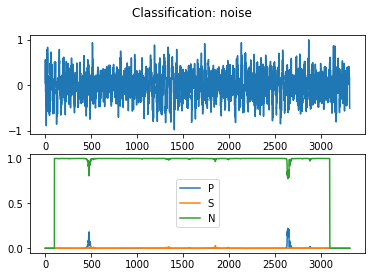

idx: 134
Origin time: 2018-10-25T14:56:26.483150Z
Station: 5.0
19/19 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

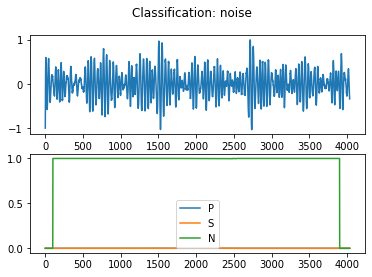

idx: 135
Origin time: 2018-10-26T02:12:59.995291Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

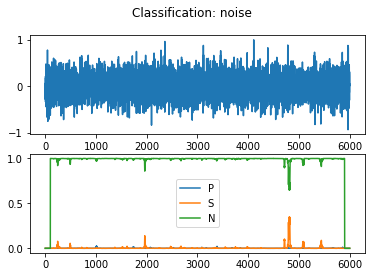

idx: 136
Origin time: 2018-12-10T10:30:56.174963Z
Station: 18.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

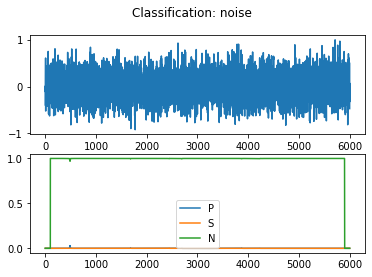

idx: 137
Origin time: 2018-12-11T10:20:25.858469Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

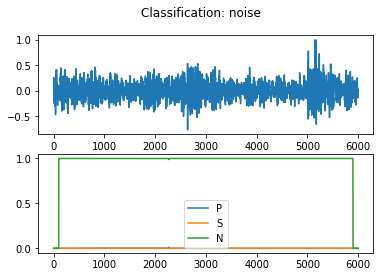

idx: 138
Origin time: 2018-10-27T11:07:15.001670Z
Station: 15.0
14/14 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

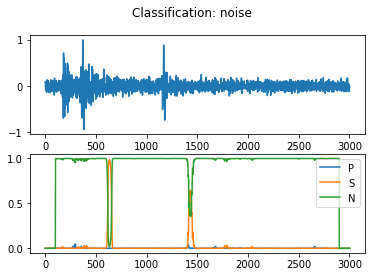

idx: 139
Origin time: 2018-12-14T13:06:35.173000Z
Station: 1.0
25/25 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

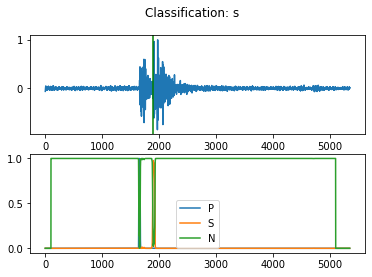

idx: 140
Origin time: 2018-10-26T14:14:02.064392Z
Station: 3.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

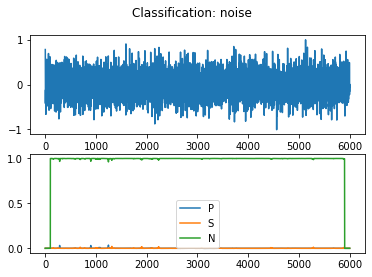

idx: 141
Origin time: 2018-10-26T11:17:01.133776Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

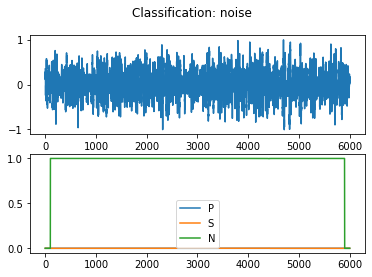

idx: 142
Origin time: 2018-12-14T13:18:28.591496Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

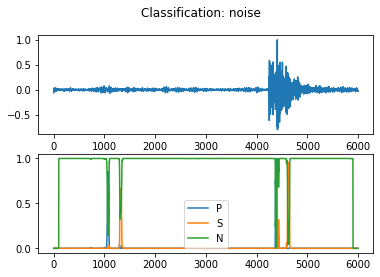

idx: 143
Origin time: 2018-12-11T09:34:01.615759Z
Station: 17.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

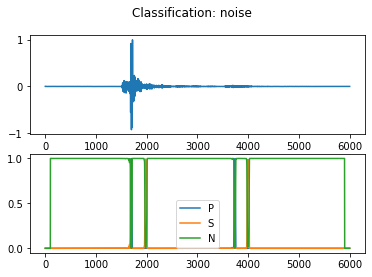

idx: 144
Origin time: 2018-10-25T17:04:11.657001Z
Station: 14.0
20/20 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

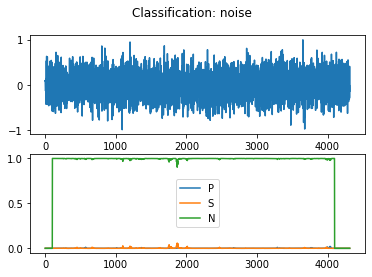

idx: 145
Origin time: 2018-10-24T13:18:58.879000Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

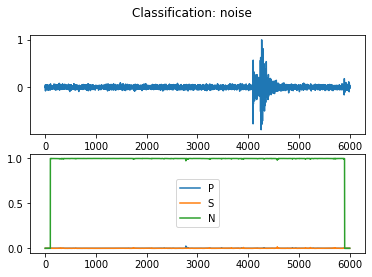

idx: 146
Origin time: 2018-10-29T11:43:27.719477Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

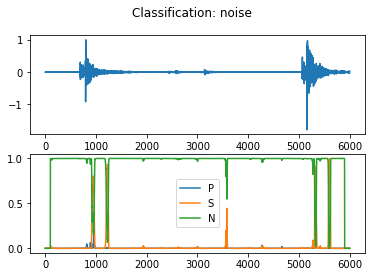

idx: 147
Origin time: 2018-10-25T15:24:26.987999Z
Station: 24.0
14/14 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

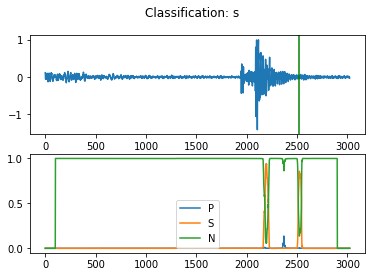

idx: 148
Origin time: 2018-10-24T12:57:12.116501Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

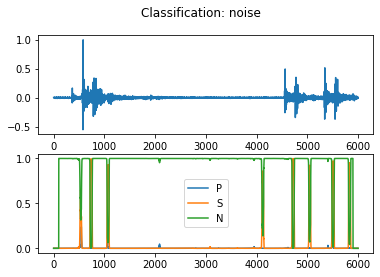

idx: 149
Origin time: 2018-10-25T15:22:57.260499Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

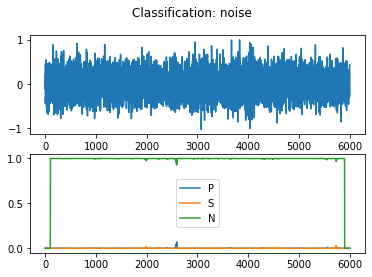

idx: 150
Origin time: 2018-12-15T09:40:05.380999Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

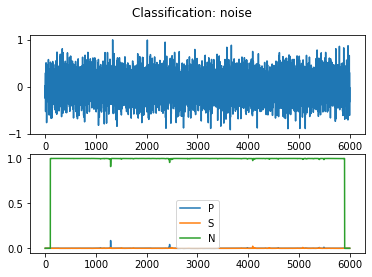

idx: 151
Origin time: 2018-12-14T19:22:43.298000Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

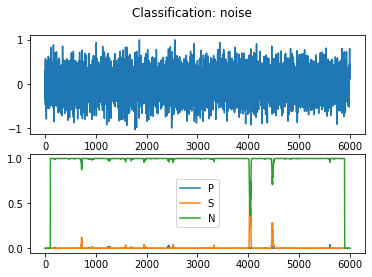

idx: 152
Origin time: 2018-12-15T05:14:03.533001Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

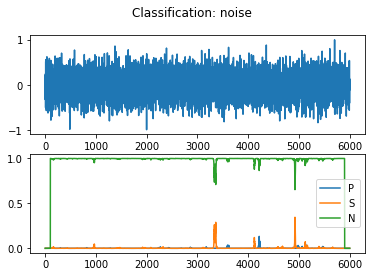

idx: 153
Origin time: 2018-12-14T20:17:13.597500Z
Station: 19.0
18/18 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

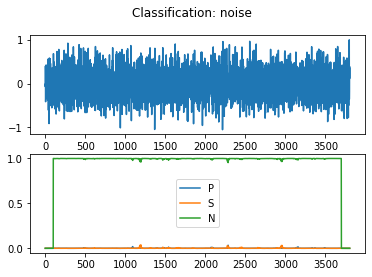

idx: 154
Origin time: 2018-12-18T02:37:04.920323Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

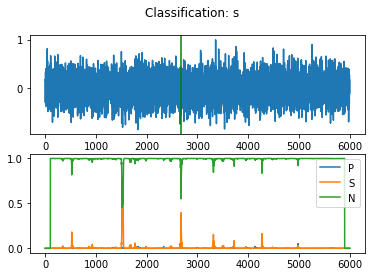

idx: 155
Origin time: 2018-12-18T08:08:31.404378Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

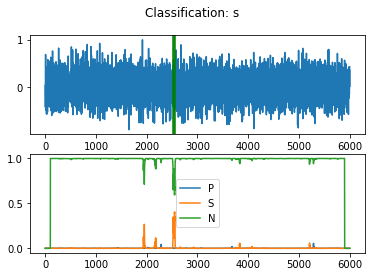

idx: 156
Origin time: 2018-12-14T19:05:17.706270Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

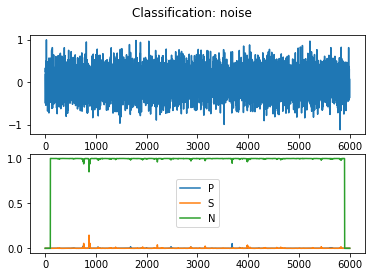

idx: 157
Origin time: 2018-12-17T17:53:13.415503Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

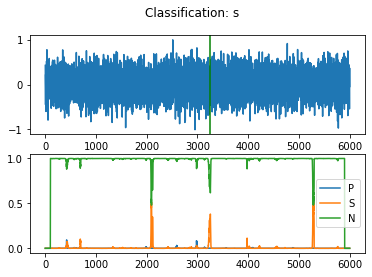

idx: 158
Origin time: 2018-12-18T08:09:09.558826Z
Station: 14.0
18/18 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

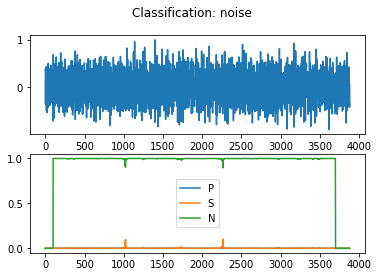

idx: 159
Origin time: 2018-12-18T00:16:29.176860Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

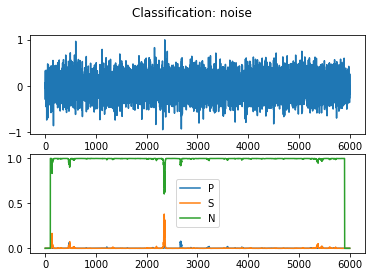

idx: 160
Origin time: 2018-12-15T04:24:15.802999Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

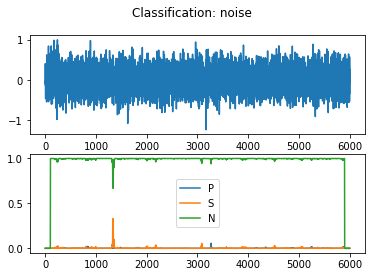

idx: 161
Origin time: 2018-12-17T18:23:05.929902Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

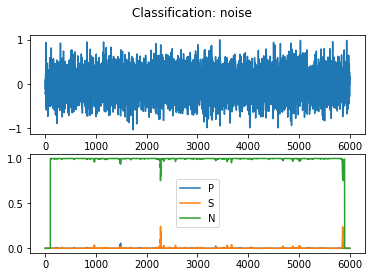

idx: 162
Origin time: 2018-12-17T17:35:38.960749Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

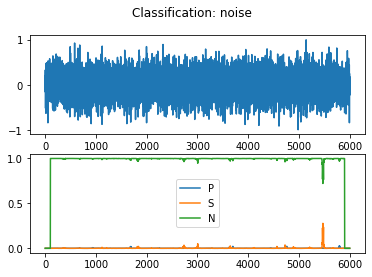

idx: 163
Origin time: 2018-12-14T15:44:58.467000Z
Station: 20.0
18/18 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

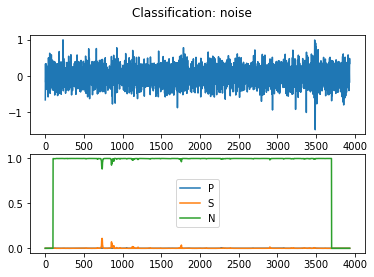

idx: 164
Origin time: 2018-12-17T19:39:33.612497Z
Station: 16.0
17/17 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

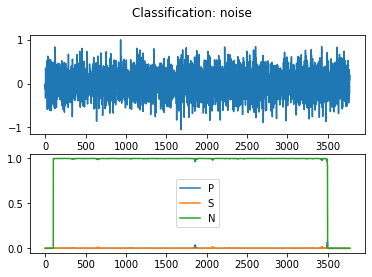

idx: 165
Origin time: 2018-12-18T00:20:41.060939Z
Station: 18.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

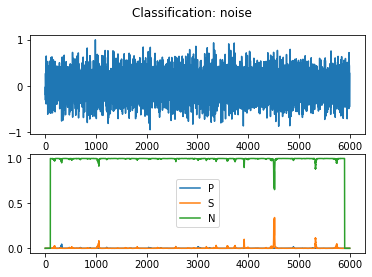

idx: 166
Origin time: 2018-12-18T00:39:01.095666Z
Station: 21.0
23/23 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

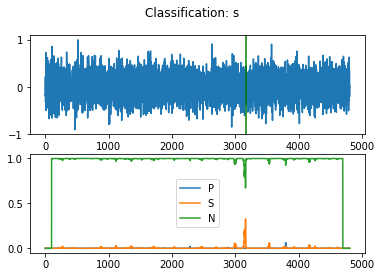

idx: 167
Origin time: 2018-12-15T03:05:15.485441Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

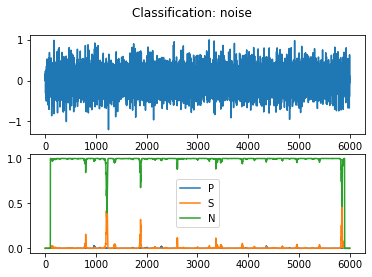

idx: 168
Origin time: 2018-12-18T03:38:53.633431Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

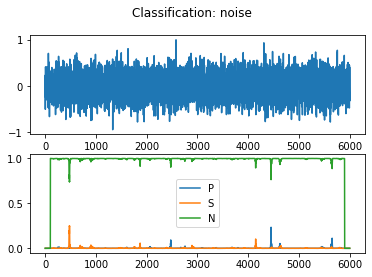

idx: 169
Origin time: 2018-12-18T04:16:01.604612Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

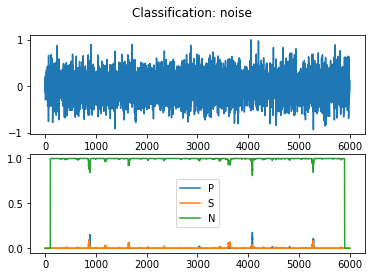

idx: 170
Origin time: 2018-12-18T03:49:21.433724Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

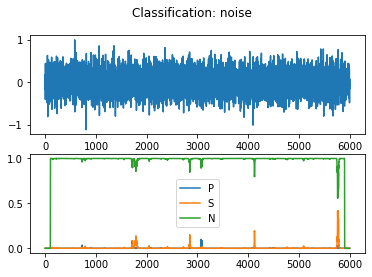

idx: 171
Origin time: 2018-12-14T20:53:05.808002Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

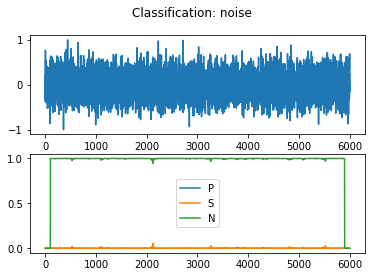

idx: 172
Origin time: 2018-12-17T16:25:29.783592Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

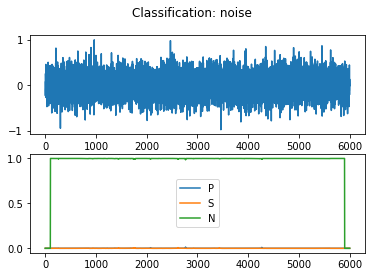

idx: 173
Origin time: 2018-12-14T14:59:44.866501Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

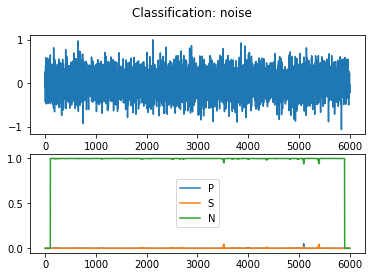

idx: 174
Origin time: 2018-12-17T22:22:53.176300Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

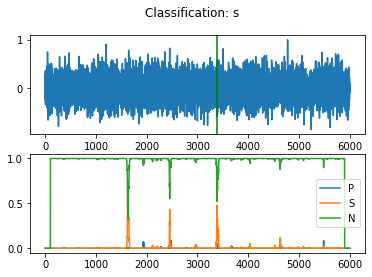

idx: 175
Origin time: 2018-12-17T23:33:55.632907Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

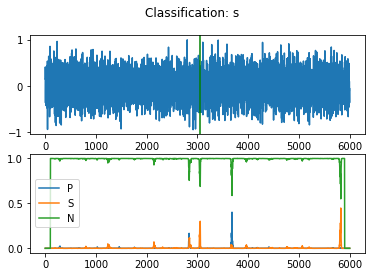

idx: 176
Origin time: 2018-12-18T01:05:36.723657Z
Station: 17.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

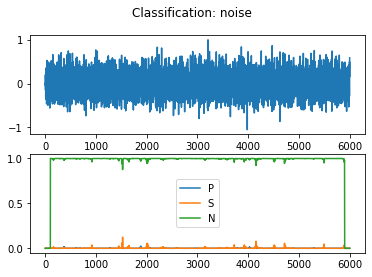

idx: 177
Origin time: 2018-12-17T20:33:51.832724Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

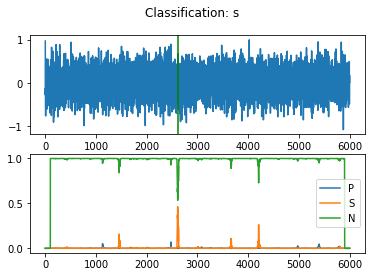

idx: 178
Origin time: 2018-12-14T19:41:41.565502Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

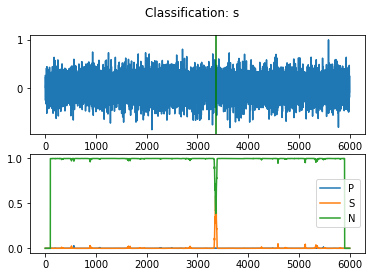

idx: 179
Origin time: 2018-12-18T05:43:57.300138Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

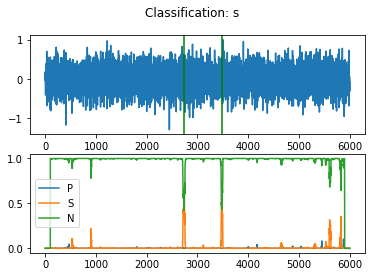

idx: 180
Origin time: 2018-12-14T16:34:57.666000Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

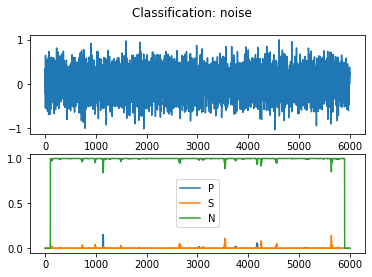

idx: 181
Origin time: 2018-12-18T02:14:25.814875Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

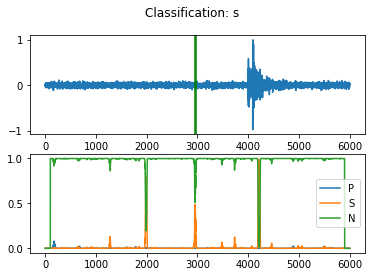

idx: 182
Origin time: 2018-12-17T23:51:15.367954Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

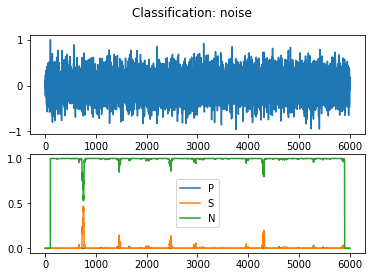

idx: 183
Origin time: 2018-12-18T08:22:55.926358Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

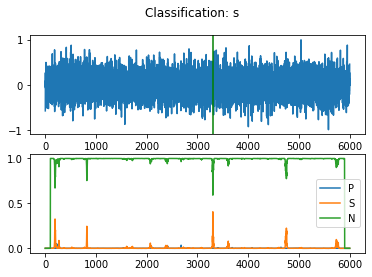

idx: 184
Origin time: 2018-12-14T17:22:40.540499Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

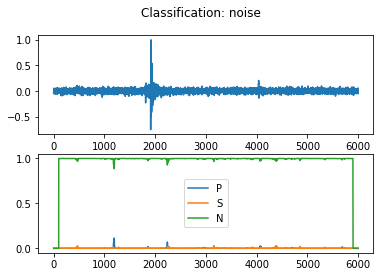

idx: 185
Origin time: 2018-12-15T03:03:10.531500Z
Station: 20.0
19/19 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

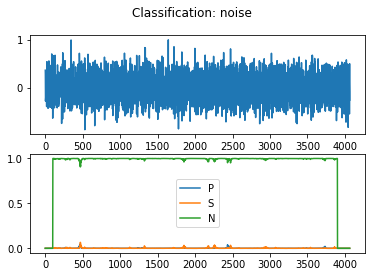

idx: 186
Origin time: 2018-12-17T18:35:56.740838Z
Station: 23.0
29/29 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

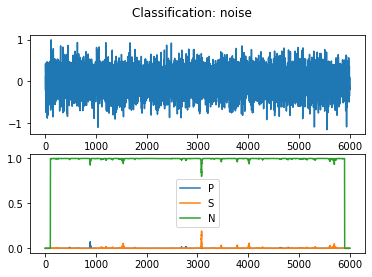

idx: 187
Origin time: 2018-12-15T04:53:39.408500Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

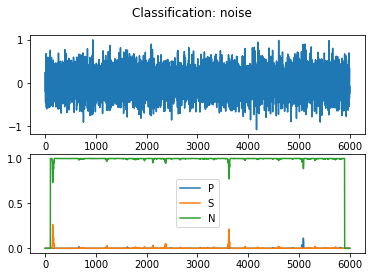

idx: 188
Origin time: 2018-12-17T19:46:29.421621Z
Station: 17.0
19/19 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

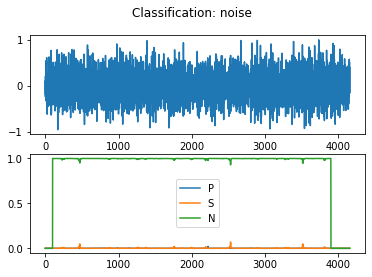

idx: 189
Origin time: 2018-12-18T01:06:03.209945Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

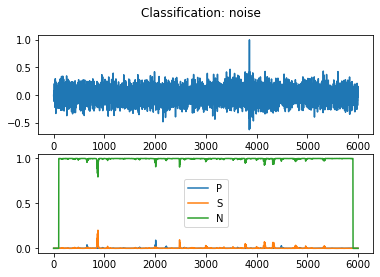

idx: 190
Origin time: 2018-12-14T15:03:33.396500Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

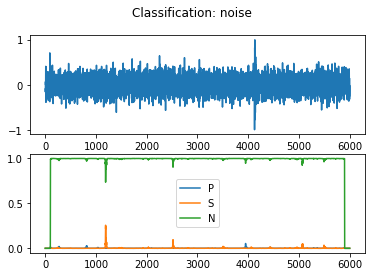

idx: 191
Origin time: 2018-12-18T04:02:53.189356Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

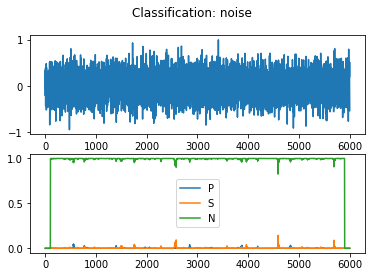

idx: 192
Origin time: 2018-12-14T17:35:09.780328Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

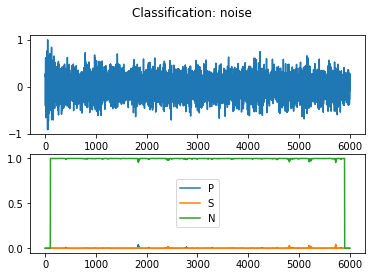

idx: 193
Origin time: 2018-12-17T21:07:03.273411Z
Station: 23.0
26/26 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

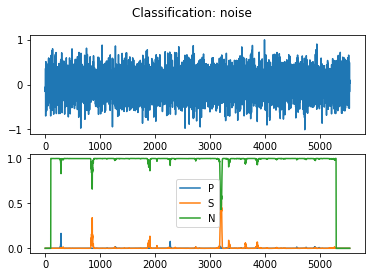

idx: 194
Origin time: 2018-12-14T20:25:13.901501Z
Station: 20.0
14/14 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

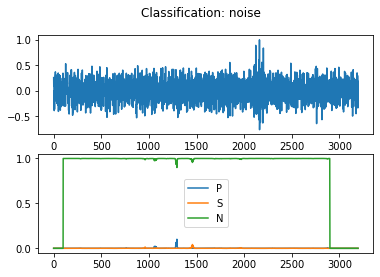

idx: 195
Origin time: 2018-12-18T05:28:25.031603Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

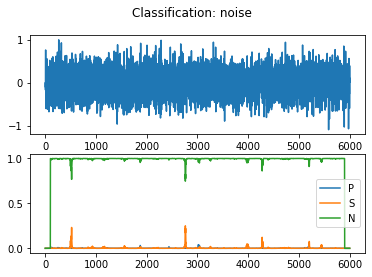

idx: 196
Origin time: 2018-12-15T04:40:30.429846Z
Station: 21.0
18/18 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

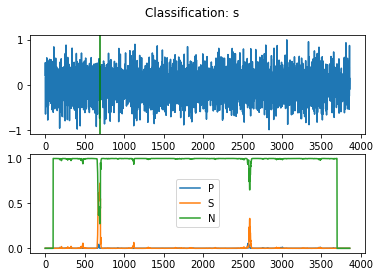

idx: 197
Origin time: 2018-12-14T15:59:45.792001Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

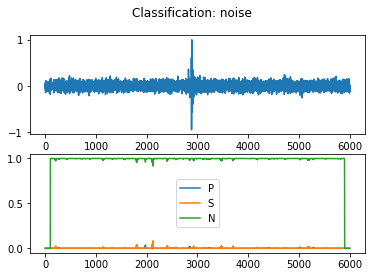

idx: 198
Origin time: 2018-12-17T19:05:24.908105Z
Station: 17.0
24/24 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

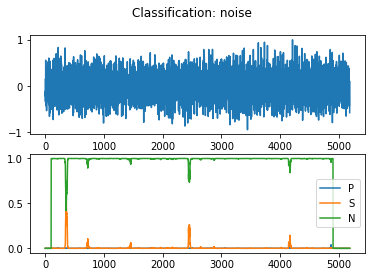

idx: 199
Origin time: 2018-12-15T14:18:24.858000Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

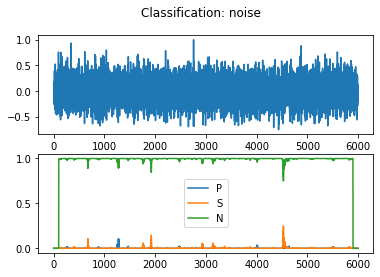

idx: 200
Origin time: 2018-10-16T13:50:00.824497Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

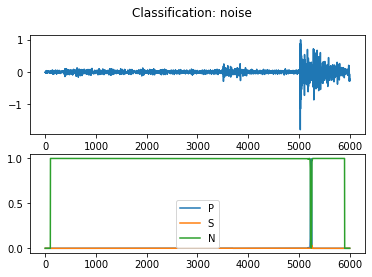

idx: 201
Origin time: 2018-10-18T14:36:54.081577Z
Station: 1.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

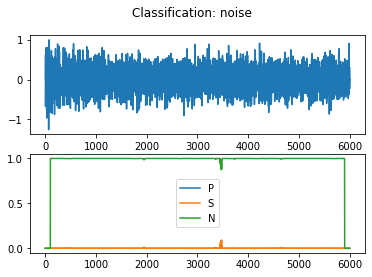

idx: 202
Origin time: 2018-10-18T15:28:08.172497Z
Station: 22.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

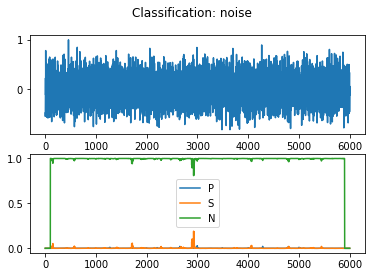

idx: 203
Origin time: 2018-10-22T11:50:56.058499Z
Station: 7.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

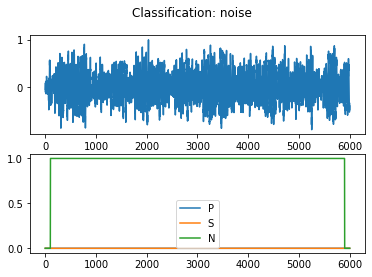

idx: 204
Origin time: 2018-10-24T13:39:30.415000Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

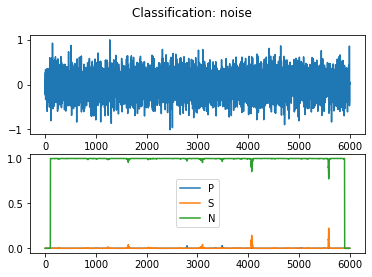

idx: 205
Origin time: 2018-10-24T13:50:28.123500Z
Station: 8.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

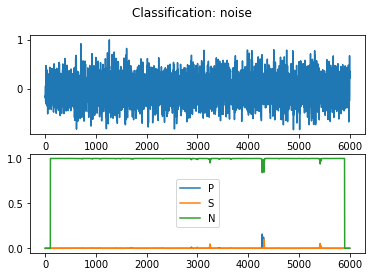

idx: 206
Origin time: 2018-10-25T11:35:06.813999Z
Station: 8.0
15/15 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

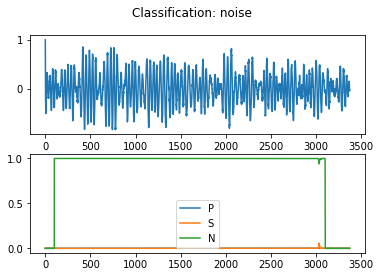

idx: 207
Origin time: 2018-10-25T12:06:03.809500Z
Station: 11.0
22/22 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

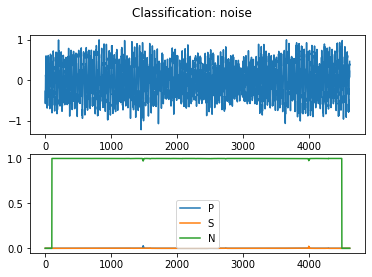

idx: 208
Origin time: 2018-10-25T13:06:02.177500Z
Station: 13.0
22/22 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

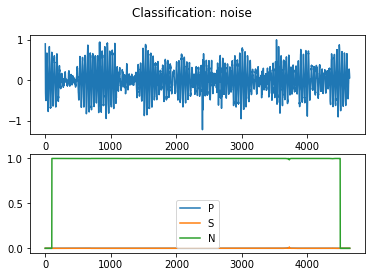

idx: 209
Origin time: 2018-10-25T13:24:55.688499Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

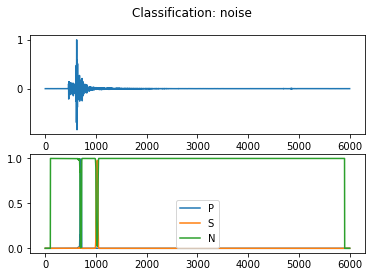

idx: 210
Origin time: 2018-10-25T14:51:06.781501Z
Station: 20.0
16/16 [==============================] - 0s 2ms/step


<Figure size 432x288 with 0 Axes>

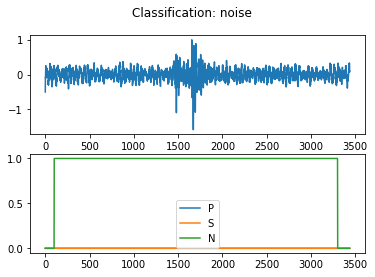

idx: 211
Origin time: 2018-10-25T15:21:00.353500Z
Station: 2.0
27/27 [==============================] - 0s 2ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

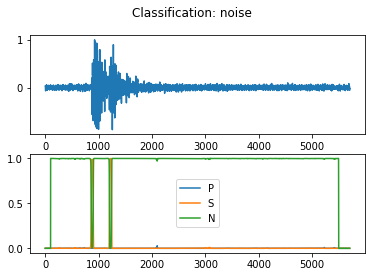

idx: 212
Origin time: 2018-10-25T15:29:11.817499Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

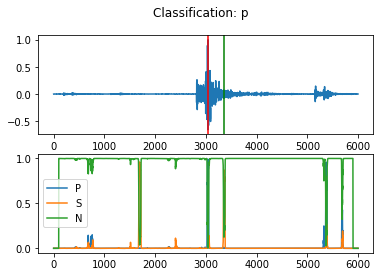

idx: 213
Origin time: 2018-10-26T08:41:31.695720Z
Station: 7.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

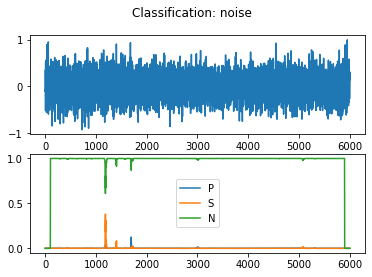

idx: 214
Origin time: 2018-10-26T11:10:36.557499Z
Station: 15.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

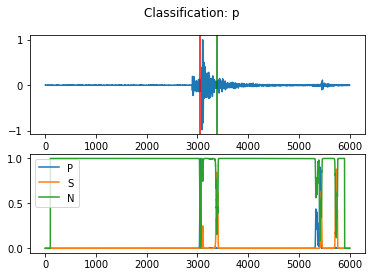

idx: 215
Origin time: 2018-10-27T11:03:23.426501Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

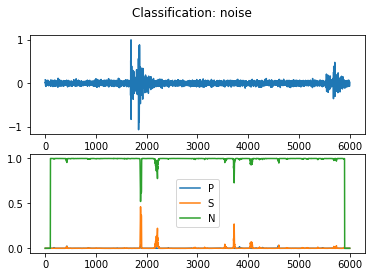

idx: 216
Origin time: 2018-10-27T11:07:25.788499Z
Station: 19.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

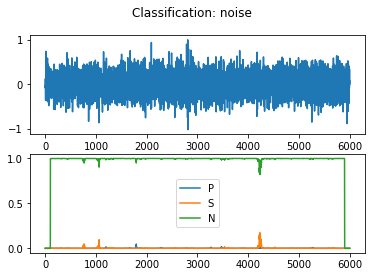

idx: 217
Origin time: 2018-10-30T14:44:11.823515Z
Station: 10.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

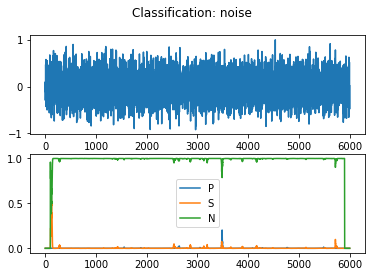

idx: 218
Origin time: 2018-10-31T08:22:51.389743Z
Station: 1.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

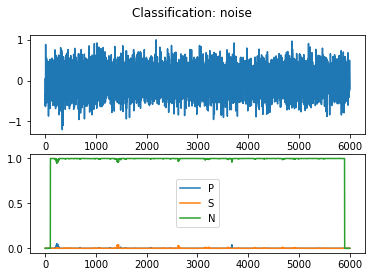

idx: 219
Origin time: 2018-10-31T10:41:18.284942Z
Station: 6.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

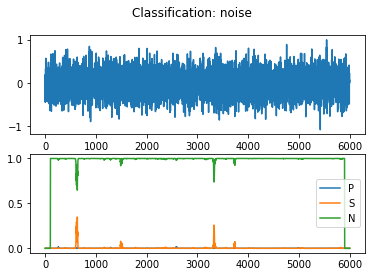

idx: 220
Origin time: 2018-12-09T21:15:02.914503Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

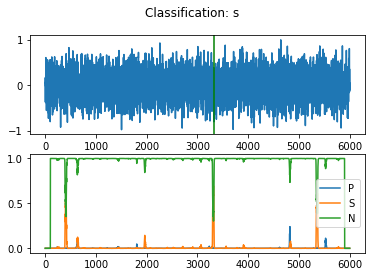

idx: 221
Origin time: 2018-12-10T12:38:45.835501Z
Station: 12.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

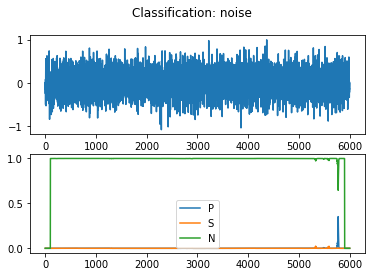

idx: 222
Origin time: 2018-12-11T10:02:16.506499Z
Station: 9.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

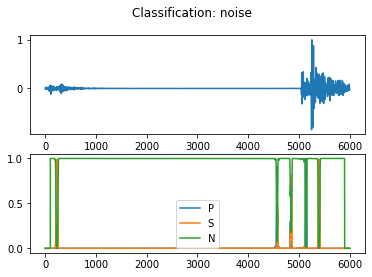

idx: 223
Origin time: 2018-12-14T13:08:07.714999Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

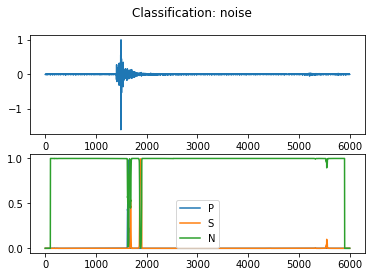

idx: 224
Origin time: 2018-12-14T14:29:26.360495Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

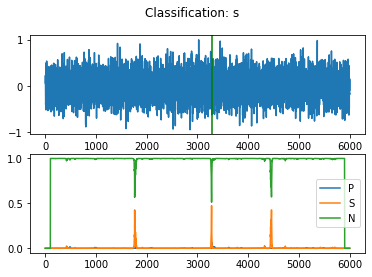

idx: 225
Origin time: 2018-10-16T14:19:04.527500Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

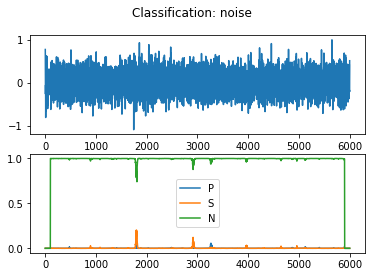

idx: 226
Origin time: 2018-10-16T15:09:01.566004Z
Station: 4.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

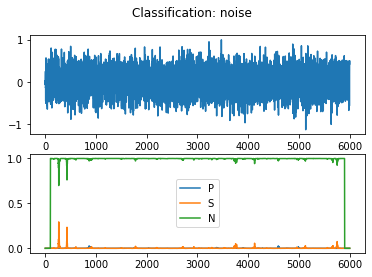

idx: 227
Origin time: 2018-10-17T17:42:00.022497Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

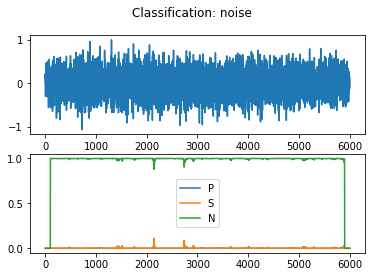

idx: 228
Origin time: 2018-10-17T18:08:07.517003Z
Station: 21.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

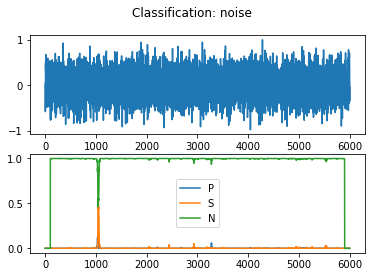

idx: 229
Origin time: 2018-10-18T14:33:00.017499Z
Station: 17.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

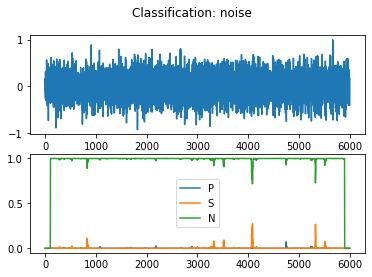

idx: 230
Origin time: 2018-10-18T14:51:25.291075Z
Station: 2.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

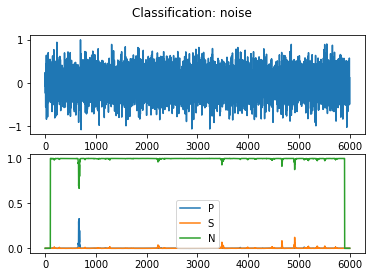

idx: 231
Origin time: 2018-10-19T12:51:43.176329Z
Station: 24.0
15/15 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

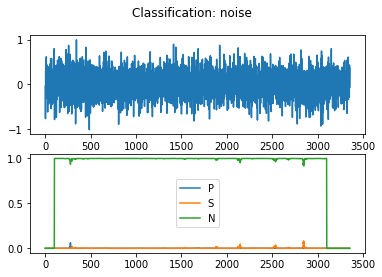

idx: 232
Origin time: 2018-10-22T22:16:26.187965Z
Station: 10.0
15/15 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

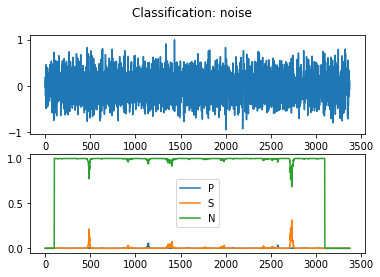

idx: 233
Origin time: 2018-10-25T11:39:15.022878Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

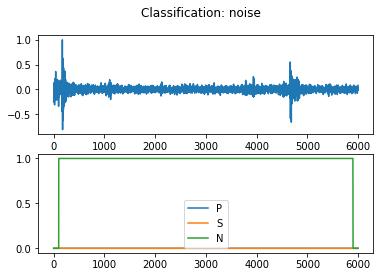

idx: 234
Origin time: 2018-10-25T12:17:15.683881Z
Station: 17.0
20/20 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

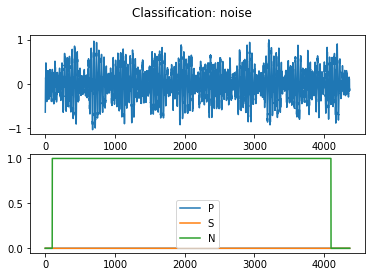

idx: 235
Origin time: 2018-10-25T12:41:29.403562Z
Station: 14.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

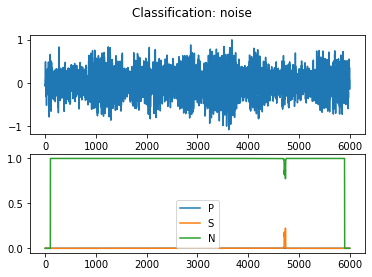

idx: 236
Origin time: 2018-10-25T15:07:13.805209Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

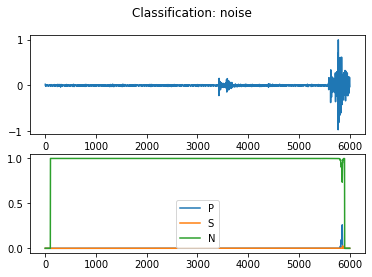

idx: 237
Origin time: 2018-10-25T17:08:33.172500Z
Station: 6.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

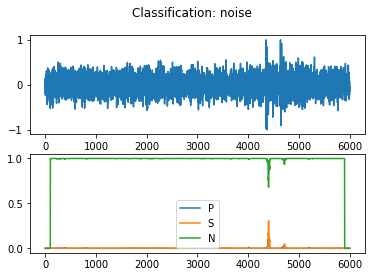

idx: 238
Origin time: 2018-10-26T11:33:23.299501Z
Station: 22.0
17/17 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

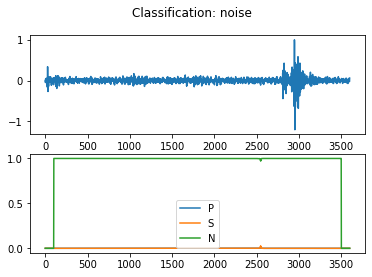

idx: 239
Origin time: 2018-10-27T10:38:19.212500Z
Station: 17.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

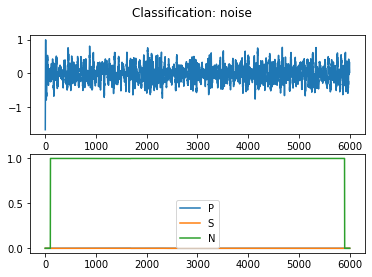

idx: 240
Origin time: 2018-10-27T10:58:58.104500Z
Station: 2.0
22/22 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

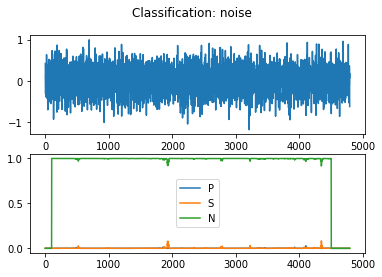

idx: 241
Origin time: 2018-10-27T14:33:31.600499Z
Station: 16.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

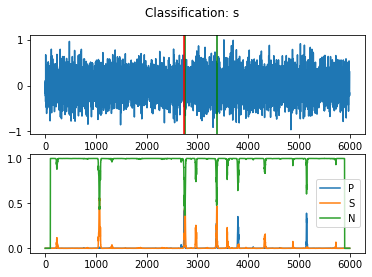

idx: 242
Origin time: 2018-11-02T17:45:59.884999Z
Station: 8.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

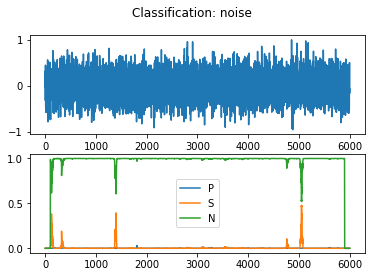

idx: 243
Origin time: 2018-12-11T09:21:25.517003Z
Station: 8.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

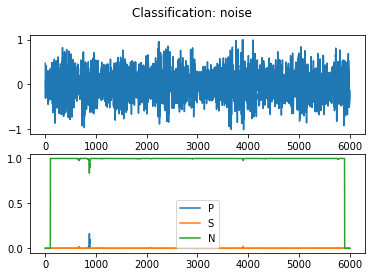

idx: 244
Origin time: 2018-12-11T09:32:02.381499Z
Station: 22.0
20/20 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:114: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

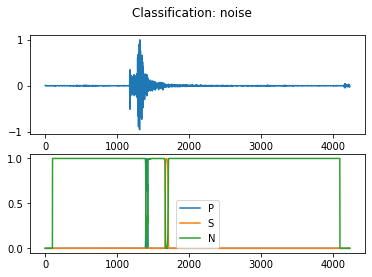

idx: 245
Origin time: 2018-12-11T10:29:16.927503Z
Station: 23.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

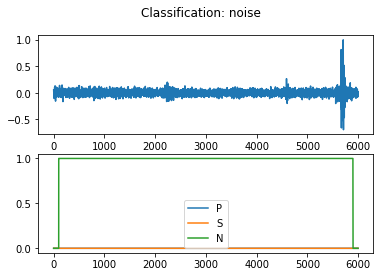

idx: 246
Origin time: 2018-12-13T11:19:17.937003Z
Station: 18.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

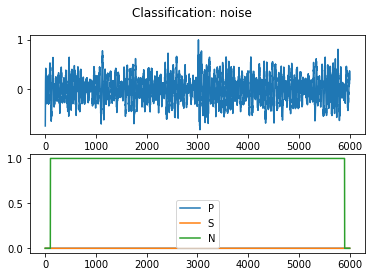

idx: 247
Origin time: 2018-12-14T20:12:29.600999Z
Station: 24.0
29/29 [==============================] - 0s 1ms/step


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:137: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<Figure size 432x288 with 0 Axes>

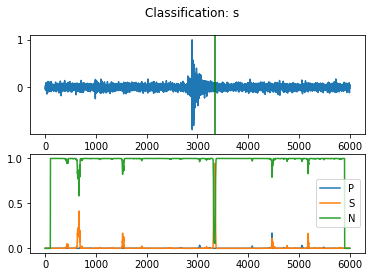

idx: 248
Origin time: 2018-12-17T11:31:04.611688Z
Station: 13.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

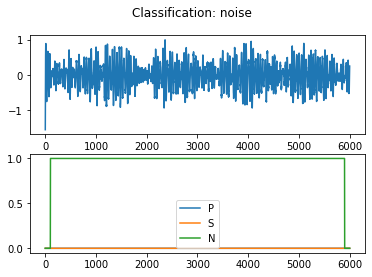

idx: 249
Origin time: 2018-12-17T12:07:48.136187Z
Station: 20.0
29/29 [==============================] - 0s 1ms/step


<Figure size 432x288 with 0 Axes>

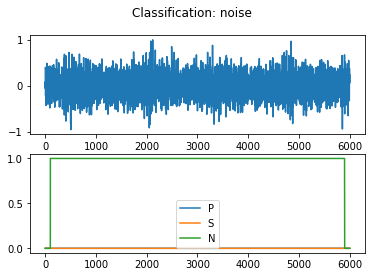

All done with N.


<Figure size 432x288 with 0 Axes>

In [16]:
# for N_df

results_N = pd.DataFrame(index= np.arange(0,len(N_df)),columns=['time', 'sta', 'pha', 'prob'])

for indx in np.arange(0, len(N_df)):
# for indx in np.arange(0, 1):
    # Dataframe to store picks from trigger
    df = pd.DataFrame(columns=['time', 'sta', 'pha', 'prob'])

    # saving 3s (6000 sample) window of phases
    evnt= N_df.iloc[indx]

    print('idx:', indx)
    print('Origin time:', evnt['starttime'])
    print('Station:', evnt['sta'])

    # select event origin time to mark start of event cut
    starttime = evnt['starttime']

    # Folders of events are labelled by their date, use this to find correct path to folder
#     rootpath = root + 'pre-multijob/data/'
    rootpath = '../../../../../Volumes/CindyPNR/'
    dayfolder = starttime.strftime('%y%m%d')
    daypath = os.path.join(rootpath,dayfolder)

    # Get a list of file names from the folder
    f = []
    for (_, _, filenames) in os.walk(daypath):
        f.extend(filenames)

    # File names are labelled by the starttime of the file
    # get a list of all filenames with a starttime before the event
    f_before = filter(lambda s: UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S") < starttime, f)


    # Find the file name and path of the last file starting before the event (should contain event)
    file = min(f_before, key=lambda s: abs(starttime - UTCDateTime.strptime(s.split('.')[0], "%Y%m%d%H%M%S")))
    filepath=os.path.join(daypath,file)

    ##################################################
# cut the data to 6000 samples (3 seconds)
    # cutting 6000 sample trace
    st_ENZ = readPNR_ENZ(filepath, unpack_trace_headers=True)
    stcut_ENZ =st_ENZ.slice(starttime=evnt['starttime']-1.5,endtime=evnt['starttime']+1.5)
    # detrend
    stcut_ENZ.detrend(type='linear')
    # filtered
    stcut_ENZ.filter("highpass",freq=50.0)
    stcut_ENZ.select(station= N_df['sta_str'].iloc[indx])

    ##################################################

    # Expand overlapping windows using sliding_window function
    sliding_E = sliding_window(stcut_ENZ[0].data, 400, stepsize=shift_size) # Slide window across first component
    tr_win = np.zeros((sliding_E.shape[0], 400, 3)) # 3D array (of zeros)
    tr_win[:,:,0] = sliding_E # Add to 3D array
    sliding_E = None # clear some memory

    sliding_N = sliding_window(stcut_ENZ[1].data, 400, stepsize=shift_size) # Slide window across second component
    tr_win[:,:,1] = sliding_N # Add to 3D array
    sliding_N = None # clear some memory

    sliding_Z = sliding_window(stcut_ENZ[2].data, 400, stepsize=shift_size) # Slide window across third component
    tr_win[:,:,2] = sliding_Z # Add to 3D array
    sliding_Z = None # clear some memory

    tr_win = signal.detrend(tr_win, axis=1) # Detrend 
    tr_win = tr_win / np.max(np.abs(tr_win), axis=(1,2))[:,None,None] # Normalize between 0 and 1 (divide by max across 3 components for each window)
        
    # Model prediction step...
    ts = model.predict(tr_win, verbose=True, batch_size=batch_size)
    
    # Merge overlapping predictions:
    n_steps_per_win = 400/shift_size # No. of steps per window (i.e. how many overlapping windows)
    class_trace = np.zeros((len(stcut_ENZ[0].data), int(3))) # Create prediction traces to be same size as input data
    for i in np.arange(0, ts.shape[0]): # For each window
        class_trace[((i * shift_size) + 100):((i * shift_size) + 300), :] += ts[i, 100:300, :] # Keep middle 200 predictions

    # Interpolate predictions so same sample rate as signal:
#     ts_times = np.arange(0, a.shape[1])
    # class_trace = np.zeros((a.shape[1], int(3))) # Create prediction traces to be same size as input data
    # for i in np.arange(0, 3): # For each class
    #     class_trace[:, i] = np.interp(ts_times, np.arange(199, a.shape[1]-200, n_shift), ts[:,i]) # Interpolate prediction values (ts)
    
    # Extract probability trace for each (write to a file for future analysis?)
    prob_P = ts[:,0]
    prob_S = ts[:,1]
    prob_N = ts[:,2]

   # Use obspy trigger to find predictions above threshold (i.e. p_thresh and s_thresh)
    # P-wave picks (trigger):
    trigs = trigger_onset(class_trace[:,0], 0.3, trig_off) # Look for triggers (prediction trace exceeding p_thresh)
    p_picks = []
    p_probs = []
    
    for trig in trigs:
        if trig[1] == trig[0]:
            continue # If trigger on and off times are the same then ignore
        pick = np.argmax(class_trace[trig[0]:trig[1], 0]) + trig[0] # Use argmax between trigger on and off times as pick time
        stamp_pick = stcut_ENZ[0].stats.starttime + (pick * stcut_ENZ[0].stats.delta) # Pick time as UTCDateTime
        p_picks.append(stamp_pick) # Append time to list of P pick times
        p_probs.append(class_trace[pick, 0]) # Append prob to list of P pick probabilities
    
    
    # Add picks to df for this day            
    if len(p_picks) > 0:
        df_add = pd.DataFrame(p_picks, columns=['time'])
        df_add['pha'] = 'p'
        if (int(N_df['sta_str'].iloc[indx])+1) > 9:
            df_add['sta'] = "0" + str(int(N_df['sta_str'].iloc[indx]))
        else:
            df_add['sta'] = "00" + str(int(N_df['sta_str'].iloc[indx]))
        df_add['prob'] = p_probs
        df = pd.concat([df, df_add])
        
    # Repeat above for S-wave picks and s_thresh:
    trigs = trigger_onset(class_trace[:,1], s_thresh, trig_off)
    s_picks = []
    s_probs = []
    for trig in trigs:
        if trig[1] == trig[0]:
            continue
        pick = np.argmax(class_trace[trig[0]:trig[1], 1]) + trig[0]
        stamp_pick = stcut_ENZ[0].stats.starttime + (pick * stcut_ENZ[0].stats.delta)
        s_picks.append(stamp_pick)
        s_probs.append(class_trace[pick, 1])
        
    # Add picks to df for this day
    if len(s_picks) > 0:
        df_add = pd.DataFrame(s_picks, columns=['time'])
        df_add['pha'] = 's'
        if (int(N_df['sta_str'].iloc[indx])+1) > 9:
            df_add['sta'] = "0" + str(int(N_df['sta_str'].iloc[indx]))
        else:
            df_add['sta'] = "00" + str(int(N_df['sta_str'].iloc[indx]))
        df_add['prob'] = s_probs
        df = pd.concat([df, df_add])

    df = df.sort_values(by='prob',ascending=False).reset_index(drop=True)
    
    # get the picks that are +- 0.5 second (200 samples) of the phase time
    df_final = df[df['time'] >= N_df['starttime'].iloc[indx] -0.25]
    df_final = df_final[df_final['time'] <= N_df['starttime'].iloc[indx] +0.25]

#     then get the highest probability for that time window
    df_final = df_final.sort_values(by='prob',ascending=False).reset_index(drop=True)
    
    fig, axs = plt.subplots(2)
    
# if p exists in the window, then it is p    
#     if len(df_final) > 0:
#         p_param = 0
#         for dfi in np.arange(0,len(df_final)):
#             if df['pha'].iloc[dfi] == 'p':
#                 p_param = 1
#             else:
#                 pass
#         if p_param == 1:
#             fig.suptitle('Classification: p')
#         else:
#             fig.suptitle('Classification: s')
#     else:
#         fig.suptitle('Classification: noise')

    # get the one nearest to the middle of the window
    if len(df_final) > 0:
        timediff = []
        for dfii in np.arange(0,len(df_final)):
            timediff1 = abs((stcut_ENZ[0].stats.starttime + 1.5) - df_final['time'].iloc[dfii])
            timediff.append(timediff1)
            
        fig.suptitle('Classification: '+ df_final['pha'].iloc[np.argmin(timediff)])
    else:
        fig.suptitle('Classification: noise')
        
        
    axs[0].plot(stcut_ENZ[(int(N_df['sta_str'].iloc[indx]) - 1)*3 + 2].data/max(stcut_ENZ[(int(N_df['sta_str'].iloc[indx]) - 1)*3 + 2].data))
    if len(df_final) > 0:
        df_final.to_csv('./Model_results/UGPD/N/df_final_'+str(indx)+'.csv')
        for thepicks in np.arange(0,len(df_final)):
            if df_final['pha'].iloc[thepicks] == 'p':
                axs[0].axvline(x=(abs(df_final['time'].iloc[thepicks] - stcut_ENZ[0].stats.starttime) / 0.0005),color='r')
            else:
                axs[0].axvline(x=(abs(df_final['time'].iloc[thepicks] - stcut_ENZ[0].stats.starttime) / 0.0005),color='g')
             
    else:
        pass
    axs[1].plot(class_trace[:,0],'-')
    axs[1].plot(class_trace[:,1],'-')
    axs[1].plot(class_trace[:,2],'-')
    axs[1].legend(['P','S','N'])
    
    plt.show()
    
    if indx < 10:
        fig.savefig('./Model_results/UGPD/N/N_result_00'+str(indx)+'.png')
    elif (indx > 9) and (indx < 100):
        fig.savefig('./Model_results/UGPD/N/N_result_0'+str(indx)+'.png')
    else:
        fig.savefig('./Model_results/UGPD/N/N_result_'+str(indx)+'.png')
        
    plt.close()
    plt.clf()
    #############
    
    # run through all P picks
    if len(df_final)>0:
        results_N['time'].iloc[indx] = df_final['time'].iloc[0]
        results_N['sta'].iloc[indx] = df_final['sta'].iloc[0]
        results_N['pha'].iloc[indx] = df_final['pha'].iloc[0]
        results_N['prob'].iloc[indx] = df_final['prob'].iloc[0]
    else:
        results_N['time'].iloc[indx] = np.nan
        results_N['sta'].iloc[indx] = N_df['sta_str'].iloc[indx]
        results_N['pha'].iloc[indx] = 'n'
        results_N['prob'].iloc[indx] = np.nan
        
results_N.to_csv('./Model_results/UGPD/N/250results_N.csv')
print("All done with N.")



___

# Confusion matrix calculations

In [17]:
len(results_P)
len(results_S)
len(results_N)

250

In [18]:
P_true = ['p'] * len(results_P)
S_true = ['s'] * len(results_S)
N_true = ['n'] * len(results_N)

P_predict = results_P['pha'].to_list()
S_predict = results_S['pha'].to_list()
N_predict = results_N['pha'].to_list()

from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix

true = P_true + S_true + N_true
predict = P_predict + S_predict + N_predict
CFM = confusion_matrix(true,predict,labels=['p','s','n'])

# precision, recall, weigted f-score
precision, recall, fscore, nth = precision_recall_fscore_support(true, predict, average='weighted',labels=['p', 's', 'n'])
PRF_250ev_df = pd.DataFrame(index = np.arange(0,1), columns=['Precision','Recall', 'F-score'])
PRF_250ev_df.iloc[0] = [precision, recall, fscore]

# PRF_250ev_df.to_pickle(root + 'confusion_matrix/PRF_250ev_df_'+str(min_proba[i_thr])+'_thr.pkl')
PRF_250ev_df.to_csv('./Model_results/UGPD/UGPD_PRF_250ev_df.csv')

CFM_df = pd.DataFrame.from_items([('P', CFM[0]), 
                         ('S', CFM[1]),
                         ('Noise', CFM[2])],
                        orient='index',
                        columns=['P', 'S', 'Noise'])

CFM_250evdf = CFM_df.copy()
# CFM_250evdf.to_pickle(root+'confusion_matrix/CFM_f50_250evdf_'+str(min_proba[i_thr])+'_thr.pkl')
CFM_250evdf.to_csv('./Model_results/UGPD/UGPD_CFM_250ev_df.csv')

print('All done.')

All done.


/Users/cl16908/miniconda3/envs/myenv/lib/python3.7/site-packages/ipykernel_launcher.py:28: FutureWarning: from_items is deprecated. Please use DataFrame.from_dict(dict(items), ...) instead. DataFrame.from_dict(OrderedDict(items)) may be used to preserve the key order.
